In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import LabelEncoder

In [2]:
# Configuramos el entorno de Python en Google Colab
from google.colab import drive
import os
drive.mount("/content/drive")
print(os.getcwd())
os.chdir("/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises")
print(os.getcwd())

Mounted at /content/drive
/content
/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises


#Contexto y objetivo

Los datos los obtuve de [World Health Organization](https://platform.who.int/mortality/themes/theme-details/MDB/all-causes). Donde extraje los datos en formato .csv, de múltiples enfermedades, que llevaron a la muerte, que aparecen en la página.
Y, también, de [World Bank Group](https://databank.worldbank.org/source/world-development-indicators#). Donde extraje datos sobre la inversión en el sistema de salud publico/privado y el porcentaje de población por debajo de la línea de pobreza en los distintos países, en formato .csv.

El objetivo es poder predecir la causa de muerte de una persona, dada su edad en un rango dado, tendencia a lo largo de los años, pais y sexo.

Es un problema de tipo supervisado y de clasificación, mi variable objetivo es *Cause of mortality*.

##Información de las columnas

| Atributo | Significado | Tipo |
|--------------|--------------|--------------|
| Region Name    | nombre de la región     | nominal     |
| Country Name    | nombre del país     | nominal     |
| Year    | año    | ordinal     |
| Sex    | sexo de la persona     | nominal     |
| Age Group    | rango etario de la persona     | ordinal     |
| Number    | cantidad de muertes     | continuo     |
| Percentage of cause-specific deaths out of total deaths    | proporción de muertes atribuidas a una causa específica dentro del contexto del total de muertes     | continuo     |
| Death rate per 100 000 population    | tasa de mortalidad por cada 100000 habitantes    | continuo     |
| Cause of mortality    | indica si consume o no algún alimento entre comidas    | nominal     |
| Current health expenditure (% of GDP)    | gasto total en salud (público y privado) como porcentaje del Producto Interno Bruto (PIB) de un país    | continuo     |
| Poverty headcount ratio at societal poverty line (% of population)    | porcentaje de la población que vive por debajo de la línea de pobreza     | continuo     |

#Data acquisition y Merge

Como tengo dos funtes donde extraje los datasets, y quiero concatenarlos, necesito, además de extraer la data de los archivos .csv, comenzar a limpiar y transformarlos por separado, para luego poder unirlos, y comenzar con el Data Wrangling.

##Extraigo los dataframes de los archivos .csv

###Fuente: World Health Organization

In [3]:
archivo_cardiovascular_diseases = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/cardiovascular diseases.csv"
df_cardiovascular_diseases = pd.read_csv(archivo_cardiovascular_diseases, encoding='UTF-8', index_col=False)
df_cardiovascular_diseases['Cause of mortality'] = 'Cardiovascular diseases'

archivo_lower_respiratory_infections = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/lower respiratory infections.csv"
df_lower_respiratory_infections = pd.read_csv(archivo_lower_respiratory_infections, encoding='UTF-8', index_col=False)
df_lower_respiratory_infections['Cause of mortality'] = 'Lower respiratory infections'

archivo_diabetes_mellitus = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/diabetes mellitus.csv"
df_diabetes_mellitus = pd.read_csv(archivo_diabetes_mellitus, encoding='UTF-8', index_col=False)
df_diabetes_mellitus['Cause of mortality'] = 'Diabetes mellitus'

archivo_hepatitis_B = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/hepatitis B.csv"
df_hepatitis_B = pd.read_csv(archivo_hepatitis_B, encoding='UTF-8', index_col=False)
df_hepatitis_B['Cause of mortality'] = 'Hepatitis B'

archivo_hepatitis_C = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/hepatitis C.csv"
df_hepatitis_C = pd.read_csv(archivo_hepatitis_C, encoding='UTF-8', index_col=False)
df_hepatitis_C['Cause of mortality'] = 'Hepatitis C'

archivo_HIV = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/HIV.csv"
df_HIV = pd.read_csv(archivo_HIV, encoding='UTF-8', index_col=False)
df_HIV['Cause of mortality'] = 'HIV'

archivo_COVID19 = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/COVID-19.csv"
df_COVID19 = pd.read_csv(archivo_COVID19, encoding='UTF-8', index_col=False)
df_COVID19['Cause of mortality'] = 'COVID-19'

archivo_tuberculosis = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/tuberculosis.csv"
df_tuberculosis = pd.read_csv(archivo_tuberculosis, encoding='UTF-8', index_col=False)
df_tuberculosis['Cause of mortality'] = 'Tuberculosis'

archivo_low_birth_weight = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/low birth weight.csv"
df_low_birth_weight = pd.read_csv(archivo_low_birth_weight, encoding='UTF-8', index_col=False)
df_low_birth_weight['Cause of mortality'] = 'Low birth weight'

archivo_diarrhoeal_diseases = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/diarrhoeal diseases.csv"
df_diarrhoeal_diseases = pd.read_csv(archivo_diarrhoeal_diseases, encoding='UTF-8', index_col=False)
df_diarrhoeal_diseases['Cause of mortality'] = 'Diarrhoeal diseases'

archivo_meningitis = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/meningitis.csv"
df_meningitis = pd.read_csv(archivo_meningitis, encoding='UTF-8', index_col=False)
df_meningitis['Cause of mortality'] = 'Meningitis'

###Fuente: World Bank Group

In [4]:
archivo_datos_economia_inversionsalud_pobreza_mundial = "/content/drive/My Drive/Data Science parte 2/TP/datos_mortalidad_paises/datos_economia_inversionsalud_pobreza_mundial.csv"
df_archivo_datos_economia_inversionsalud_pobreza_mundial = pd.read_csv(archivo_datos_economia_inversionsalud_pobreza_mundial, encoding='UTF-8', index_col=False)
df_archivo_datos_economia_inversionsalud_pobreza_mundial

,Country Name,Country Code,Series Name,Series Code,2000 [YR2000],2001 [YR2001],2002 [YR2002],2003 [YR2003],2004 [YR2004],2005 [YR2005],...,2007 [YR2007],2014 [YR2014],2015 [YR2015],2016 [YR2016],2017 [YR2017],2018 [YR2018],2019 [YR2019],2020 [YR2020],2021 [YR2021],2022 [YR2022]
0,Argentina,ARG,Current health expenditure (% of GDP),SH.XPD.CHEX.GD.ZS,8.22001076,8.37179852,7.3933115,6.89451647,7.22868252,7.61078882,...,7.83455086,9.67129993,10.22933674,9.85558891,10.23174763,10.29146862,10.04194355,10.34701538,9.70880699,..
1,Argentina,ARG,Current health expenditure per capita (current...,SH.XPD.CHEX.PC.CD,704.94592285,671.36853027,222.64750671,260.9826355,310.21994019,390.80447388,...,569.28839111,1280.61486816,1525.05310059,1258.3079834,1494.83605957,1216.10681152,1016.23083496,895.08465576,1044.77270508,..
2,Argentina,ARG,Poverty headcount ratio at societal poverty li...,SI.POV.SOPO,30.9,31.5,34.3,30.1,29.6,28.3,...,27.7,23.8,..,24.1,23,23.9,25,26,23.8,22.8
3,Australia,AUS,Current health expenditure (% of GDP),SH.XPD.CHEX.GD.ZS,7.59412289,7.67809916,7.87627029,7.88087225,8.08708572,7.97029352,...,8.05496502,9.83354282,10.18225861,10.09288597,10.12281322,10.05971909,10.21965981,10.6837368,10.54363918,..
4,Australia,AUS,Current health expenditure per capita (current...,SH.XPD.CHEX.PC.CD,1636.52856445,1559.82128906,1763.69567871,2240.74609375,2760.83081055,3014.10473633,...,3815.33642578,6130.99853516,5322.97119141,5453.92480469,5813.61376953,5857.28808594,5545.91064453,5958.765625,7055.36816406,..
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
798,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
799,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
800,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
801,Data from database: World Development Indicators,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##Comienzo con la concatenación pero sólo de los dataframe de causas de muerte

In [5]:
df_cause_of_mortality = pd.concat([
    df_cardiovascular_diseases,
    df_COVID19,
    df_diabetes_mellitus,
    df_diarrhoeal_diseases,
    df_hepatitis_B,
    df_hepatitis_C,
    df_HIV,
    df_low_birth_weight,
    df_lower_respiratory_infections,
    df_tuberculosis
], axis=0)

df_cause_of_mortality

,Region Code,Region Name,Country Code,Country Name,Year,Sex,Age group code,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality
0,EU,Europe,ALB,Albania,1987,All,Age_unknown,[Unknown],0.0,NaN,NaN,NaN,Cardiovascular diseases
1,EU,Europe,ALB,Albania,1987,All,Age85_over,[85+],1211.0,54.402516,NaN,12110.000000,Cardiovascular diseases
2,EU,Europe,ALB,Albania,1987,All,Age80_84,[80-84],955.0,58.267236,NaN,5753.012048,Cardiovascular diseases
3,EU,Europe,ALB,Albania,1987,All,Age75_79,[75-79],1178.0,55.697400,NaN,3824.675325,Cardiovascular diseases
4,EU,Europe,ALB,Albania,1987,All,Age70_74,[70-74],969.0,53.654485,NaN,2375.000000,Cardiovascular diseases
...,...,...,...,...,...,...,...,...,...,...,...,...,...
308527,AS,Asia,SAU,Saudi Arabia,2021,Female,Age70_74,[70-74],2.0,0.066313,NaN,2.233813,Tuberculosis
308528,AS,Asia,SAU,Saudi Arabia,2021,Female,Age75_79,[75-79],4.0,0.110102,NaN,6.292276,Tuberculosis
308529,AS,Asia,SAU,Saudi Arabia,2021,Female,Age80_84,[80-84],0.0,0.000000,NaN,0.000000,Tuberculosis
308530,AS,Asia,SAU,Saudi Arabia,2021,Female,Age85_over,[85+],2.0,0.039864,NaN,5.722624,Tuberculosis


##Comienzo a modificar los dataframes de causas de muerte y de datos de economia, inversión en salud y pobreza

###Borro algunos años y renombro unos países en el dataframe de causas de muerte

In [6]:
def drop_values_of_a_column(df, column_name, values_to_drop):
  df[column_name] = df[column_name].astype(str)

  indices_a_eliminar = []

  # Acumulo los índices de todas las filas que coinciden con los años en la lista
  for i in values_to_drop:
      indices_a_eliminar.extend(df[df[column_name] == i].index)

  # Elimino todas las filas acumuladas
  df = df.drop(indices_a_eliminar)

  # Reinicio los índices del DataFrame por si es necesario
  df = df.reset_index(drop=True)

  return df

In [7]:
unique_values_year = df_cause_of_mortality['Year'].unique()
unique_values_year.sort()
unique_values_year

array([1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960,
       1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971,
       1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982,
       1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993,
       1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004,
       2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015,
       2016, 2017, 2018, 2019, 2020, 2021, 2022])

In [8]:
years = ['1950', '1951', '1952', '1953', '1954', '1955', '1956', '1957', '1958', '1959', '1960',
         '1961', '1962', '1963', '1964', '1965', '1966', '1967', '1968', '1969', '1970', '1971',
         '1972', '1973', '1974', '1975', '1976', '1977', '1978', '1979', '1980', '1981', '1982',
         '1983', '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991', '1992', '1993',
         '1994', '1995', '1996', '1997', '1998', '1999']

df_cause_of_mortality = drop_values_of_a_column(df_cause_of_mortality, 'Year', years)

df_cause_of_mortality

,Region Code,Region Name,Country Code,Country Name,Year,Sex,Age group code,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality
0,EU,Europe,ALB,Albania,2000,All,Age75_79,[75-79],1359.0,64.837786,NaN,4181.538462,Cardiovascular diseases
1,EU,Europe,ALB,Albania,2000,All,Age_unknown,[Unknown],389.0,49.680715,NaN,NaN,Cardiovascular diseases
2,EU,Europe,ALB,Albania,2000,All,Age80_84,[80-84],1214.0,60.248139,NaN,5780.952381,Cardiovascular diseases
3,EU,Europe,ALB,Albania,2000,All,Age_all,[All],7841.0,47.778929,349.824389,251.798330,Cardiovascular diseases
4,EU,Europe,ALB,Albania,2000,All,Age00,[0],33.0,5.670103,NaN,58.407080,Cardiovascular diseases
...,...,...,...,...,...,...,...,...,...,...,...,...,...
263787,AS,Asia,SAU,Saudi Arabia,2021,Female,Age70_74,[70-74],2.0,0.066313,NaN,2.233813,Tuberculosis
263788,AS,Asia,SAU,Saudi Arabia,2021,Female,Age75_79,[75-79],4.0,0.110102,NaN,6.292276,Tuberculosis
263789,AS,Asia,SAU,Saudi Arabia,2021,Female,Age80_84,[80-84],0.0,0.000000,NaN,0.000000,Tuberculosis
263790,AS,Asia,SAU,Saudi Arabia,2021,Female,Age85_over,[85+],2.0,0.039864,NaN,5.722624,Tuberculosis


In [9]:
# Recién me doy cuenta que en el otro dataframe no están todos los años 20XX, asique voy a borrar los que no están:

years_2 = ['2008','2009', '2010', '2011', '2012', '2013']

df_cause_of_mortality = drop_values_of_a_column(df_cause_of_mortality, 'Year', years_2)

df_cause_of_mortality

,Region Code,Region Name,Country Code,Country Name,Year,Sex,Age group code,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality
0,EU,Europe,ALB,Albania,2000,All,Age75_79,[75-79],1359.0,64.837786,NaN,4181.538462,Cardiovascular diseases
1,EU,Europe,ALB,Albania,2000,All,Age_unknown,[Unknown],389.0,49.680715,NaN,NaN,Cardiovascular diseases
2,EU,Europe,ALB,Albania,2000,All,Age80_84,[80-84],1214.0,60.248139,NaN,5780.952381,Cardiovascular diseases
3,EU,Europe,ALB,Albania,2000,All,Age_all,[All],7841.0,47.778929,349.824389,251.798330,Cardiovascular diseases
4,EU,Europe,ALB,Albania,2000,All,Age00,[0],33.0,5.670103,NaN,58.407080,Cardiovascular diseases
...,...,...,...,...,...,...,...,...,...,...,...,...,...
239090,AS,Asia,SAU,Saudi Arabia,2021,Female,Age70_74,[70-74],2.0,0.066313,NaN,2.233813,Tuberculosis
239091,AS,Asia,SAU,Saudi Arabia,2021,Female,Age75_79,[75-79],4.0,0.110102,NaN,6.292276,Tuberculosis
239092,AS,Asia,SAU,Saudi Arabia,2021,Female,Age80_84,[80-84],0.0,0.000000,NaN,0.000000,Tuberculosis
239093,AS,Asia,SAU,Saudi Arabia,2021,Female,Age85_over,[85+],2.0,0.039864,NaN,5.722624,Tuberculosis


In [10]:
unique_values_year = df_cause_of_mortality['Year'].unique()
unique_values_year.sort()
unique_values_year

array(['2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007',
       '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021',
       '2022'], dtype=object)

In [11]:
unique_values_country = df_cause_of_mortality['Country Name'].unique()
unique_values_country.sort()
unique_values_country

array(['Albania', 'Antigua and Barbuda', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Bahamas', 'Bahrain', 'Belarus', 'Belgium',
       'Belize', 'Bosnia and Herzegovina', 'Brazil', 'Brunei Darussalam',
       'Bulgaria', 'Canada', 'Chile', 'China, Hong Kong SAR', 'Colombia',
       'Costa Rica', 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Denmark',
       'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Estonia', 'Finland', 'France', 'French Guiana',
       'Georgia', 'Germany', 'Greece', 'Grenada', 'Guadeloupe',
       'Guatemala', 'Guyana', 'Hungary', 'Iceland',
       'Iran (Islamic Republic of)', 'Iraq', 'Ireland', 'Israel', 'Italy',
       'Japan', 'Jordan', 'Kazakhstan', 'Kuwait', 'Kyrgyzstan', 'Latvia',
       'Lebanon', 'Lithuania', 'Luxembourg', 'Malaysia', 'Maldives',
       'Malta', 'Martinique', 'Mauritius', 'Mayotte', 'Mexico',
       'Mongolia', 'Montenegro', 'Netherlands', 'New Zealand',
       'Nicaragua', 'North Macedonia', 'Norway'

In [12]:
countries = ['French Guiana', 'Guadeloupe', 'Martinique', 'Mayotte', 'R?union']

df_cause_of_mortality = drop_values_of_a_column(df_cause_of_mortality, 'Country Name', countries)

df_cause_of_mortality

,Region Code,Region Name,Country Code,Country Name,Year,Sex,Age group code,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality
0,EU,Europe,ALB,Albania,2000,All,Age75_79,[75-79],1359.0,64.837786,NaN,4181.538462,Cardiovascular diseases
1,EU,Europe,ALB,Albania,2000,All,Age_unknown,[Unknown],389.0,49.680715,NaN,NaN,Cardiovascular diseases
2,EU,Europe,ALB,Albania,2000,All,Age80_84,[80-84],1214.0,60.248139,NaN,5780.952381,Cardiovascular diseases
3,EU,Europe,ALB,Albania,2000,All,Age_all,[All],7841.0,47.778929,349.824389,251.798330,Cardiovascular diseases
4,EU,Europe,ALB,Albania,2000,All,Age00,[0],33.0,5.670103,NaN,58.407080,Cardiovascular diseases
...,...,...,...,...,...,...,...,...,...,...,...,...,...
235201,AS,Asia,SAU,Saudi Arabia,2021,Female,Age70_74,[70-74],2.0,0.066313,NaN,2.233813,Tuberculosis
235202,AS,Asia,SAU,Saudi Arabia,2021,Female,Age75_79,[75-79],4.0,0.110102,NaN,6.292276,Tuberculosis
235203,AS,Asia,SAU,Saudi Arabia,2021,Female,Age80_84,[80-84],0.0,0.000000,NaN,0.000000,Tuberculosis
235204,AS,Asia,SAU,Saudi Arabia,2021,Female,Age85_over,[85+],2.0,0.039864,NaN,5.722624,Tuberculosis


In [13]:
unique_values_country = df_cause_of_mortality['Country Name'].unique()
unique_values_country.sort()
unique_values_country

array(['Albania', 'Antigua and Barbuda', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Bahamas', 'Bahrain', 'Belarus', 'Belgium',
       'Belize', 'Bosnia and Herzegovina', 'Brazil', 'Brunei Darussalam',
       'Bulgaria', 'Canada', 'Chile', 'China, Hong Kong SAR', 'Colombia',
       'Costa Rica', 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Denmark',
       'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Estonia', 'Finland', 'France', 'Georgia',
       'Germany', 'Greece', 'Grenada', 'Guatemala', 'Guyana', 'Hungary',
       'Iceland', 'Iran (Islamic Republic of)', 'Iraq', 'Ireland',
       'Israel', 'Italy', 'Japan', 'Jordan', 'Kazakhstan', 'Kuwait',
       'Kyrgyzstan', 'Latvia', 'Lebanon', 'Lithuania', 'Luxembourg',
       'Malaysia', 'Maldives', 'Malta', 'Mauritius', 'Mexico', 'Mongolia',
       'Montenegro', 'Netherlands', 'New Zealand', 'Nicaragua',
       'North Macedonia', 'Norway', 'Oman', 'Panama', 'Paraguay', 'Peru',
       'Philippines', '

In [14]:
df_cause_of_mortality['Country Name'] = df_cause_of_mortality['Country Name'].replace({
    'Kyrgyzstan': 'Kyrgyz Republic',
    'Republic of Korea': 'Korea, Rep.',
    'Republic of Moldova': 'Moldova',
    'slovakia': 'Slovak Republic',
    'T?rkiye': 'Turkiye',
    'United Kingdom of Great Britain and Northern Ireland': 'United Kingdom',
    'United States of America': 'United States',
    'Saint Kitts and Nevis': 'St. Kitts and Nevis',
    'Saint Lucia': 'St. Lucia',
    'Saint Vincent and the Grenadines': 'St. Vincent and the Grenadines',
    'Venezuela (Bolivarian Republic of)': 'Venezuela, RB'
})

In [15]:
unique_values_country = df_cause_of_mortality['Country Name'].unique()
unique_values_country.sort()
unique_values_country

array(['Albania', 'Antigua and Barbuda', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Bahamas', 'Bahrain', 'Belarus', 'Belgium',
       'Belize', 'Bosnia and Herzegovina', 'Brazil', 'Brunei Darussalam',
       'Bulgaria', 'Canada', 'Chile', 'China, Hong Kong SAR', 'Colombia',
       'Costa Rica', 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Denmark',
       'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Estonia', 'Finland', 'France', 'Georgia',
       'Germany', 'Greece', 'Grenada', 'Guatemala', 'Guyana', 'Hungary',
       'Iceland', 'Iran (Islamic Republic of)', 'Iraq', 'Ireland',
       'Israel', 'Italy', 'Japan', 'Jordan', 'Kazakhstan', 'Korea, Rep.',
       'Kuwait', 'Kyrgyz Republic', 'Latvia', 'Lebanon', 'Lithuania',
       'Luxembourg', 'Malaysia', 'Maldives', 'Malta', 'Mauritius',
       'Mexico', 'Moldova', 'Mongolia', 'Montenegro', 'Netherlands',
       'New Zealand', 'Nicaragua', 'North Macedonia', 'Norway', 'Oman',
       'Panama', 'Para

###Borro los países no deseados en el dataframe de los datos de economia, inversion en salud y pobreza

In [16]:
unique_values_country = df_archivo_datos_economia_inversionsalud_pobreza_mundial['Country Name'].unique()
unique_values_country

array(['Argentina', 'Australia', 'Brazil', 'China', 'France', 'Germany',
       'India', 'Indonesia', 'Italy', 'Japan', 'Korea, Rep.', 'Mexico',
       'Netherlands', 'Russian Federation', 'Saudi Arabia', 'Spain',
       'Switzerland', 'Turkiye', 'United Kingdom', 'United States',
       'Afghanistan', 'Albania', 'Algeria', 'American Samoa', 'Andorra',
       'Angola', 'Antigua and Barbuda', 'Armenia', 'Aruba', 'Austria',
       'Azerbaijan', 'Bahamas, The', 'Bahrain', 'Bangladesh', 'Barbados',
       'Belarus', 'Belgium', 'Belize', 'Benin', 'Bermuda', 'Bhutan',
       'Bolivia', 'Bosnia and Herzegovina', 'Botswana',
       'British Virgin Islands', 'Brunei Darussalam', 'Bulgaria',
       'Burkina Faso', 'Burundi', 'Cabo Verde', 'Cambodia', 'Cameroon',
       'Canada', 'Cayman Islands', 'Central African Republic', 'Chad',
       'Channel Islands', 'Chile', 'Colombia', 'Comoros',
       'Congo, Dem. Rep.', 'Congo, Rep.', 'Costa Rica', "Cote d'Ivoire",
       'Croatia', 'Cuba', 'Curacao'

In [17]:
values_dont_want = ['American Samoa', 'Andorra', 'Angola', 'Aruba', 'Benin', 'Bermuda', 'Bhutan', 'Bolivia', 'Botswana', 'British Virgin Islands',
                    'Burkina Faso', 'Burundi', 'Cambodia', 'Cameroon', 'Cayman Islands', 'Central African Republic', 'Chad', 'Channel Islands',
                    'Comoros', 'Congo, Dem. Rep.', 'Congo, Rep.', "Cote d'Ivoire", 'Curacao', 'Djibouti', 'Equatorial Guinea', 'Eritrea',
                    'Eswatini', 'Faroe Islands', 'French Polynesia', 'Gabon', 'Gambia, The', 'Gibraltar', 'Greenland', 'Guam', 'Guinea',
                    'Guinea-Bissau', 'Haiti', 'Honduras', 'Isle of Man', 'Kiribati', "Korea, Dem. People's Rep.", 'Lao PDR', 'Lesotho',
                    'Liberia', 'Libya', 'Liechtenstein', 'Madagascar', 'Malawi', 'Mali', 'Marshall Islands', 'Micronesia, Fed. Sts.',
                    'Monaco', 'Morocco', 'Mozambique', 'Myanmar', 'Namibia', 'Nauru', 'Nepal', 'Niger', 'Nigeria', 'Northern Mariana Islands',
                    'Pakistan', 'Palau', 'Papua New Guinea', 'Rwanda', 'Samoa', 'San Marino', 'Sao Tome and Principe', 'Senegal', 'Sierra Leone',
                    'Sint Maarten (Dutch part)', 'Solomon Islands', 'Somalia', 'South Sudan', 'Sudan', 'Syrian Arab Republic', 'Timor-Leste', 'Togo',
                    'Tonga', 'Tuvalu', 'Uganda', 'Uzbekistan', 'Vanuatu', 'Viet Nam', 'Virgin Islands (U.S.)', 'West Bank and Gaza', 'Yemen, Rep.',
                    'Zambia', 'Zimbabwe', 'Africa Eastern and Southern', 'Africa Western and Central', 'Arab World', 'Caribbean small states', 'Central Europe and the Baltics',
                    'Early-demographic dividend', 'East Asia & Pacific', 'East Asia & Pacific (excluding high income)', 'East Asia & Pacific (IDA & IBRD countries)',
                    'Euro area', 'Europe & Central Asia', 'Europe & Central Asia (excluding high income)', 'Europe & Central Asia (IDA & IBRD countries)', 'European Union',
                    'Fragile and conflict affected situations', 'Heavily indebted poor countries (HIPC)', 'High income', 'IBRD only', 'IDA & IBRD total', 'IDA blend',
                    'IDA only', 'IDA total', 'Late-demographic dividend', 'Latin America & Caribbean', 'Latin America & Caribbean (excluding high income)',
                    'Latin America & the Caribbean (IDA & IBRD countries)', 'Least developed countries: UN classification', 'Low & middle income', 'Low income',
                    'Lower middle income', 'Middle East & North Africa', 'Middle East & North Africa (excluding high income)', 'Middle East & North Africa (IDA & IBRD countries)',
                    'Middle income', 'North America', 'Not classified', 'OECD members', 'Other small states', 'Pacific island small states', 'Post-demographic dividend',
                    'Pre-demographic dividend', 'Small states', 'South Asia', 'South Asia (IDA & IBRD)', 'Sub-Saharan Africa', 'Sub-Saharan Africa (excluding high income)',
                    'Sub-Saharan Africa (IDA & IBRD countries)', 'Upper middle income', 'World', 'Data from database: World Development Indicators', 'Last Updated: 05/30/2024']

df_archivo_datos_economia_inversionsalud_pobreza_mundial = drop_values_of_a_column(df_archivo_datos_economia_inversionsalud_pobreza_mundial, 'Country Name', values_dont_want)

In [18]:
df_archivo_datos_economia_inversionsalud_pobreza_mundial['Country Name'] = df_archivo_datos_economia_inversionsalud_pobreza_mundial['Country Name'].replace({
    'nan': None
})

In [19]:
# Elimino espacios en blanco alrededor de los nombres de los países
df_archivo_datos_economia_inversionsalud_pobreza_mundial['Country Name'] = df_archivo_datos_economia_inversionsalud_pobreza_mundial['Country Name'].str.strip()

# Elimino las filas donde 'Country Name' es NaN
df_archivo_datos_economia_inversionsalud_pobreza_mundial = df_archivo_datos_economia_inversionsalud_pobreza_mundial.dropna(subset=['Country Name'])

In [20]:
df_archivo_datos_economia_inversionsalud_pobreza_mundial.tail()

,Country Name,Country Code,Series Name,Series Code,2000 [YR2000],2001 [YR2001],2002 [YR2002],2003 [YR2003],2004 [YR2004],2005 [YR2005],...,2007 [YR2007],2014 [YR2014],2015 [YR2015],2016 [YR2016],2017 [YR2017],2018 [YR2018],2019 [YR2019],2020 [YR2020],2021 [YR2021],2022 [YR2022]
379,Uruguay,URY,Current health expenditure per capita (current...,SH.XPD.CHEX.PC.CD,693.67926025,673.92993164,432.80075073,380.19338989,372.46127319,441.00134277,...,572.52435303,1480.01989746,1410.3215332,1454.54711914,1655.83239746,1697.01452637,1677.09790039,1427.14025879,1620.32641602,..
380,Uruguay,URY,Poverty headcount ratio at societal poverty li...,SI.POV.SOPO,24.1,24.2,25.8,26.3,27,26.2,...,25.5,21.3,21.7,21.1,20.5,20.6,21,22,21.6,21.7
381,"Venezuela, RB",VEN,Current health expenditure (% of GDP),SH.XPD.CHEX.GD.ZS,..,..,..,..,..,..,...,..,..,..,..,..,2.41691327,2.18563724,4.08657551,4.03775549,..
382,"Venezuela, RB",VEN,Current health expenditure per capita (current...,SH.XPD.CHEX.PC.CD,..,..,..,..,..,..,...,..,..,..,..,..,165.32095337,113.2855072,152.75830078,160.09840393,..
383,"Venezuela, RB",VEN,Poverty headcount ratio at societal poverty li...,SI.POV.SOPO,..,31.6,34.7,36.7,34.5,32.7,...,..,..,..,..,..,..,..,..,..,..


###Transformación del dataframe de los datos de economia, inversion en salud y pobreza

En éste paso, quiero tener los años en una columna Year, que vayan agrupados por país. Y, una columna de los siguientes tópicos:<br>
* **Current health expenditure (% of GDP):** que muestra el gasto total en salud (público y privado) como porcentaje del Producto Interno Bruto (PIB) de un país. Incluye todos los gastos en bienes y servicios relacionados con la salud, como hospitalización, atención ambulatoria, medicamentos y otros gastos sanitarios. Es decir, muestra la proporción de los recursos económicos de un país que se destina a la salud, por lo que un porcentaje alto indica que se está invirtiendo una parte significativa del PIB en el sector salud.

* **Poverty headcount ratio at societal poverty line (% of population):** que mide el porcentaje de la población que vive por debajo de la línea de pobreza establecida a nivel de la sociedad. Es decir, indica la proporción de personas que viven en condiciones de pobreza en un país, por lo que un porcentaje alto sugiere que una gran parte de la población tiene ingresos insuficientes para satisfacer sus necesidades básicas.

In [21]:
# Para tener una mejor visualización de las columnas y valores, primero imprimo por pantalla, algunos registros al azar del dataframe:

df_archivo_datos_economia_inversionsalud_pobreza_mundial.sample(5)

,Country Name,Country Code,Series Name,Series Code,2000 [YR2000],2001 [YR2001],2002 [YR2002],2003 [YR2003],2004 [YR2004],2005 [YR2005],...,2007 [YR2007],2014 [YR2014],2015 [YR2015],2016 [YR2016],2017 [YR2017],2018 [YR2018],2019 [YR2019],2020 [YR2020],2021 [YR2021],2022 [YR2022]
38,Netherlands,NLD,Poverty headcount ratio at societal poverty li...,SI.POV.SOPO,..,..,..,..,10.1,9.1,...,8.8,9.3,9.3,9.5,9,9.2,9.9,9,8.8,..
46,Spain,ESP,Current health expenditure per capita (current...,SH.XPD.CHEX.PC.CD,1005.28399658,1045.05065918,1174.5793457,1640.91772461,1924.27087402,2060.3215332,...,2606.27783203,2679.4765625,2349.09375,2376.60107422,2524.68481445,2741.38256836,2716.83349609,2899.01879883,3234.29296875,..
331,Sri Lanka,LKA,Current health expenditure per capita (current...,SH.XPD.CHEX.PC.CD,44,41,43,42,51,57,...,73,135,147,149,146,159,160,158,166,..
340,St. Martin (French part),MAF,Current health expenditure per capita (current...,SH.XPD.CHEX.PC.CD,..,..,..,..,..,..,...,..,..,..,..,..,..,..,..,..,..
273,Nicaragua,NIC,Current health expenditure (% of GDP),SH.XPD.CHEX.GD.ZS,5.23883677,5.48459768,5.73315859,6.08317614,6.05740356,6.22468948,...,6.95643044,7.97716141,7.96303272,8.04877567,8.32754421,8.4993515,8.56945896,8.65219975,9.68343163,..


In [22]:
df_archivo_datos_economia_inversionsalud_pobreza_mundial.columns

Index(['Country Name', 'Country Code', 'Series Name', 'Series Code',
       '2000 [YR2000]', '2001 [YR2001]', '2002 [YR2002]', '2003 [YR2003]',
       '2004 [YR2004]', '2005 [YR2005]', '2006 [YR2006]', '2007 [YR2007]',
       '2014 [YR2014]', '2015 [YR2015]', '2016 [YR2016]', '2017 [YR2017]',
       '2018 [YR2018]', '2019 [YR2019]', '2020 [YR2020]', '2021 [YR2021]',
       '2022 [YR2022]'],
      dtype='object')

In [23]:
# Primero, voy a renombrar las columnas de los años, para que sólo queden los números de años:

df_archivo_datos_economia_inversionsalud_pobreza_mundial = df_archivo_datos_economia_inversionsalud_pobreza_mundial.rename(columns={'2000 [YR2000]': '2000', '2001 [YR2001]': '2001', '2002 [YR2002]': '2002',
                                                                                                                                    '2003 [YR2003]': '2003', '2004 [YR2004]': '2004', '2005 [YR2005]': '2005',
                                                                                                                                    '2006 [YR2006]': '2006', '2007 [YR2007]': '2007','2014 [YR2014]': '2014',
                                                                                                                                    '2015 [YR2015]': '2015', '2016 [YR2016]': '2016', '2017 [YR2017]': '2017',
                                                                                                                                    '2018 [YR2018]': '2018', '2019 [YR2019]': '2019', '2020 [YR2020]': '2020',
                                                                                                                                    '2021 [YR2021]': '2021','2022 [YR2022]': '2022'})

In [24]:
df_archivo_datos_economia_inversionsalud_pobreza_mundial.columns

Index(['Country Name', 'Country Code', 'Series Name', 'Series Code', '2000',
       '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2014', '2015',
       '2016', '2017', '2018', '2019', '2020', '2021', '2022'],
      dtype='object')

In [25]:
# Aprovecho para borrar las columnas 'Country Code' y 'Series Code', ya que no las necesitaré más adeltante:

df_archivo_datos_economia_inversionsalud_pobreza_mundial = df_archivo_datos_economia_inversionsalud_pobreza_mundial.drop(columns=['Country Code', 'Series Code'])

In [26]:
# Convierto los años de columnas a filas, teniendo cuna nueva columna Value, que muestre el valor de cada tópico en Series Name

df_archivo_datos_economia_inversionsalud_pobreza_mundial = df_archivo_datos_economia_inversionsalud_pobreza_mundial.melt(id_vars=['Country Name', 'Series Name'], var_name='Year', value_name='Value')
df_archivo_datos_economia_inversionsalud_pobreza_mundial

,Country Name,Series Name,Year,Value
0,Argentina,Current health expenditure (% of GDP),2000,8.22001076
1,Argentina,Current health expenditure per capita (current...,2000,704.94592285
2,Argentina,Poverty headcount ratio at societal poverty li...,2000,30.9
3,Australia,Current health expenditure (% of GDP),2000,7.59412289
4,Australia,Current health expenditure per capita (current...,2000,1636.52856445
...,...,...,...,...
6523,Uruguay,Current health expenditure per capita (current...,2022,..
6524,Uruguay,Poverty headcount ratio at societal poverty li...,2022,21.7
6525,"Venezuela, RB",Current health expenditure (% of GDP),2022,..
6526,"Venezuela, RB",Current health expenditure per capita (current...,2022,..


In [27]:
# Filtro sólo las series que me interesan (2/3):

df_archivo_datos_economia_inversionsalud_pobreza_mundial = df_archivo_datos_economia_inversionsalud_pobreza_mundial[df_archivo_datos_economia_inversionsalud_pobreza_mundial['Series Name'].isin([
    'Current health expenditure (% of GDP)',
    'Poverty headcount ratio at societal poverty line (% of population)'
])]
df_archivo_datos_economia_inversionsalud_pobreza_mundial

,Country Name,Series Name,Year,Value
0,Argentina,Current health expenditure (% of GDP),2000,8.22001076
2,Argentina,Poverty headcount ratio at societal poverty li...,2000,30.9
3,Australia,Current health expenditure (% of GDP),2000,7.59412289
5,Australia,Poverty headcount ratio at societal poverty li...,2000,..
6,Brazil,Current health expenditure (% of GDP),2000,8.33457184
...,...,...,...,...
6521,United Arab Emirates,Poverty headcount ratio at societal poverty li...,2022,..
6522,Uruguay,Current health expenditure (% of GDP),2022,..
6524,Uruguay,Poverty headcount ratio at societal poverty li...,2022,21.7
6525,"Venezuela, RB",Current health expenditure (% of GDP),2022,..


In [28]:
# Convierto la columna 'Value' a numérica, forzando los valores no numéricos a NaN (es decir los que tienen los valores '..', a NaN)
df_archivo_datos_economia_inversionsalud_pobreza_mundial['Value'] = pd.to_numeric(df_archivo_datos_economia_inversionsalud_pobreza_mundial['Value'], errors='coerce')
df_archivo_datos_economia_inversionsalud_pobreza_mundial

<ipython-input-28-28b0d41fdd61>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_archivo_datos_economia_inversionsalud_pobreza_mundial['Value'] = pd.to_numeric(df_archivo_datos_economia_inversionsalud_pobreza_mundial['Value'], errors='coerce')


,Country Name,Series Name,Year,Value
0,Argentina,Current health expenditure (% of GDP),2000,8.220011
2,Argentina,Poverty headcount ratio at societal poverty li...,2000,30.900000
3,Australia,Current health expenditure (% of GDP),2000,7.594123
5,Australia,Poverty headcount ratio at societal poverty li...,2000,NaN
6,Brazil,Current health expenditure (% of GDP),2000,8.334572
...,...,...,...,...
6521,United Arab Emirates,Poverty headcount ratio at societal poverty li...,2022,NaN
6522,Uruguay,Current health expenditure (% of GDP),2022,NaN
6524,Uruguay,Poverty headcount ratio at societal poverty li...,2022,21.700000
6525,"Venezuela, RB",Current health expenditure (% of GDP),2022,NaN


In [29]:
# Pivoteo los datos
df_archivo_datos_economia_inversionsalud_pobreza_mundial = df_archivo_datos_economia_inversionsalud_pobreza_mundial.pivot_table(index=['Country Name', 'Year'], columns='Series Name', values='Value').reset_index()
df_archivo_datos_economia_inversionsalud_pobreza_mundial

Series Name,Country Name,Year,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
0,Afghanistan,2002,9.443391,NaN
1,Afghanistan,2003,8.941258,NaN
2,Afghanistan,2004,9.808474,NaN
3,Afghanistan,2005,9.948289,NaN
4,Afghanistan,2006,10.622766,NaN
...,...,...,...,...
1956,"Venezuela, RB",2006,NaN,28.4
1957,"Venezuela, RB",2018,2.416913,NaN
1958,"Venezuela, RB",2019,2.185637,NaN
1959,"Venezuela, RB",2020,4.086576,NaN


##Finalmente concateno los dos dataframes para terminar de formar mi dataset

La idea es concatenar de forma horizontal, teniendo como referencia el año y el país. Y, sólo quedarían las columnas Current health expenditure (% of GDP) y Poverty headcount ratio at societal poverty line (% of population), del dataframe *df_archivo_datos_economia_inversionsalud_pobreza_mundial*

In [30]:
df_cause_of_mortality

,Region Code,Region Name,Country Code,Country Name,Year,Sex,Age group code,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality
0,EU,Europe,ALB,Albania,2000,All,Age75_79,[75-79],1359.0,64.837786,NaN,4181.538462,Cardiovascular diseases
1,EU,Europe,ALB,Albania,2000,All,Age_unknown,[Unknown],389.0,49.680715,NaN,NaN,Cardiovascular diseases
2,EU,Europe,ALB,Albania,2000,All,Age80_84,[80-84],1214.0,60.248139,NaN,5780.952381,Cardiovascular diseases
3,EU,Europe,ALB,Albania,2000,All,Age_all,[All],7841.0,47.778929,349.824389,251.798330,Cardiovascular diseases
4,EU,Europe,ALB,Albania,2000,All,Age00,[0],33.0,5.670103,NaN,58.407080,Cardiovascular diseases
...,...,...,...,...,...,...,...,...,...,...,...,...,...
235201,AS,Asia,SAU,Saudi Arabia,2021,Female,Age70_74,[70-74],2.0,0.066313,NaN,2.233813,Tuberculosis
235202,AS,Asia,SAU,Saudi Arabia,2021,Female,Age75_79,[75-79],4.0,0.110102,NaN,6.292276,Tuberculosis
235203,AS,Asia,SAU,Saudi Arabia,2021,Female,Age80_84,[80-84],0.0,0.000000,NaN,0.000000,Tuberculosis
235204,AS,Asia,SAU,Saudi Arabia,2021,Female,Age85_over,[85+],2.0,0.039864,NaN,5.722624,Tuberculosis


In [31]:
df_archivo_datos_economia_inversionsalud_pobreza_mundial

Series Name,Country Name,Year,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
0,Afghanistan,2002,9.443391,NaN
1,Afghanistan,2003,8.941258,NaN
2,Afghanistan,2004,9.808474,NaN
3,Afghanistan,2005,9.948289,NaN
4,Afghanistan,2006,10.622766,NaN
...,...,...,...,...
1956,"Venezuela, RB",2006,NaN,28.4
1957,"Venezuela, RB",2018,2.416913,NaN
1958,"Venezuela, RB",2019,2.185637,NaN
1959,"Venezuela, RB",2020,4.086576,NaN


In [32]:
df_cause_of_mortality.columns

Index(['Region Code', 'Region Name', 'Country Code', 'Country Name', 'Year',
       'Sex', 'Age group code', 'Age Group', 'Number',
       'Percentage of cause-specific deaths out of total deaths',
       'Age-standardized death rate per 100 000 standard population',
       'Death rate per 100 000 population', 'Cause of mortality'],
      dtype='object')

In [33]:
df_archivo_datos_economia_inversionsalud_pobreza_mundial.columns

Index(['Country Name', 'Year', 'Current health expenditure (% of GDP)',
       'Poverty headcount ratio at societal poverty line (% of population)'],
      dtype='object', name='Series Name')

In [34]:
# Concateno los dataframes, tomando como referencia la coincidecia de valores en los campos 'Country Name' y 'Year' (utilizando un left join):

df = pd.merge(df_cause_of_mortality, df_archivo_datos_economia_inversionsalud_pobreza_mundial, on=['Country Name', 'Year'], how='left')
df

,Region Code,Region Name,Country Code,Country Name,Year,Sex,Age group code,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
0,EU,Europe,ALB,Albania,2000,All,Age75_79,[75-79],1359.0,64.837786,NaN,4181.538462,Cardiovascular diseases,5.944198,NaN
1,EU,Europe,ALB,Albania,2000,All,Age_unknown,[Unknown],389.0,49.680715,NaN,NaN,Cardiovascular diseases,5.944198,NaN
2,EU,Europe,ALB,Albania,2000,All,Age80_84,[80-84],1214.0,60.248139,NaN,5780.952381,Cardiovascular diseases,5.944198,NaN
3,EU,Europe,ALB,Albania,2000,All,Age_all,[All],7841.0,47.778929,349.824389,251.798330,Cardiovascular diseases,5.944198,NaN
4,EU,Europe,ALB,Albania,2000,All,Age00,[0],33.0,5.670103,NaN,58.407080,Cardiovascular diseases,5.944198,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235201,AS,Asia,SAU,Saudi Arabia,2021,Female,Age70_74,[70-74],2.0,0.066313,NaN,2.233813,Tuberculosis,5.968369,NaN
235202,AS,Asia,SAU,Saudi Arabia,2021,Female,Age75_79,[75-79],4.0,0.110102,NaN,6.292276,Tuberculosis,5.968369,NaN
235203,AS,Asia,SAU,Saudi Arabia,2021,Female,Age80_84,[80-84],0.0,0.000000,NaN,0.000000,Tuberculosis,5.968369,NaN
235204,AS,Asia,SAU,Saudi Arabia,2021,Female,Age85_over,[85+],2.0,0.039864,NaN,5.722624,Tuberculosis,5.968369,NaN


In [35]:
unique_values_cause_of_mortality = df['Cause of mortality'].unique()
unique_values_cause_of_mortality

array(['Cardiovascular diseases', 'COVID-19', 'Diabetes mellitus',
       'Diarrhoeal diseases', 'Hepatitis B', 'Hepatitis C', 'HIV',
       'Low birth weight', 'Lower respiratory infections', 'Tuberculosis'],
      dtype=object)

#Viendo algunas características generales del dataset

In [ ]:
df.shape

In [ ]:
df.info()

In [ ]:
df.sample(10)

In [ ]:
df.head()

In [ ]:
df.tail()

In [ ]:
df.columns

#Limpieza

##Elimino algunas columnas que sólo son ids y borrado de los valores All

In [36]:
df.drop(columns=['Region Code', 'Country Code', 'Age group code'], inplace=True)
df

,Region Name,Country Name,Year,Sex,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
0,Europe,Albania,2000,All,[75-79],1359.0,64.837786,NaN,4181.538462,Cardiovascular diseases,5.944198,NaN
1,Europe,Albania,2000,All,[Unknown],389.0,49.680715,NaN,NaN,Cardiovascular diseases,5.944198,NaN
2,Europe,Albania,2000,All,[80-84],1214.0,60.248139,NaN,5780.952381,Cardiovascular diseases,5.944198,NaN
3,Europe,Albania,2000,All,[All],7841.0,47.778929,349.824389,251.798330,Cardiovascular diseases,5.944198,NaN
4,Europe,Albania,2000,All,[0],33.0,5.670103,NaN,58.407080,Cardiovascular diseases,5.944198,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
235201,Asia,Saudi Arabia,2021,Female,[70-74],2.0,0.066313,NaN,2.233813,Tuberculosis,5.968369,NaN
235202,Asia,Saudi Arabia,2021,Female,[75-79],4.0,0.110102,NaN,6.292276,Tuberculosis,5.968369,NaN
235203,Asia,Saudi Arabia,2021,Female,[80-84],0.0,0.000000,NaN,0.000000,Tuberculosis,5.968369,NaN
235204,Asia,Saudi Arabia,2021,Female,[85+],2.0,0.039864,NaN,5.722624,Tuberculosis,5.968369,NaN


In [37]:
df['Age Group'] = df['Age Group'].apply(lambda x: x.replace("[", "").replace("]", ""))

In [38]:
df = df[df['Sex'] != 'All']
df = df[df['Age Group'] != 'All']
df

,Region Name,Country Name,Year,Sex,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
22,Europe,Albania,2000,Male,0,21.0,6.402439,NaN,70.469799,Cardiovascular diseases,5.944198,NaN
23,Europe,Albania,2000,Male,1-4,20.0,10.416667,NaN,14.450867,Cardiovascular diseases,5.944198,NaN
24,Europe,Albania,2000,Male,5-9,17.0,15.178571,NaN,8.731382,Cardiovascular diseases,5.944198,NaN
25,Europe,Albania,2000,Male,10-14,10.0,13.157895,NaN,5.549390,Cardiovascular diseases,5.944198,NaN
26,Europe,Albania,2000,Male,15-19,13.0,9.629630,NaN,9.759760,Cardiovascular diseases,5.944198,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
235201,Asia,Saudi Arabia,2021,Female,70-74,2.0,0.066313,NaN,2.233813,Tuberculosis,5.968369,NaN
235202,Asia,Saudi Arabia,2021,Female,75-79,4.0,0.110102,NaN,6.292276,Tuberculosis,5.968369,NaN
235203,Asia,Saudi Arabia,2021,Female,80-84,0.0,0.000000,NaN,0.000000,Tuberculosis,5.968369,NaN
235204,Asia,Saudi Arabia,2021,Female,85+,2.0,0.039864,NaN,5.722624,Tuberculosis,5.968369,NaN


Elimino los valores All, porque me interesa que estén categorizados y no que se vean valores a nivel global en cuanto al sexo o al rango etario.

In [39]:
df = df[df['Age Group'] != 'Unknown']
df = df[df['Sex'] != 'Unknown']
df

,Region Name,Country Name,Year,Sex,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Age-standardized death rate per 100 000 standard population,Death rate per 100 000 population,Cause of mortality,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
22,Europe,Albania,2000,Male,0,21.0,6.402439,NaN,70.469799,Cardiovascular diseases,5.944198,NaN
23,Europe,Albania,2000,Male,1-4,20.0,10.416667,NaN,14.450867,Cardiovascular diseases,5.944198,NaN
24,Europe,Albania,2000,Male,5-9,17.0,15.178571,NaN,8.731382,Cardiovascular diseases,5.944198,NaN
25,Europe,Albania,2000,Male,10-14,10.0,13.157895,NaN,5.549390,Cardiovascular diseases,5.944198,NaN
26,Europe,Albania,2000,Male,15-19,13.0,9.629630,NaN,9.759760,Cardiovascular diseases,5.944198,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
235200,Asia,Saudi Arabia,2021,Female,65-69,3.0,0.114199,NaN,2.105588,Tuberculosis,5.968369,NaN
235201,Asia,Saudi Arabia,2021,Female,70-74,2.0,0.066313,NaN,2.233813,Tuberculosis,5.968369,NaN
235202,Asia,Saudi Arabia,2021,Female,75-79,4.0,0.110102,NaN,6.292276,Tuberculosis,5.968369,NaN
235203,Asia,Saudi Arabia,2021,Female,80-84,0.0,0.000000,NaN,0.000000,Tuberculosis,5.968369,NaN


Elimino los valores Unknown de Age Group y Sex, porque me interesa que estén categorizados por rango etario y sexo, sin una información así de imprecisa.

##Valores ausentes

In [40]:
df.shape

(140010, 12)

In [41]:
# Cuento el número de valores NaN en cada columna
nan_counts = df.isnull().sum()
nan_counts

,0
Region Name,0
Country Name,0
Year,0
Sex,0
Age Group,0
Number,806
Percentage of cause-specific deaths out of total deaths,1007
Age-standardized death rate per 100 000 standard population,140010
Death rate per 100 000 population,3157
Cause of mortality,0


La columna *Age-standardized death rate per 100 000 standard population* tiene  todos sus registros con los valores en NaN, por eso tomo la desición de eliminarla.<br>
Por otro lado, en el caso de los otros valore ausentes de los campos: Number, Percentage of cause-specific deaths out of total deaths, Age-standardized death rate per 100000 standard population y Death rate per 100000 population, voy a reemplazar a esos valores ausentes por unos datos generados al azar que ronden entre los valores que estan entre los cuartiles, ya que no llegan a ser datos atípicos. Tomo esta desicón porque este trabajo es a efectos académicos y no hay un experto en el tema que me pueda instruir qué valor podría tomar.

In [42]:
df.drop(columns=['Age-standardized death rate per 100 000 standard population'], inplace=True)

In [43]:
df.describe()

,Number,Percentage of cause-specific deaths out of total deaths,Death rate per 100 000 population,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
count,139204.000000,139003.000000,136853.000000,129495.000000,81414.000000
mean,398.370076,4.812780,172.501947,7.406279,17.348154
std,3422.834214,10.651438,934.185160,2.657363,6.863481
min,0.000000,0.000000,0.000000,1.821310,5.900000
25%,0.000000,0.000000,0.000000,5.362521,11.700000
50%,2.000000,0.346021,0.964964,7.317244,16.100000
75%,33.000000,3.448276,15.256927,9.225752,23.300000
max,211919.000000,100.000000,23659.929701,18.756220,36.700000


In [44]:
# Defino una función para reemplazar los NaN con valores antes descriptos
def replace_nan_with_random(series, min_val, max_val):
    return series.apply(lambda x: np.random.uniform(min_val, max_val) if pd.isna(x) else x)

# Definir los rangos para cada columna
rangos_por_columna = {
    'Number': (0.000000, 31.000000),
    'Percentage of cause-specific deaths out of total deaths': (0.000000, 3.454554),
    'Death rate per 100 000 population': (0.000000, 15.256927),
    'Current health expenditure (% of GDP)': (1.821310, 9.243794),
    'Poverty headcount ratio at societal poverty line (% of population)': (5.900000, 23.800000)
}

columns = ['Number', 'Percentage of cause-specific deaths out of total deaths', 'Death rate per 100 000 population',
           'Current health expenditure (% of GDP)', 'Poverty headcount ratio at societal poverty line (% of population)']

# Reemplazo NaN en cada una de las columnas en 'columns' con valores aleatorios en el rango especificado en rango_por_columna
for column in columns:
    min_val, max_val = rangos_por_columna[column]
    df[column] = replace_nan_with_random(df[column], min_val, max_val)

df

,Region Name,Country Name,Year,Sex,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Death rate per 100 000 population,Cause of mortality,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
22,Europe,Albania,2000,Male,0,21.0,6.402439,70.469799,Cardiovascular diseases,5.944198,23.775029
23,Europe,Albania,2000,Male,1-4,20.0,10.416667,14.450867,Cardiovascular diseases,5.944198,14.755240
24,Europe,Albania,2000,Male,5-9,17.0,15.178571,8.731382,Cardiovascular diseases,5.944198,10.571367
25,Europe,Albania,2000,Male,10-14,10.0,13.157895,5.549390,Cardiovascular diseases,5.944198,13.077648
26,Europe,Albania,2000,Male,15-19,13.0,9.629630,9.759760,Cardiovascular diseases,5.944198,23.415450
...,...,...,...,...,...,...,...,...,...,...,...
235200,Asia,Saudi Arabia,2021,Female,65-69,3.0,0.114199,2.105588,Tuberculosis,5.968369,13.942935
235201,Asia,Saudi Arabia,2021,Female,70-74,2.0,0.066313,2.233813,Tuberculosis,5.968369,13.974262
235202,Asia,Saudi Arabia,2021,Female,75-79,4.0,0.110102,6.292276,Tuberculosis,5.968369,15.298266
235203,Asia,Saudi Arabia,2021,Female,80-84,0.0,0.000000,0.000000,Tuberculosis,5.968369,23.117694


In [45]:
# Vuelvo a contar el número de valores NaN en cada columna
nan_counts = df.isnull().sum()
nan_counts

,0
Region Name,0
Country Name,0
Year,0
Sex,0
Age Group,0
Number,0
Percentage of cause-specific deaths out of total deaths,0
Death rate per 100 000 population,0
Cause of mortality,0
Current health expenditure (% of GDP),0


##Valores duplicados

In [46]:
registros_duplicados = df[df.duplicated()]
registros_duplicados

,Region Name,Country Name,Year,Sex,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Death rate per 100 000 population,Cause of mortality,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)


No hay valores duplicados

#Transformación de los datos categóricos: de strings a integer

Esto lo hago para poder hacer un heatmap y ver las correlaciones entre las columnas

In [ ]:
df_mapped_to_numbers = df.copy()
categorical_columns = ['Region Name', 'Country Name', 'Year', 'Sex', 'Age Group', 'Cause of mortality']

label_encoder = LabelEncoder()

for column in categorical_columns:
    df_mapped_to_numbers[column] = label_encoder.fit_transform(df_mapped_to_numbers[column])

In [ ]:
df_mapped_to_numbers.head()

In [ ]:
df.head()

In [ ]:
# Reindexo ambos dataframes
df_mapped_to_numbers.reset_index(drop=True)
df.reset_index(drop=True)

In [ ]:
correlation_matrix = df_mapped_to_numbers.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Matriz de correlación')

plt.show()

Referencia del heatmap:

* Colores cálidos: indican una correlación positiva fuerte.
* Colores fríos: indican una correlación negativa fuerte.
* Colores neutros: indican poca o ninguna correlación.

Variables con correlación positiva, en orden decreciente:<br>
- *Death rate per 100 000 population* con *Percentage of cause-specific deaths out of total deaths*
- *Current health expenditure (% of GDP)* con *Region Name*
- *Death rate per 100 000 population* con *Number*
- *Percentage of cause-specific deaths out of total deaths* con *Number*
- *Death rate per 100 000 population* con *Age Group*
- *Current health expenditure (% of GDP)* con *Year*
- *Percentage of cause-specific deaths out of total deaths* con *Age Group*

Variables con correlación negativa, en orden decreciente:<br>
- *Poverty headcount ratio at societal poverty line (% of population)* con *Region Name*
- *Cause of mortality* con *Percentage of cause-specific deaths out of total deaths*
- *Poverty headcount ratio at societal poverty line (% of population)* con *Year*
- *Poverty headcount ratio at societal poverty line (% of population)* con *Current health expenditure (% of GDP)*


#Gráficos

In [ ]:
causes_of_mortality_counts = df['Cause of mortality'].value_counts()
causes_of_mortality_counts

Cause of mortality
Cardiovascular diseases         24992
Diabetes mellitus               24317
Lower respiratory infections    24265
Tuberculosis                    23439
Diarrhoeal diseases             23438
Hepatitis B                     14505
Low birth weight                 1849
HIV                              1486
COVID-19                          866
Hepatitis C                       853
Name: count, dtype: int64

In [ ]:
colors = sns.color_palette('pastel')

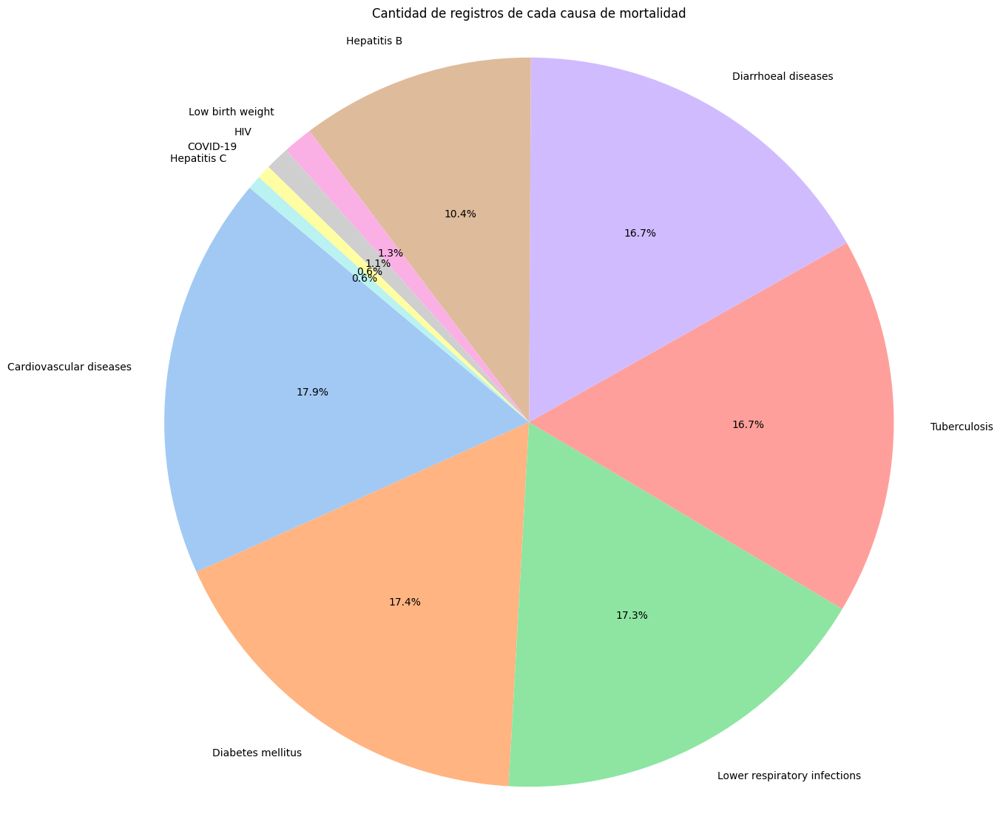

In [ ]:
labels = ['Cardiovascular diseases', 'Lower respiratory infections',
       'Diabetes mellitus', 'Tuberculosis', 'Diarrhoeal diseases',
       'Hepatitis B', 'Low birth weight', 'HIV', 'COVID-19', 'Hepatitis C']

plt.figure(figsize=(14, 14))

plt.pie(causes_of_mortality_counts, labels=causes_of_mortality_counts.index, autopct='%1.1f%%', startangle=140, colors=colors)

plt.axis('equal')
plt.title('Cantidad de registros de cada causa de mortalidad')

plt.show()

Las principales causas de muerte, en orden decreciente, son:

Cardiovascular diseases: 18.2%<br>
Lower respiratory infections: 17.4%<br>
Diabetes mellitus: 17.4%<br>
Tuberculosis: 16.7%<br>
Diarrhoeal diseases: 16.5%<br>
Hepatitis B: 10.2%<br>

El resto de las enfermedades, es decir, Low birth weight,
HIV, COVID-19 y Hepatitis C, hay una muy pequeña proporción.<br>
Pero, en el caso de Low birth weight, hay que analizar, la proporción en base a la cantidad de personas menos de 1 año. Y, en el caso del COVID-19, hay que tener en cuenta que sólo estuvo entre los años 2019 y 2022 aproximadamente.
Por lo que esos casos en particular, los voy a ver por separado.

In [ ]:
age_group_counts = df['Age Group'].value_counts()
age_group_counts

Age Group
10-14    7378
5-9      7377
1-4      7376
15-19    7374
45-49    7374
0        7373
35-39    7372
40-44    7371
20-24    7371
30-34    7369
50-54    7369
25-29    7368
55-59    7366
60-64    7364
65-69    7364
70-74    7364
85+      7361
75-79    7360
80-84    7359
Name: count, dtype: int64

In [ ]:
df_age_group = df[df['Age Group'] == '0']
df_age_group

,Region Name,Country Name,Year,Sex,Age Group,Number,Percentage of cause-specific deaths out of total deaths,Death rate per 100 000 population,Cause of mortality,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
22,Europe,Albania,2000,Male,0,21.0,6.402439,70.469799,Cardiovascular diseases,5.944198,17.278646
45,Europe,Albania,2000,Female,0,12.0,4.724409,44.943820,Cardiovascular diseases,5.944198,14.005749
85,Europe,Albania,2001,Male,0,33.0,9.348442,121.960234,Cardiovascular diseases,5.925845,19.059778
109,Europe,Albania,2001,Female,0,30.0,12.000000,119.856173,Cardiovascular diseases,5.925845,21.270124
178,Europe,Albania,2002,Female,0,23.0,10.360360,91.611567,Cardiovascular diseases,5.664645,21.300000
...,...,...,...,...,...,...,...,...,...,...,...
235060,Europe,Hungary,2020,Female,0,0.0,0.000000,0.000000,Tuberculosis,7.290000,13.600000
235102,Asia,Saudi Arabia,2022,Male,0,0.0,0.000000,0.000000,Tuberculosis,4.169252,16.290354
235123,Asia,Saudi Arabia,2022,Female,0,1.0,0.056148,0.412055,Tuberculosis,1.939701,15.862624
235165,Asia,Saudi Arabia,2021,Male,0,0.0,0.000000,0.000000,Tuberculosis,5.968369,14.515416


In [ ]:
causes_of_mortality_counts_in_df_age_group = df_age_group['Cause of mortality'].value_counts()
causes_of_mortality_counts_in_df_age_group

Cause of mortality
Cardiovascular diseases         1316
Diabetes mellitus               1283
Lower respiratory infections    1276
Diarrhoeal diseases             1236
Tuberculosis                    1233
Hepatitis B                      764
Low birth weight                  99
HIV                               78
Hepatitis C                       46
COVID-19                          42
Name: count, dtype: int64

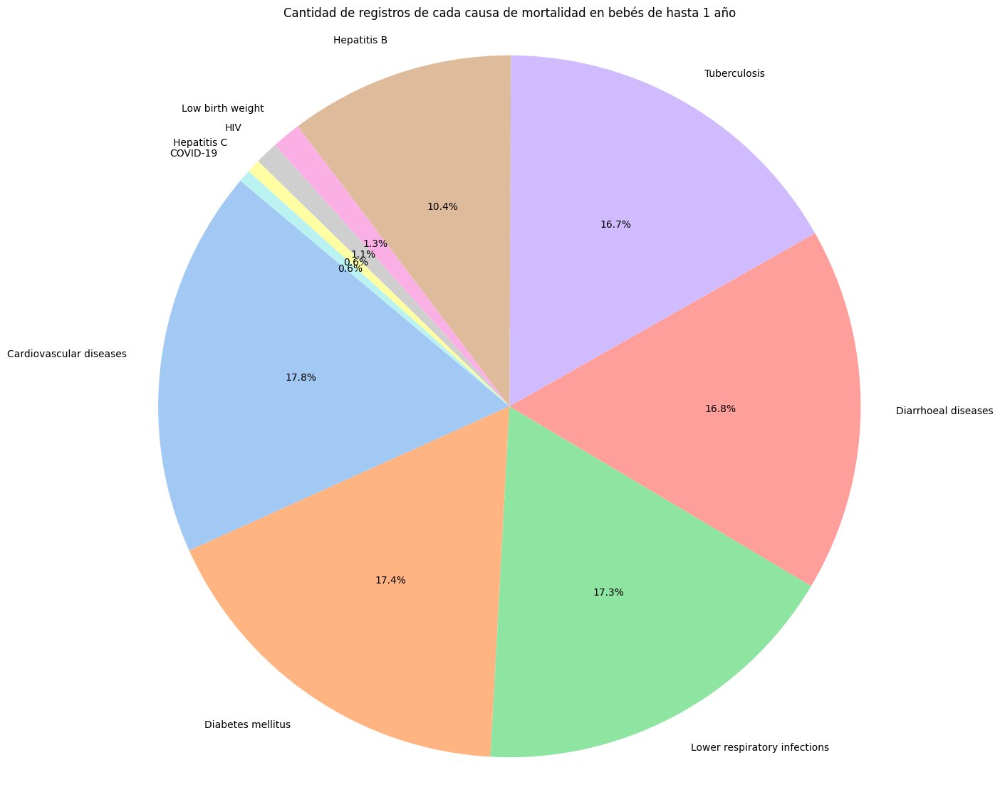

In [ ]:
plt.figure(figsize=(14, 14))

plt.pie(causes_of_mortality_counts_in_df_age_group, labels=causes_of_mortality_counts_in_df_age_group.index, autopct='%1.1f%%', startangle=140, colors=colors)

plt.axis('equal')
plt.title('Cantidad de registros de cada causa de mortalidad en bebés de hasta 1 año')

plt.show()

En este gráfico, se puede observar que realmente el bajo peso al nacer, no es la principal causa de muerte tampoco en menores de 1 año.

<ipython-input-65-a88eeb02913d>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y=cv, data=df, palette="pastel")


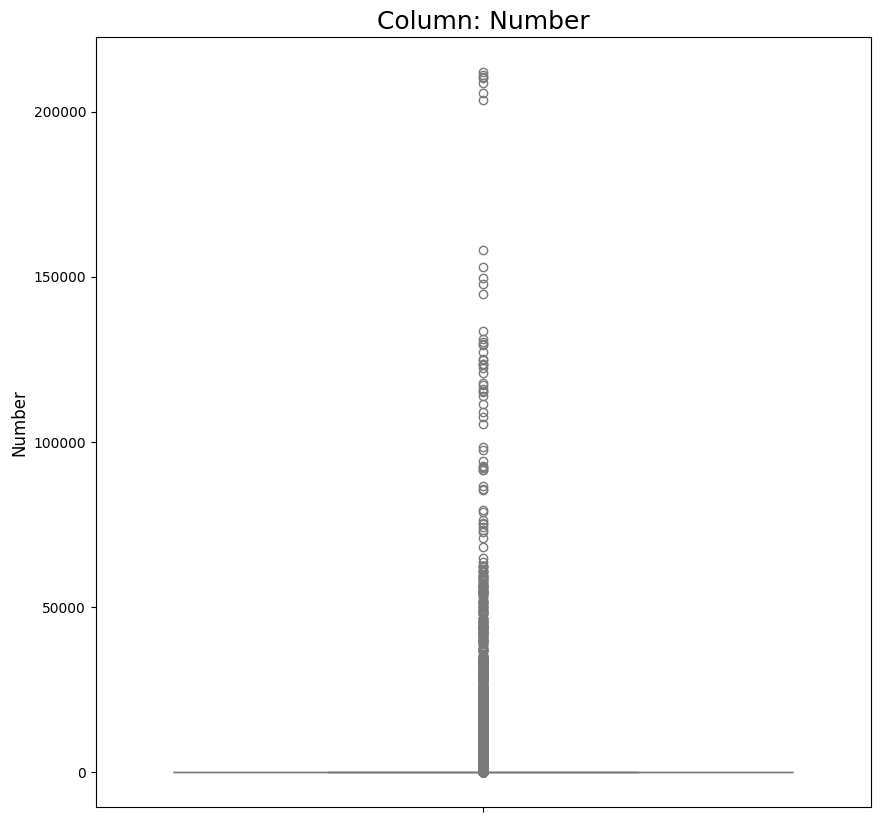

<ipython-input-65-a88eeb02913d>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y=cv, data=df, palette="pastel")


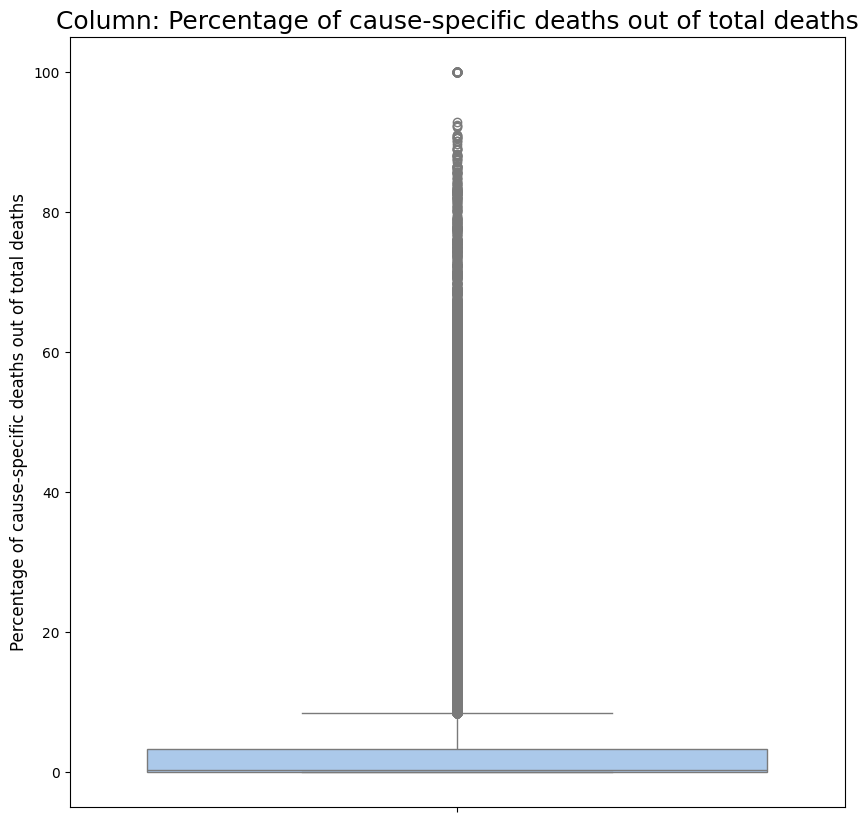

<ipython-input-65-a88eeb02913d>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y=cv, data=df, palette="pastel")


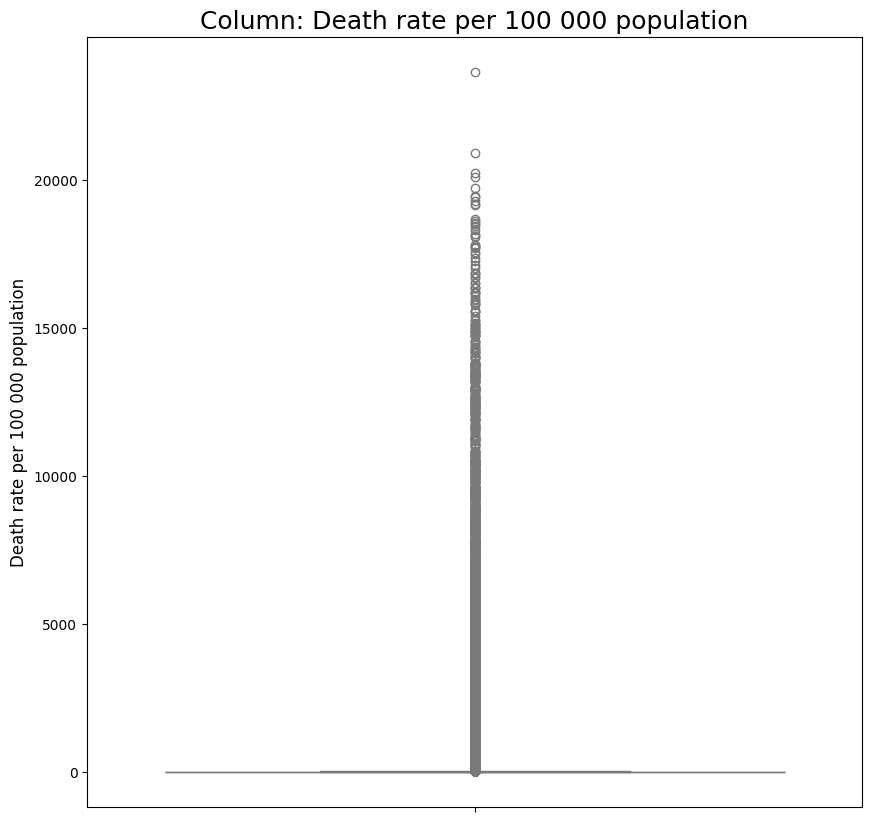

<ipython-input-65-a88eeb02913d>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y=cv, data=df, palette="pastel")


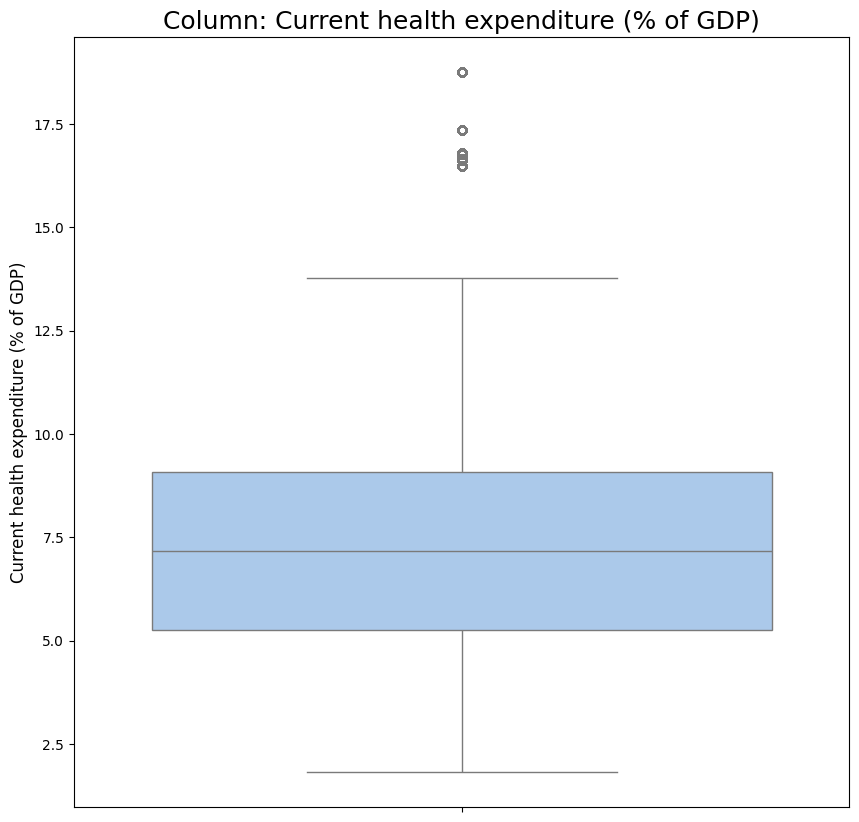

<ipython-input-65-a88eeb02913d>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y=cv, data=df, palette="pastel")


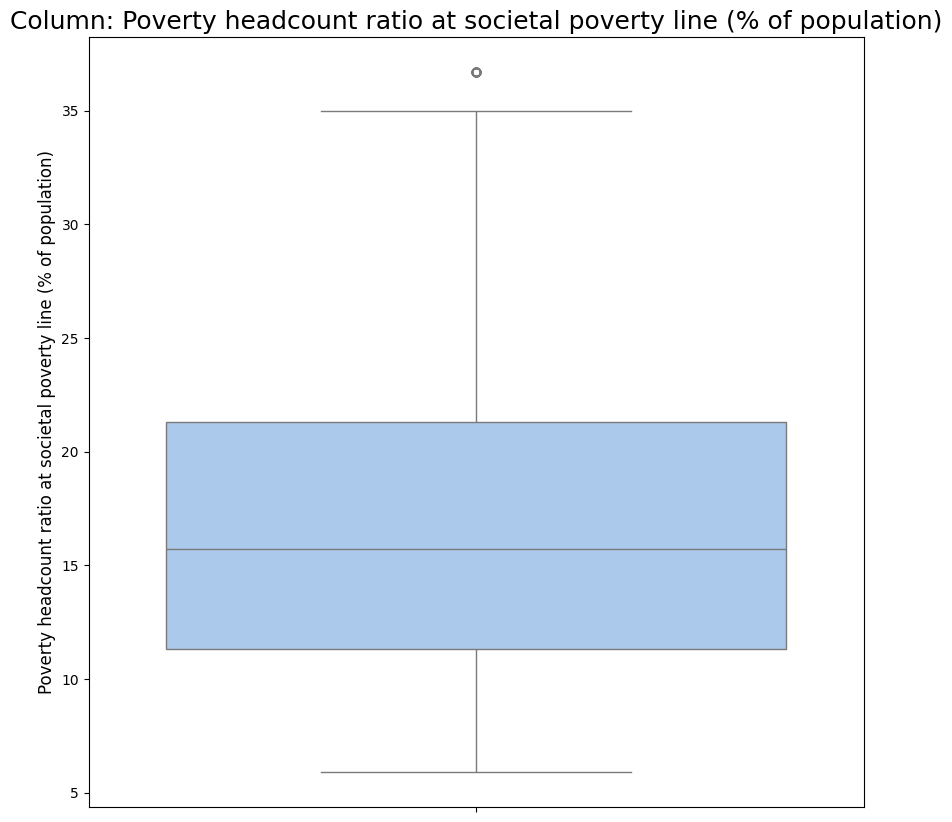

In [ ]:
# Viendo outliers en las variables continuas:

continuous_variables = ["Number", "Percentage of cause-specific deaths out of total deaths", "Death rate per 100 000 population", "Current health expenditure (% of GDP)",
                        "Poverty headcount ratio at societal poverty line (% of population)"]

for cv in continuous_variables:

  plt.figure(figsize=(10, 10))
  sns.boxplot(y=cv, data=df, palette="pastel")
  plt.title("Column: "+cv, fontsize=18)
  plt.ylabel(cv, fontsize=12)
  plt.show()

  print("\n")

Hay muchisimos datos reales que son outliers. Pero como no parece algo atípico, ya que son datos a lo largo de los años y en distintos países, primero quiero analizar más sobre estos datos, antes de ver si los quito o reemplazo o no.

**Analizando outliers:**

* (1) La idea es ver si los 3 atributos relacionados: Number, Percentage of cause-specific deaths out of total deaths y Death rate per 100 000 population, a lo largo de los años, por rango etario y en cada país seleccionado al azar, se comportan igual, si hay algunos valores que se van muy de rango, es decir, si hay algunos outlibers que se van demasiado de lo normal entre las 3 variables, lo puedo borrar o asignarle un valor como la mediana.
Estos 3 atributos, los comparo ya que son lo mismo pero en distintos formatos.

* (2) Por otro lado, en cuanto al atributo Current health expenditure (% of GDP). Voy a ir analizandolo, a lo largo de los años, por país y posiblemente irlo analizando por enfermedad.

* (3) Por último, el atributo Poverty headcount ratio at societal poverty, voy a ir analizandolo, a lo largo de los años, por país y posiblemente irlo analizando por enfermedad.

**OBS:** Como son demasiados países, voy a ver algunos.

In [47]:
year_in_order = ['2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022']

In [48]:
df_cardiovascular_diseases = df[df['Cause of mortality'] == "Cardiovascular diseases"]
df_lower_respiratory_infections = df[df['Cause of mortality'] == "Lower respiratory infections"]
df_diabetes_mellitus = df[df['Cause of mortality'] == "Diabetes mellitus"]
df_hepatitis_B = df[df['Cause of mortality'] == "Hepatitis B"]
df_hepatitis_C = df[df['Cause of mortality'] == "Hepatitis C"]
df_HIV = df[df['Cause of mortality'] == "HIV"]
df_COVID19 = df[df['Cause of mortality'] == "COVID-19"]
df_tuberculosis = df[df['Cause of mortality'] == "Tuberculosis"]
df_low_birth_weight = df[df['Cause of mortality'] == "Low birth weight"]
df_diarrhoeal_diseases = df[df['Cause of mortality'] == "Diarrhoeal diseases"]
df_meningitis = df[df['Cause of mortality'] == "Meningitis"]

In [49]:
countries_name = ['Argentina', 'Australia', 'Brunei Darussalam','Bulgaria', 'Canada', 'Chile', 'China',
       'Dominican Republic', 'Ecuador', 'Egypt', 'Finland', 'France',
       'Germany', 'Hungary', 'Israel', 'Italy', 'Japan', 'Kazakhstan', 'Korea, Rep.',
       'Mexico', 'Moldova', 'New Zealand', 'Nicaragua', 'Paraguay', 'Poland', 'Portugal',
       'Russian Federation','South Africa', 'Spain','Turkiye','United States','Uruguay', 'Uzbekistan', 'Venezuela, RB']

In [50]:
continuous_variables_without_economic_information = ["Number", "Percentage of cause-specific deaths out of total deaths", "Death rate per 100 000 population"]

###**(1) Outliers:**

Para ayudar al tamaño de la notebook, voy a acotar los rangos etarios y países.

In [174]:
age_groups_acotado = ["0","1-4","10-14","30-34","60-64","85+"]

In [175]:
countries_name_acotado = ['Argentina', 'China', 'France','Germany','Uruguay', 'Uzbekistan']

In [176]:
def boxplot_continuous_variables_without_economic_information(df, age_group, cause_of_mortality):
  for country in countries_name_acotado:
    for cv in continuous_variables_without_economic_information:
      plt.figure(figsize=(10, 10))
      df_country = df[df['Country Name'] == country]
      sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")
      plt.title(f"Variable {cv} a lo largo de los años del rango etario {age_group} en {country}, de la causa {cause_of_mortality}", fontsize=18)
      plt.xlabel("Year", fontsize=12)
      plt.ylabel(cv, fontsize=12)
      plt.show()

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


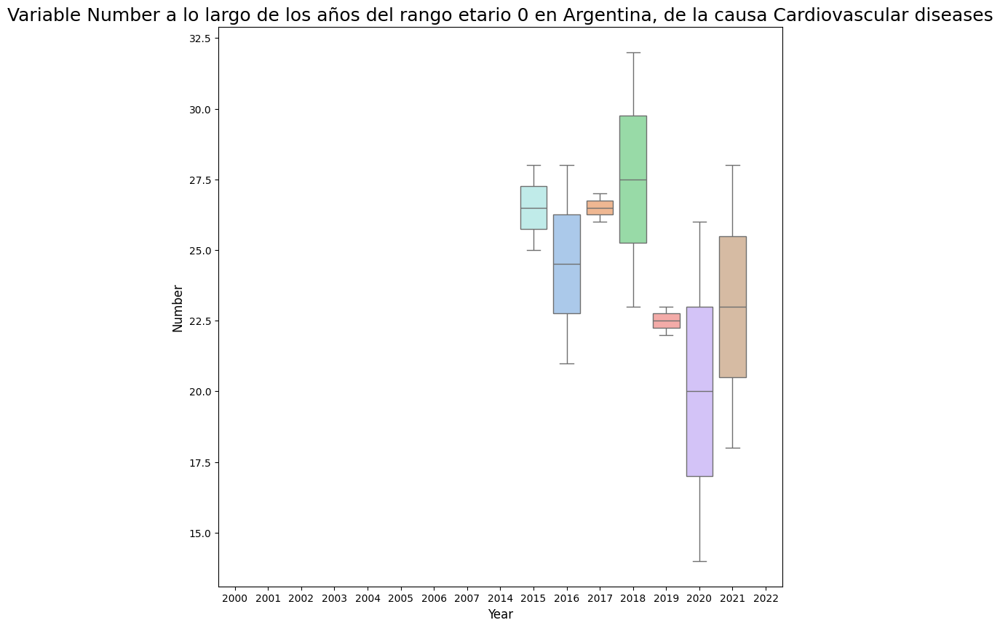

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


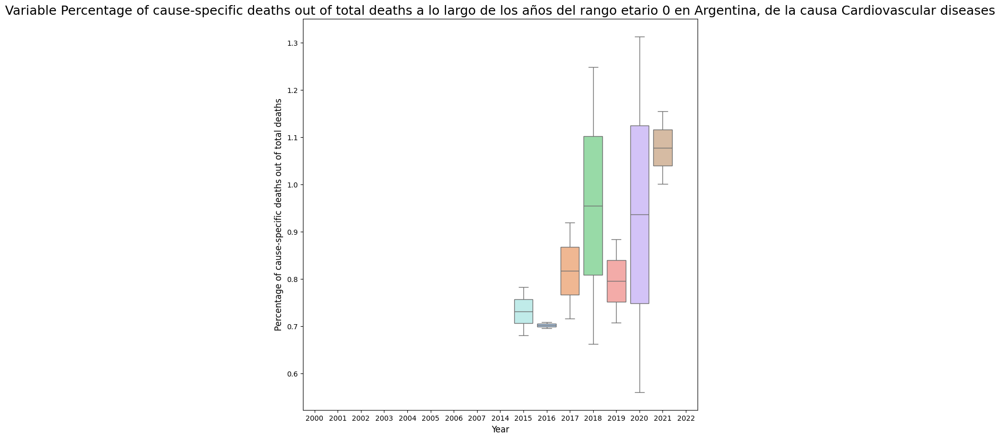

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


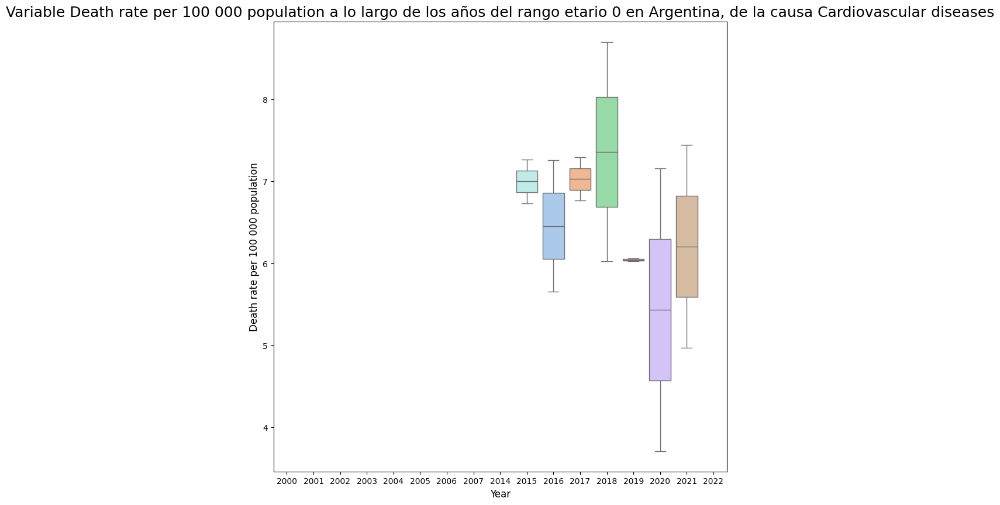

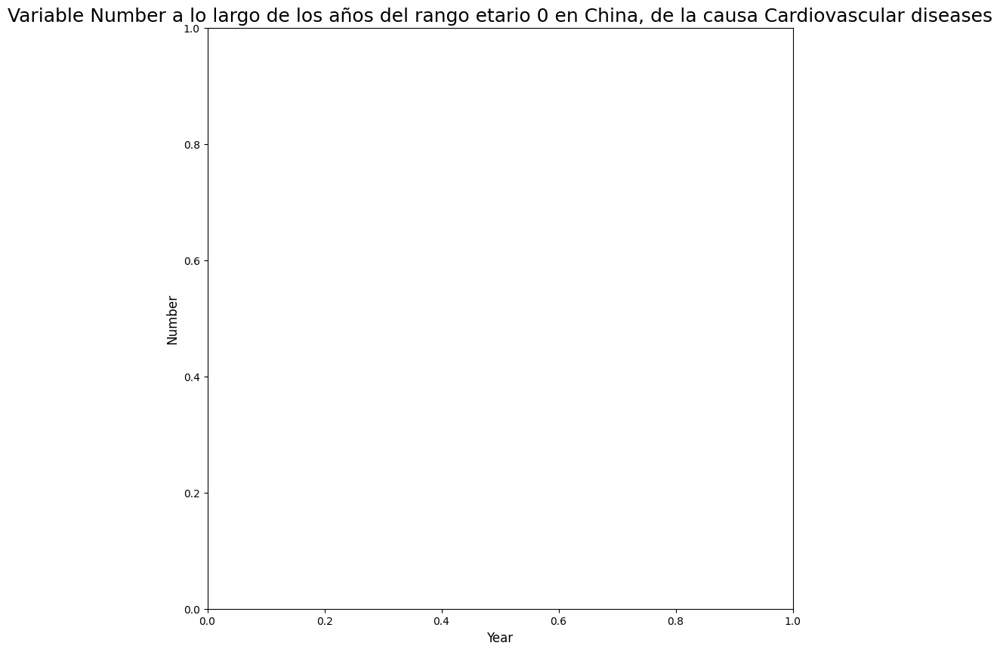

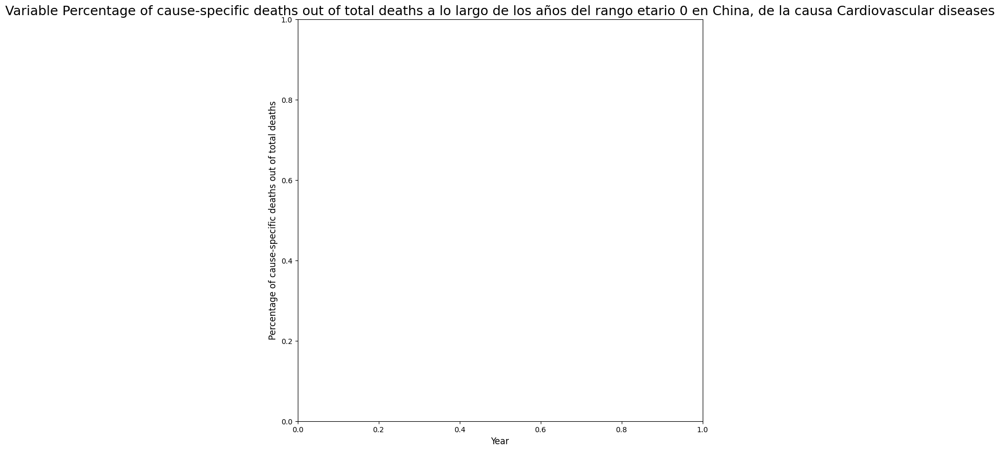

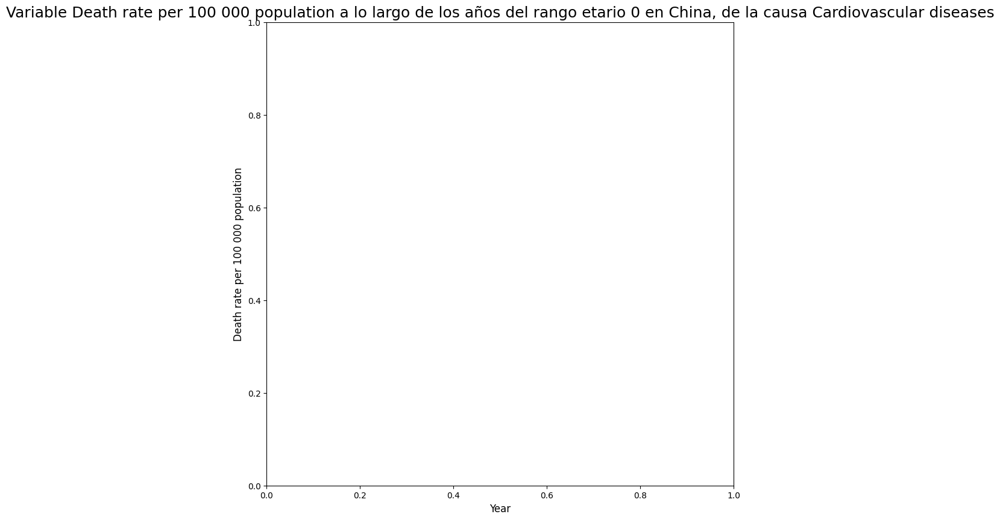

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


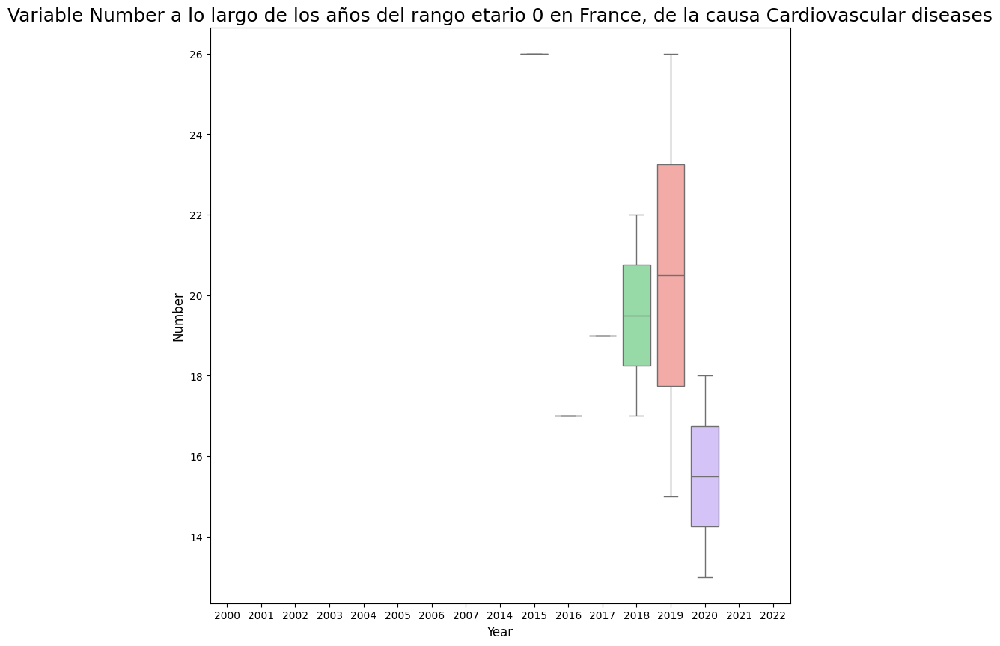

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


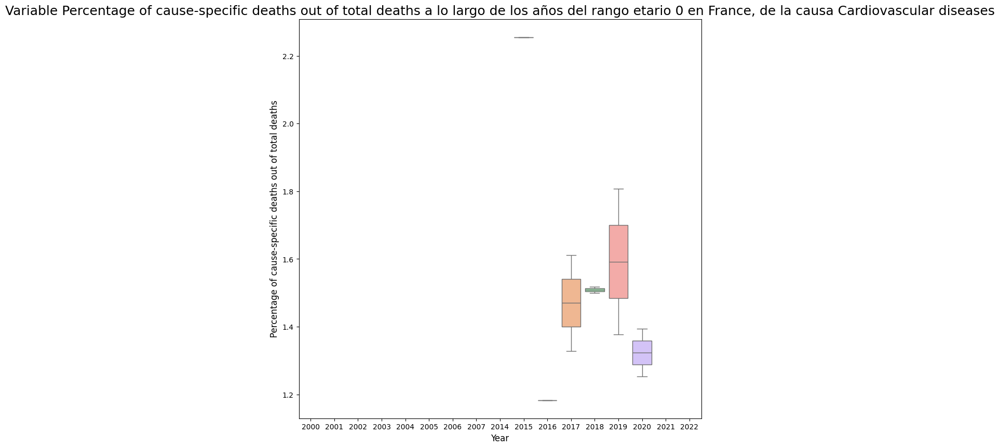

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


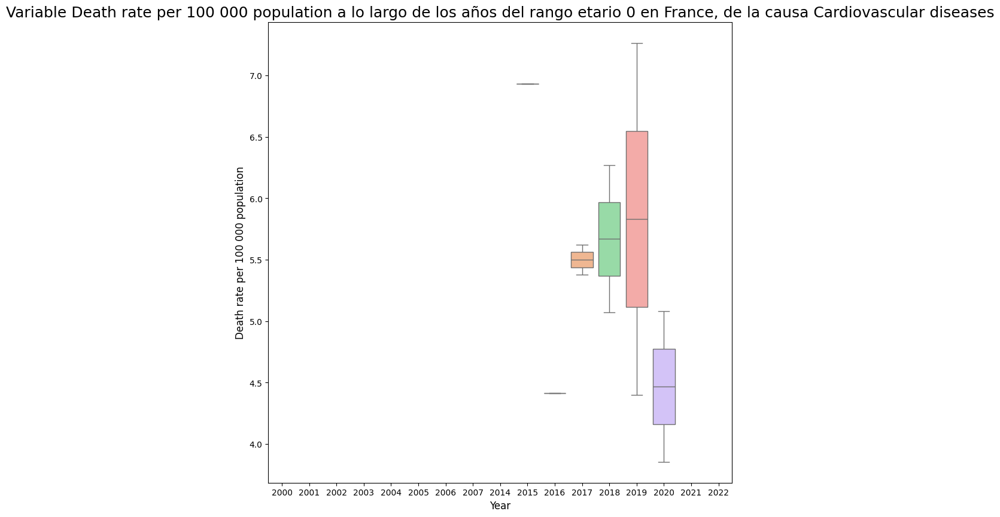

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


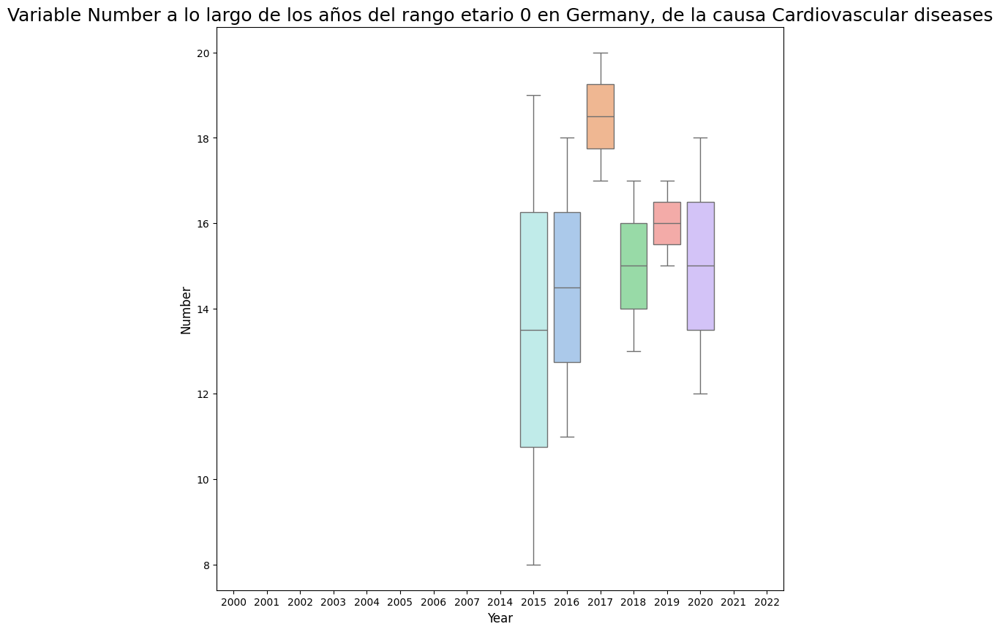

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


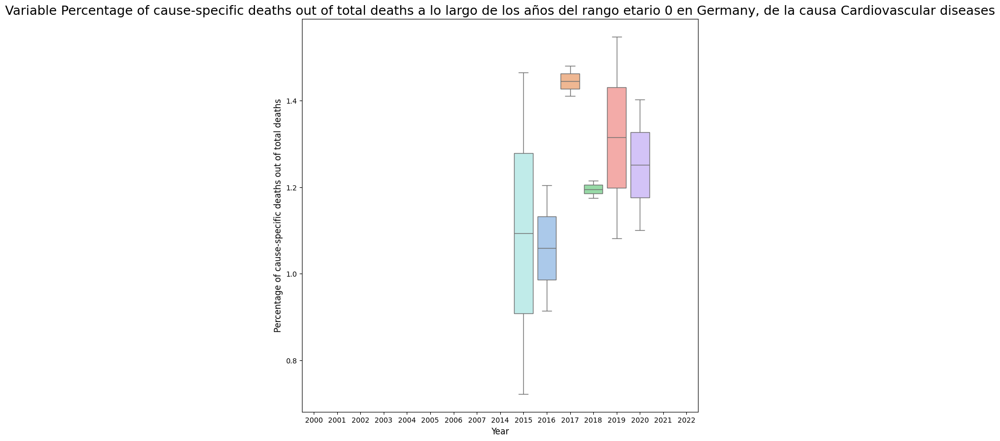

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


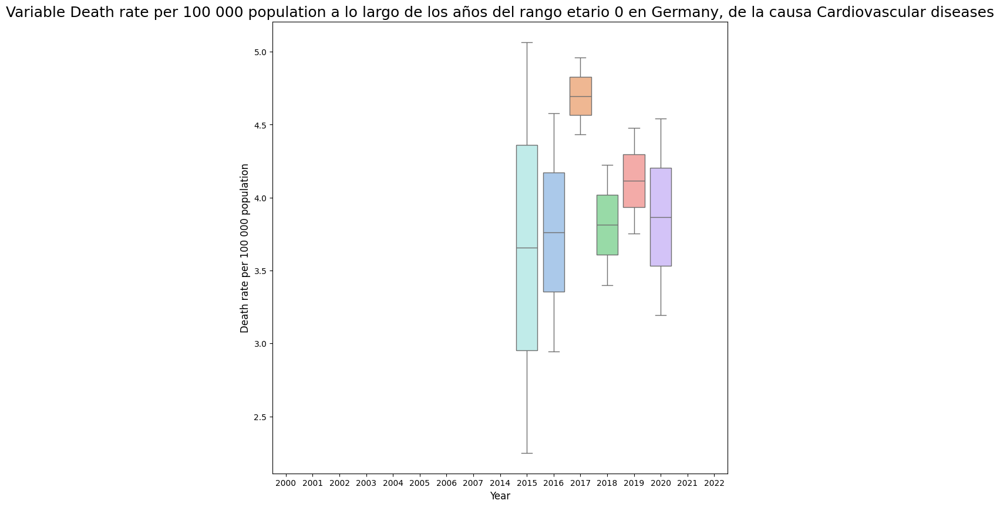

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


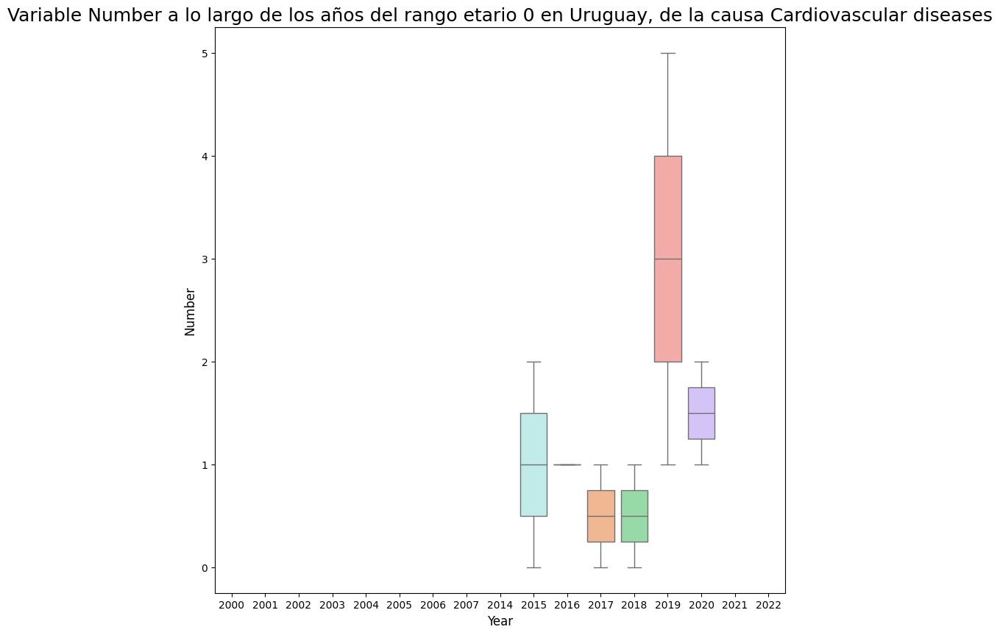

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


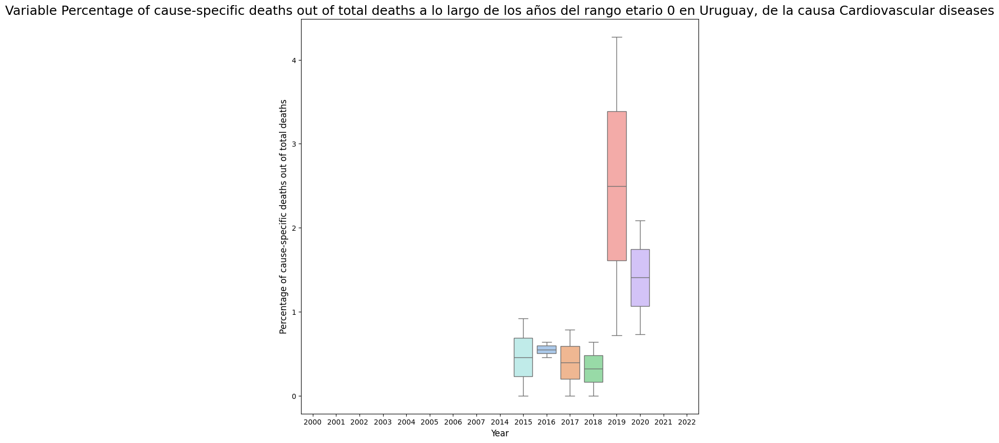

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


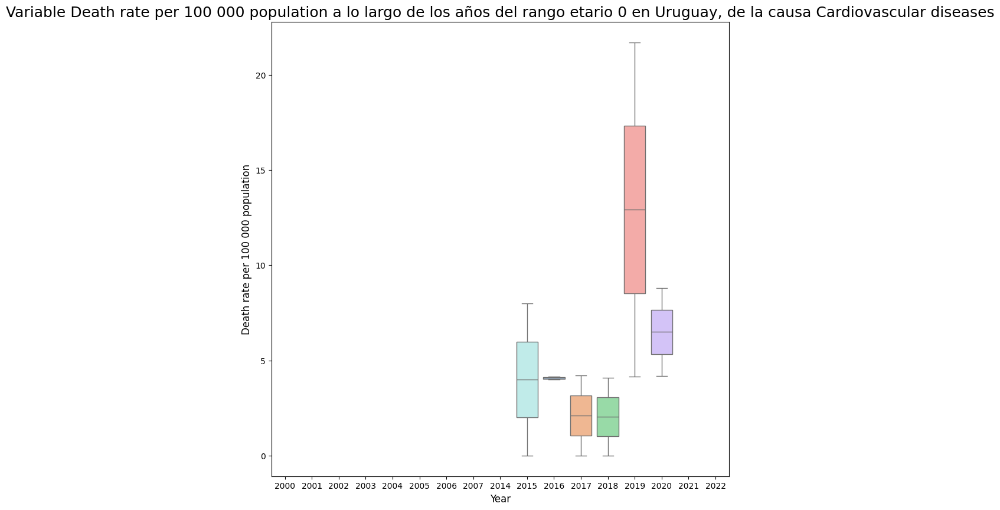

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


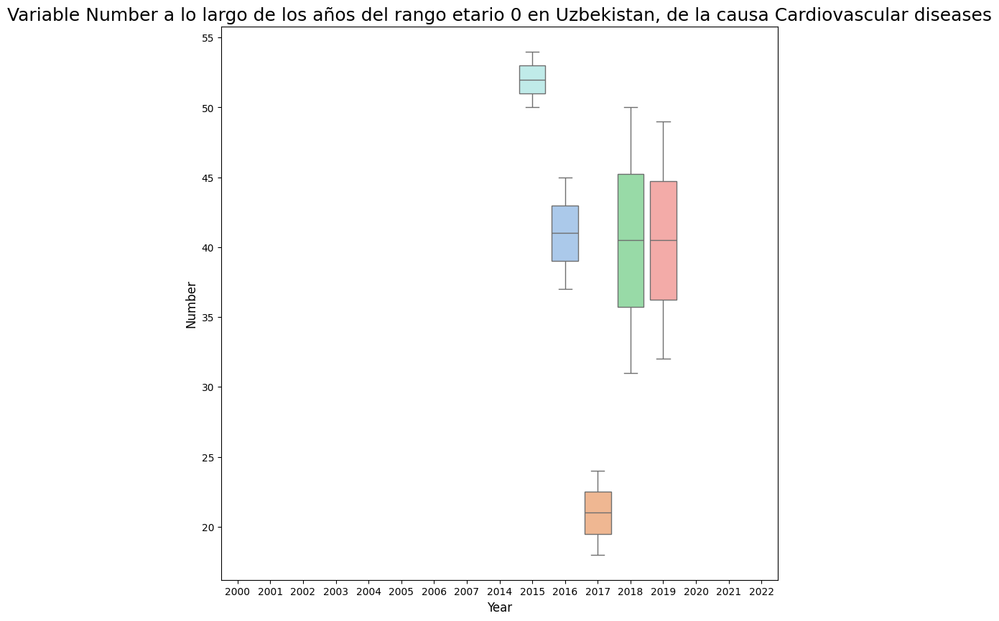

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


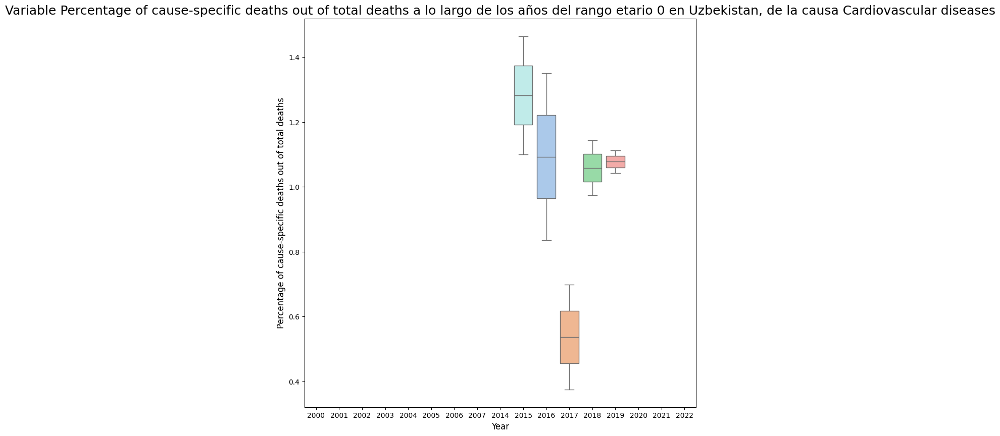

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


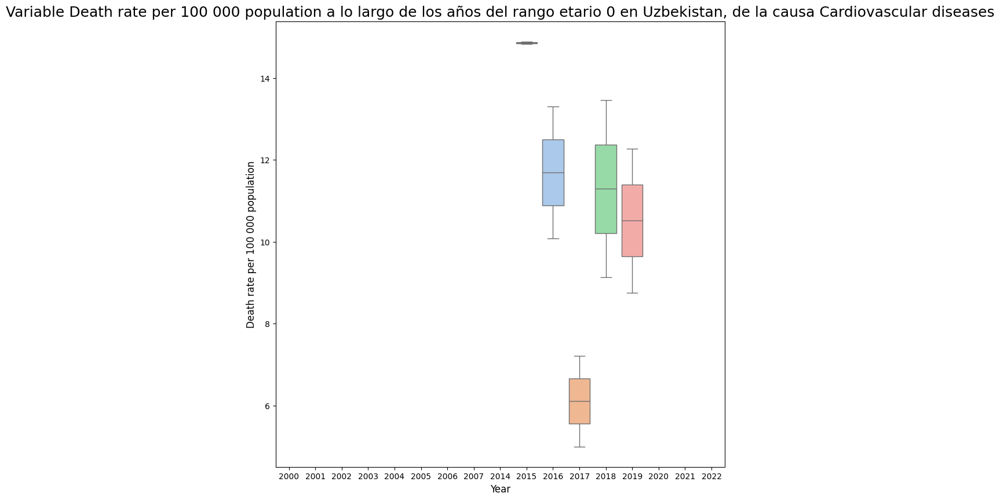

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


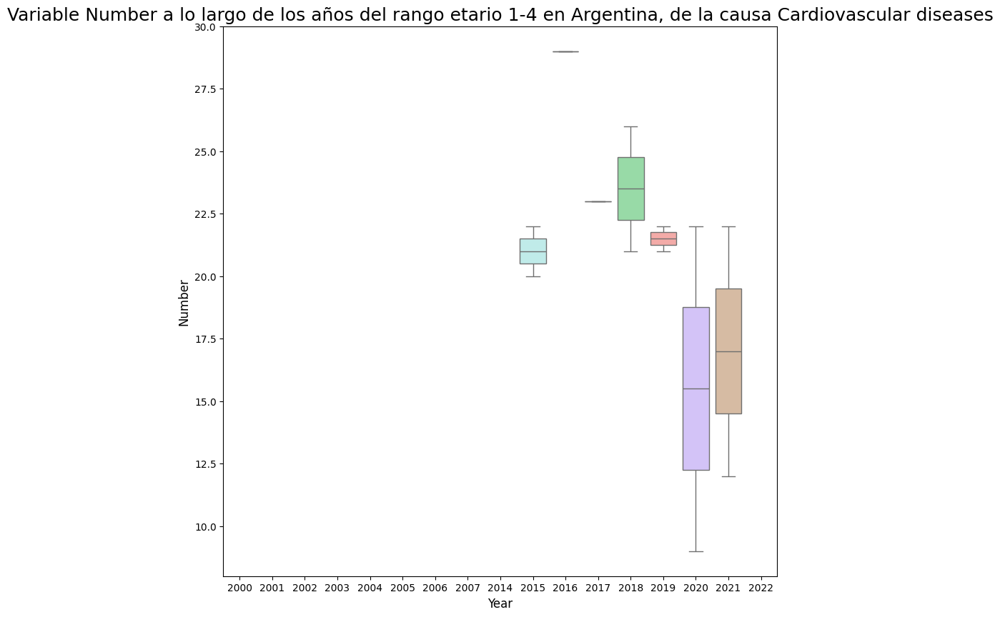

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


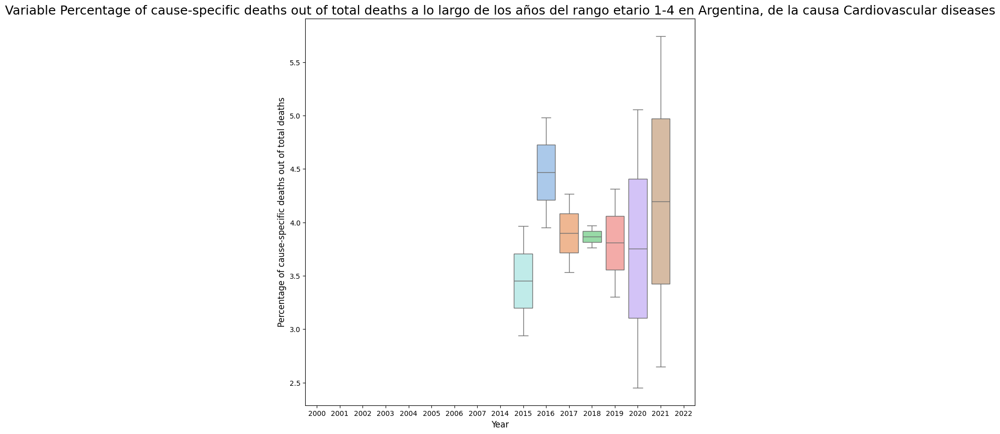

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


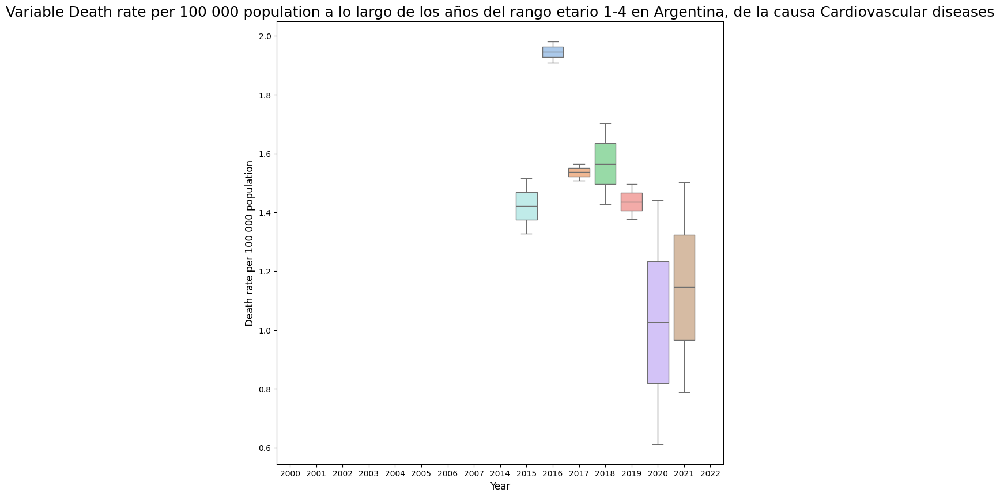

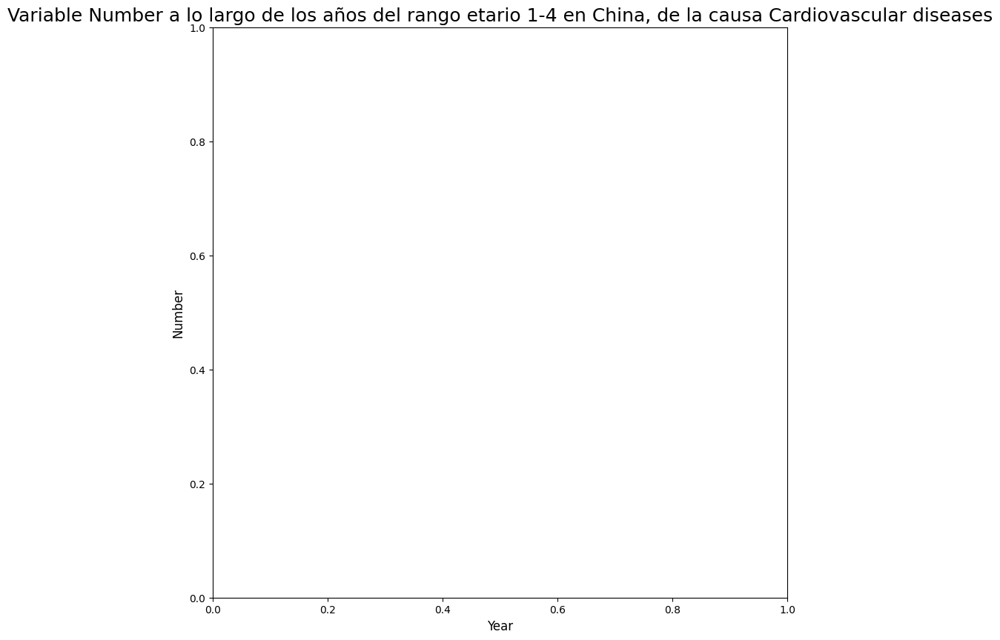

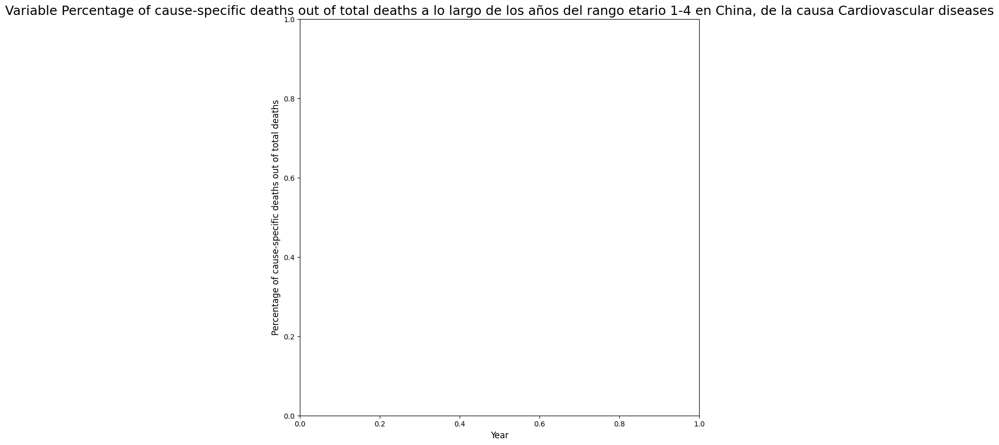

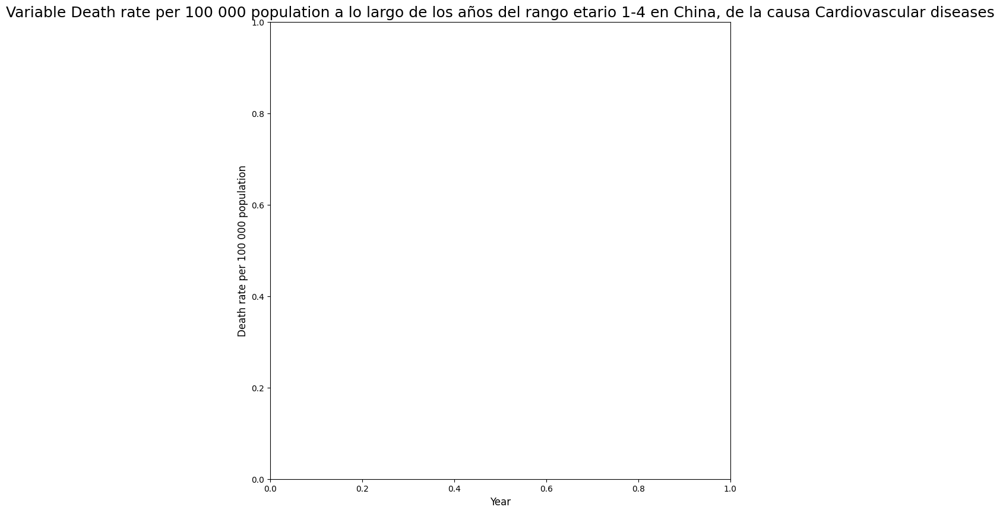

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


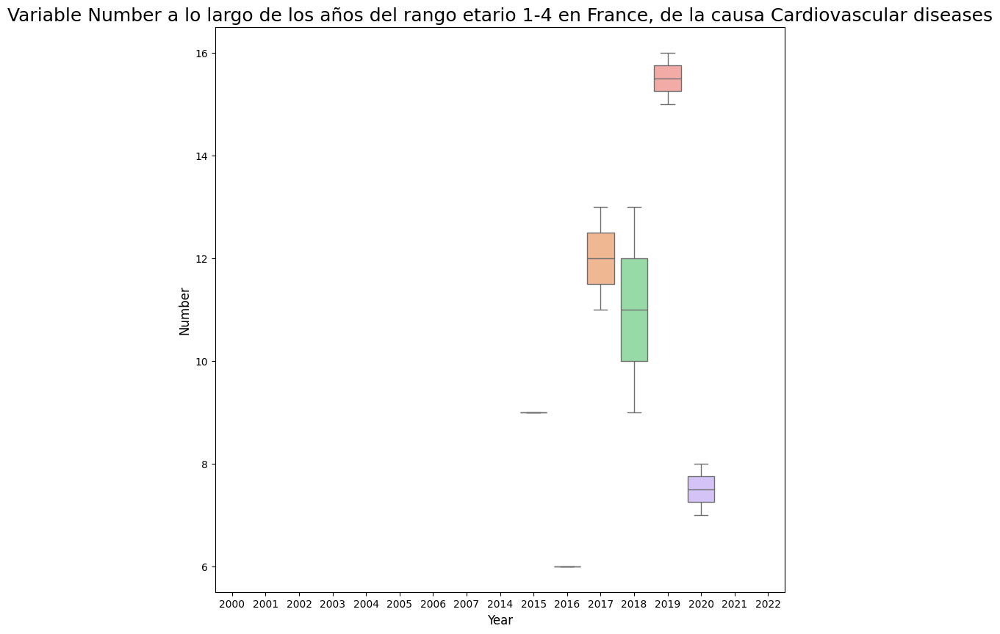

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


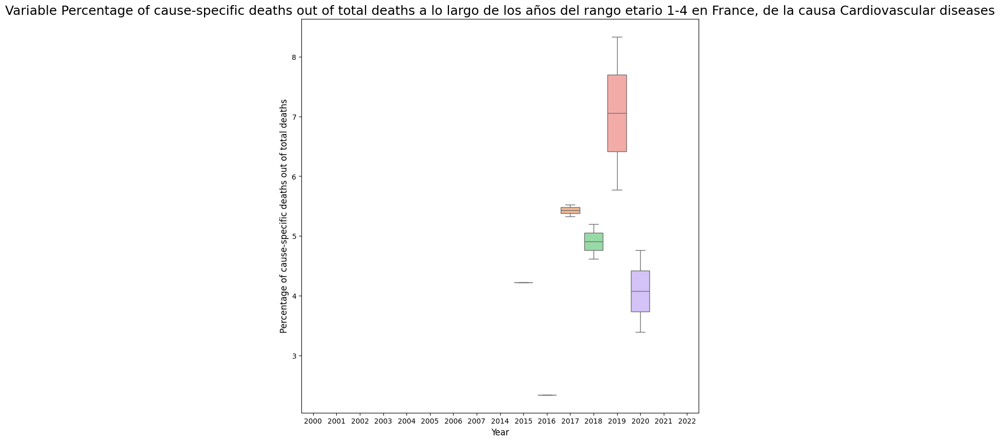

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


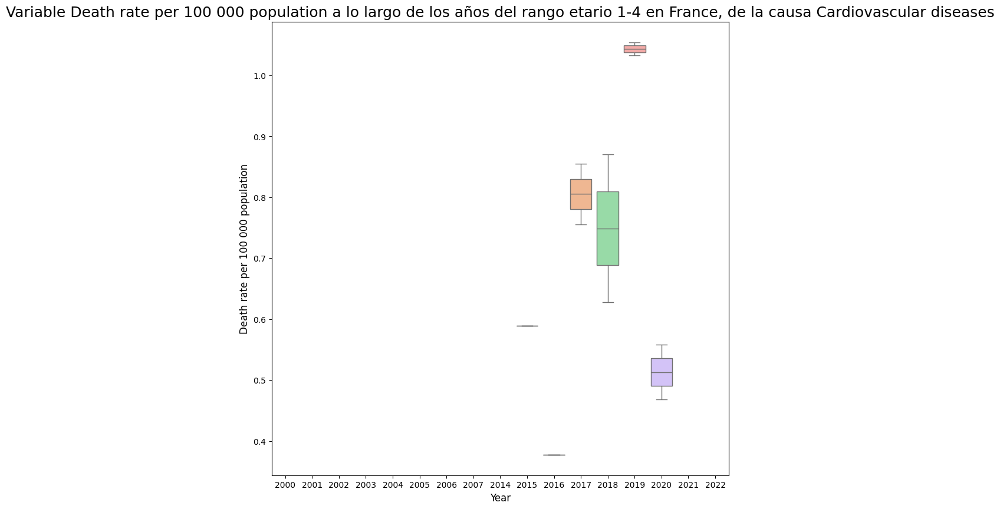

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


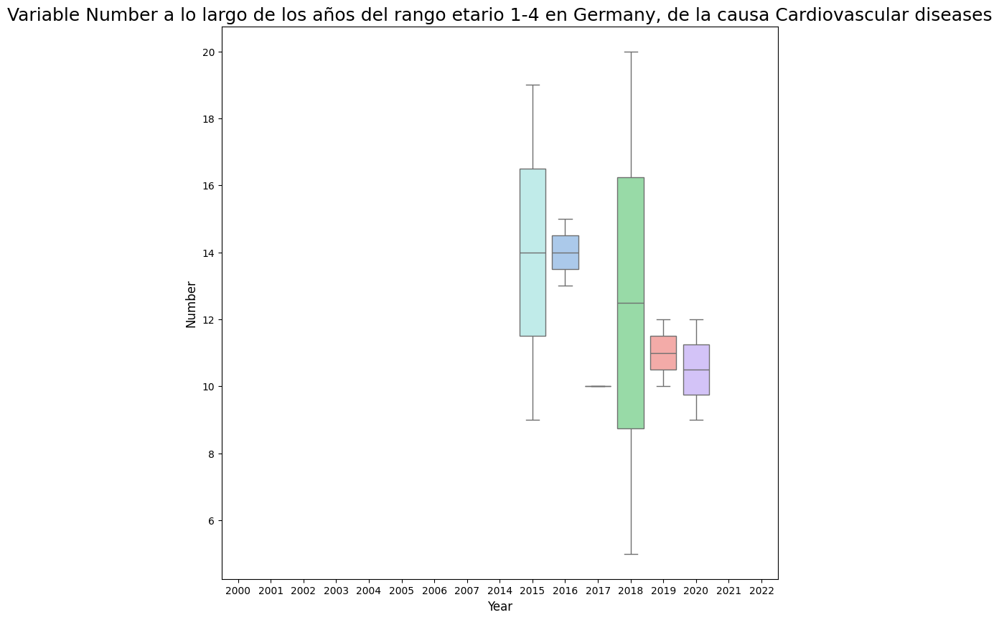

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


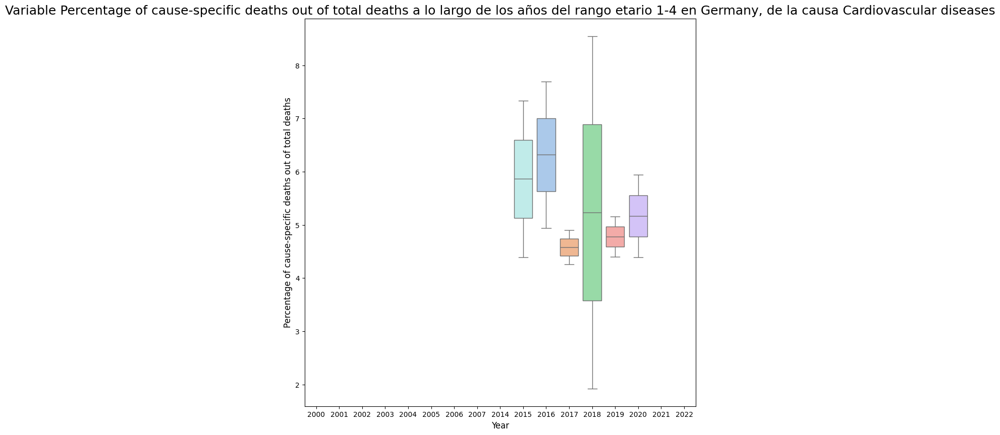

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


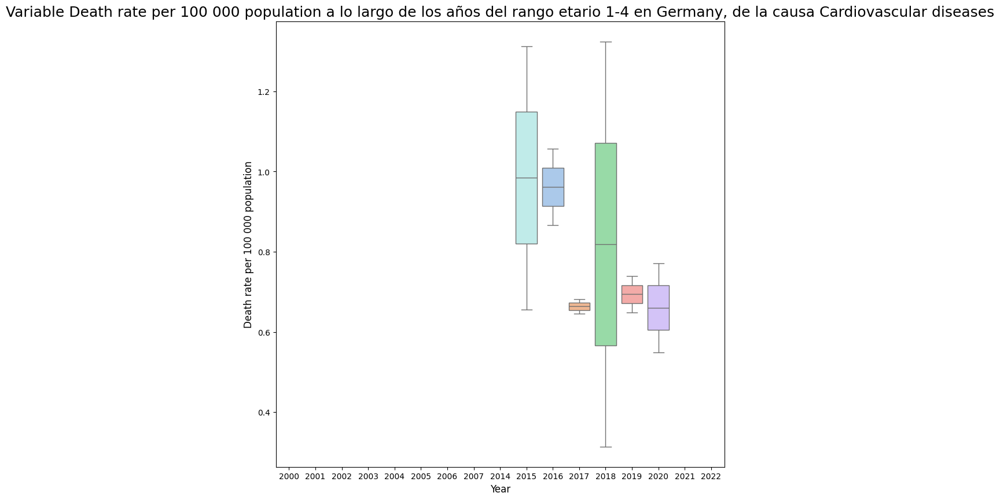

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


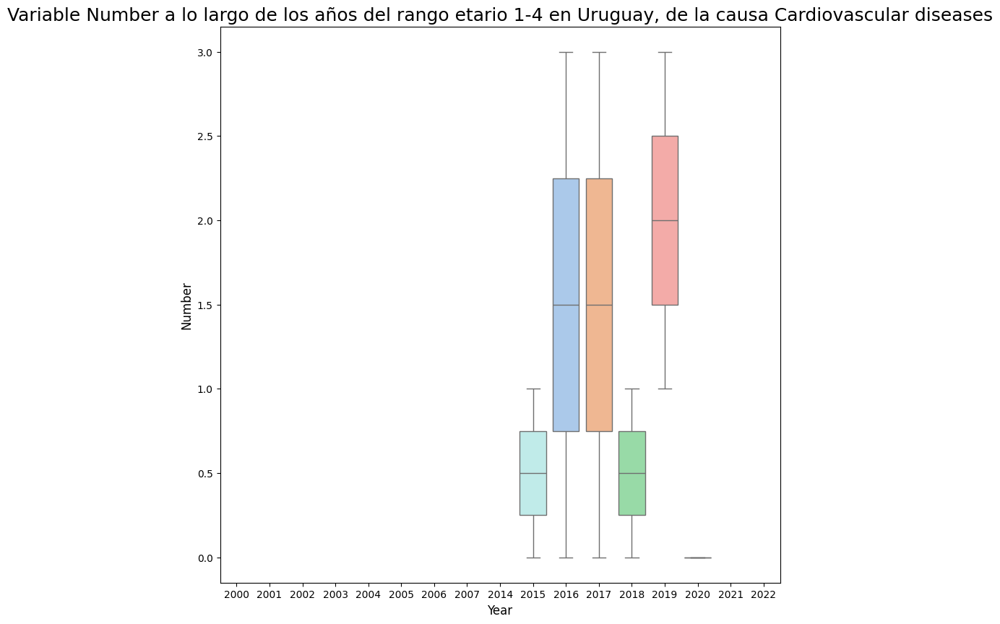

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


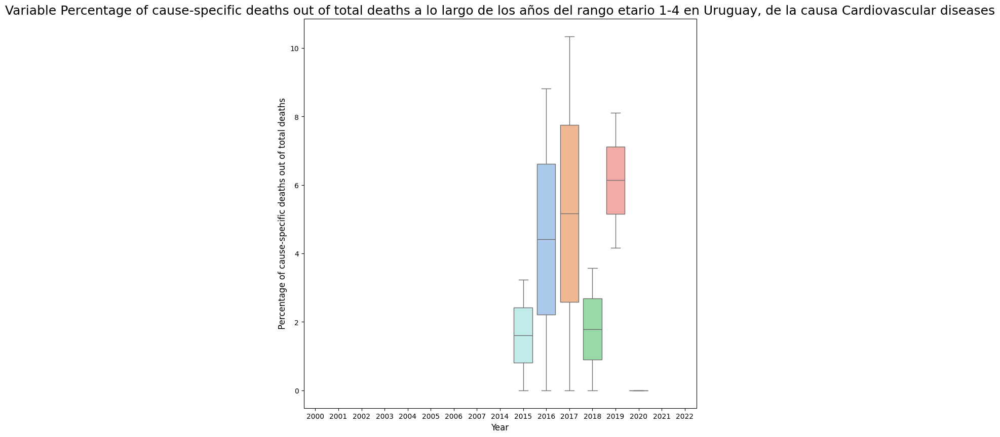

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


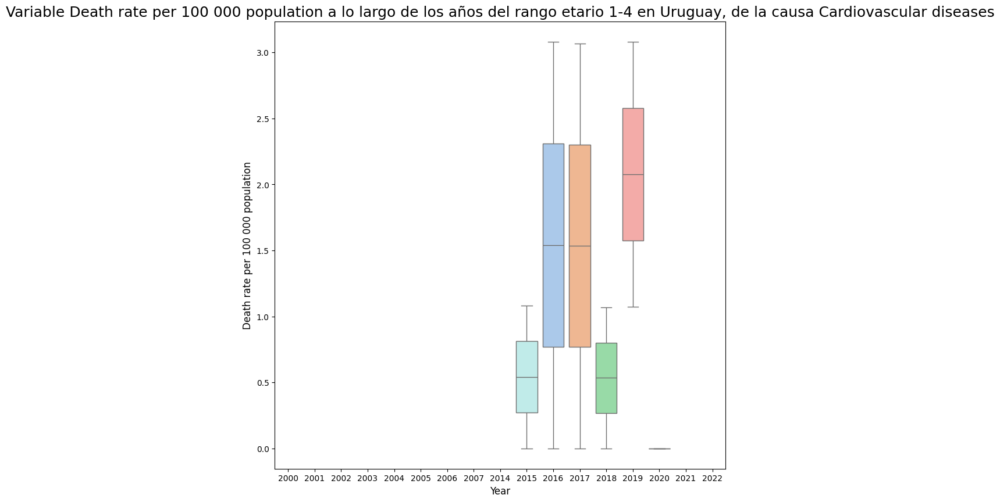

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


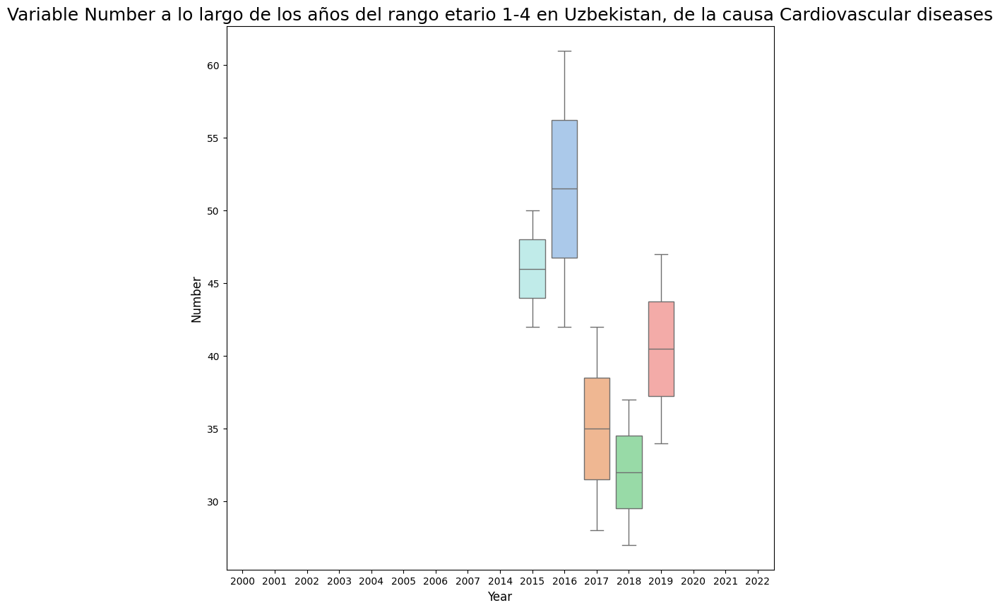

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


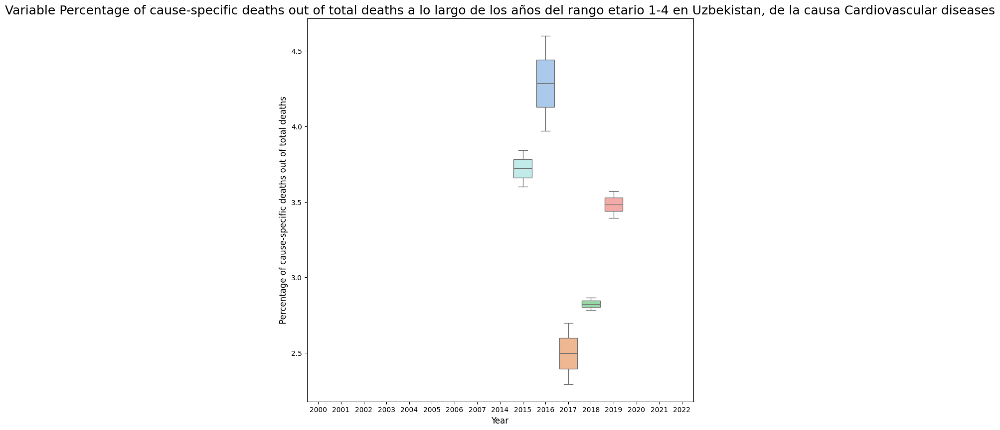

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


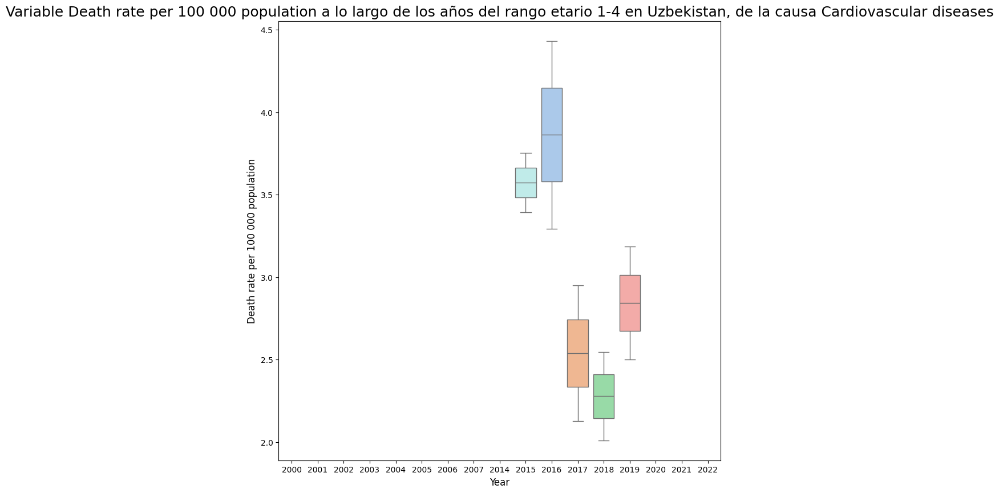

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


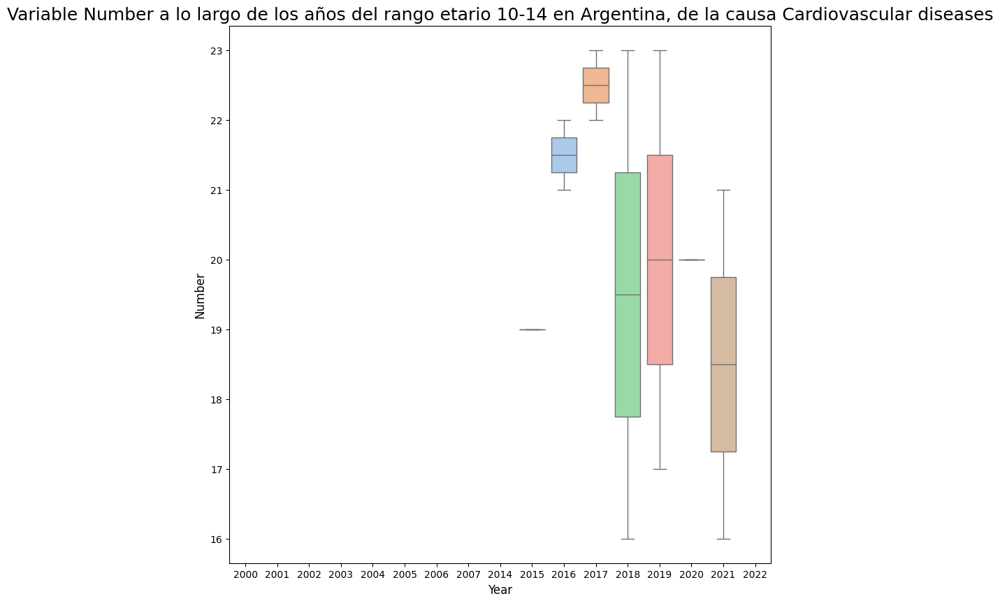

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


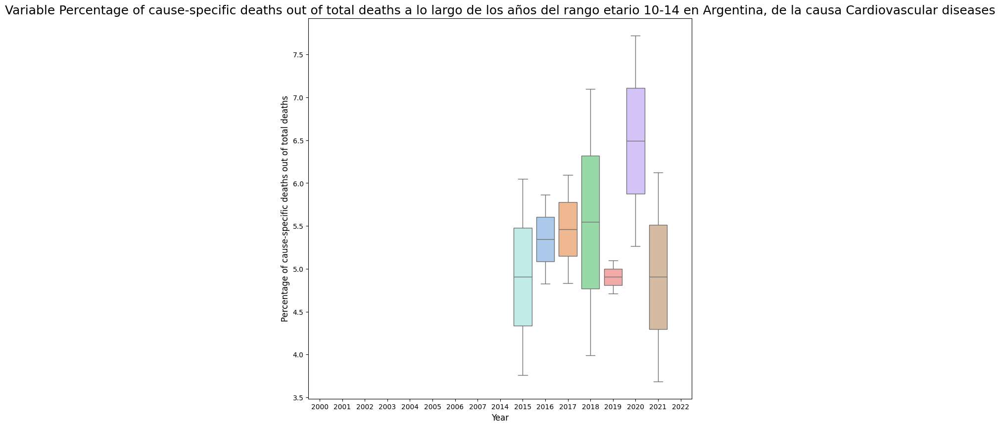

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


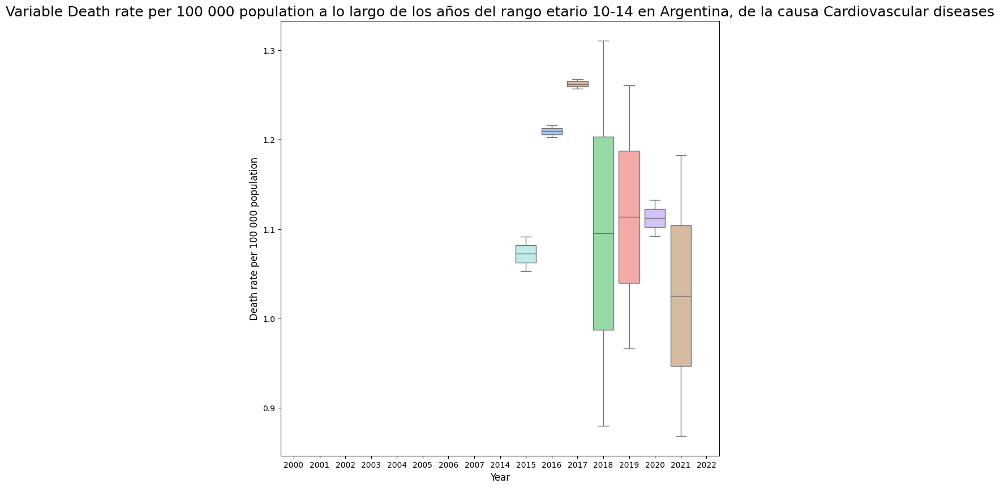

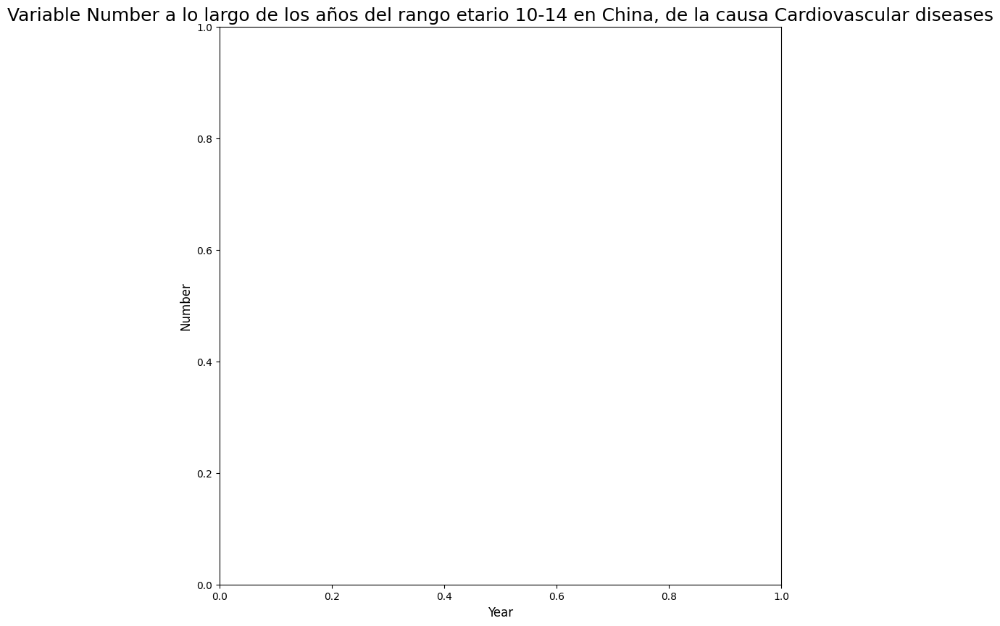

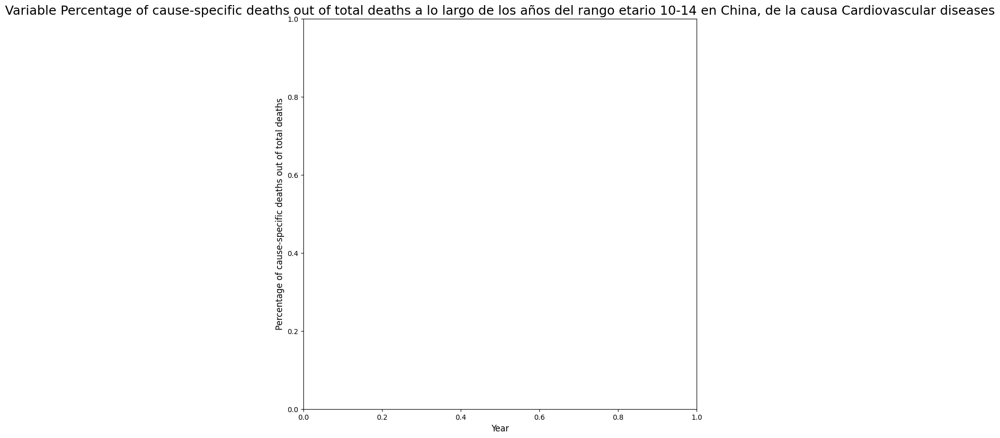

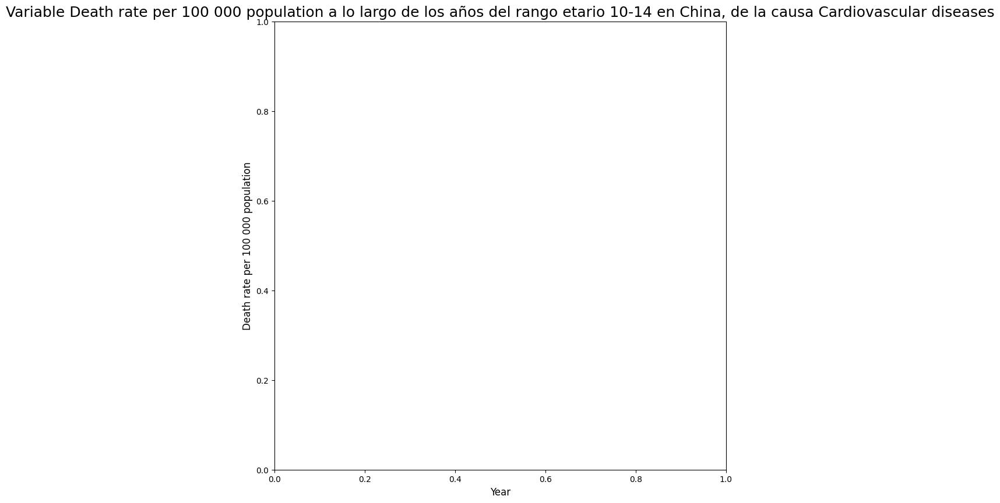

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


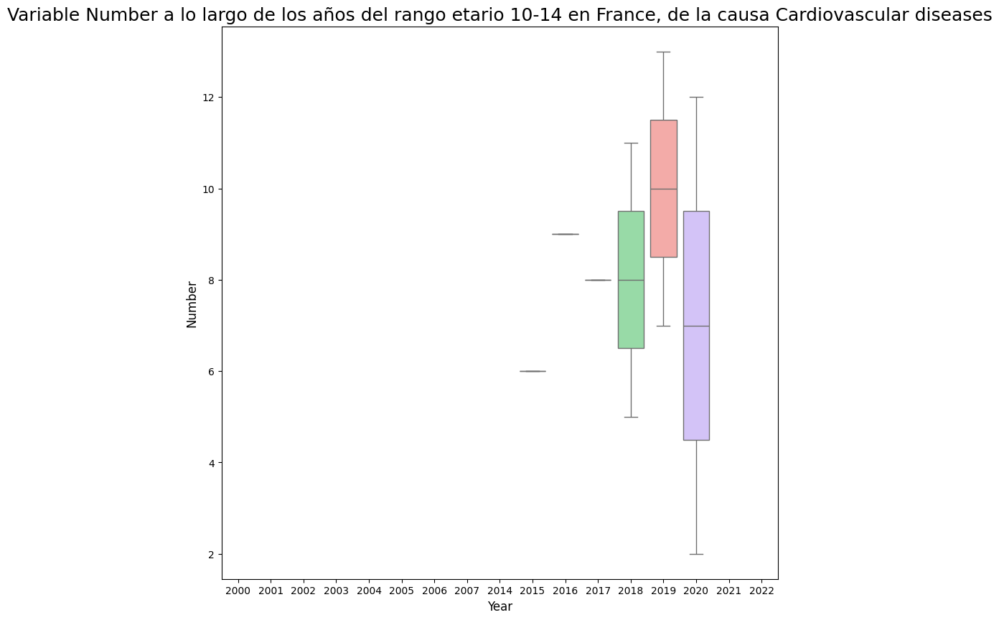

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


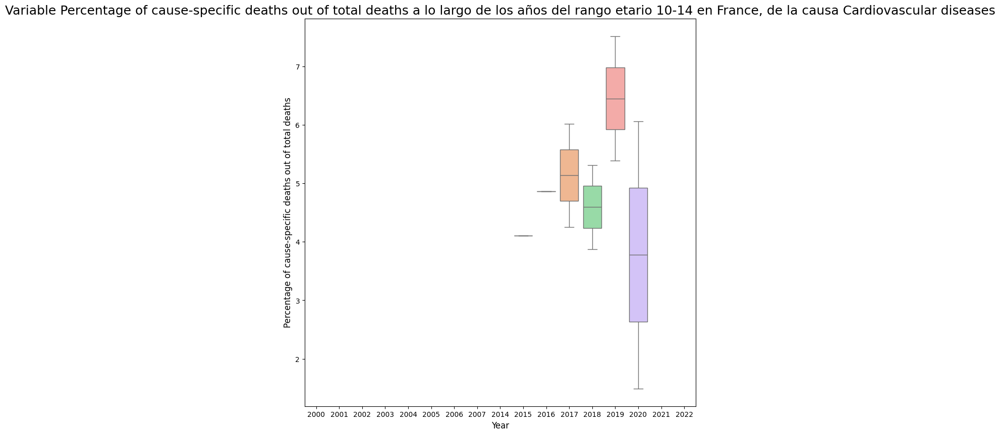

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


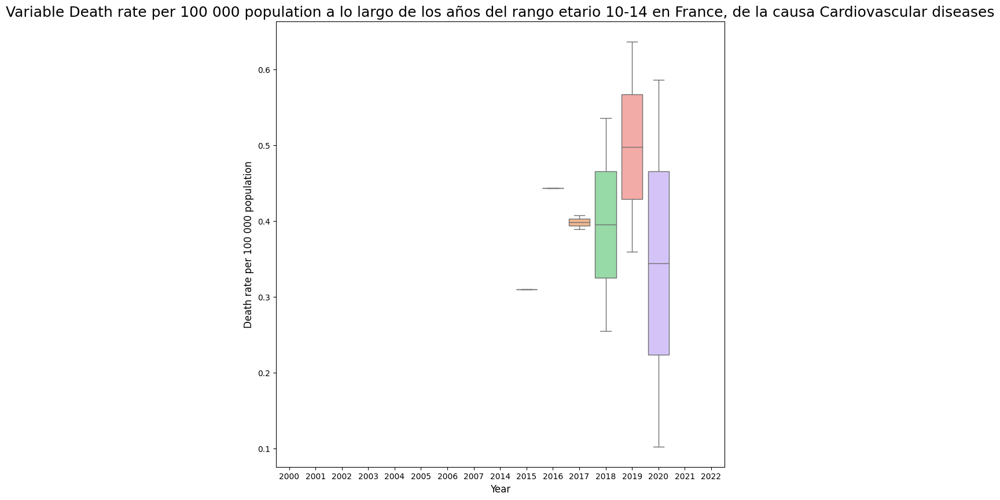

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


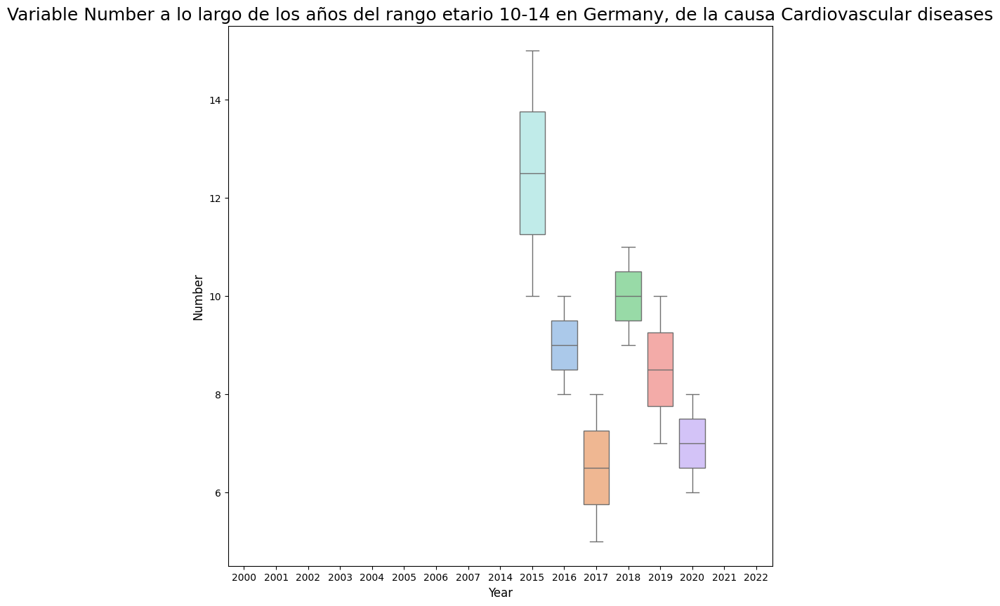

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


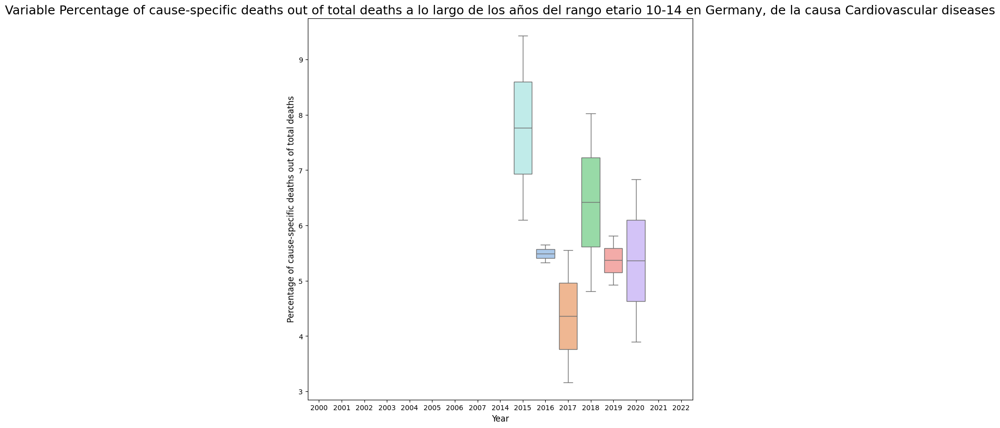

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


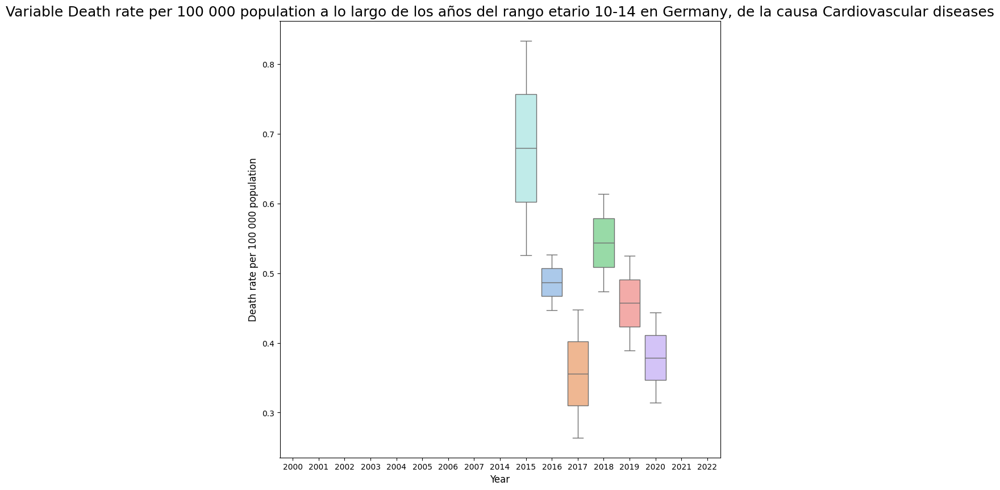

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


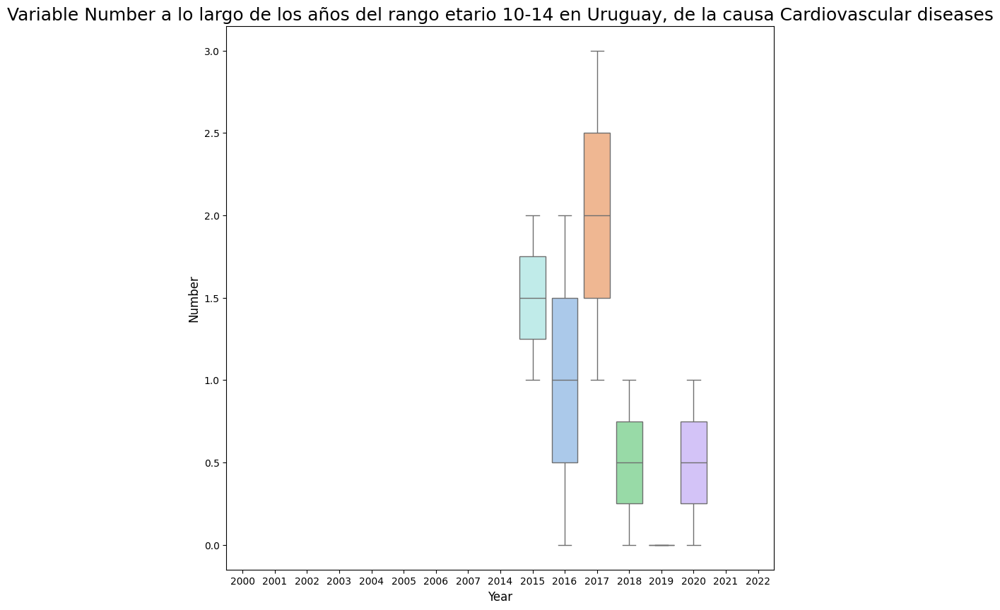

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


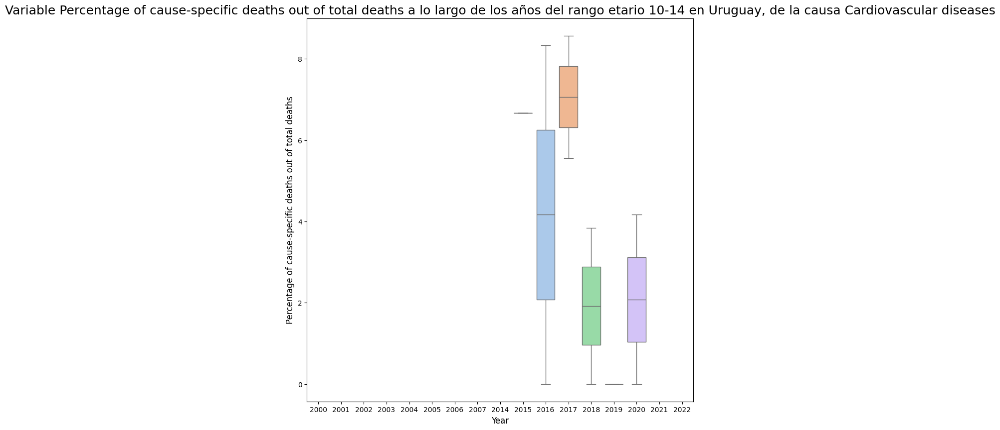

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


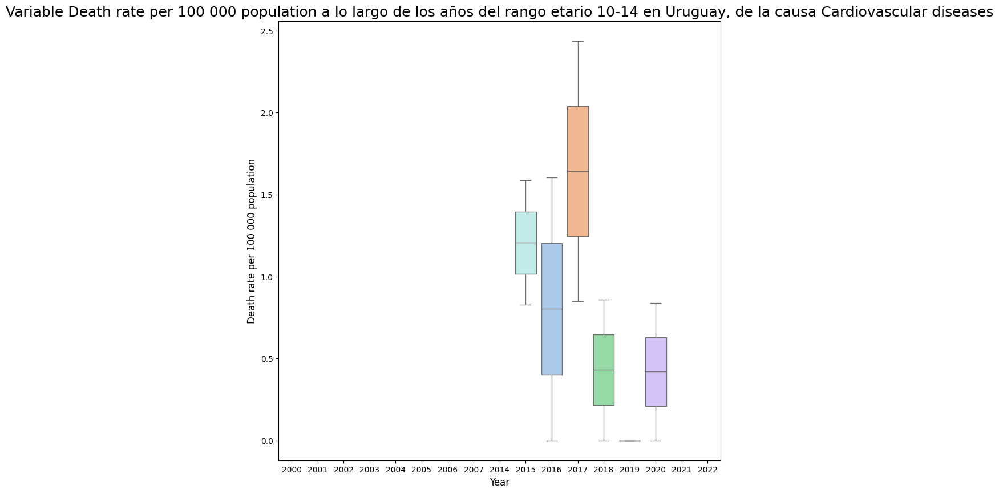

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


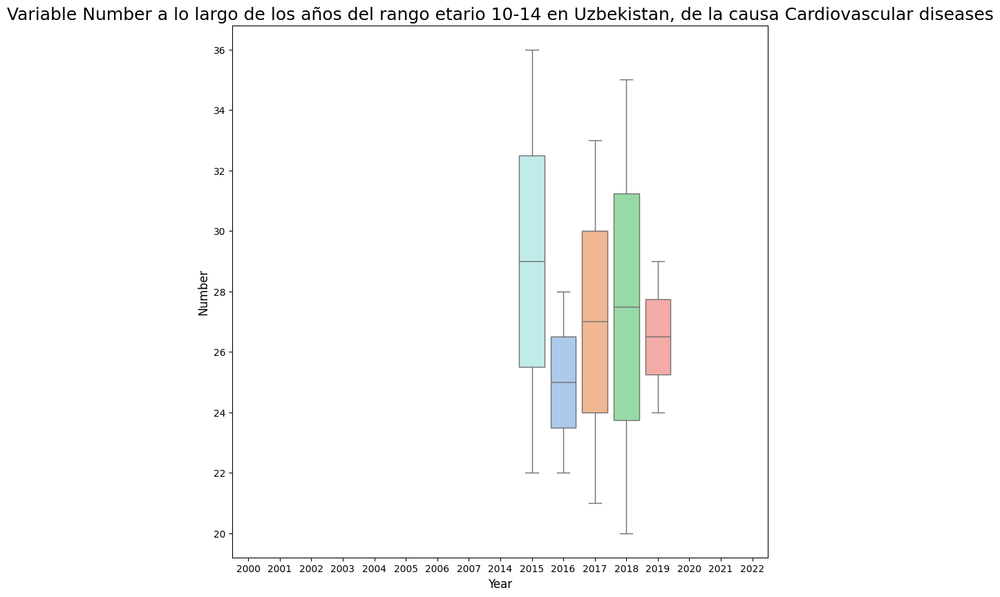

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


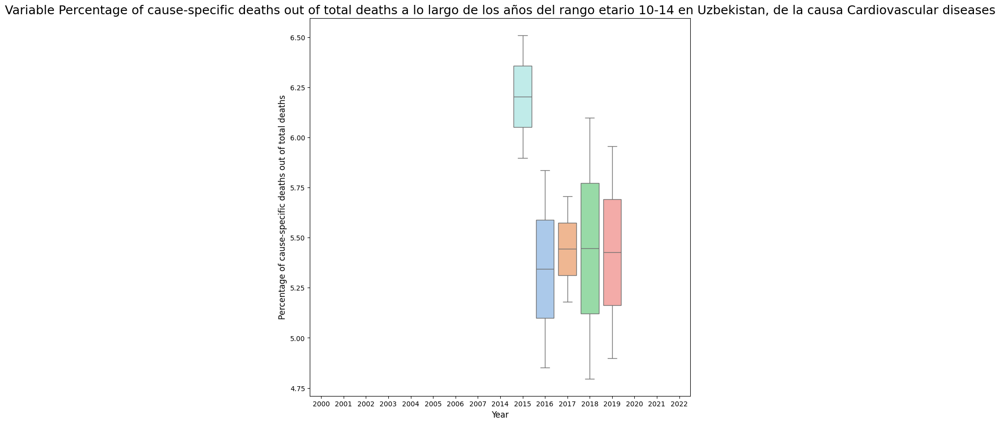

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


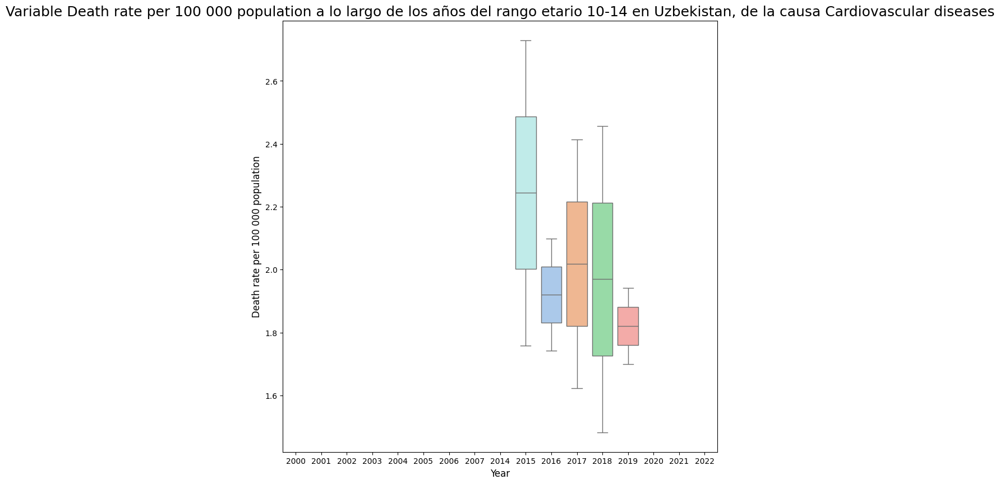

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


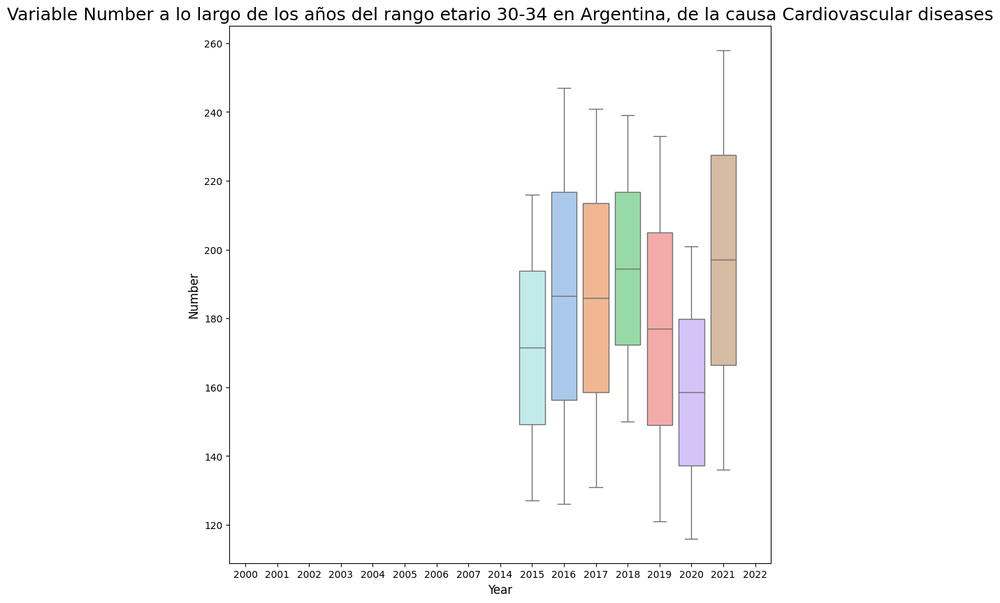

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


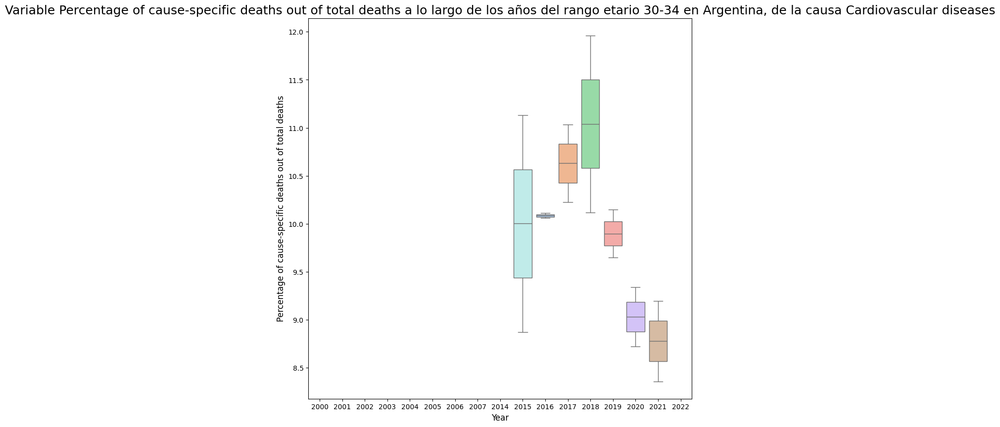

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


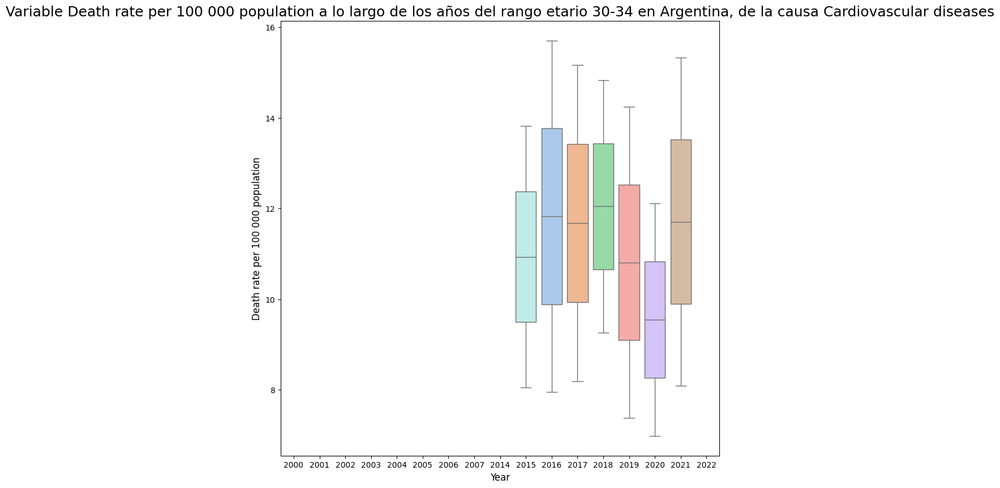

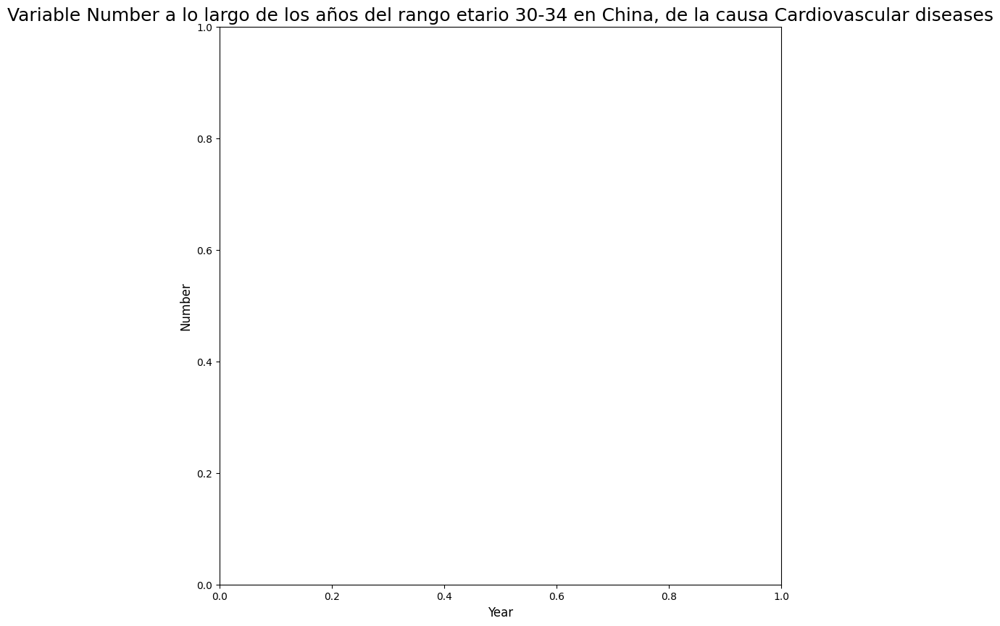

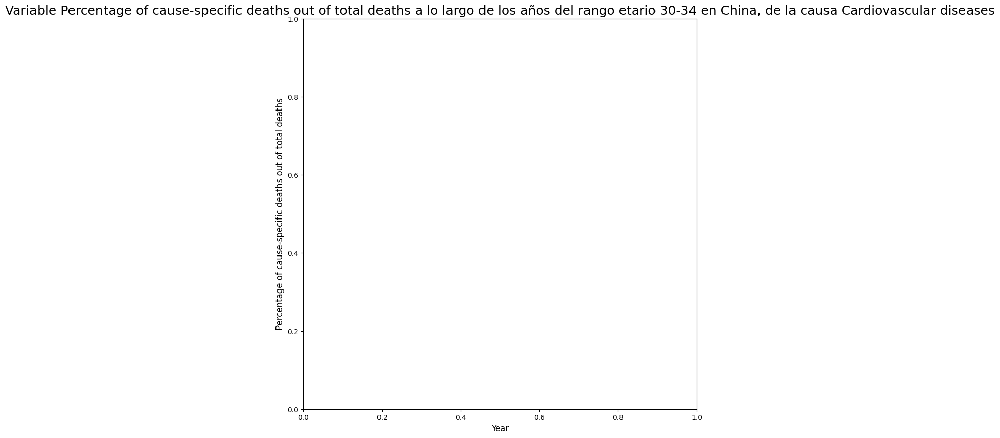

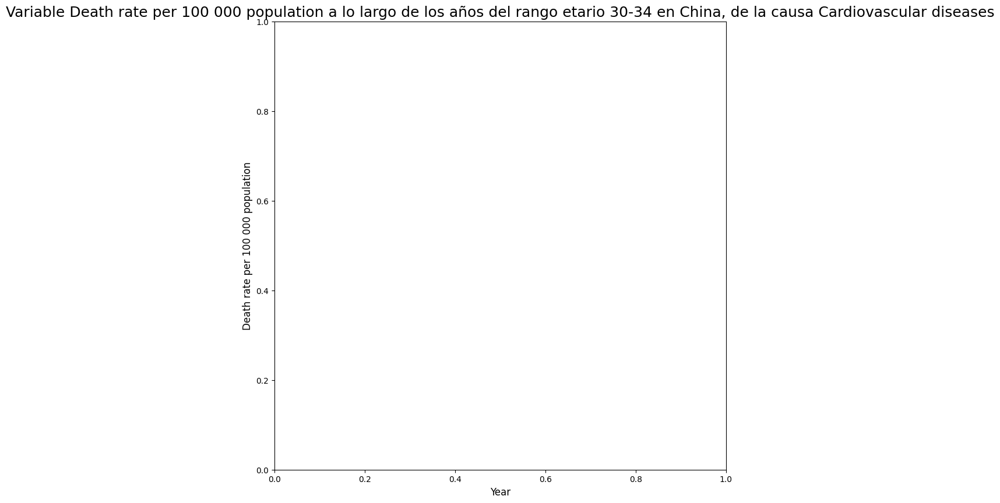

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


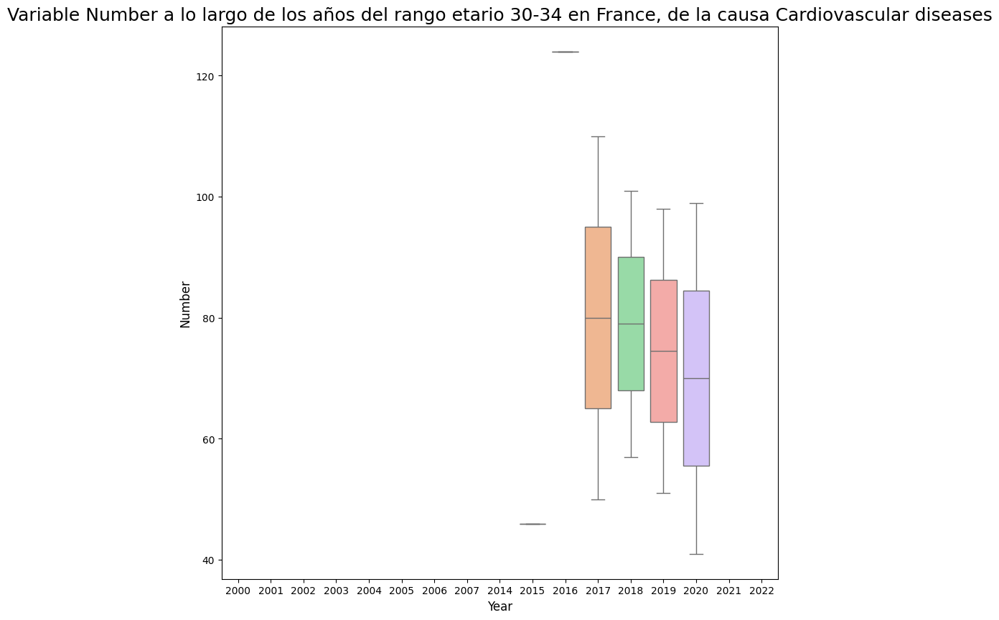

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


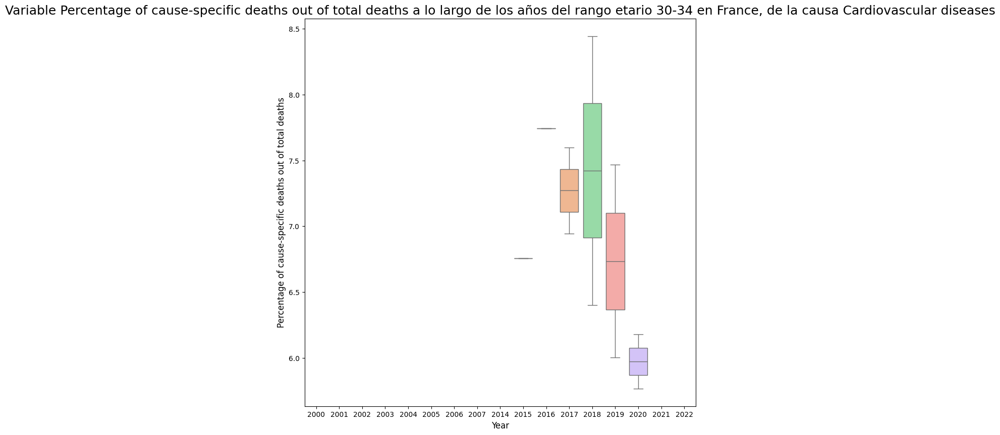

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


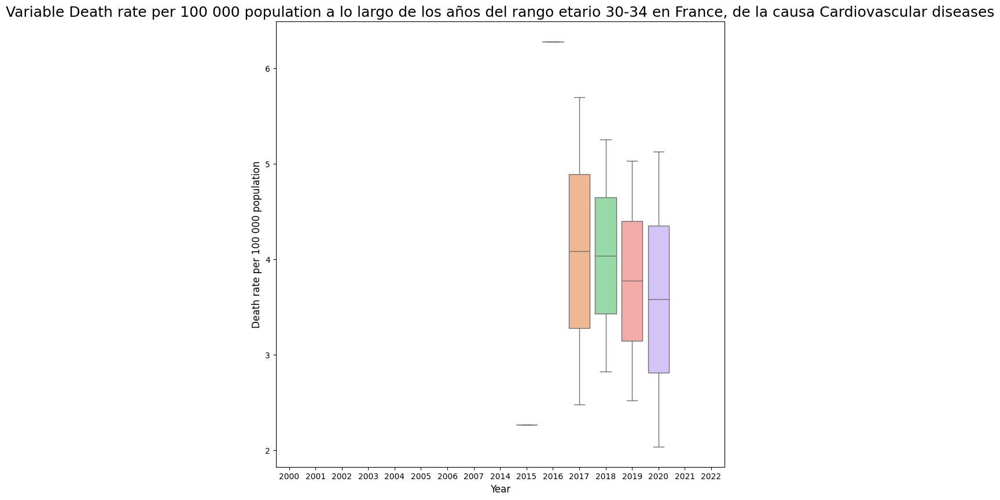

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


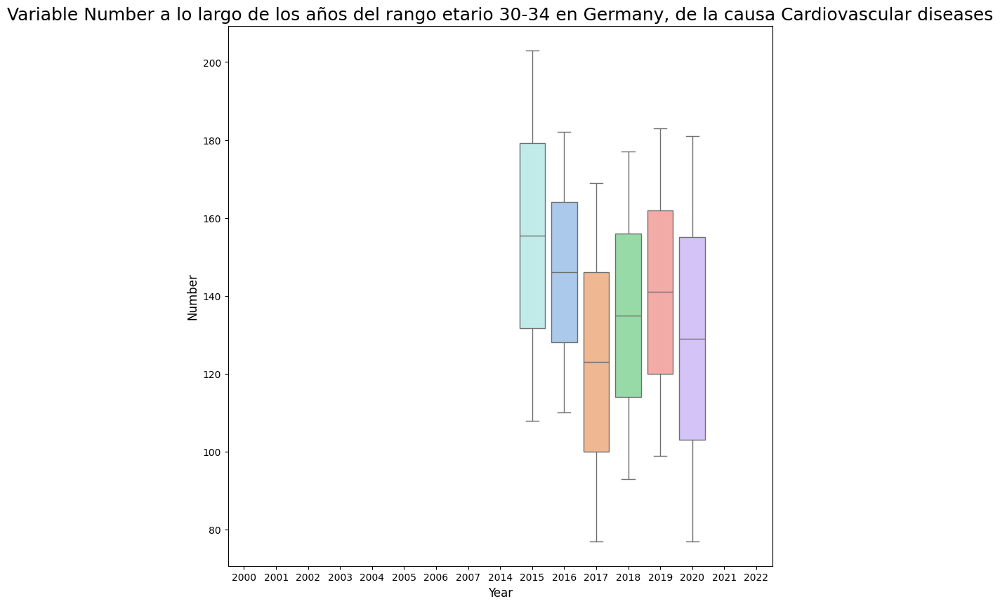

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


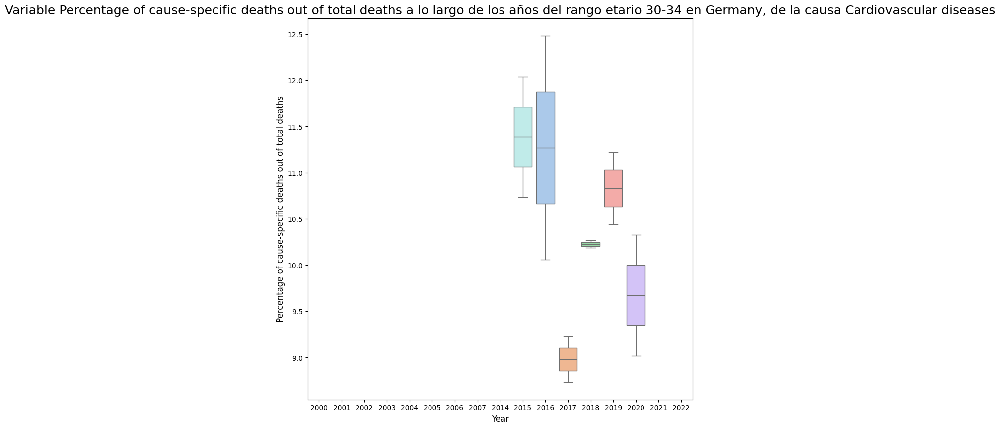

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


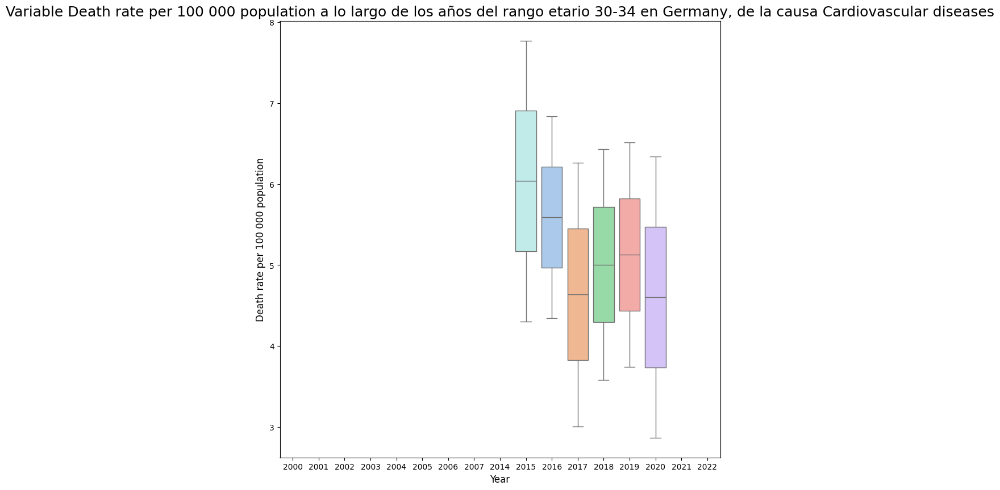

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


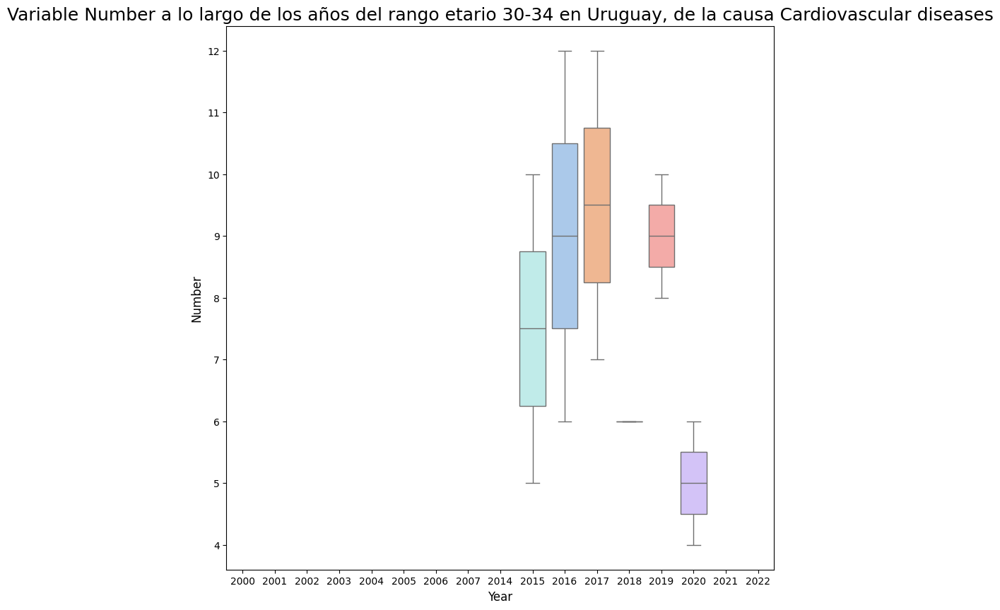

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


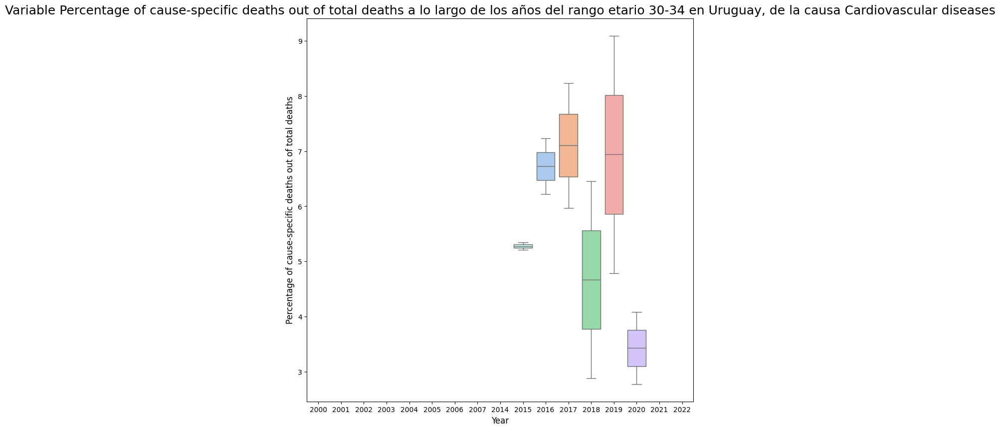

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


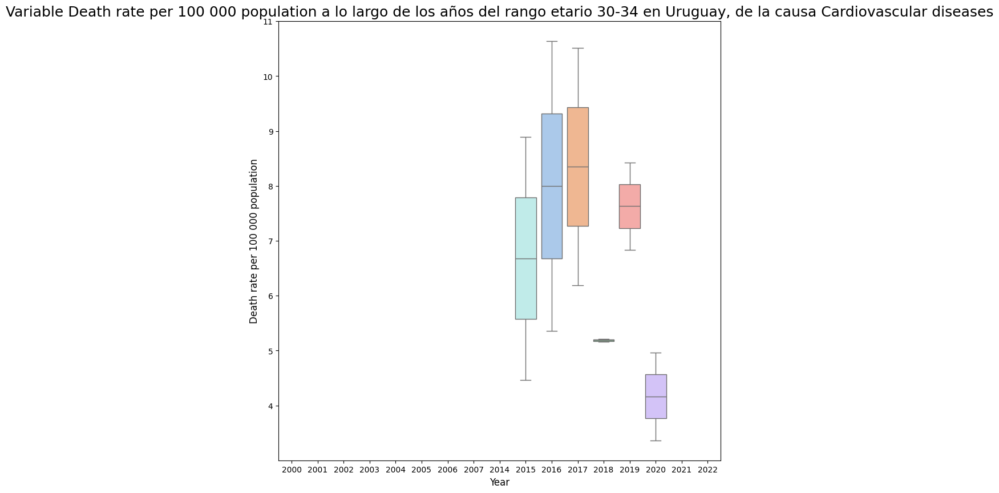

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


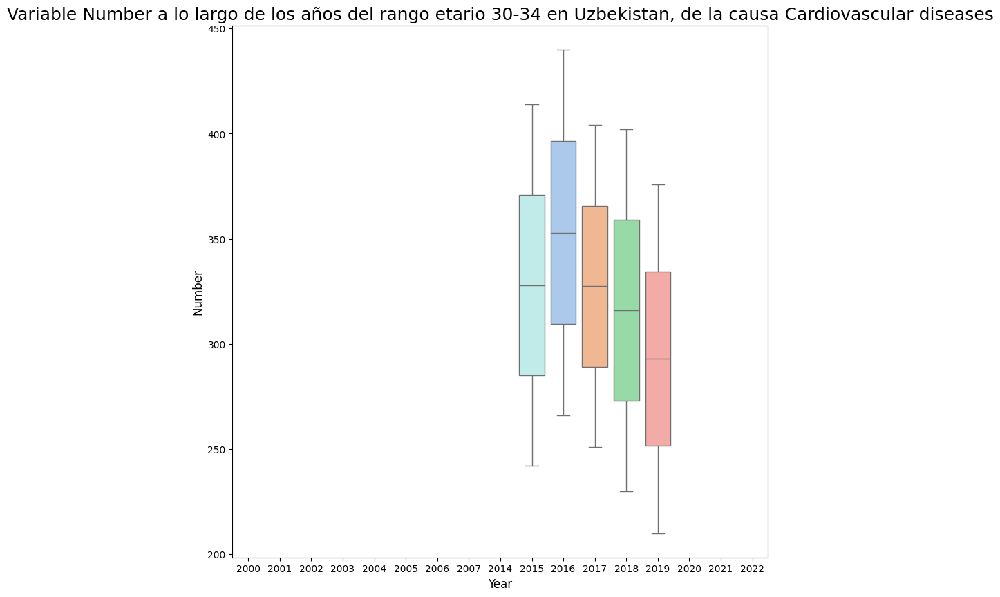

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


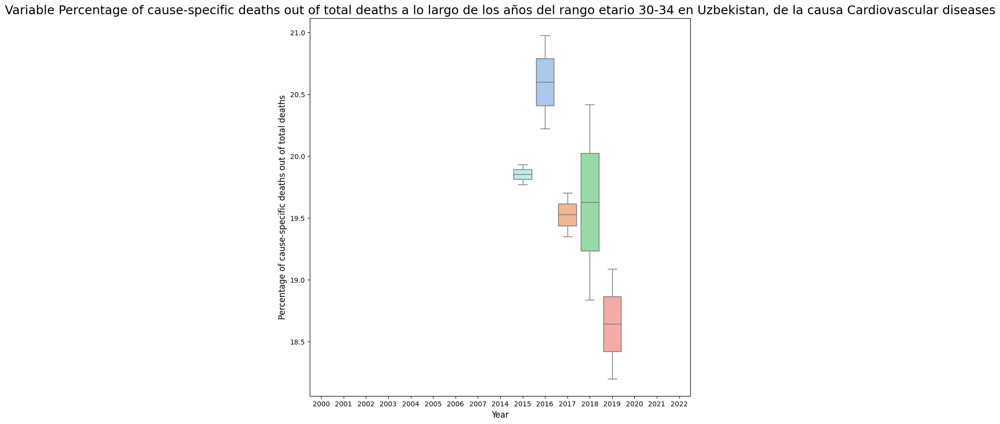

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


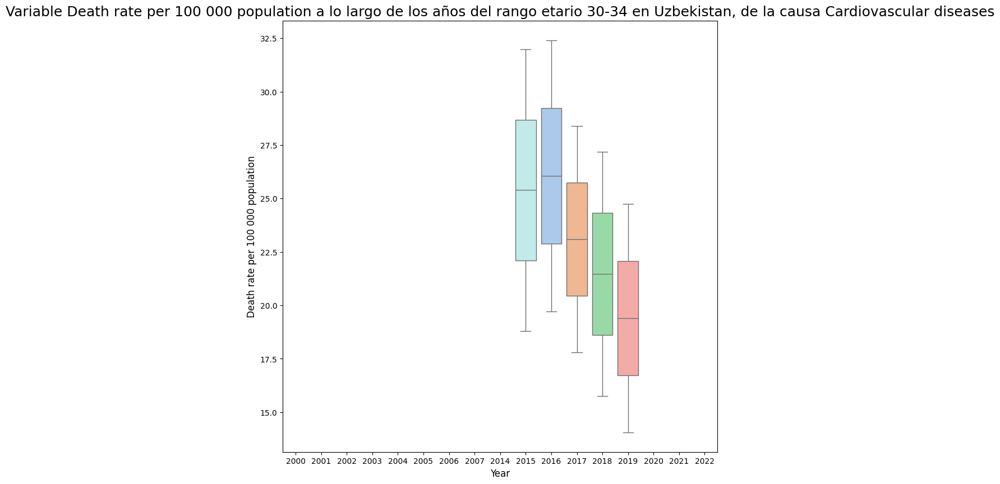

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


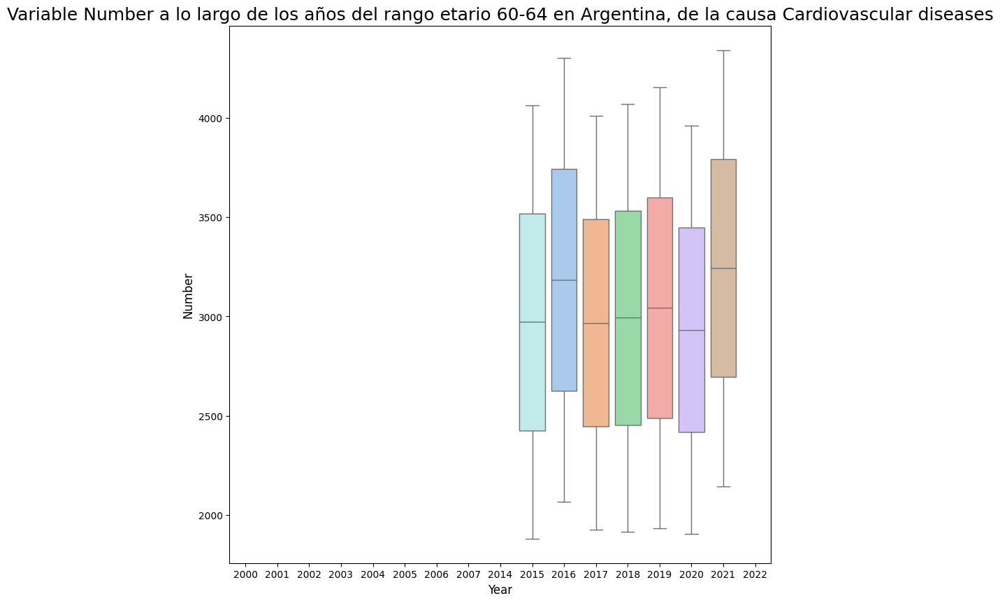

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


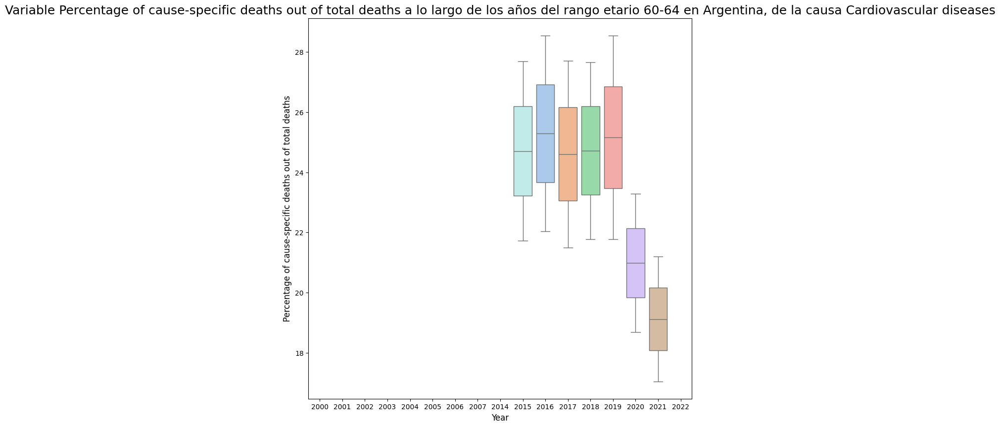

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


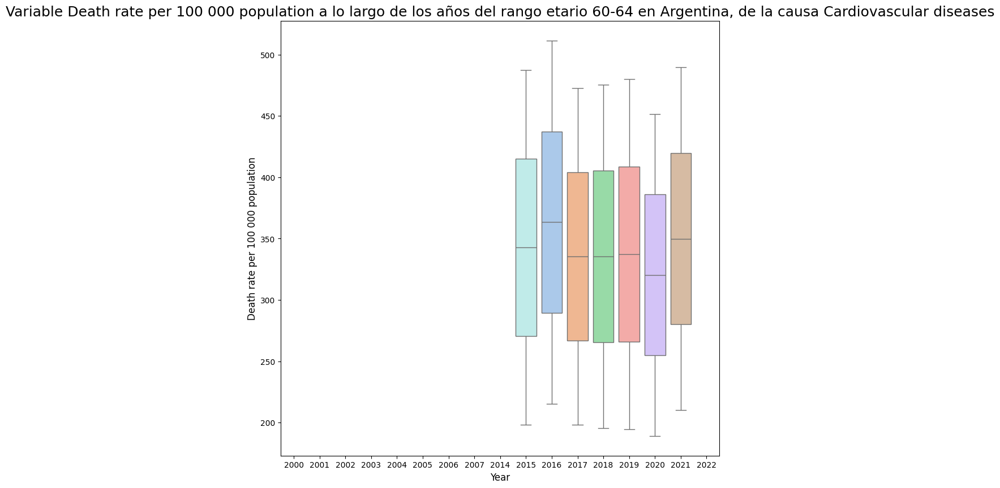

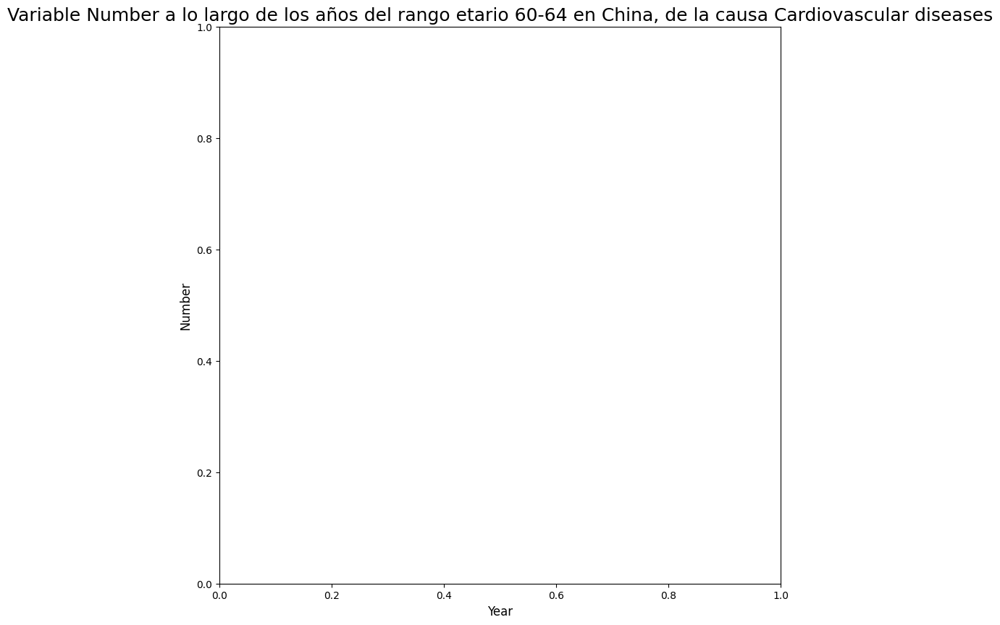

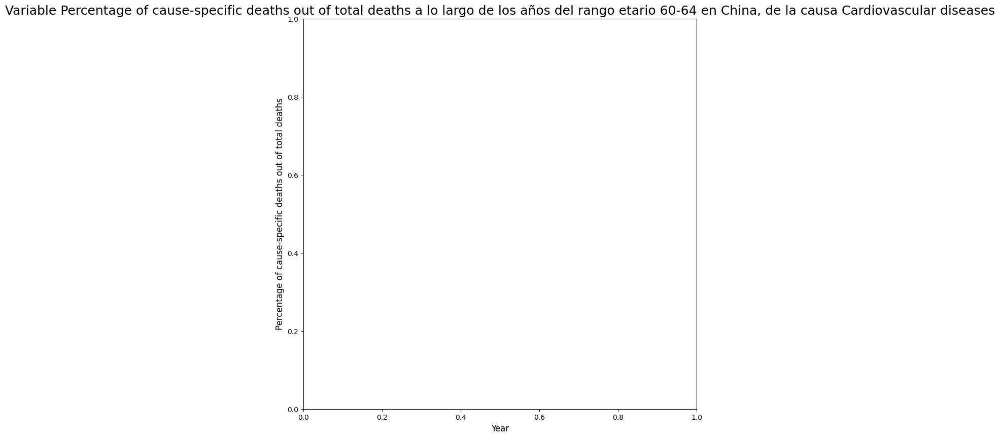

In [ ]:
for age_group in age_groups_acotado:
  boxplot_continuous_variables_without_economic_information(df_cardiovascular_diseases, age_group, "Cardiovascular diseases")

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


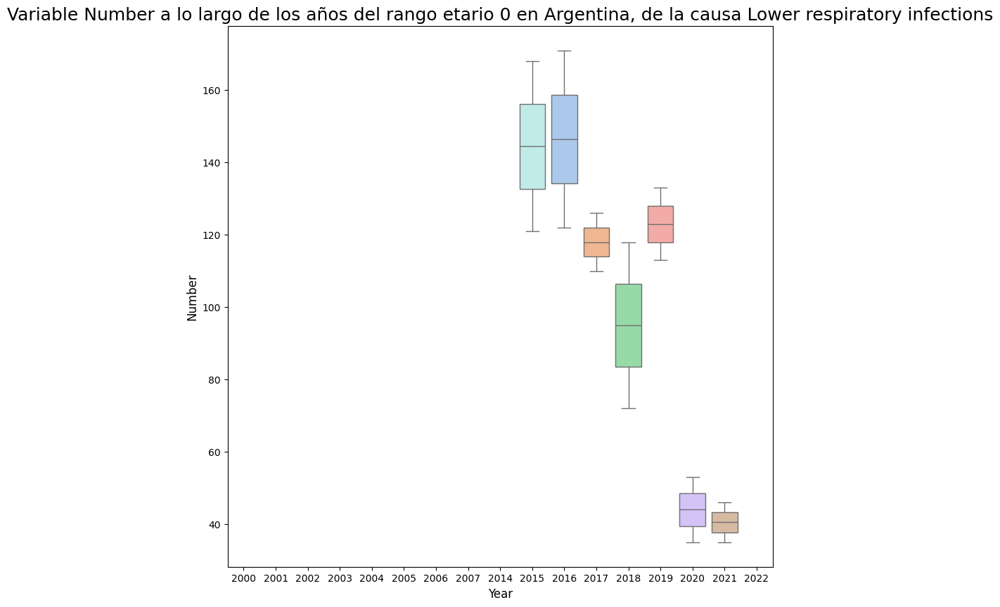

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


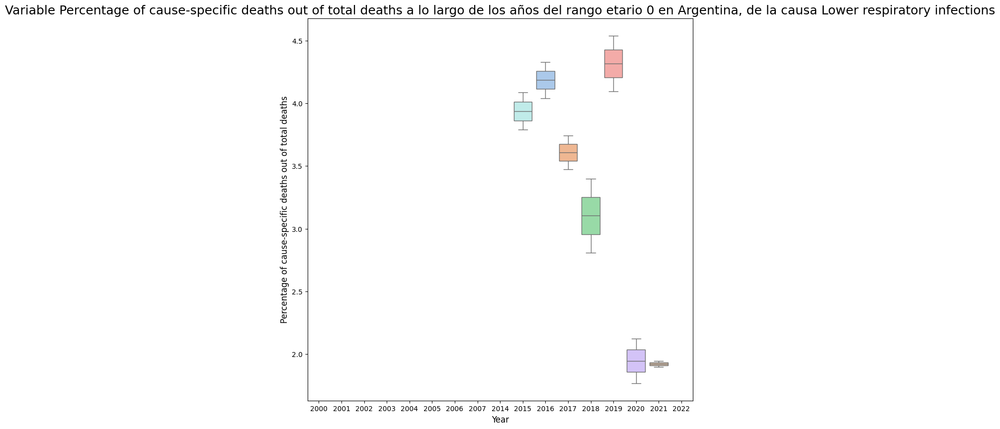

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


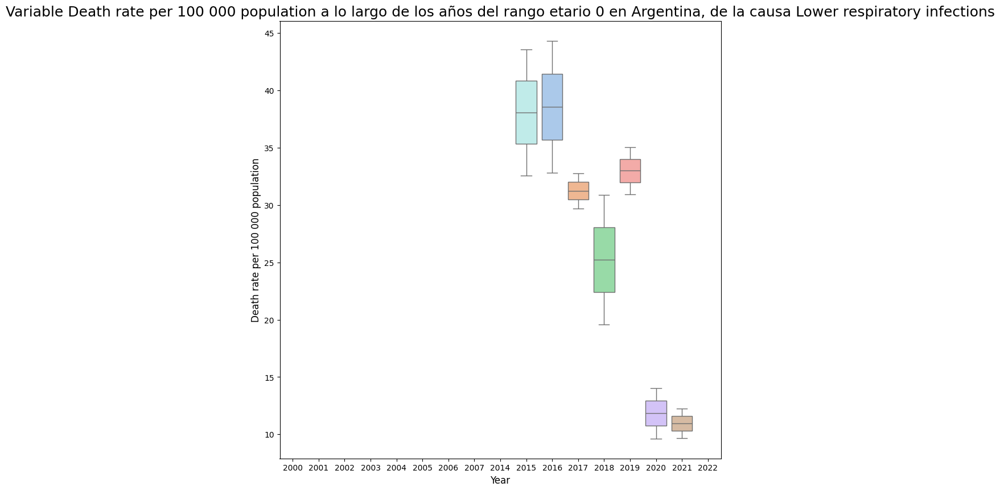

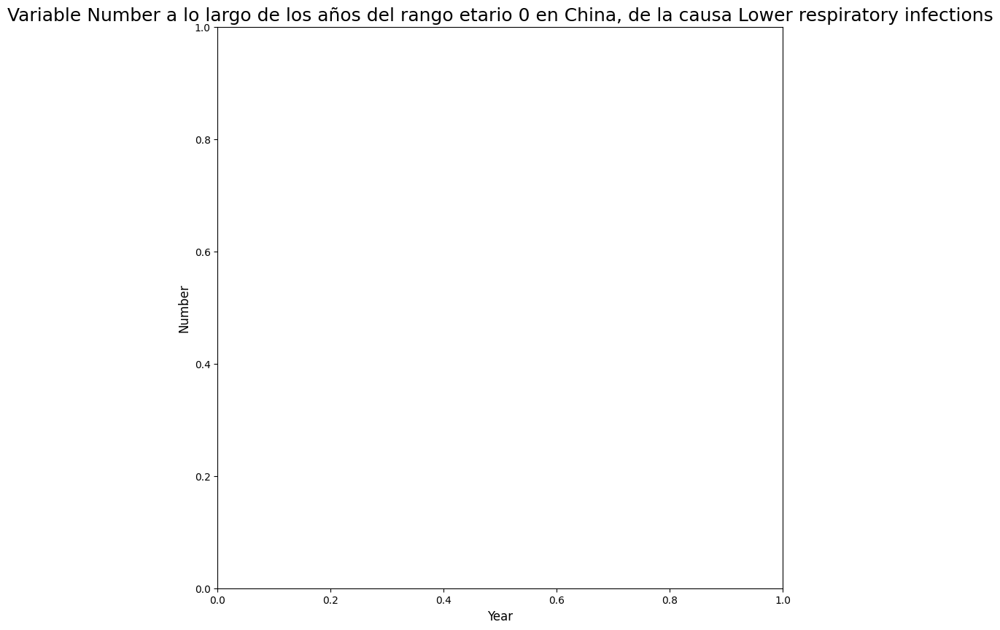

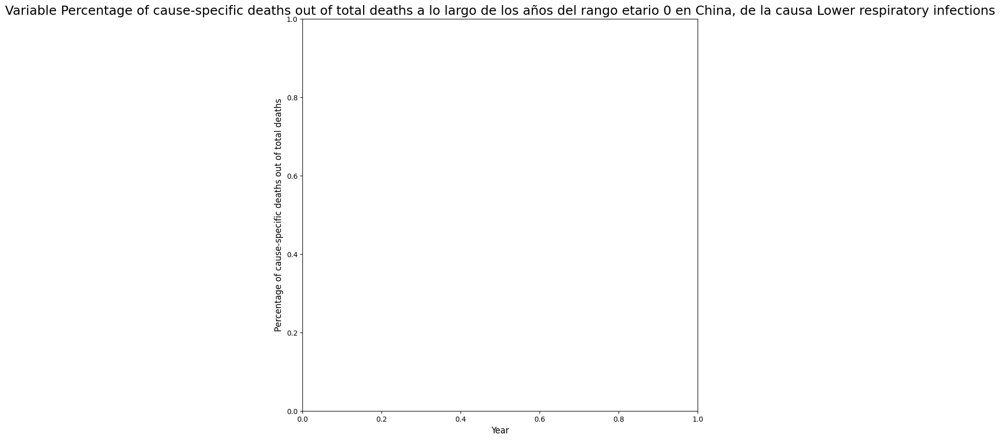

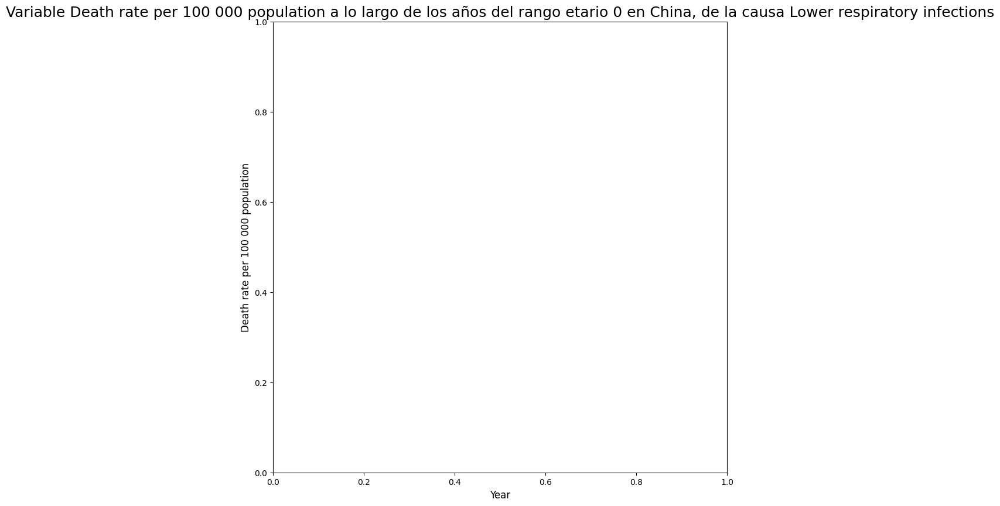

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


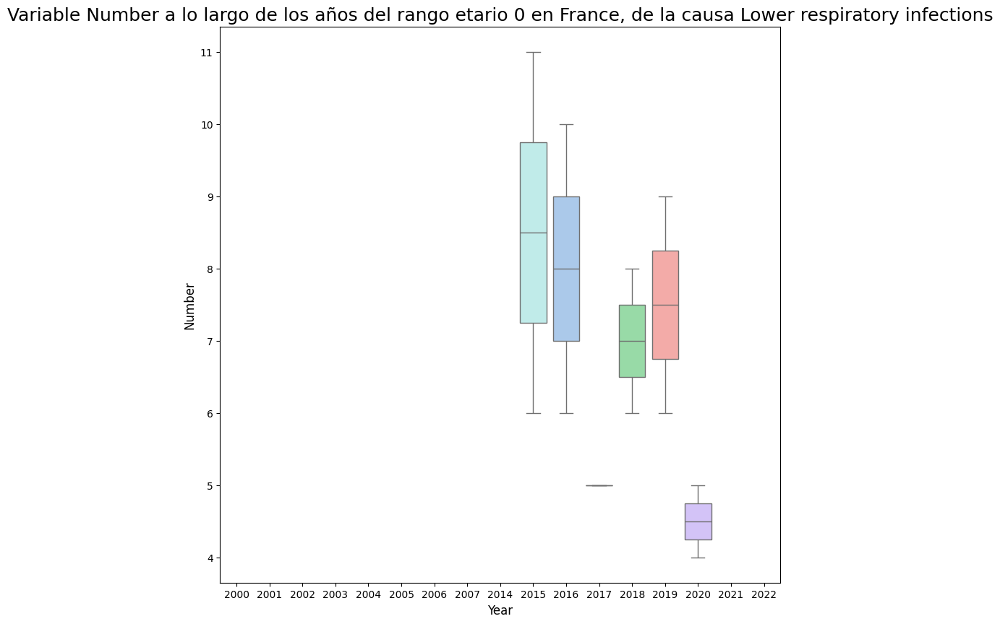

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


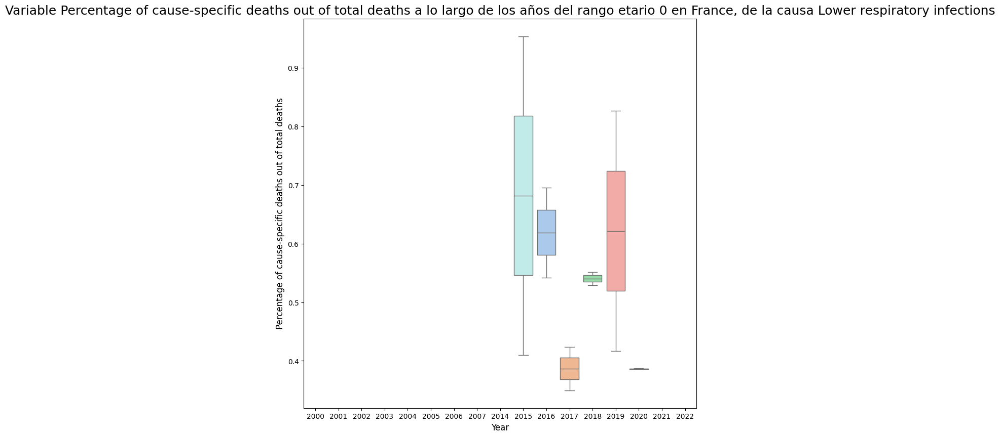

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


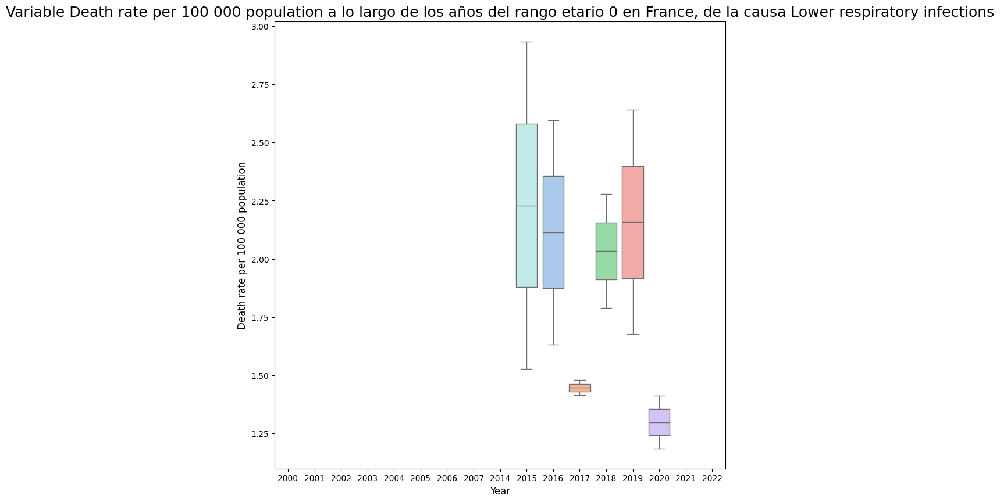

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


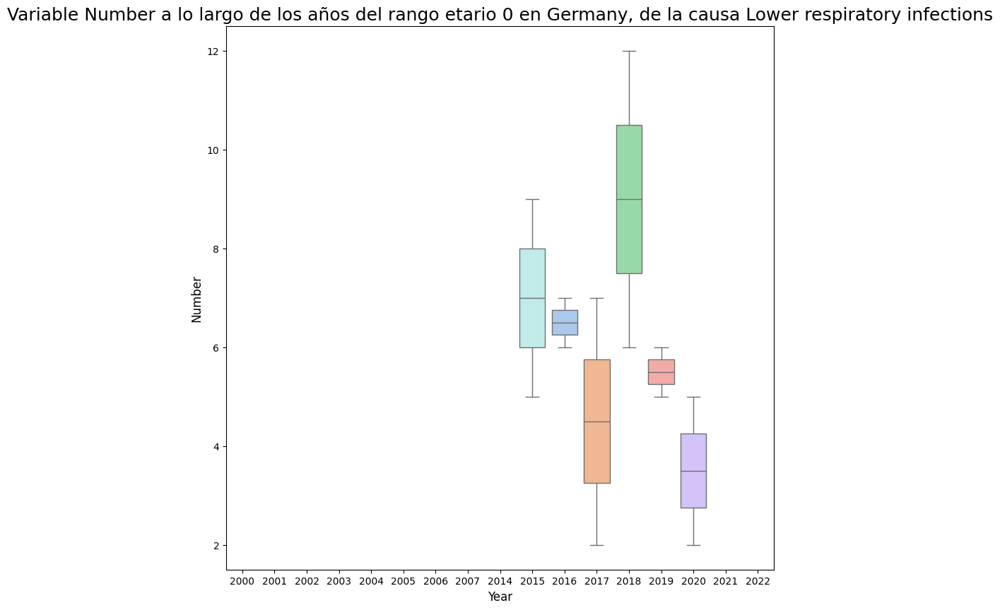

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


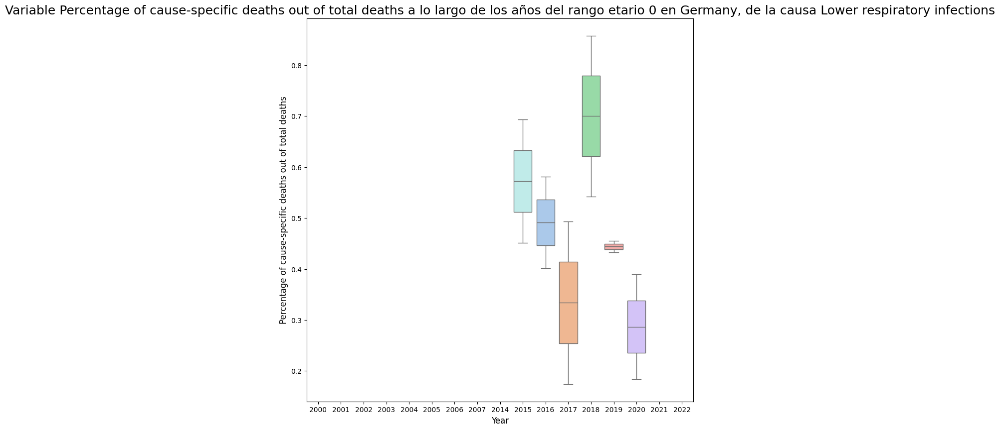

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


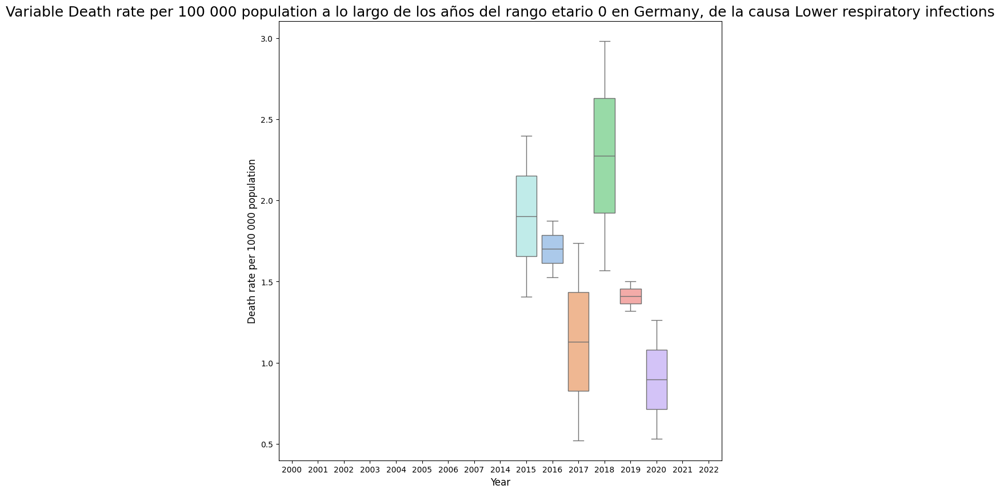

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


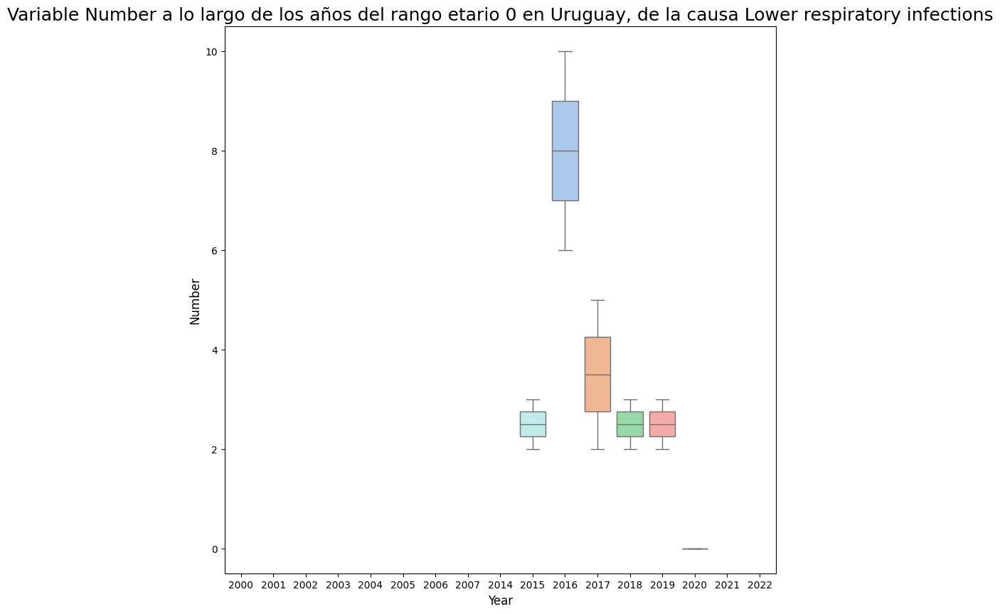

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


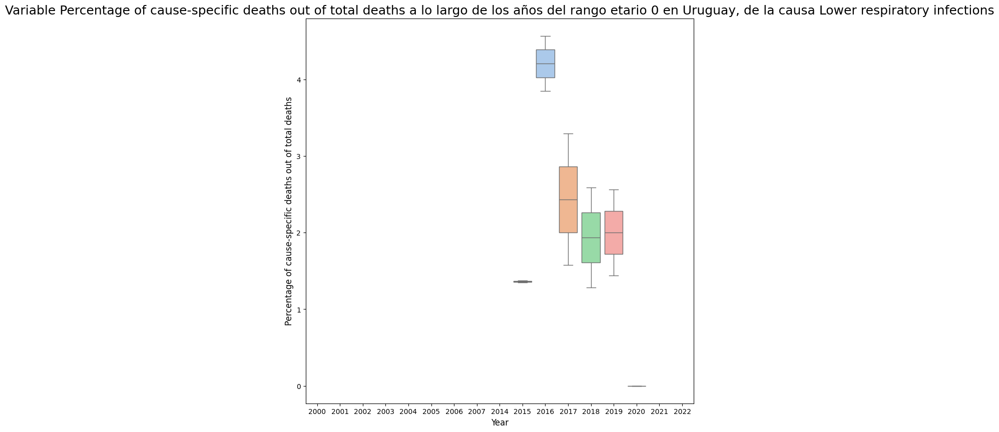

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


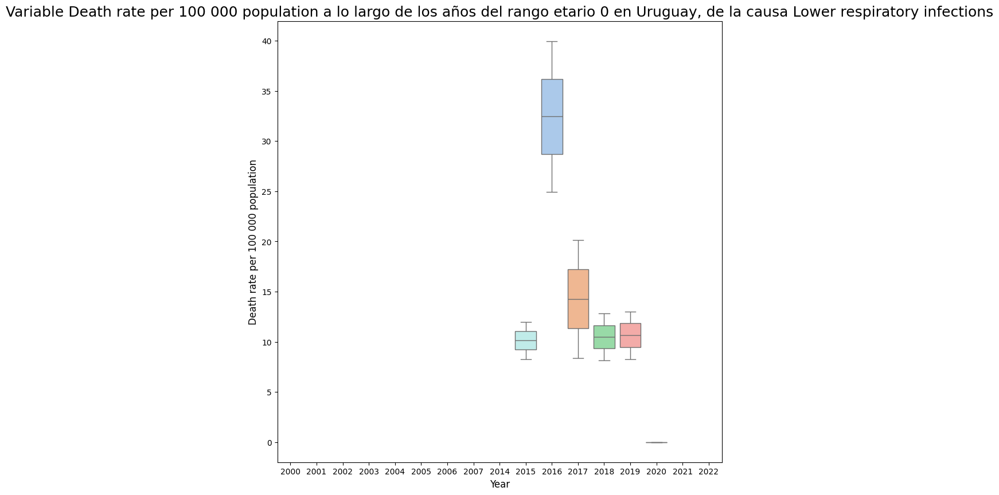

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


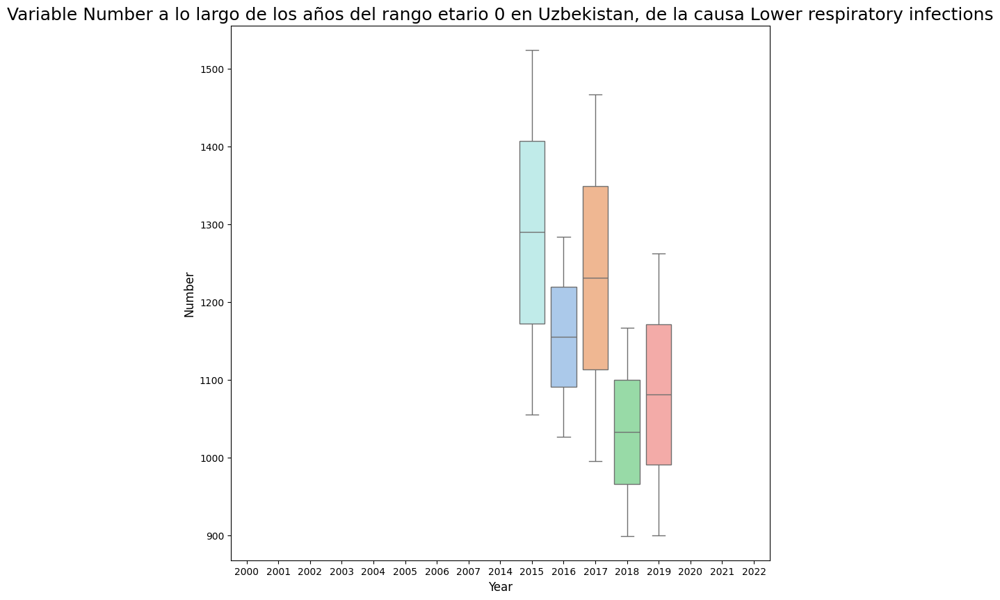

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


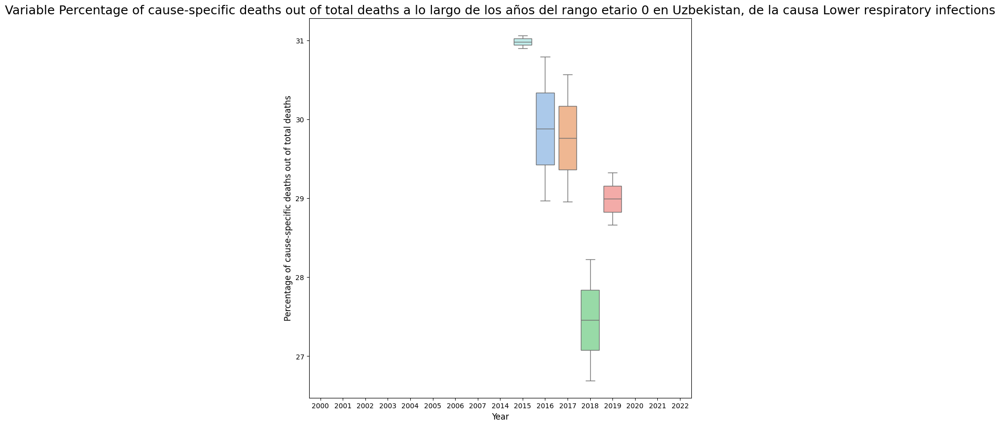

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


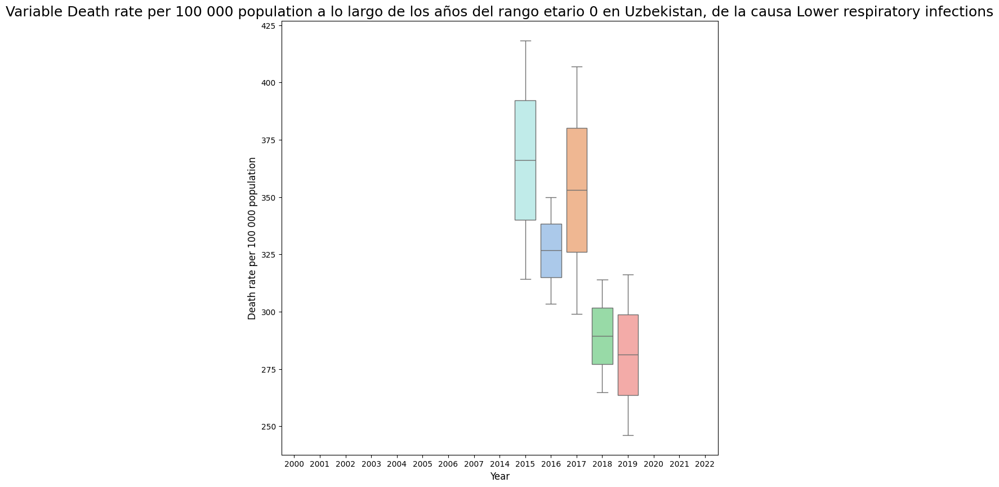

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


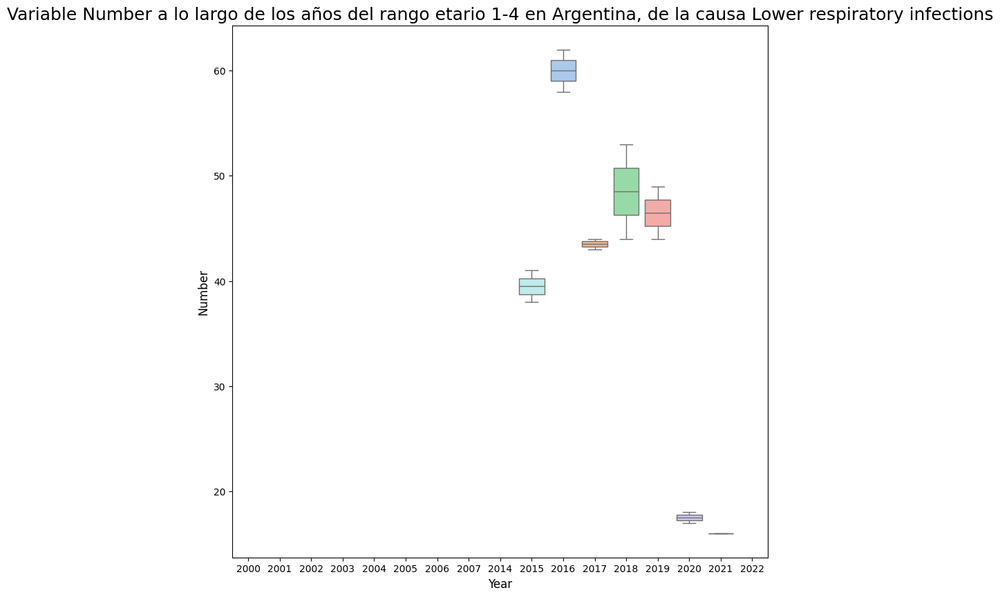

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


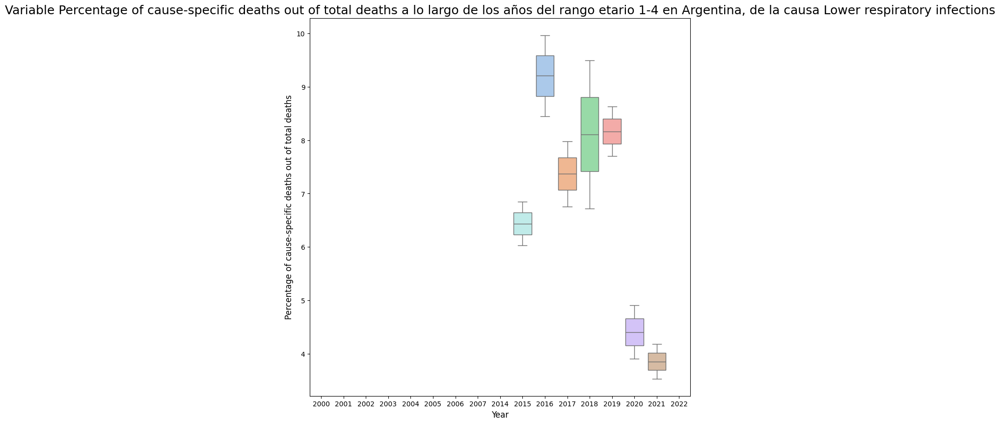

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


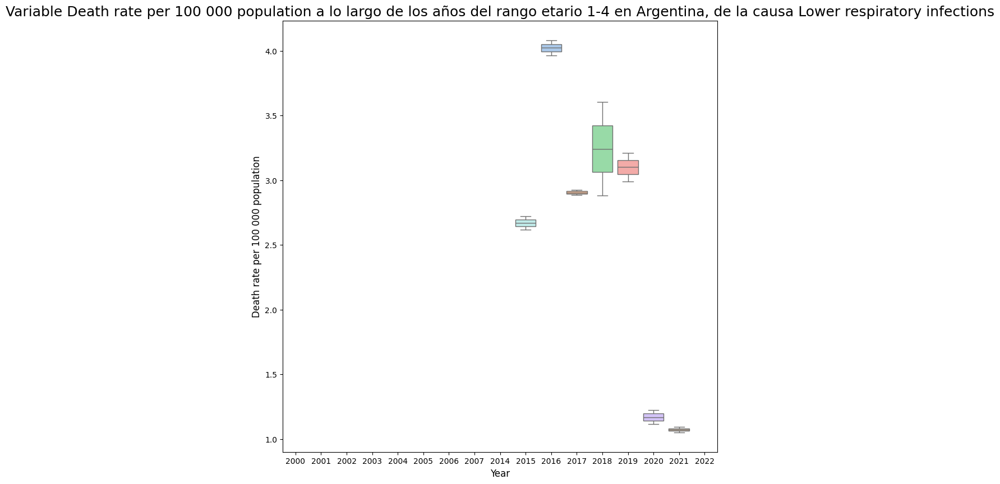

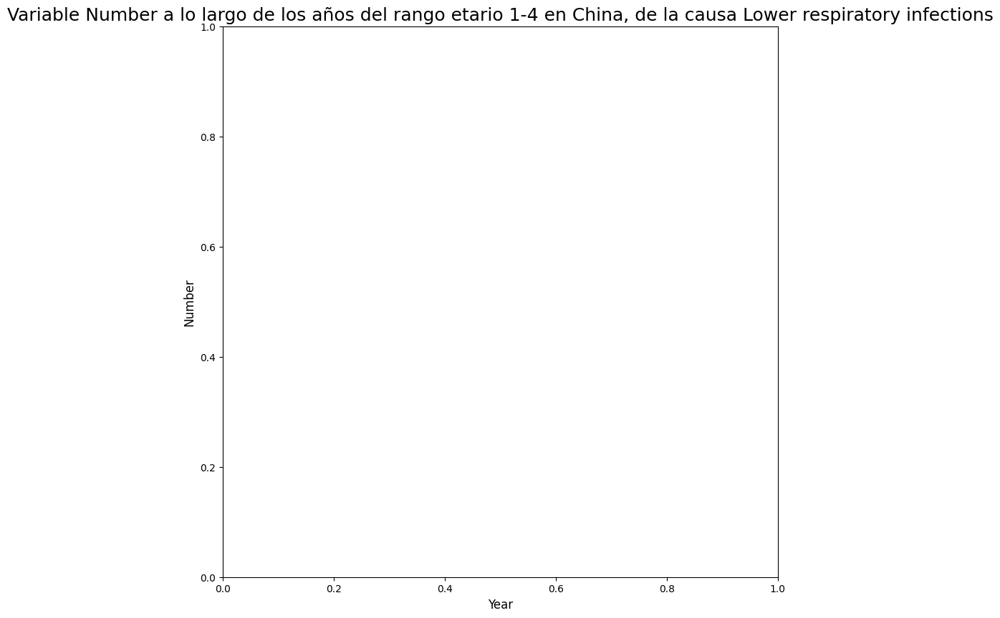

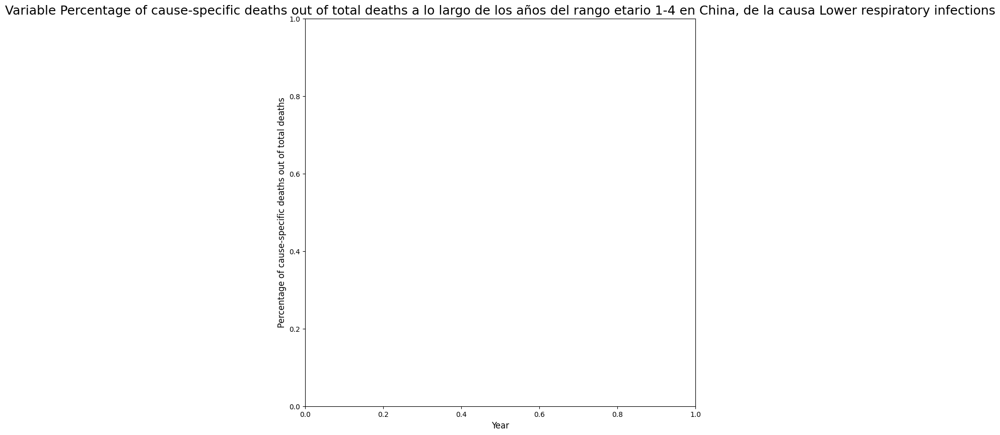

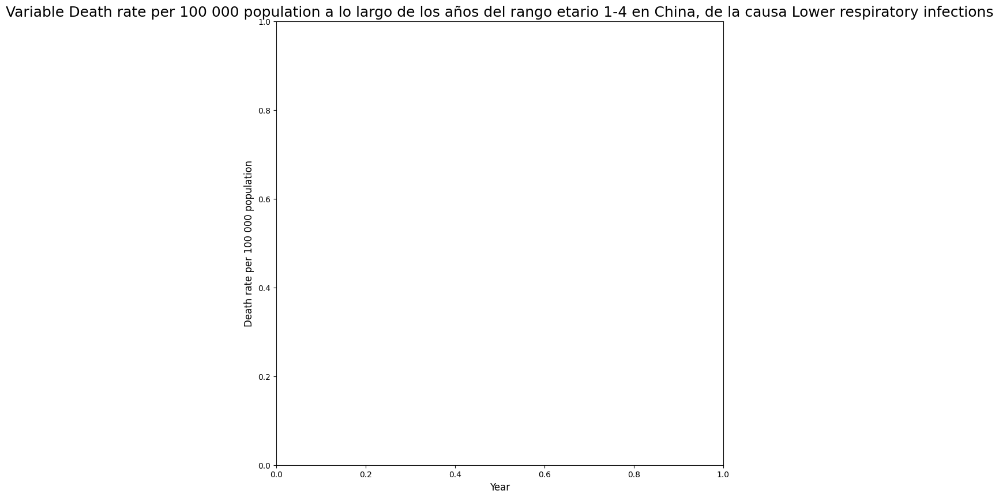

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


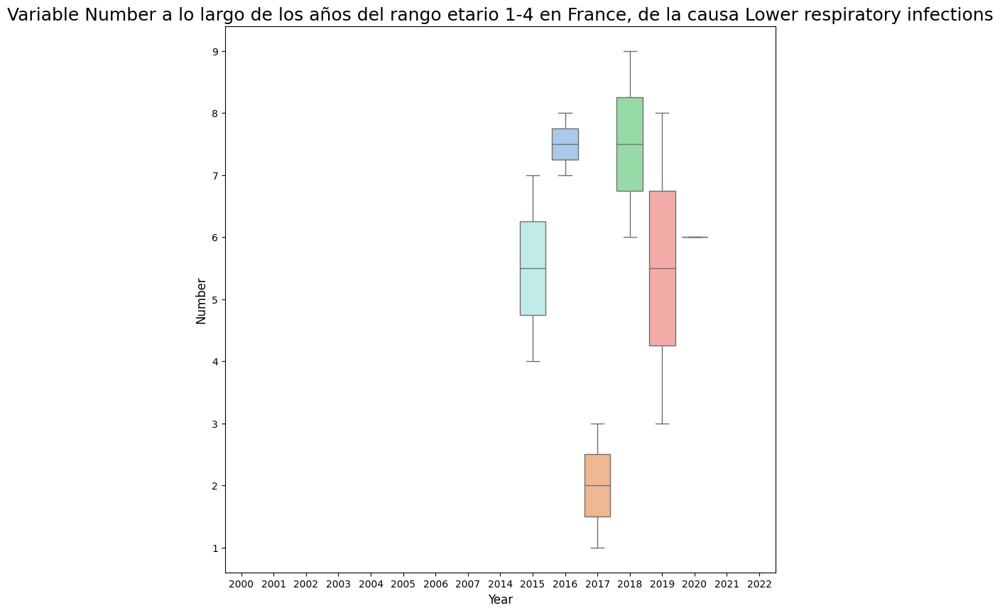

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


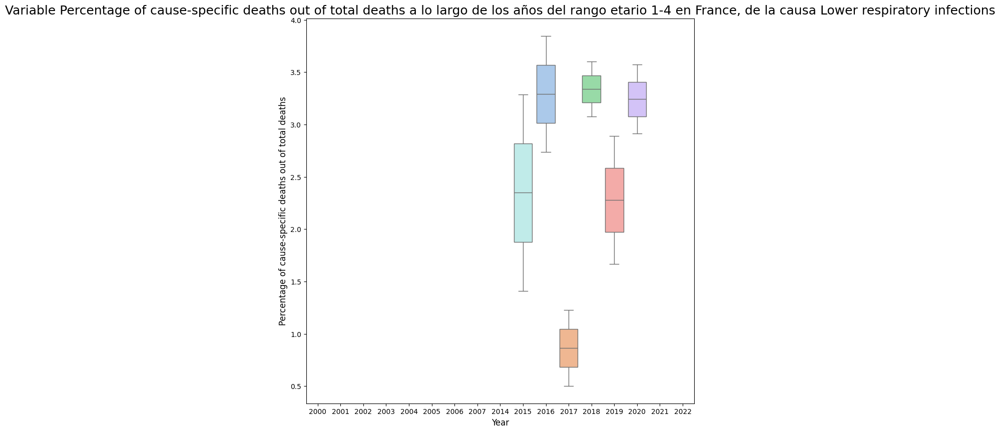

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


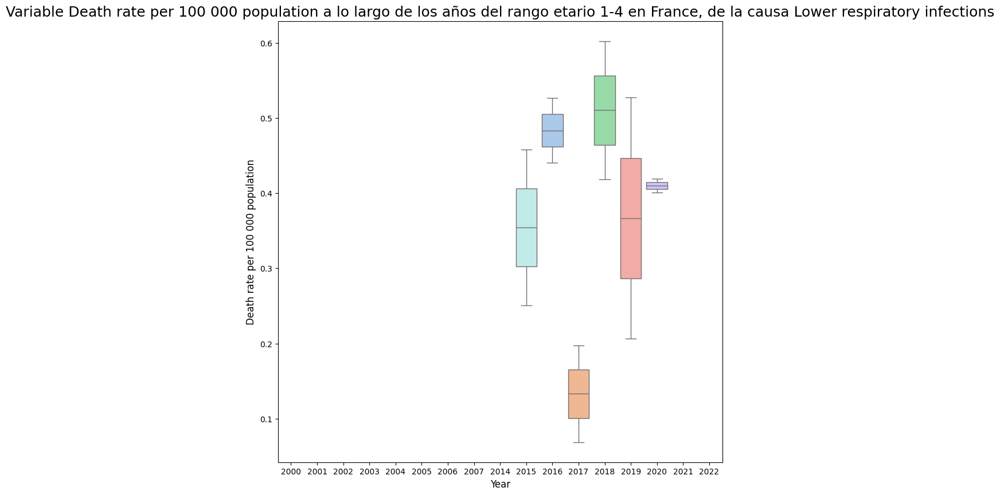

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


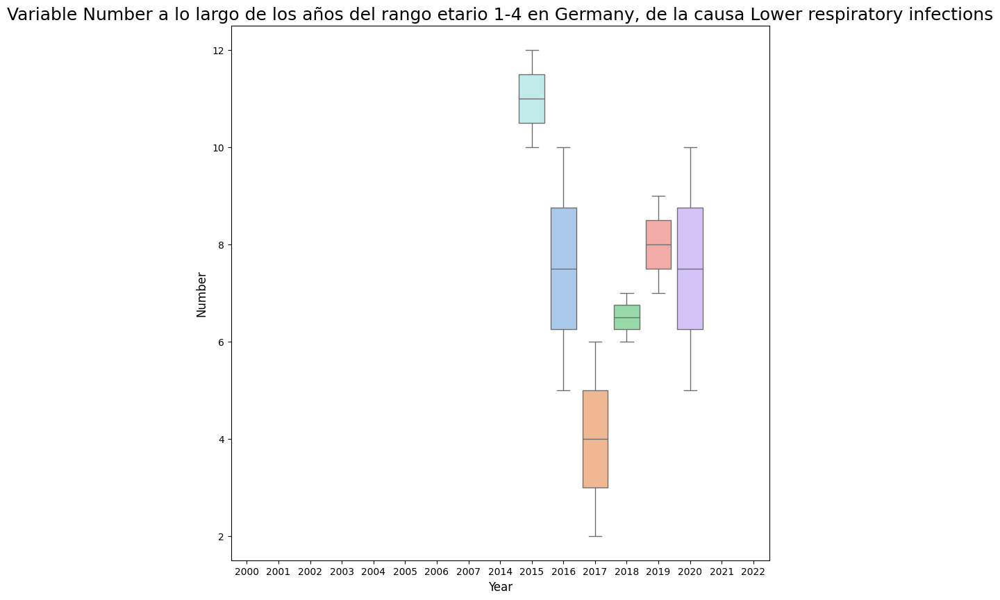

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


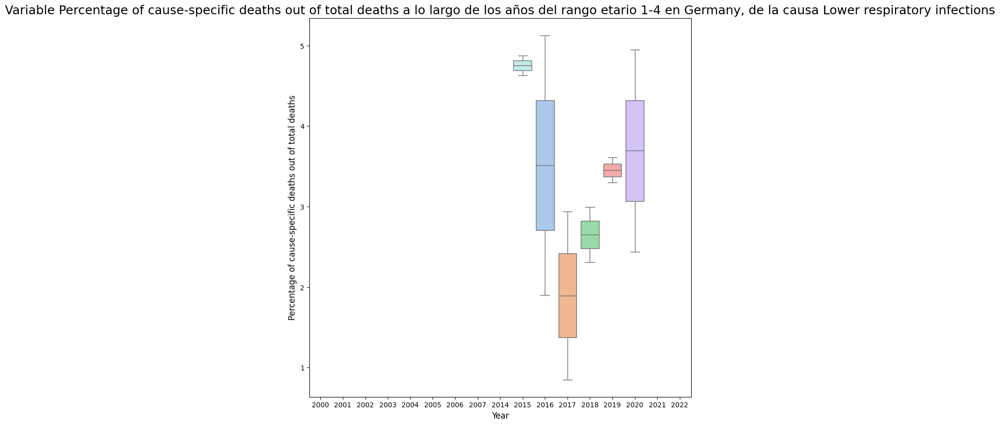

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


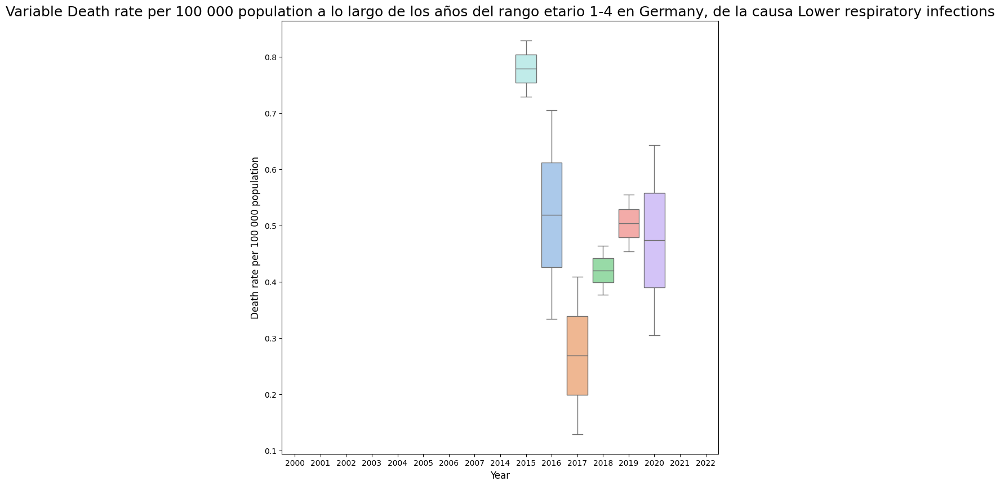

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


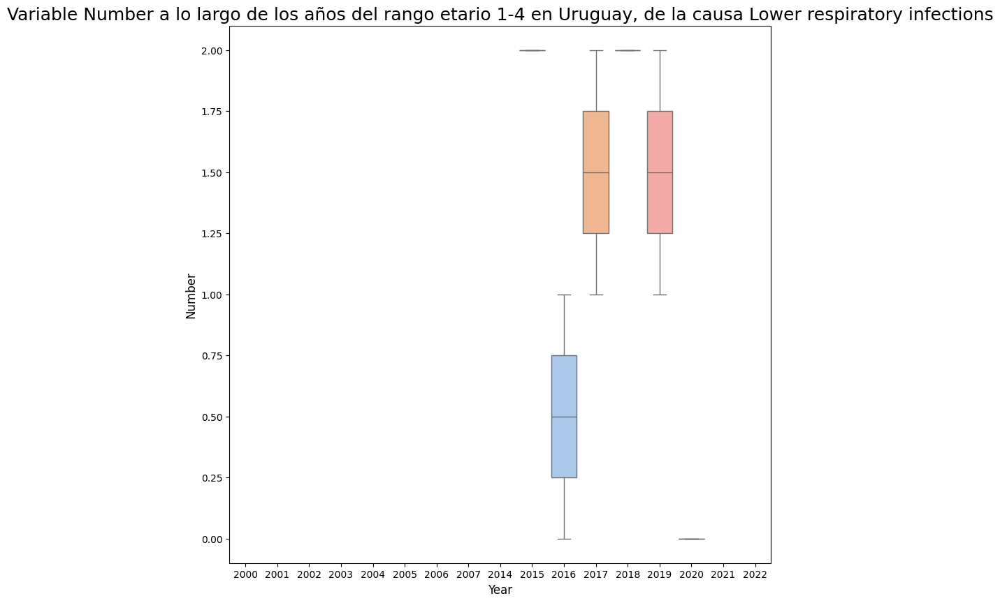

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


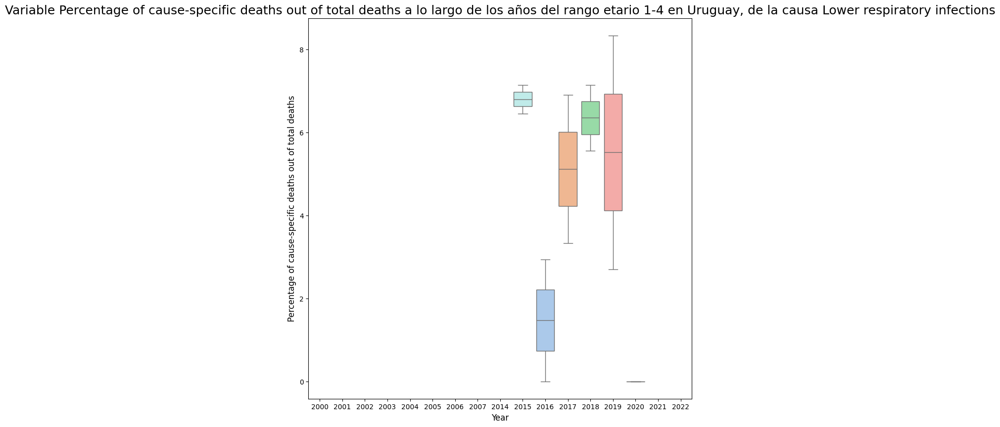

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


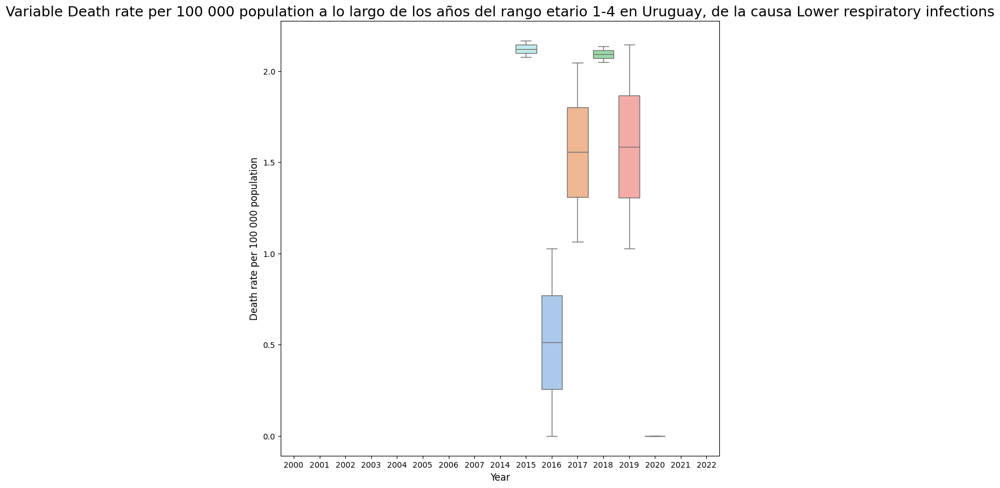

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


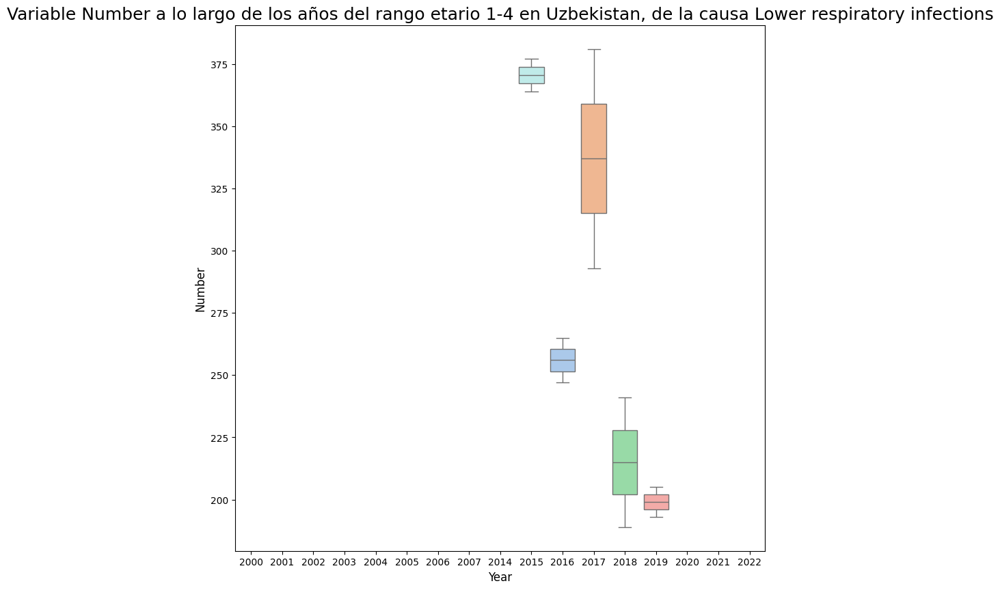

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


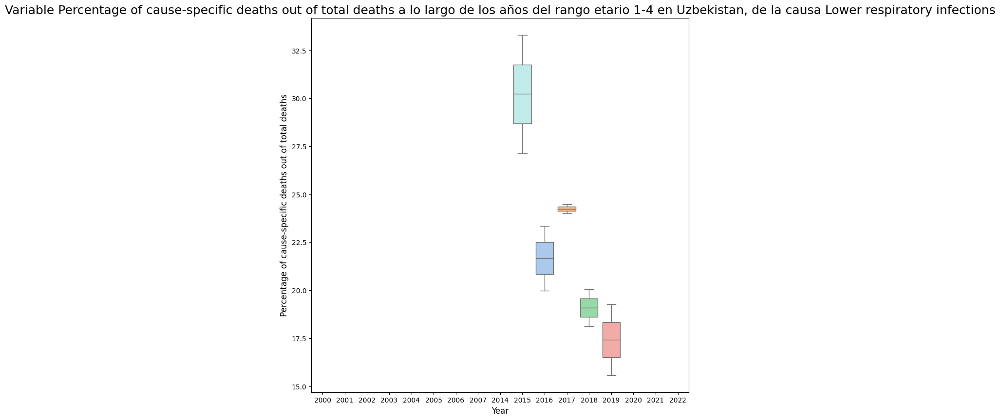

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


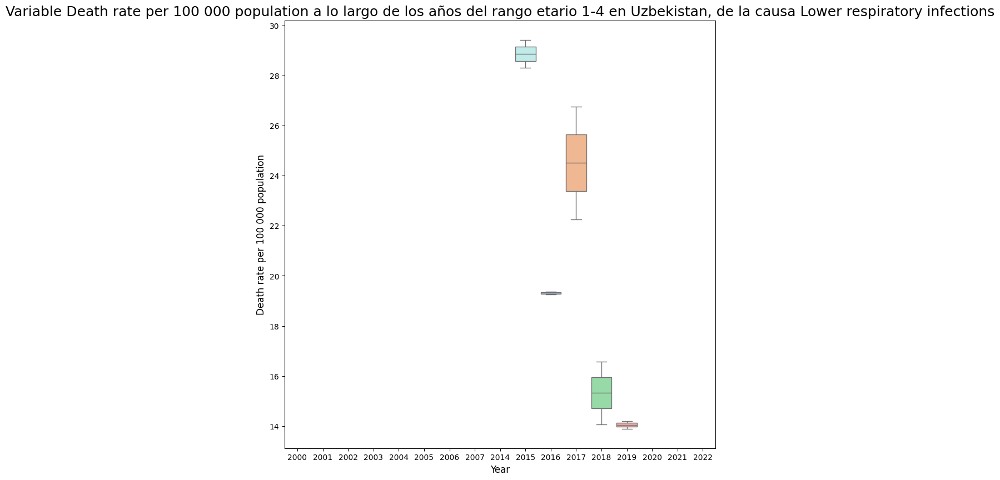

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


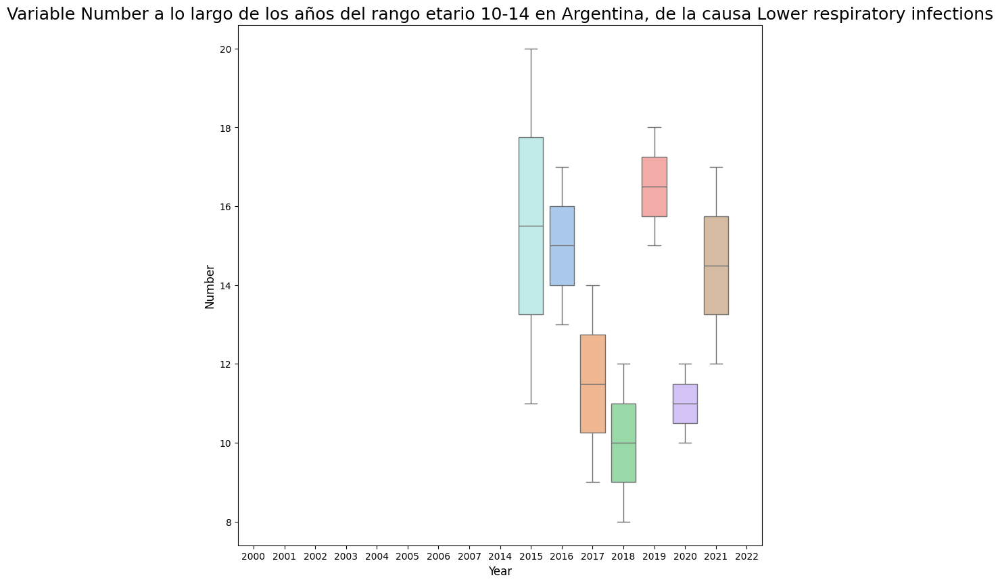

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


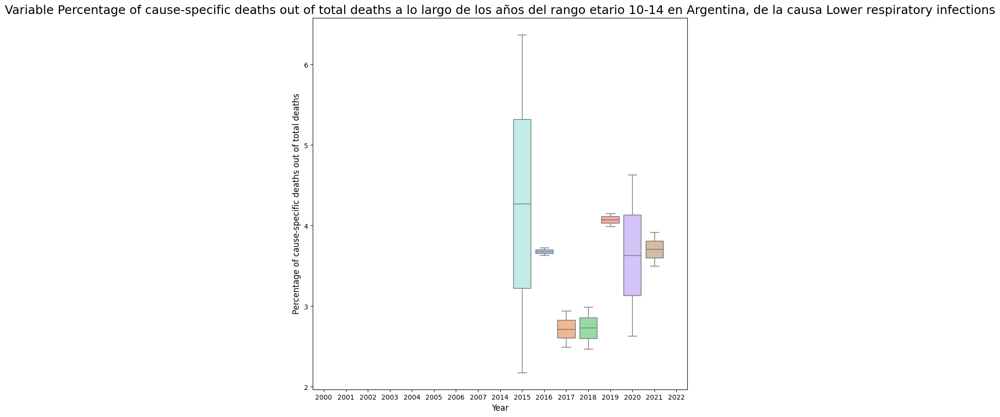

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


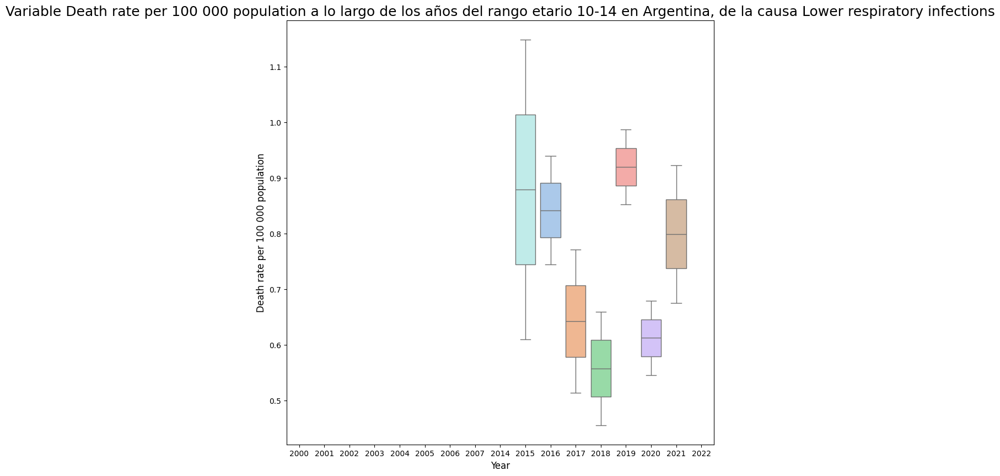

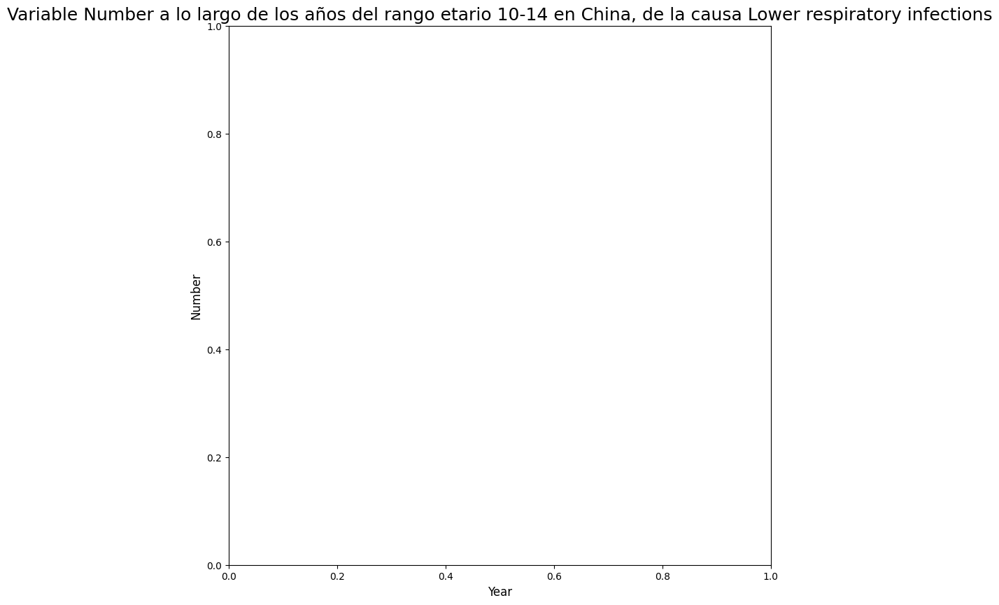

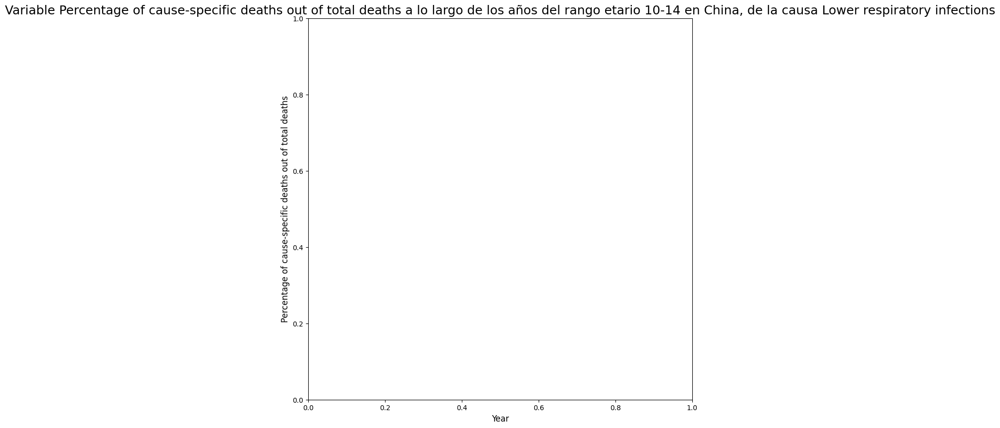

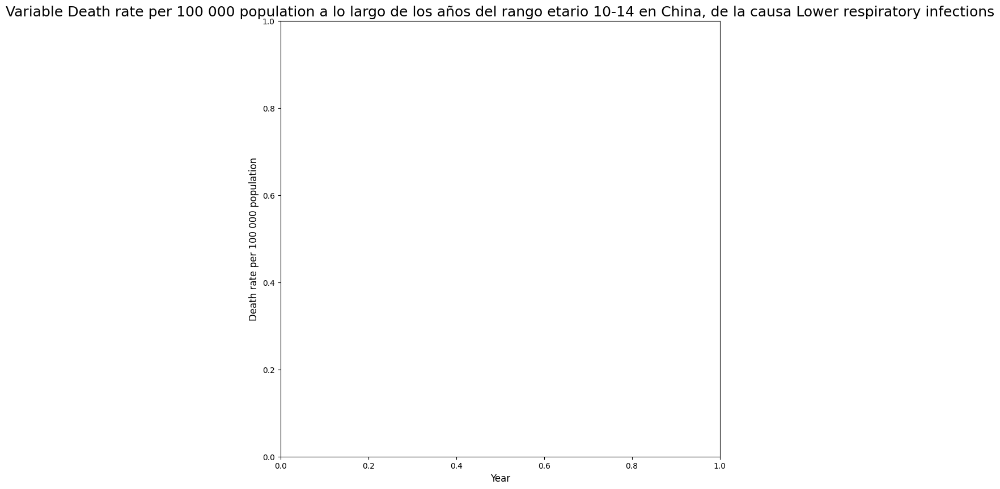

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


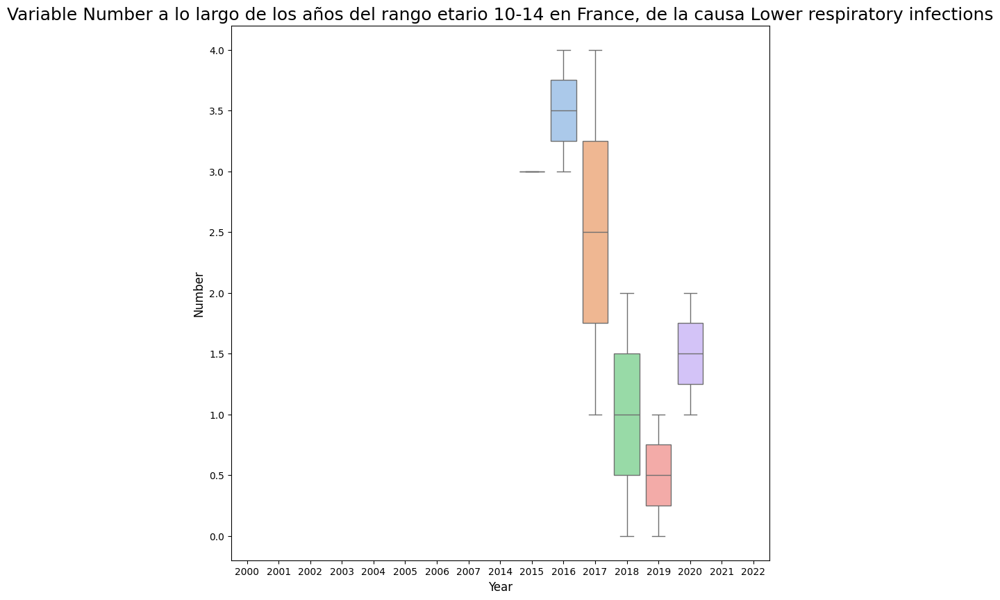

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


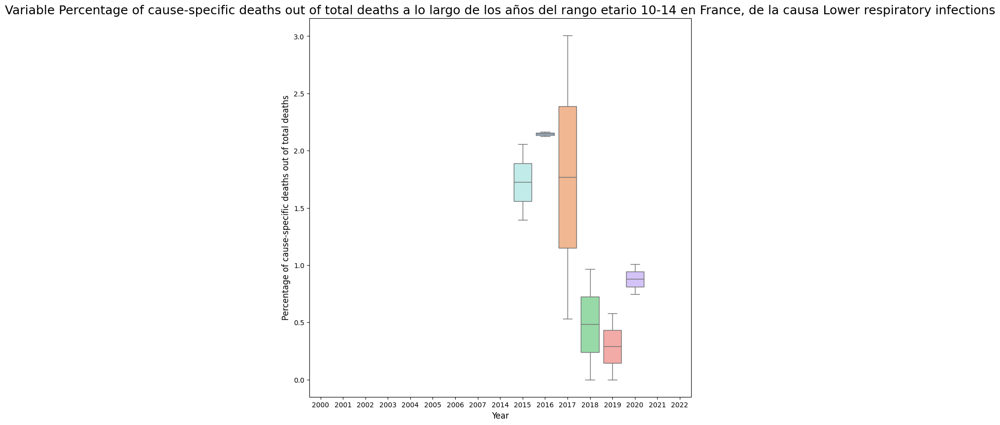

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


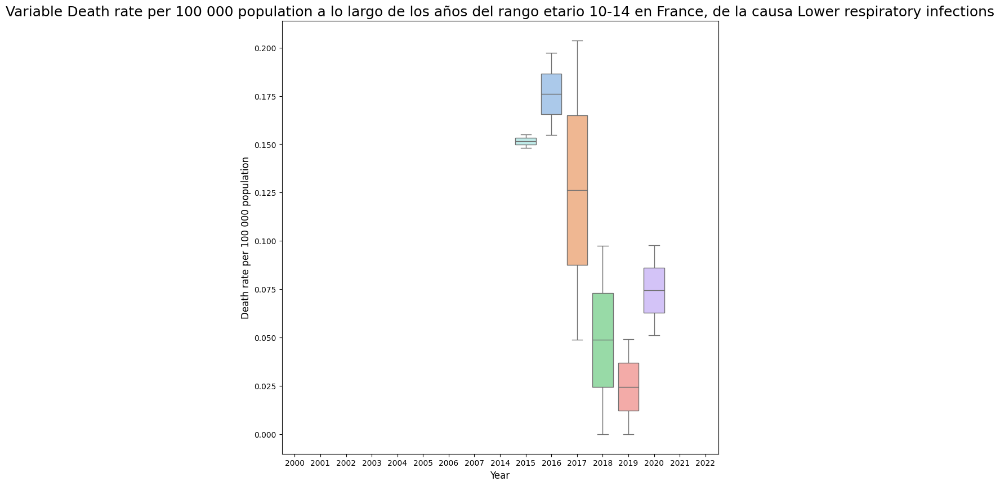

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


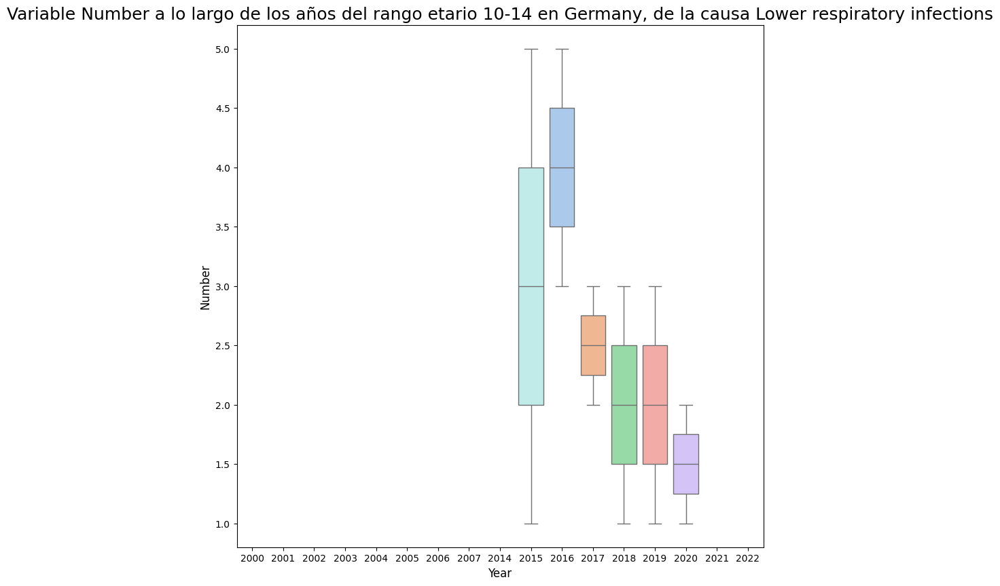

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


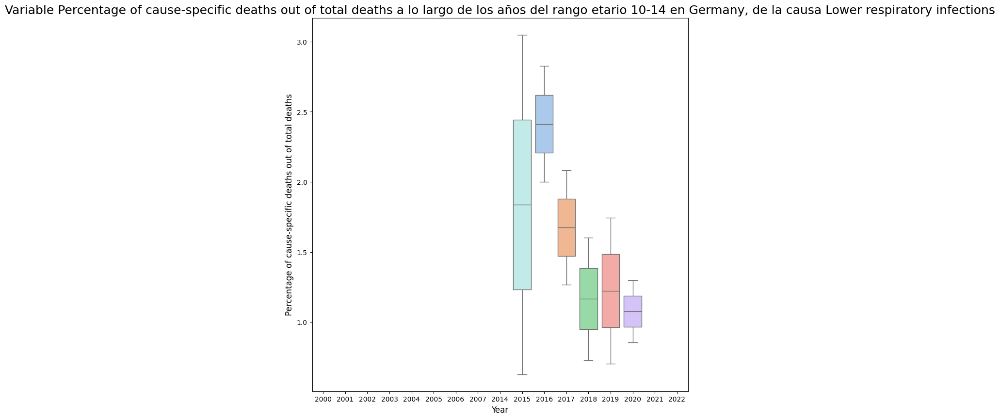

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


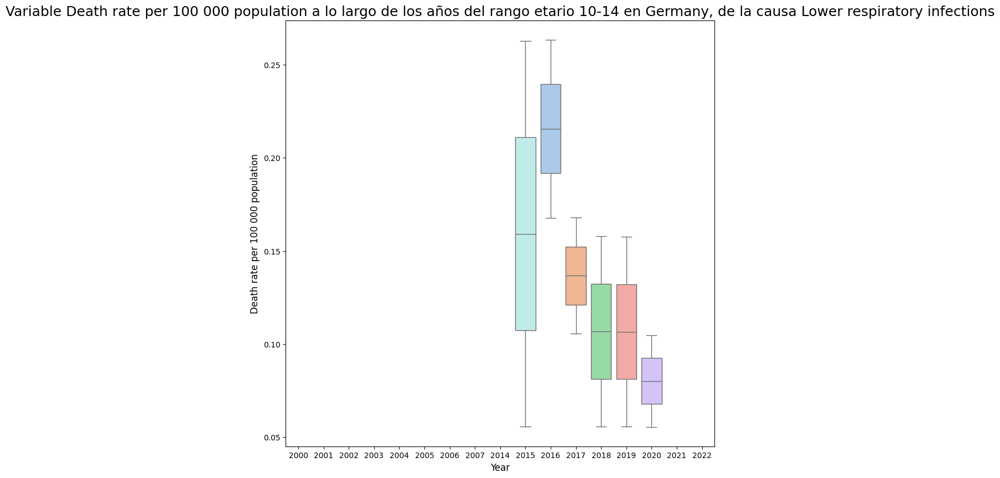

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


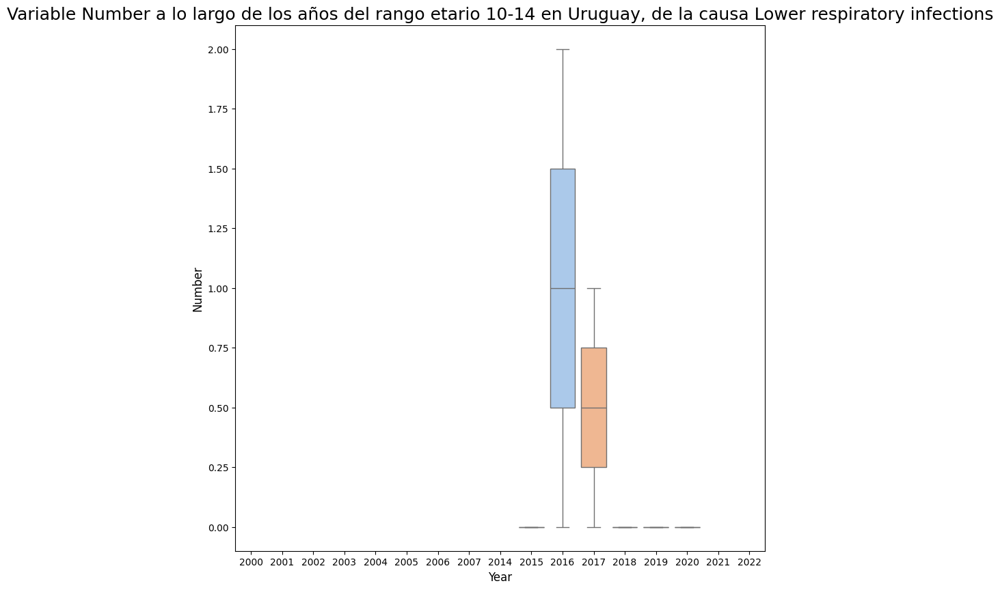

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


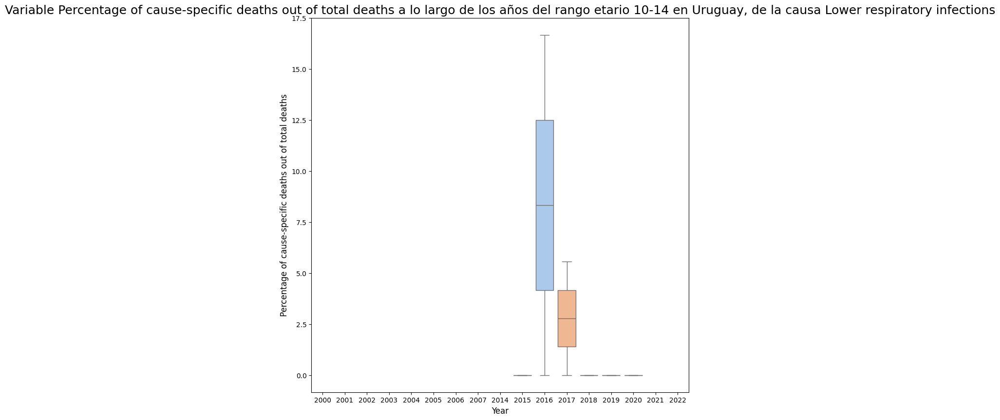

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


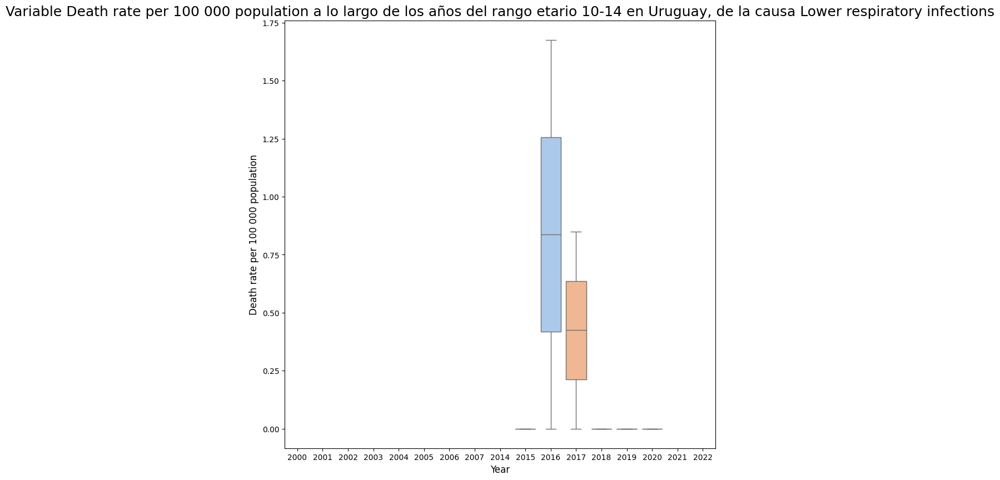

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


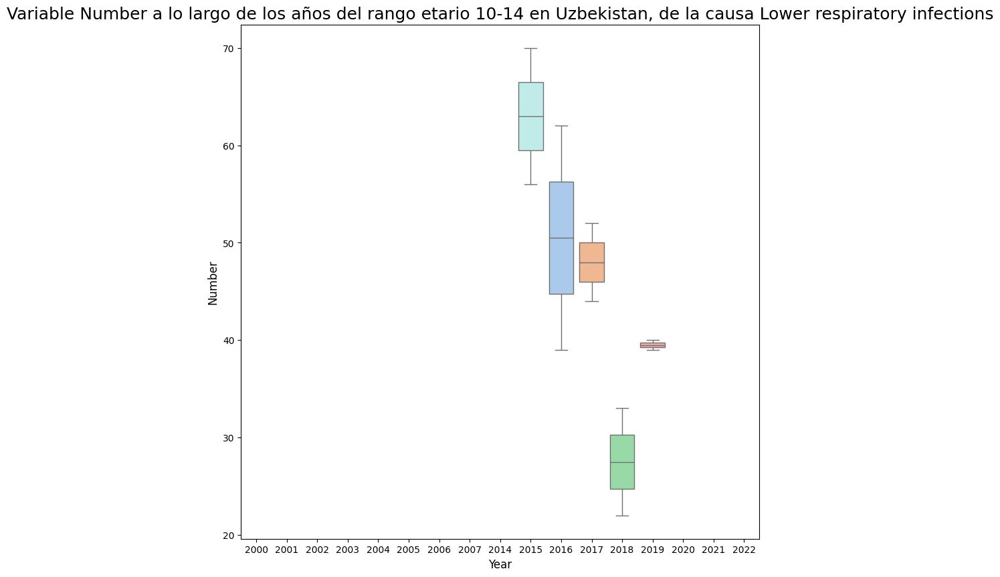

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


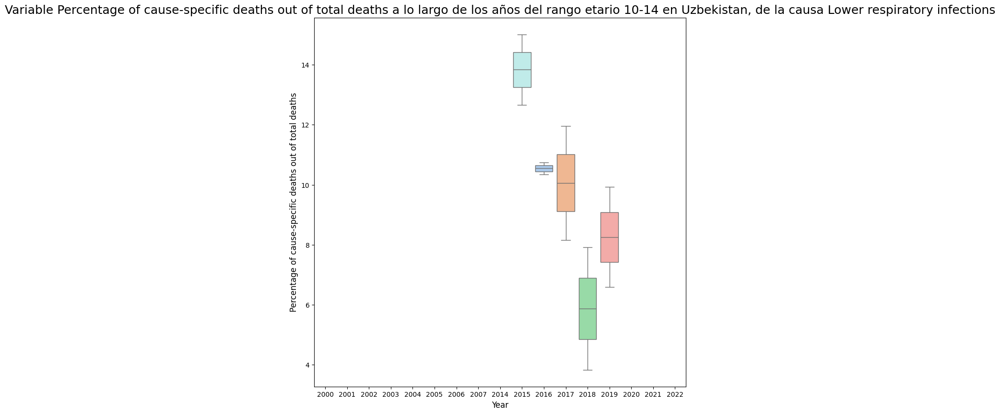

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


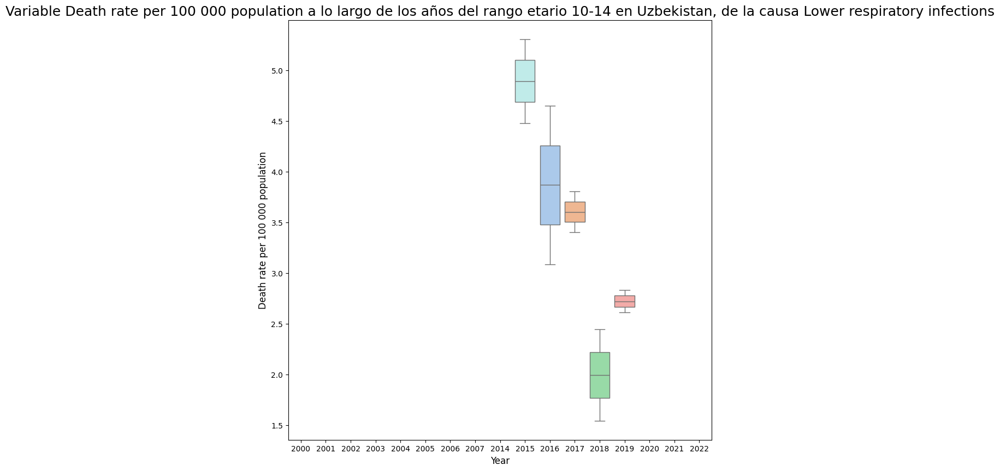

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


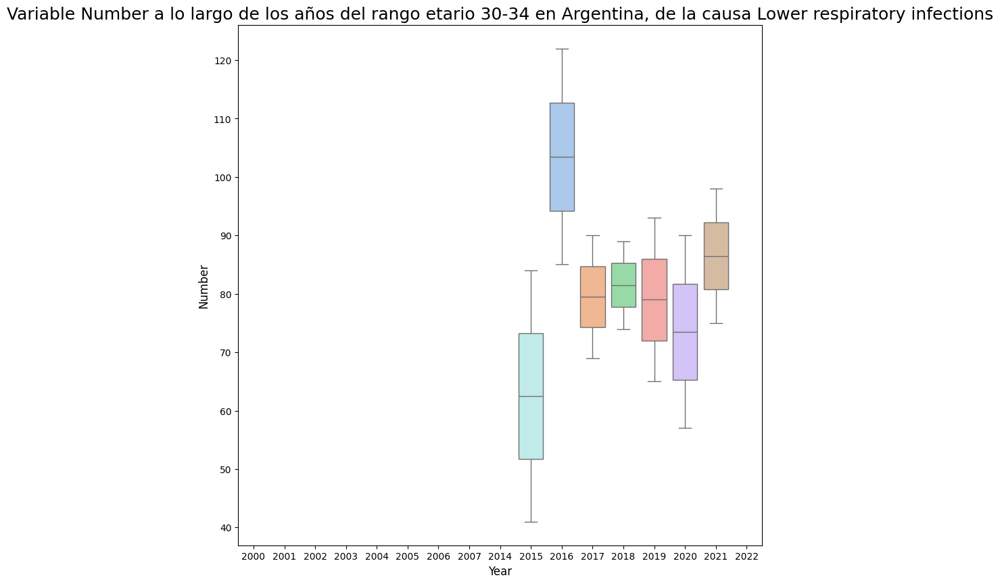

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


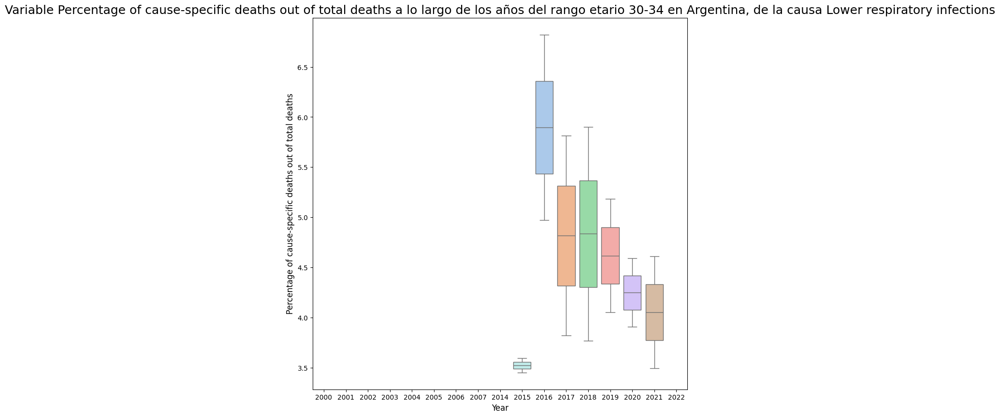

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


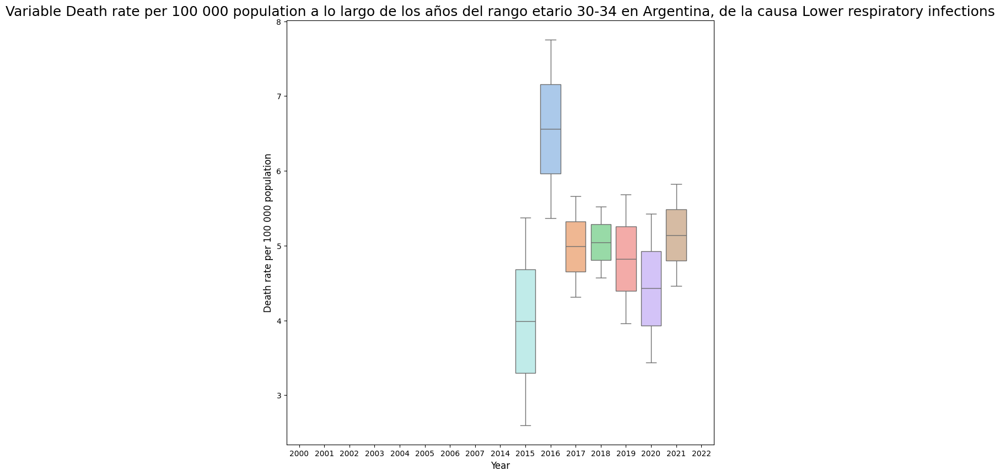

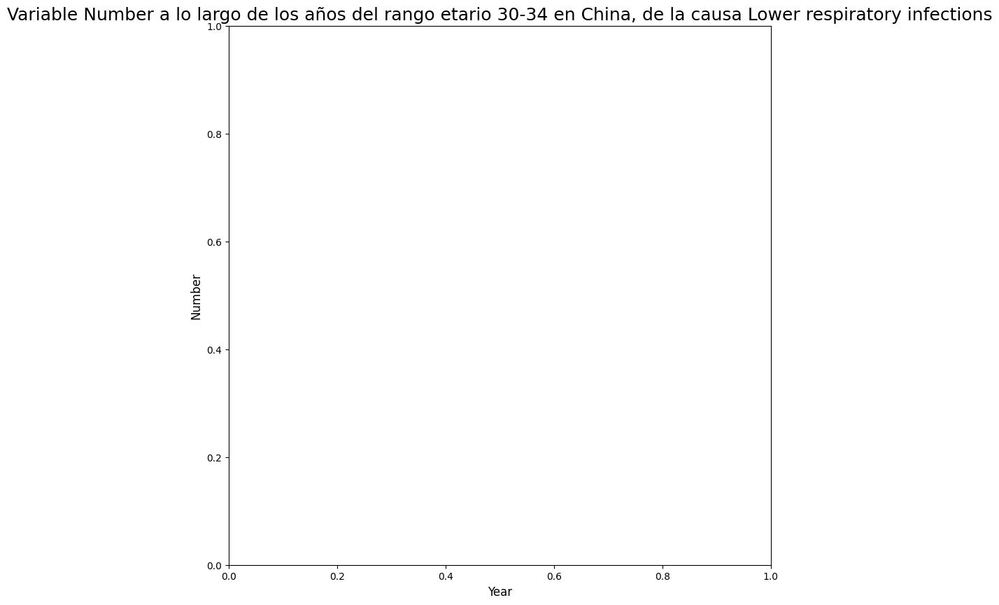

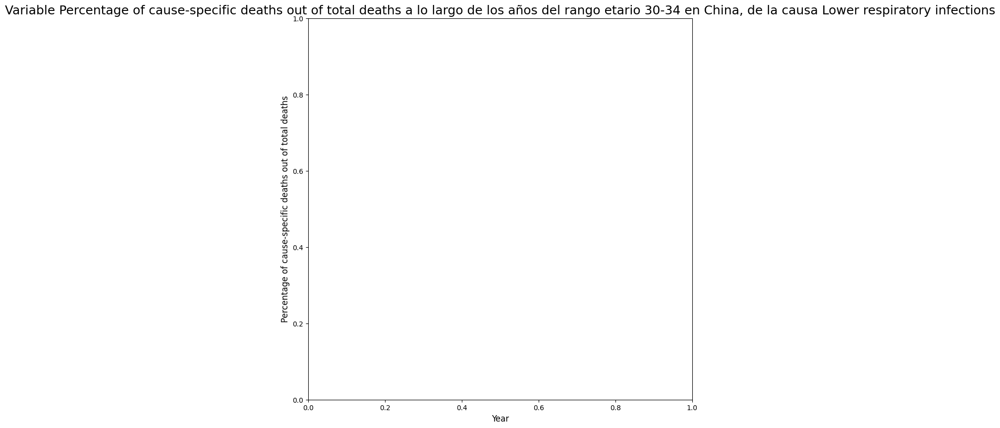

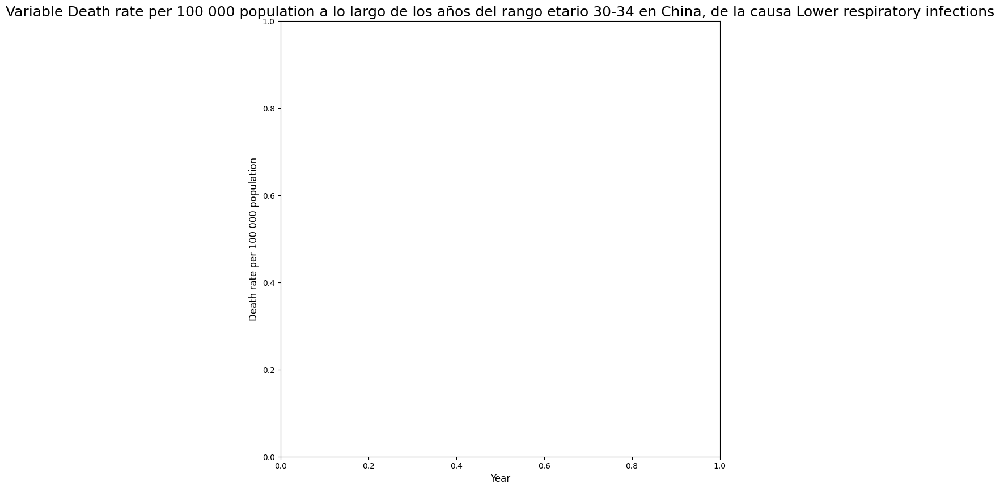

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


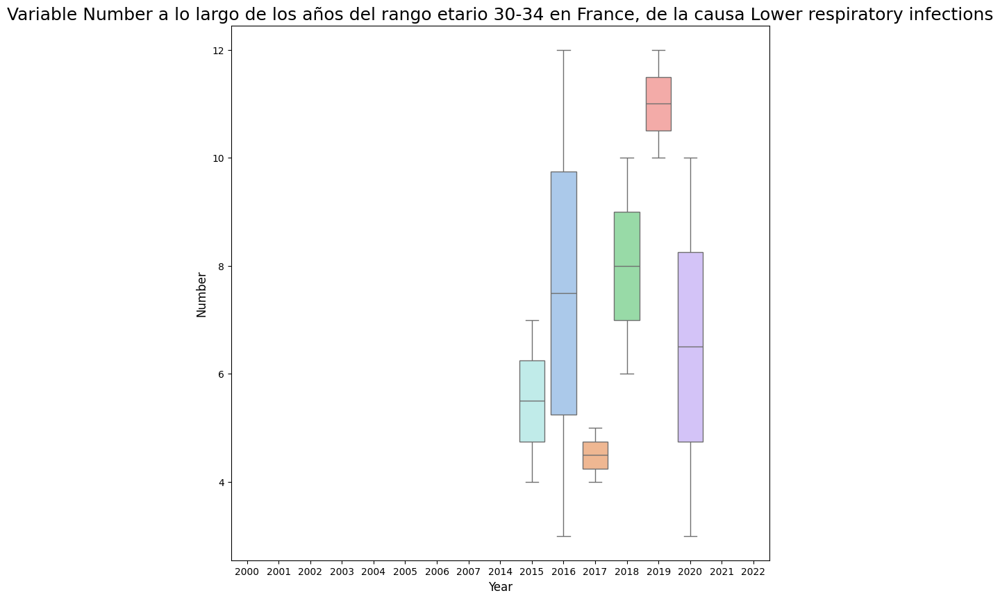

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


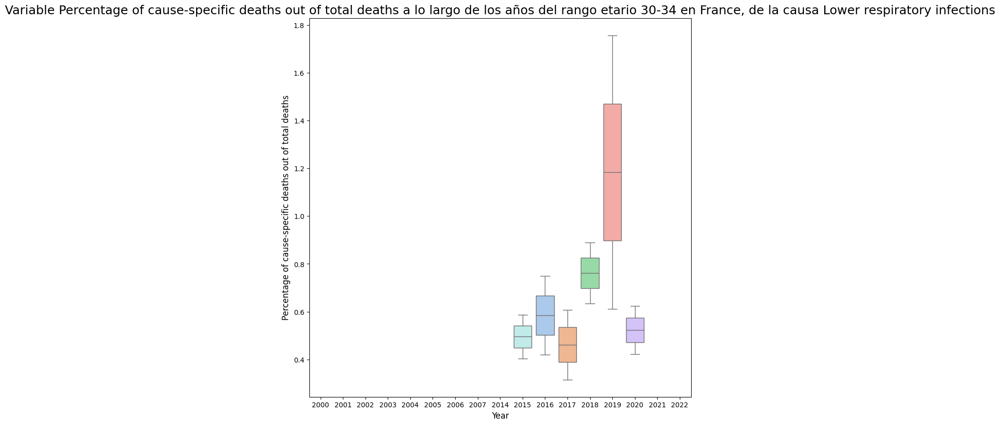

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


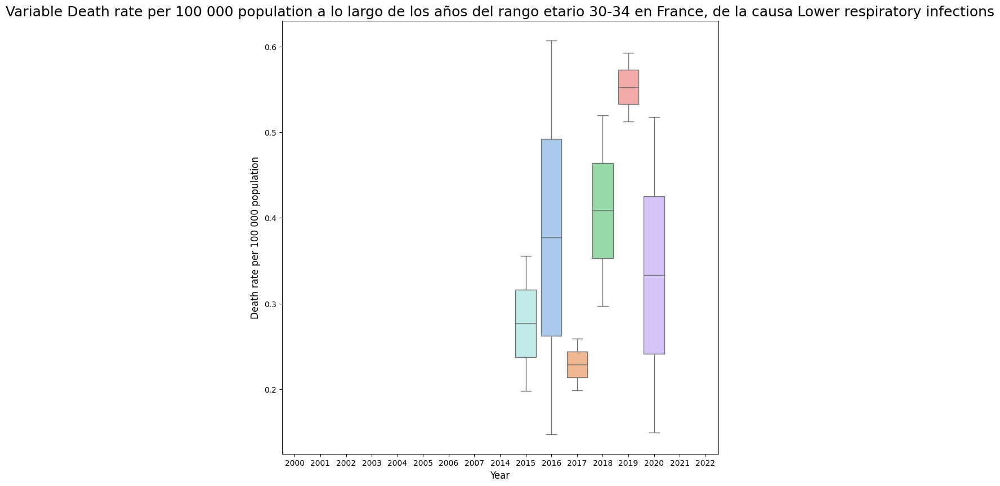

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


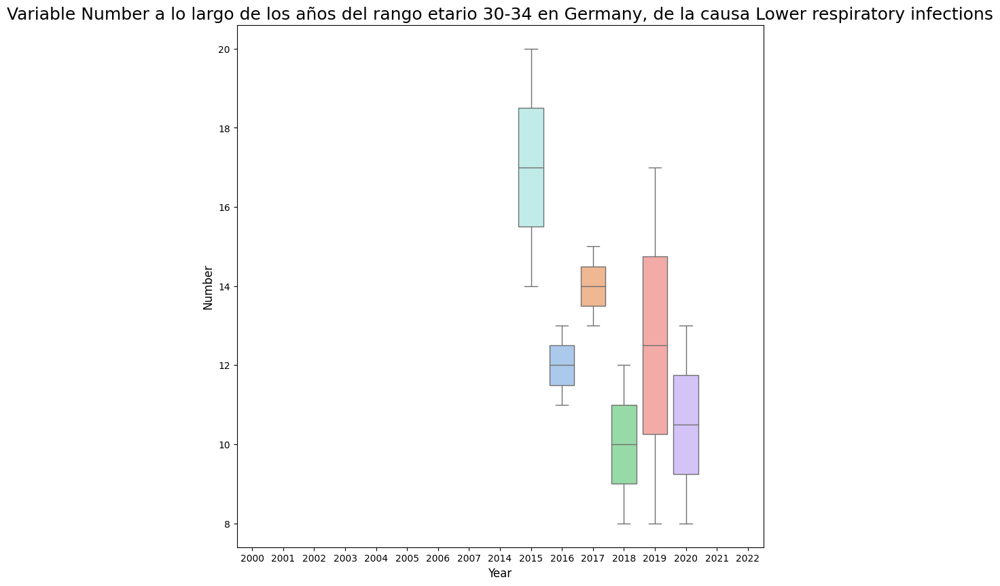

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


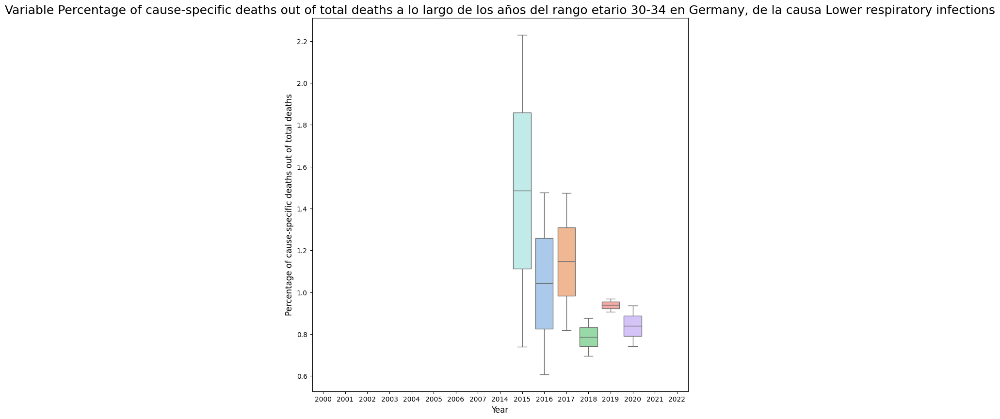

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


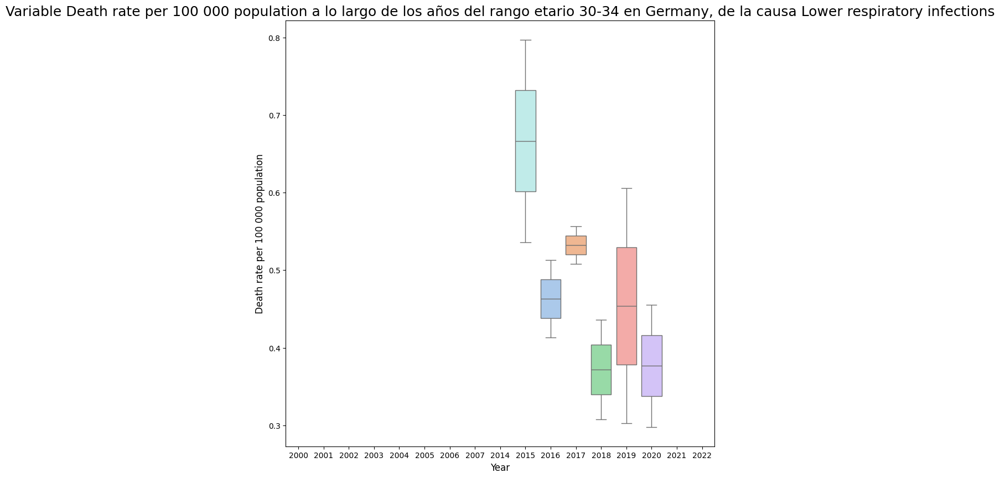

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


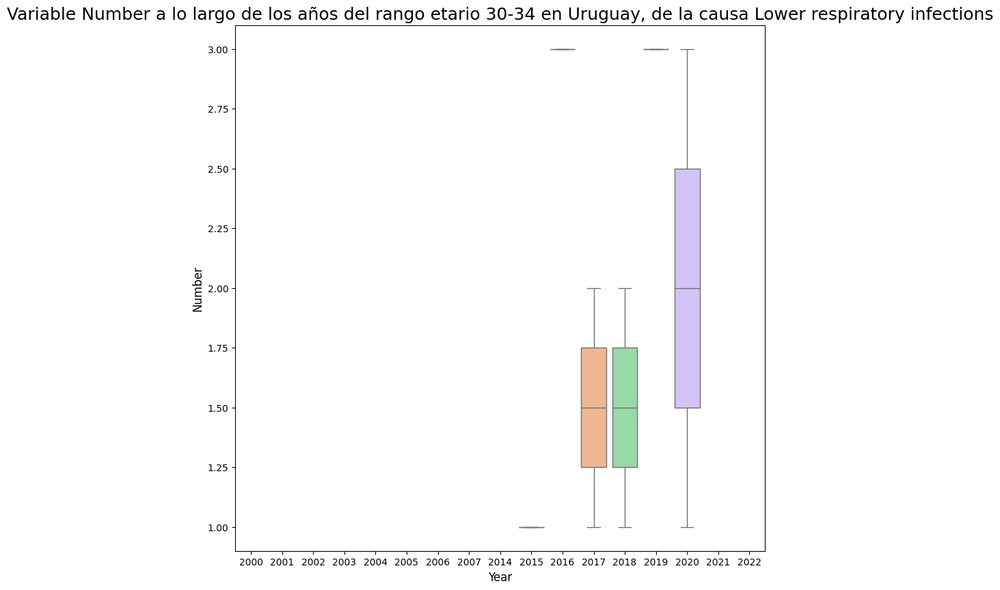

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


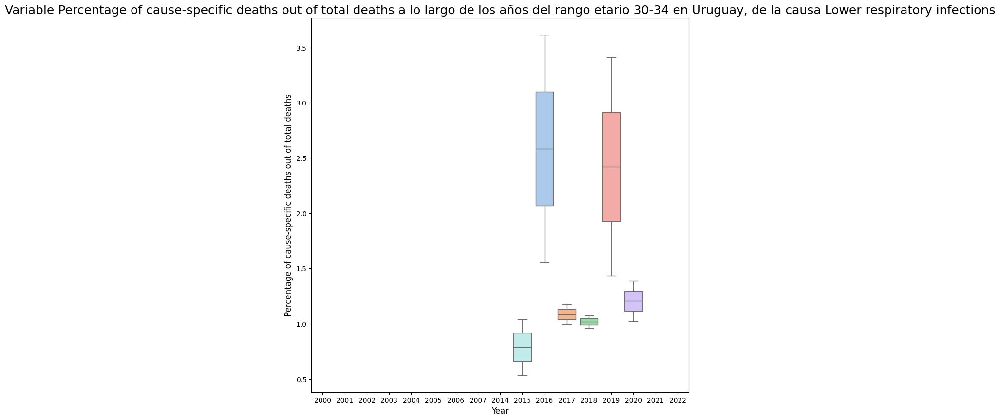

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


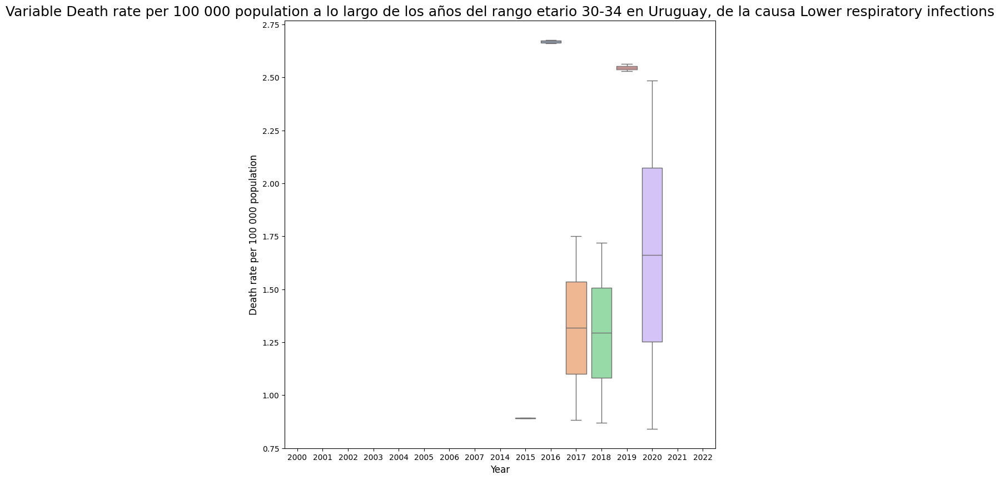

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


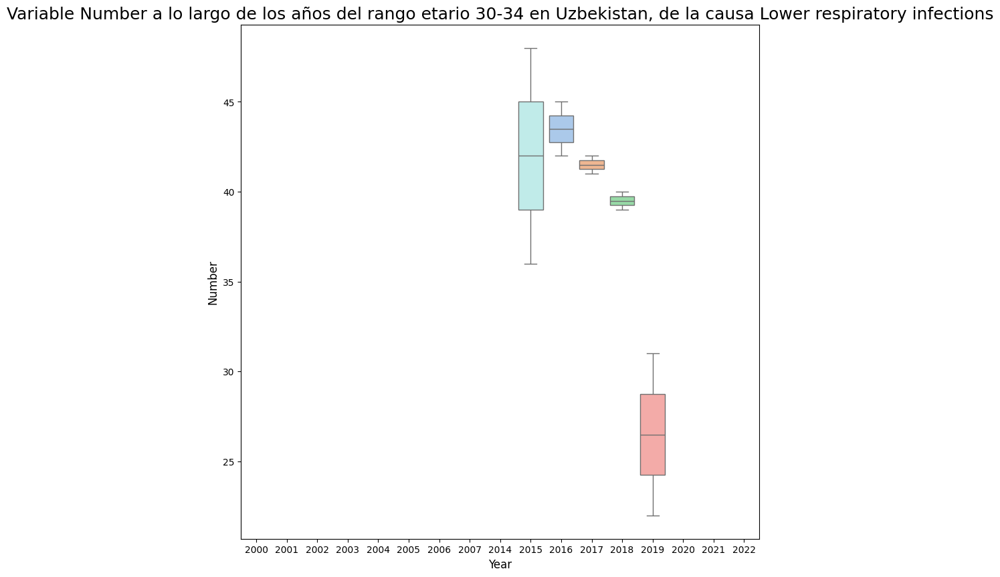

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


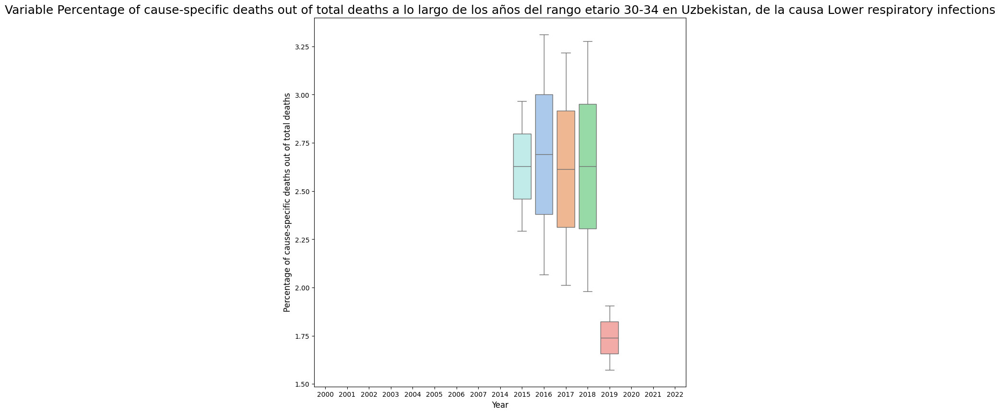

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


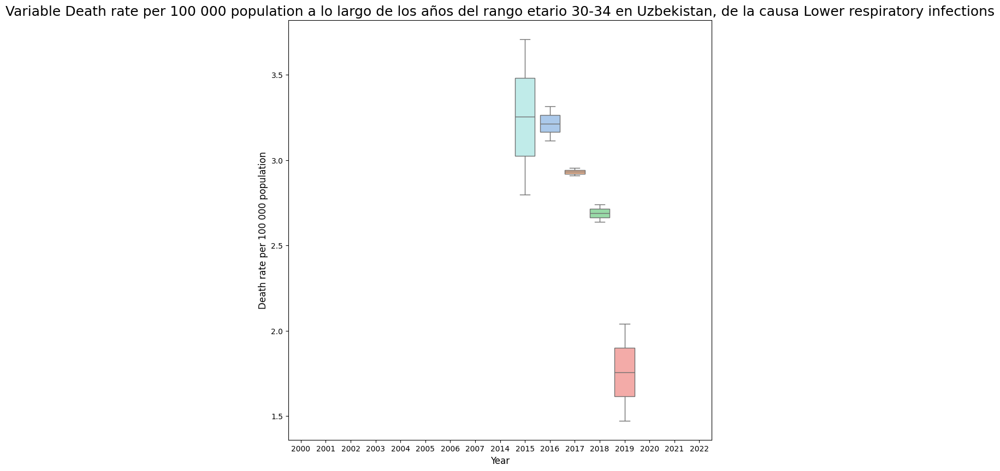

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


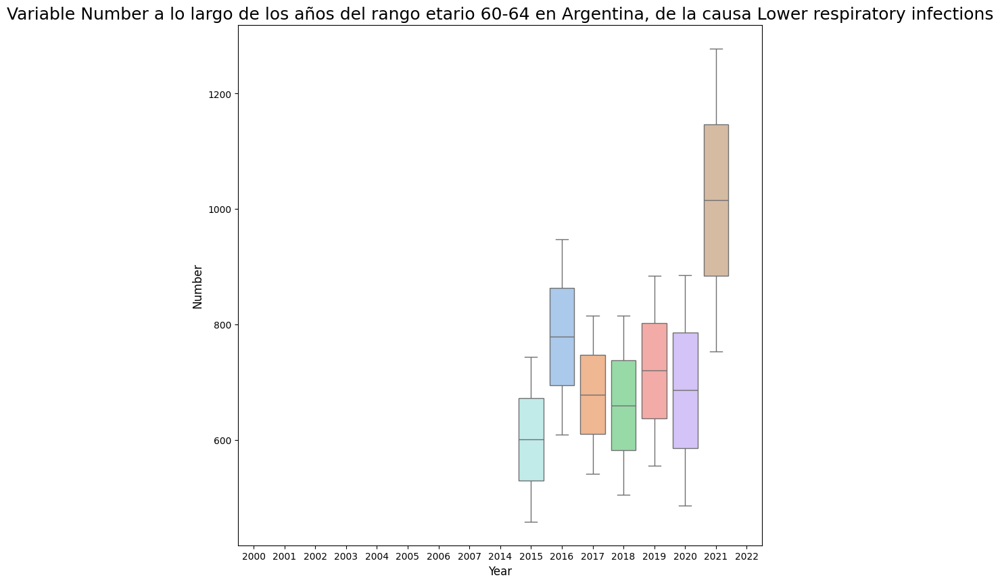

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


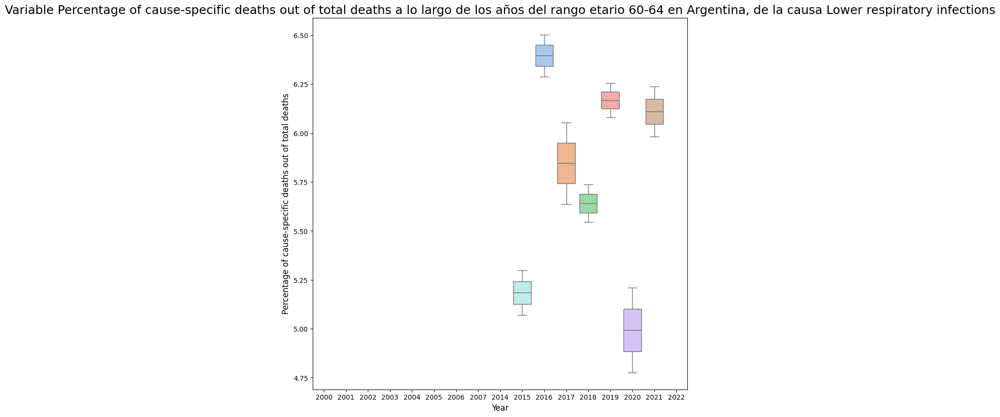

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


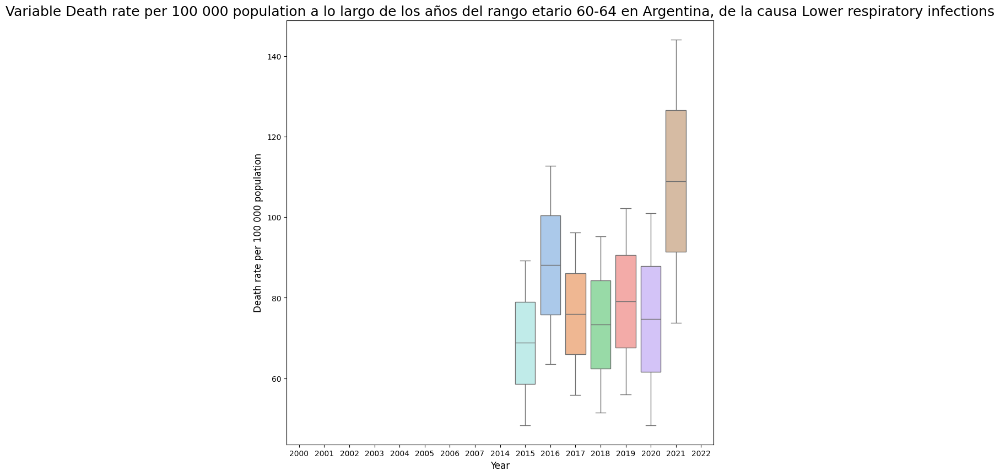

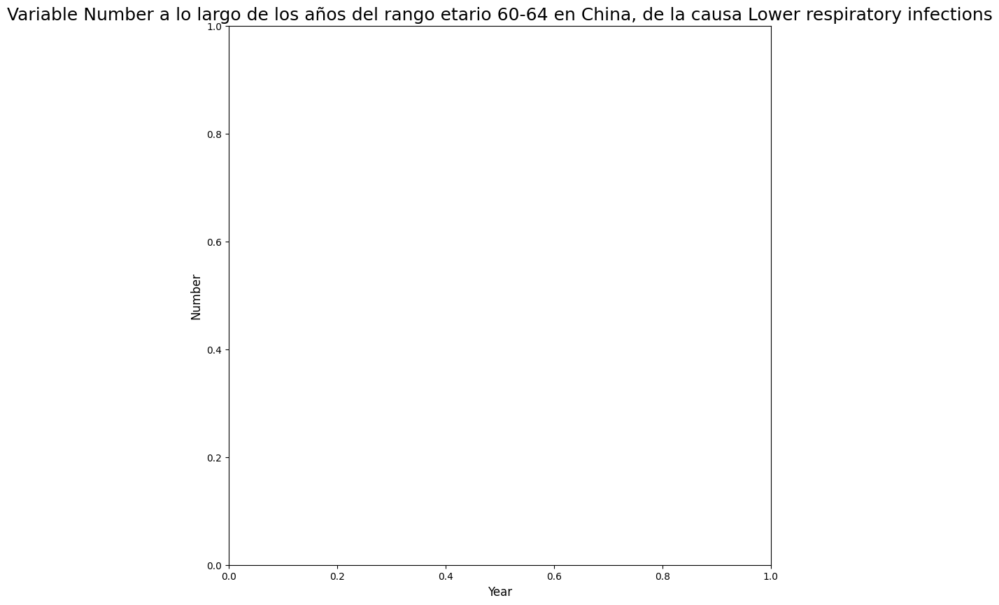

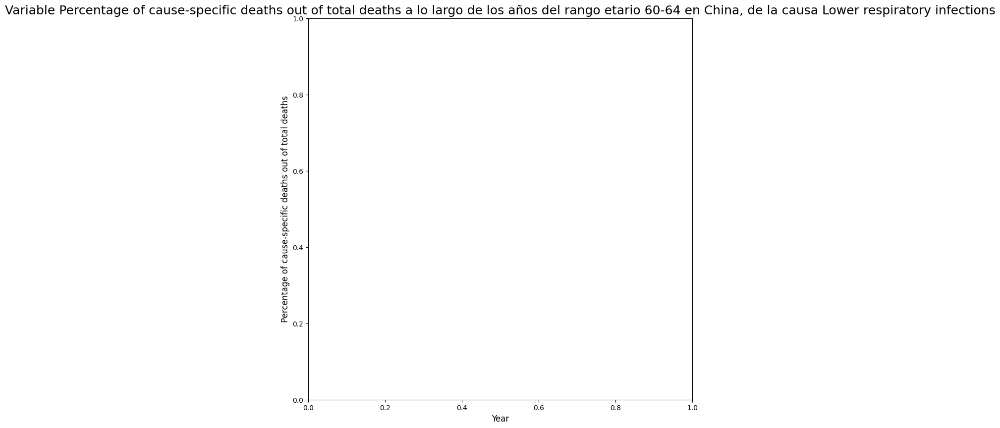

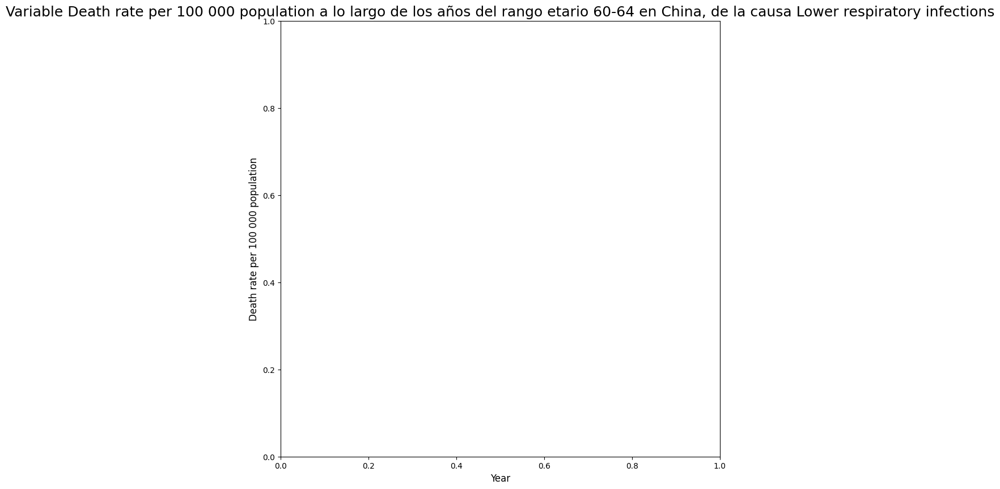

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


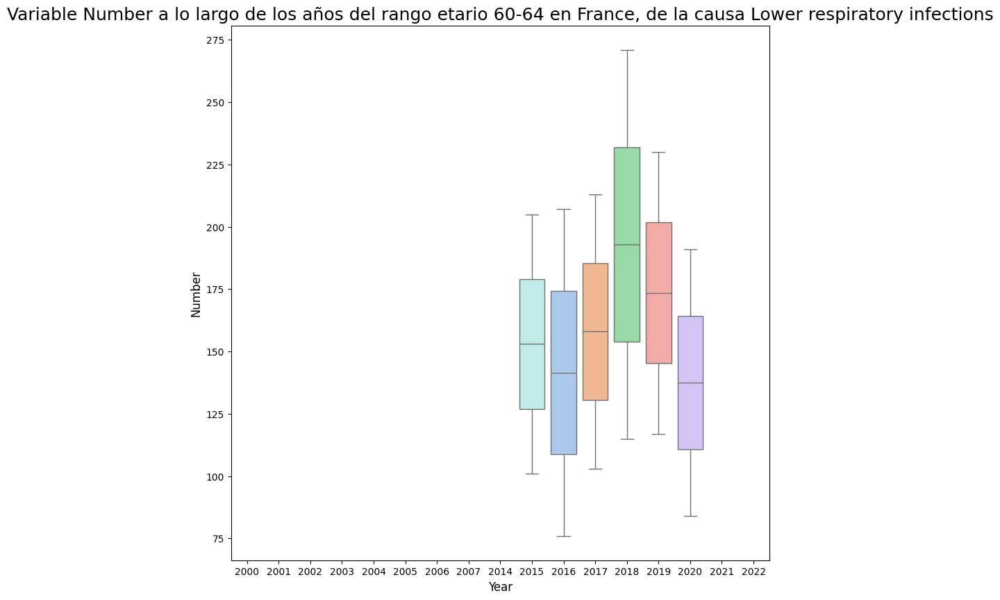

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


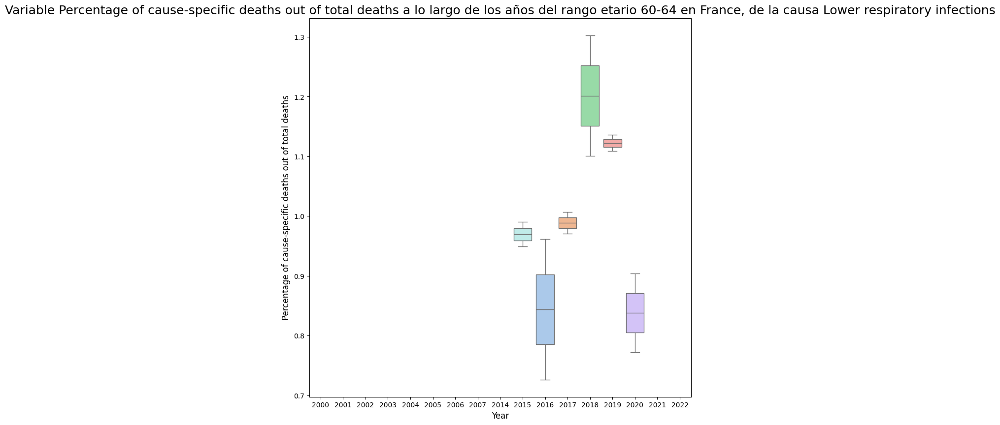

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


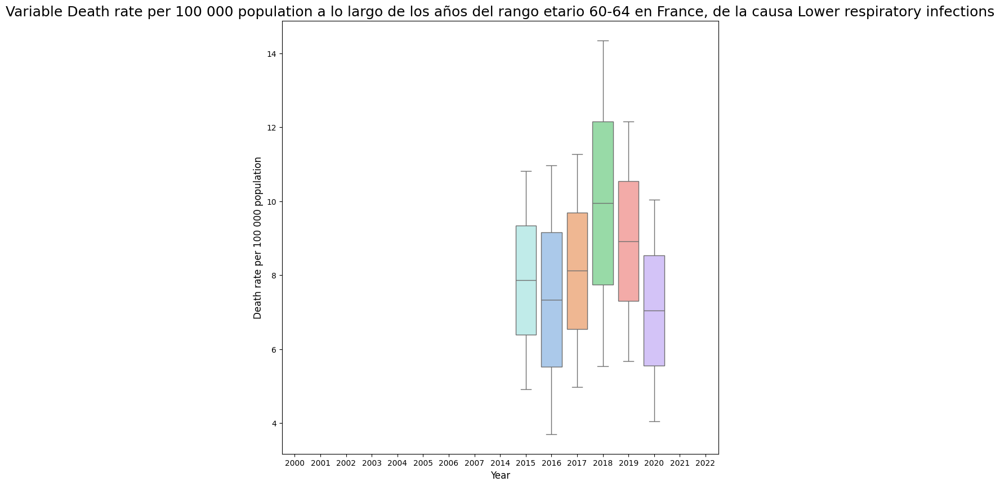

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


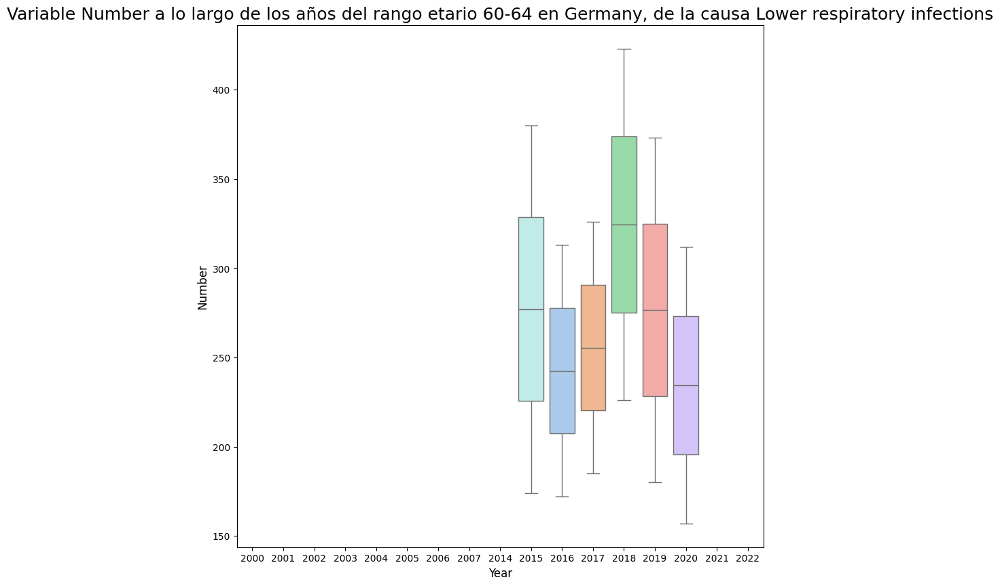

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


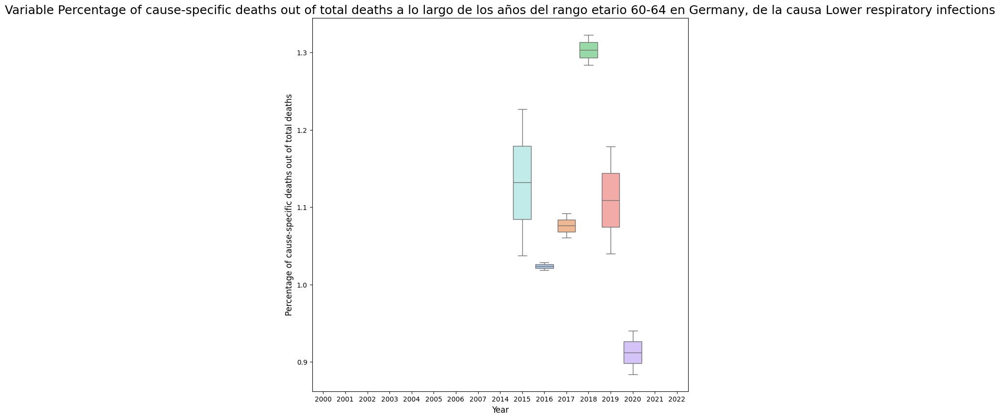

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


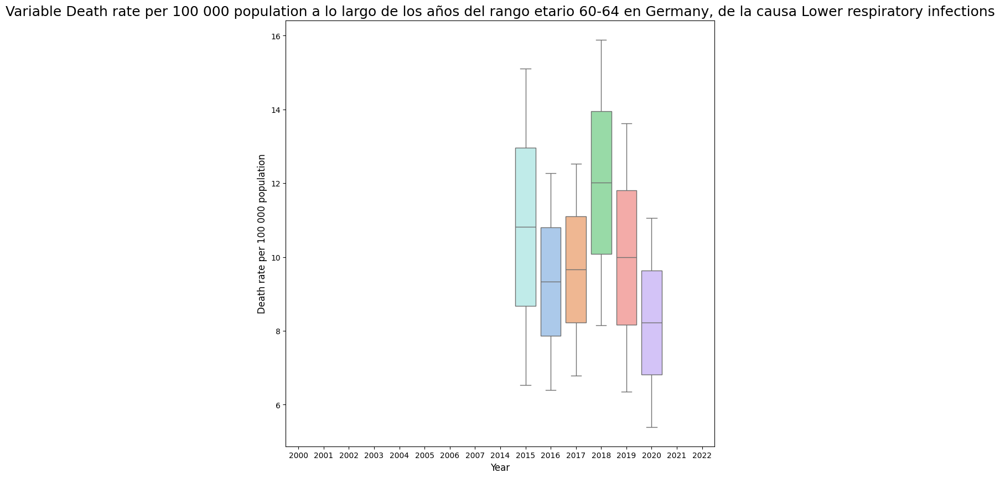

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


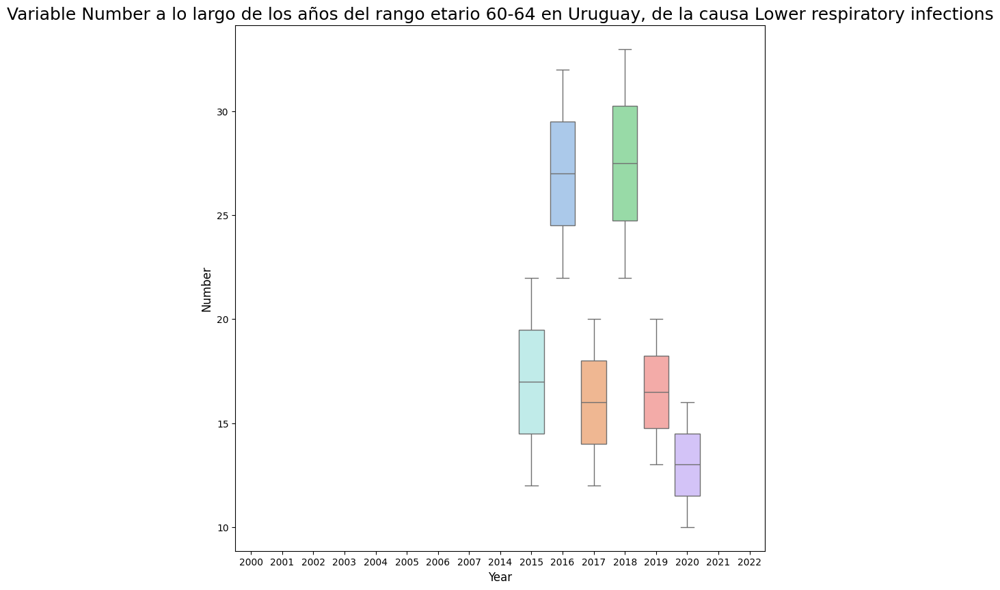

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


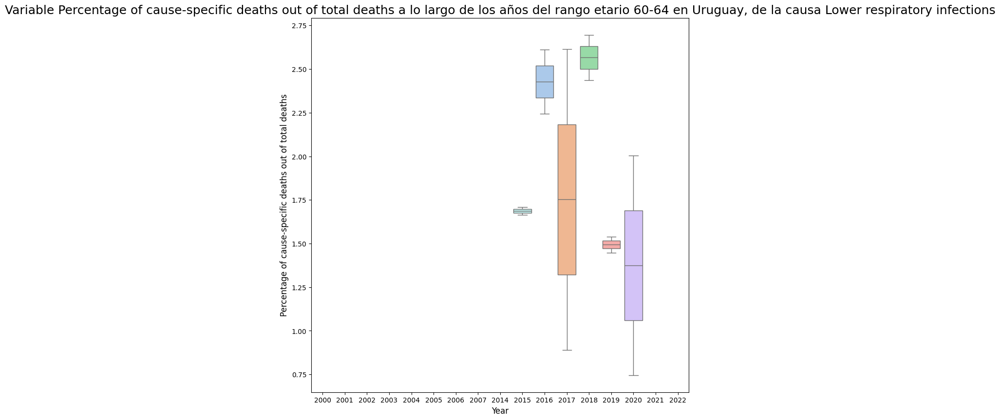

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


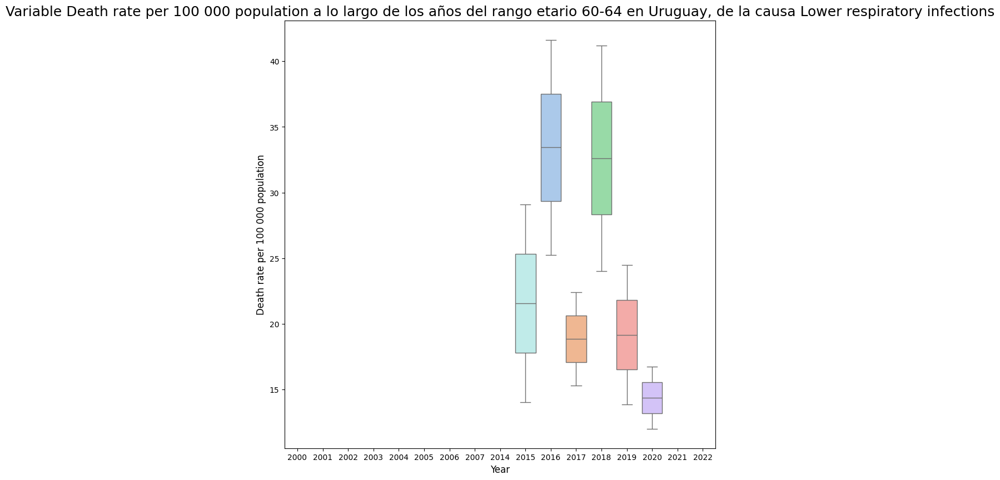

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


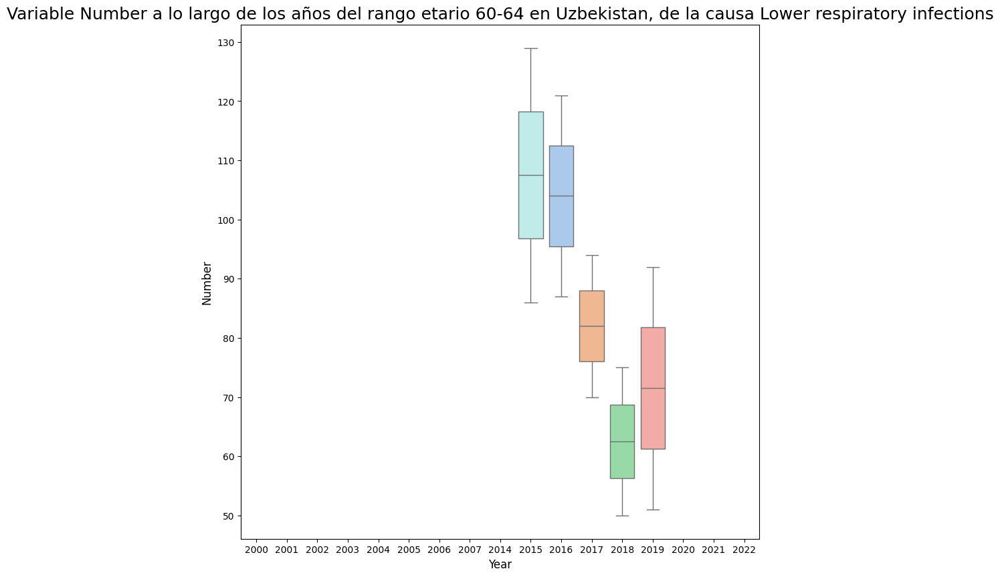

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


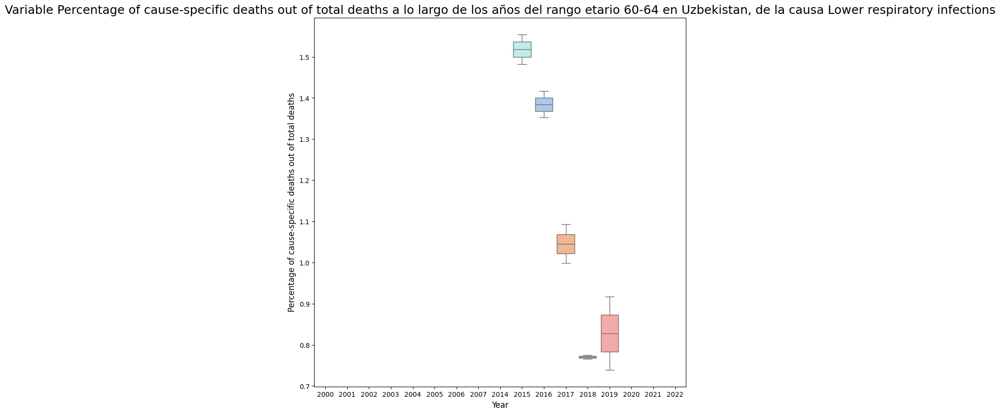

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


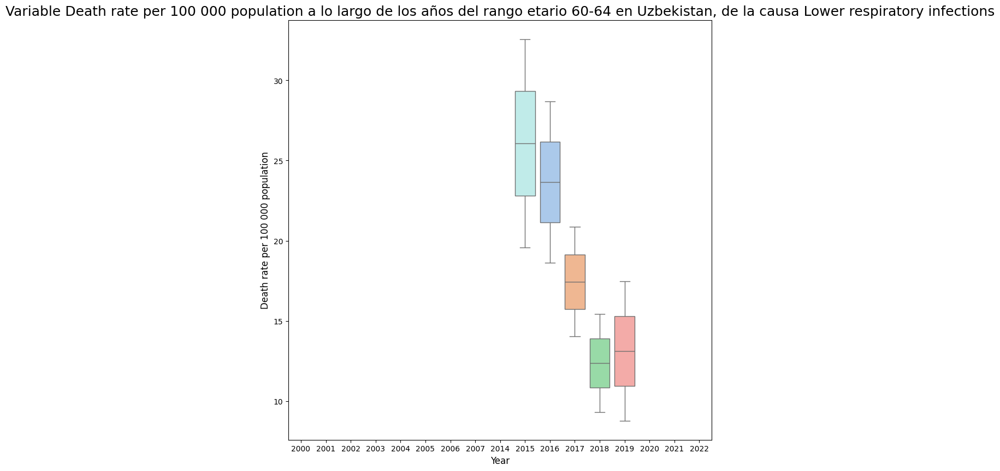

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


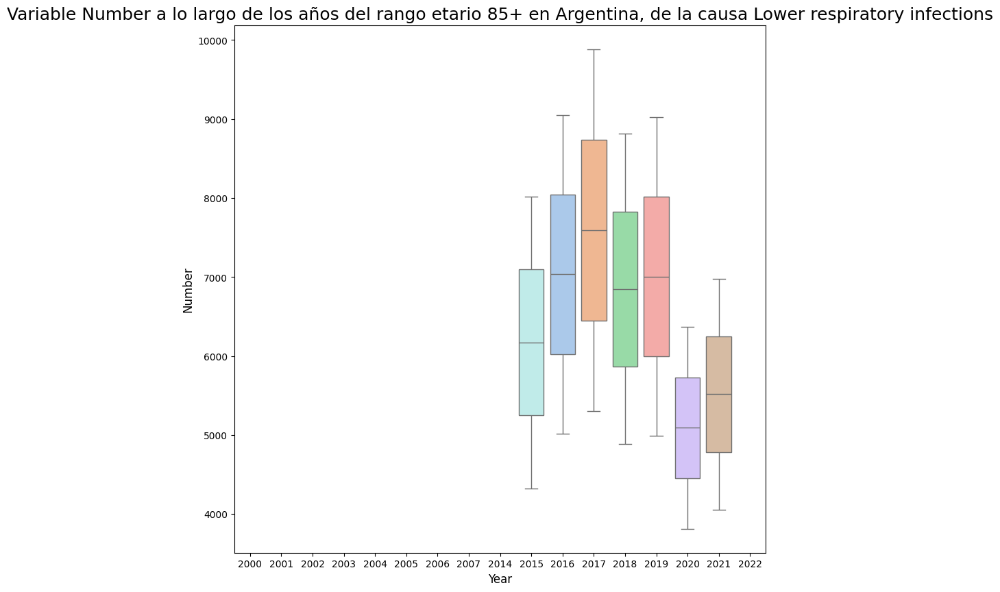

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


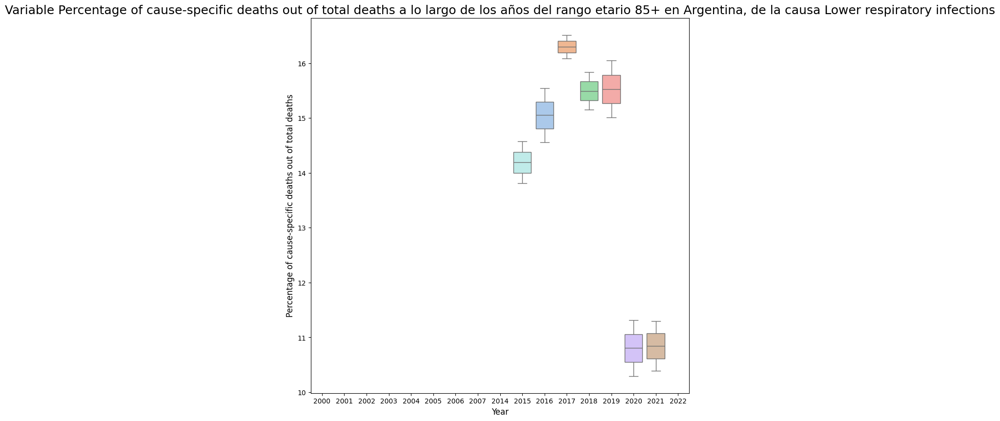

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


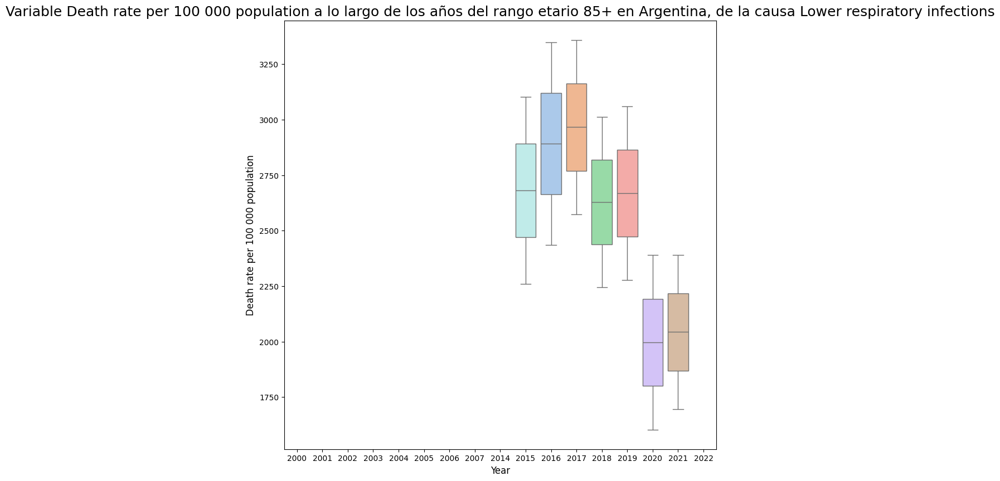

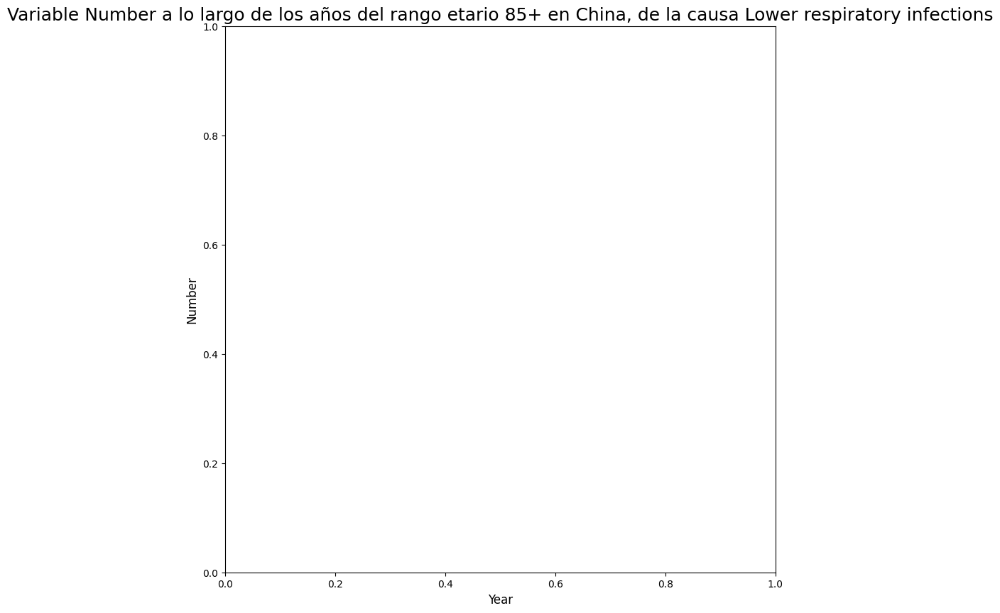

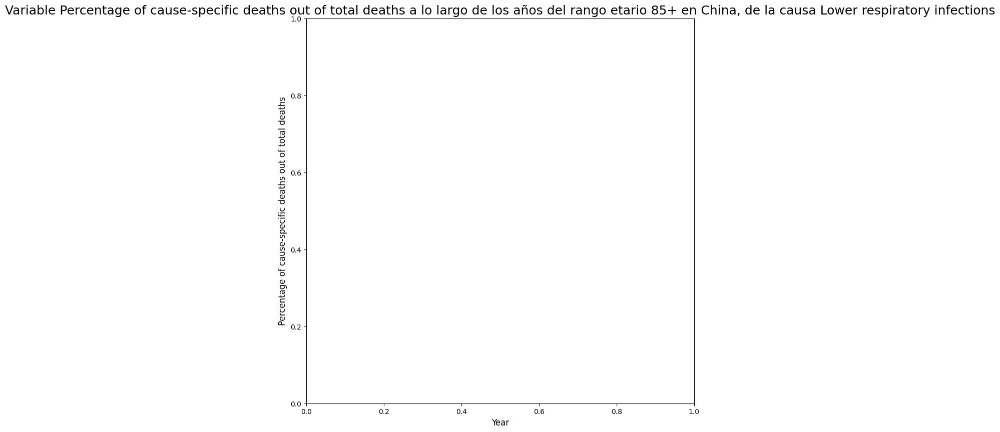

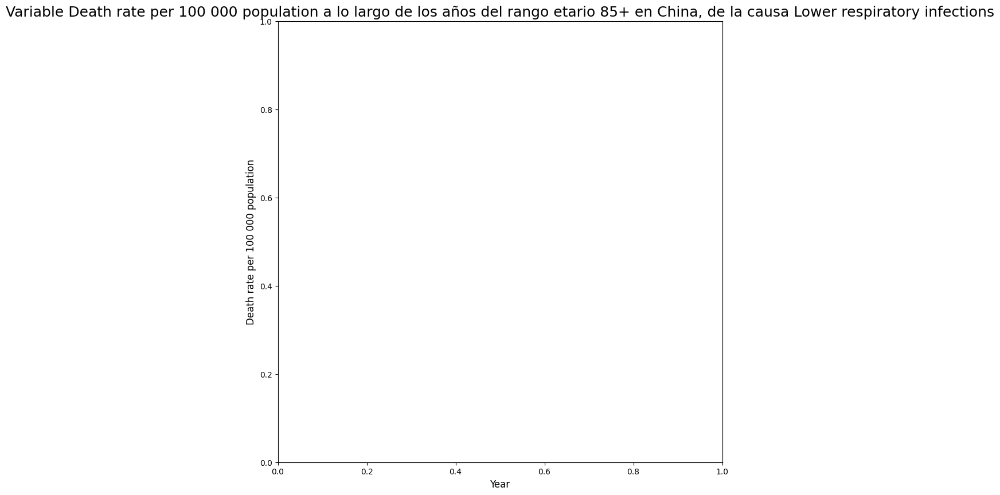

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


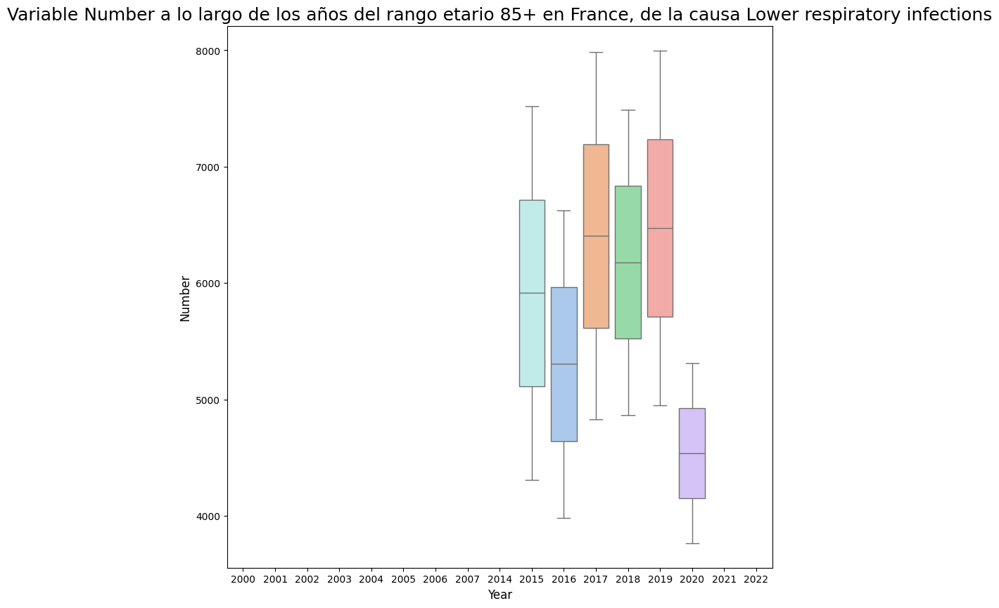

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


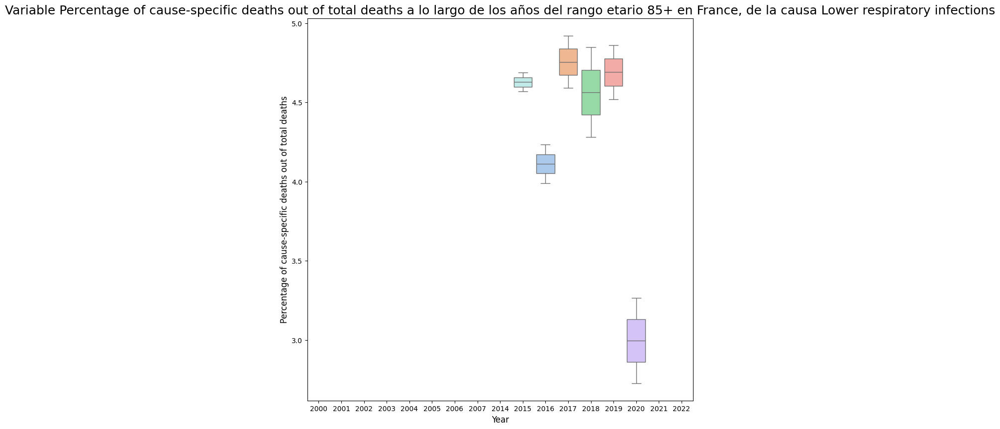

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


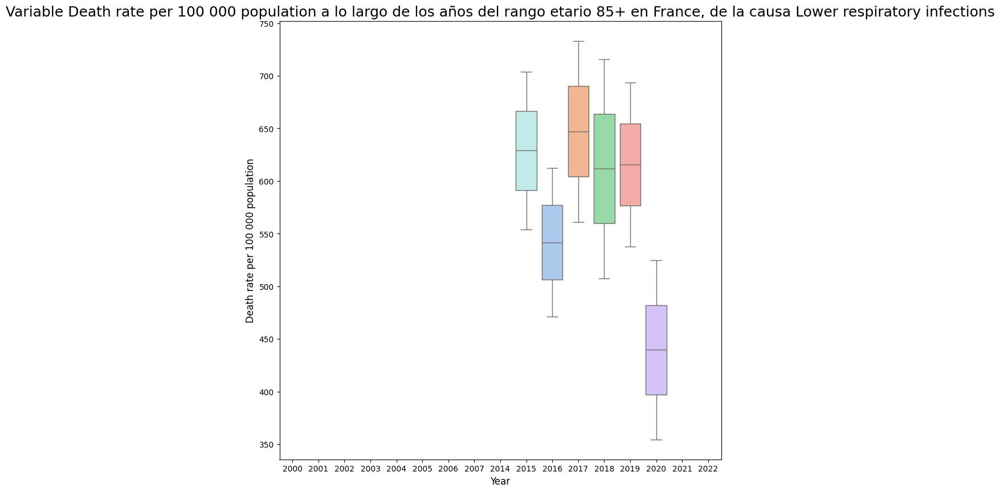

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


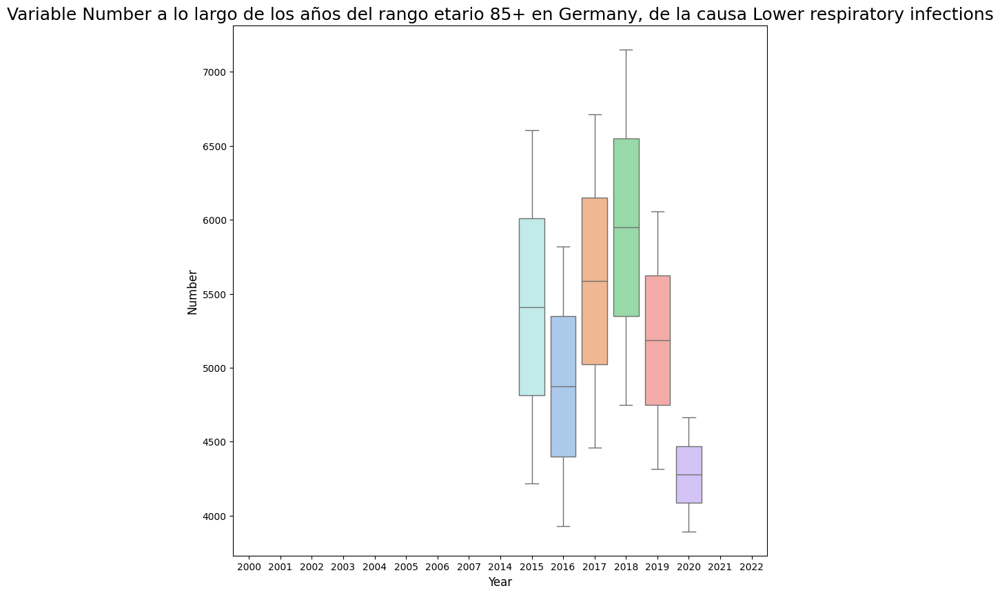

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


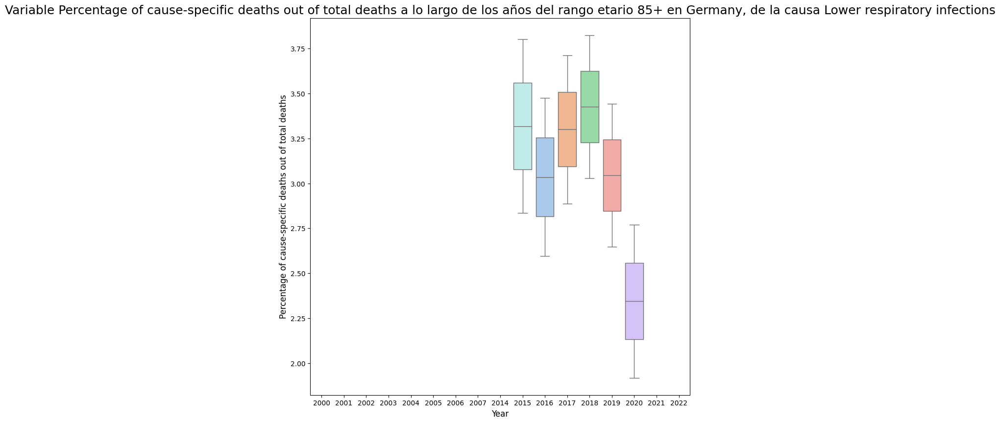

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


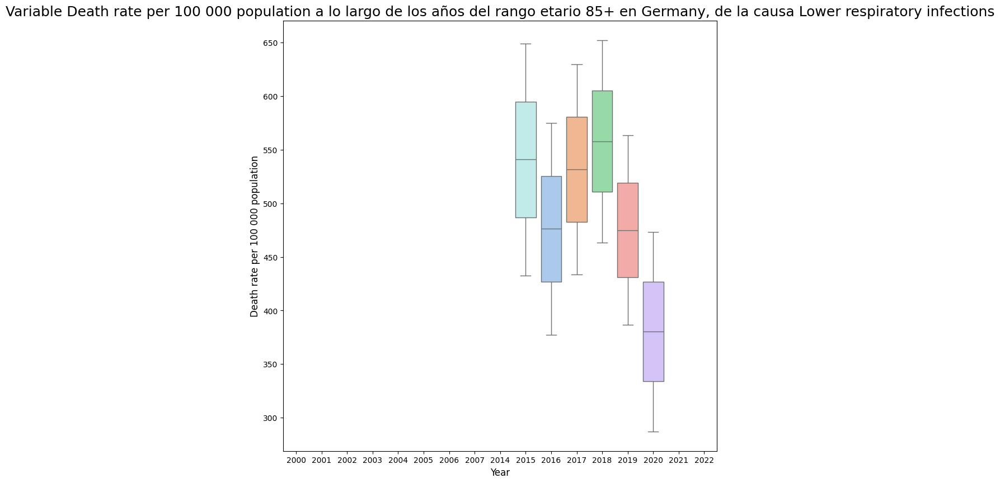

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


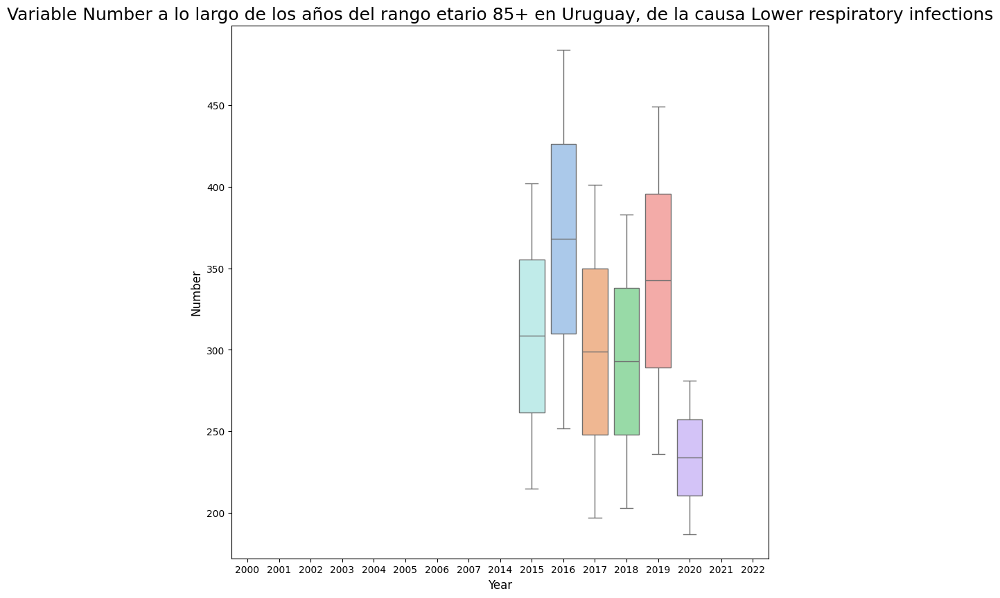

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


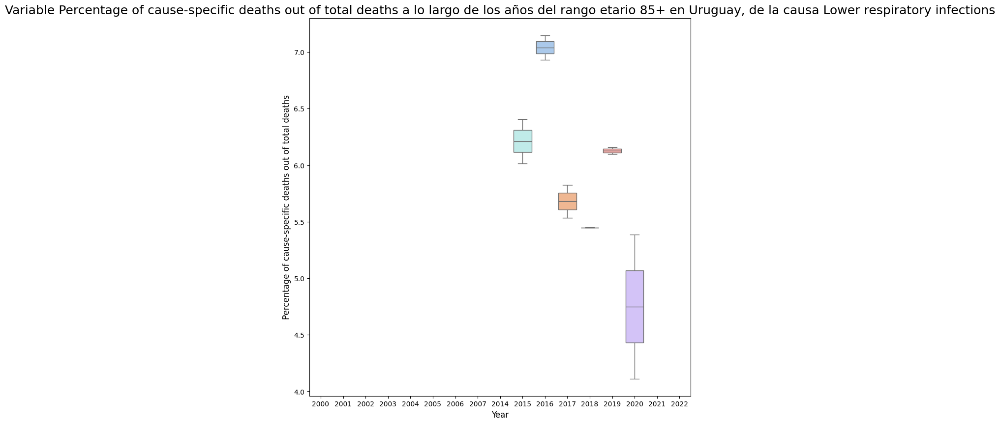

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


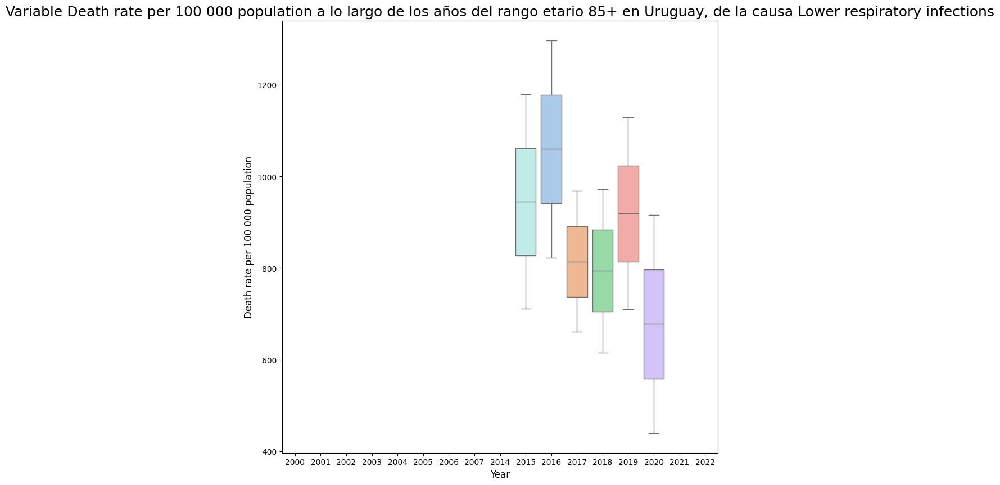

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


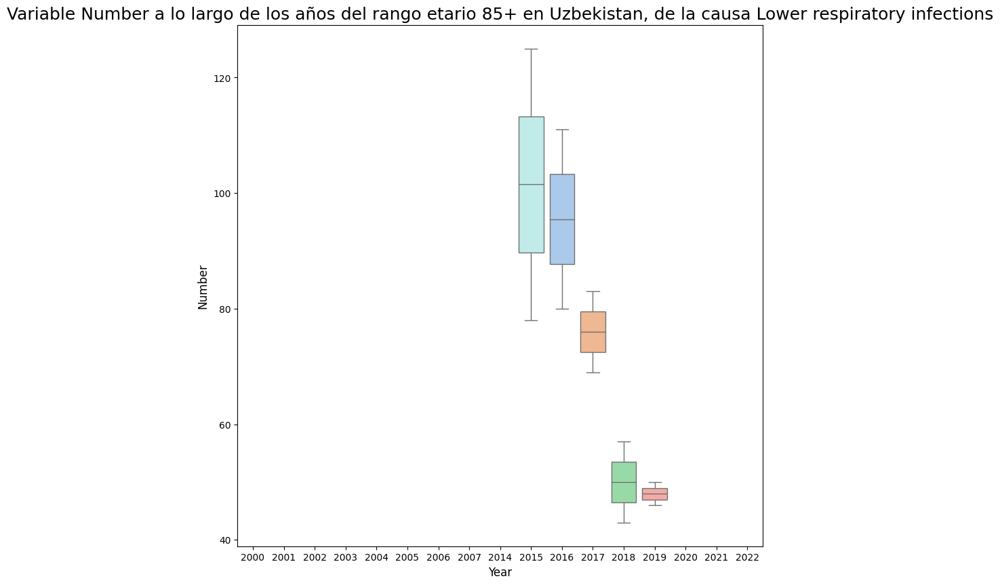

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


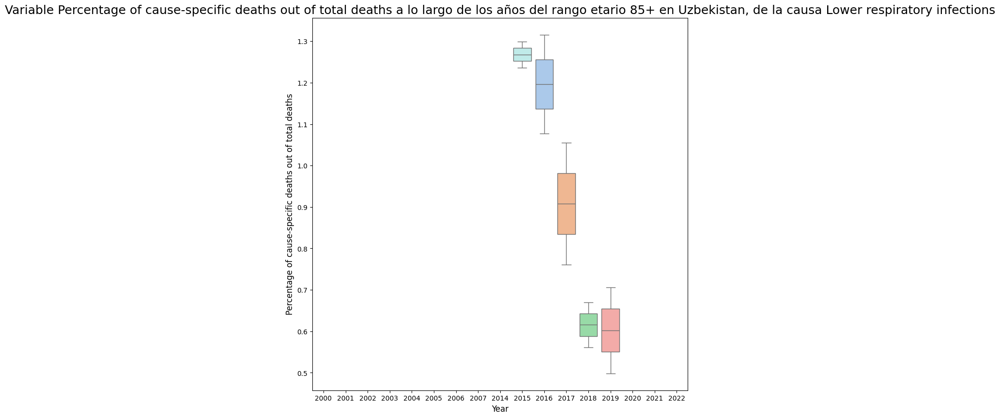

<ipython-input-176-59a70ec23983>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=cv, data=df_country[df_country['Age Group'] == age_group], order=year_in_order, palette="pastel")


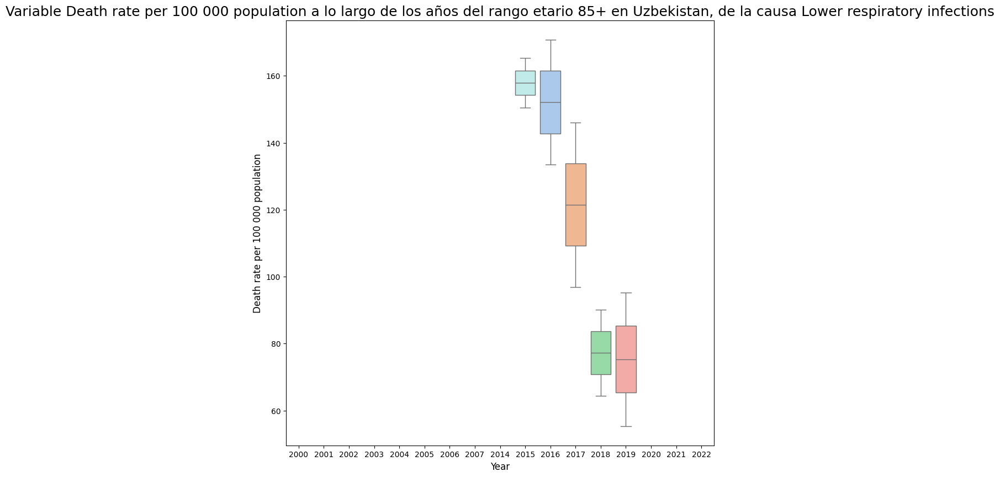

In [178]:
for age_group in age_groups_acotado:
  boxplot_continuous_variables_without_economic_information(df_lower_respiratory_infections, age_group, "Lower respiratory infections")

**OUTLIERS:**<br>
Con los dos últimos grupos de gráficos, quise analizar, qué pasa si veo los datos por causa de muerte, dentro de eso, recorro una gran parte de los países y dentro de eso todos los rangos etarios.<br>
Lo que puedo ver es que los outliers desaparecen cuando voy especificando la muestra de datos, por lo que los outliers se deben a la gran variedad de países, rangos etarios y causas de muerte.<br>
Por lo que no creo que se deban eliminar, pero sí tratar, más adelante voy a ver las asimetrías y realizar las transformaciones pertinentes.

OBS: Usé dos causas de muerte, ya que son demasiados gráficos.

###**(2) Outliers:**

In [ ]:
def boxplot_continuous_variables_with_economic_information(df, variable, cause_of_mortality):
  for country in countries_name:
      plt.figure(figsize=(10, 10))
      df_country = df[df['Country Name'] == country]
      sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")
      plt.title(f"Variable {variable} a lo largo de los años en {country}, de la causa {cause_of_mortality}", fontsize=18)
      plt.xlabel("Year", fontsize=12)
      plt.ylabel(variable, fontsize=12)
      plt.show()

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


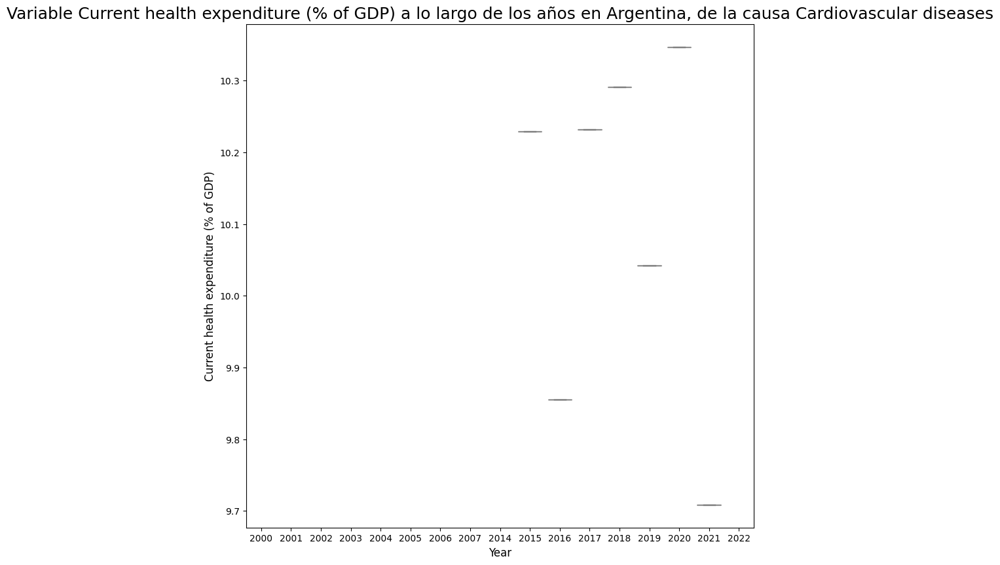

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


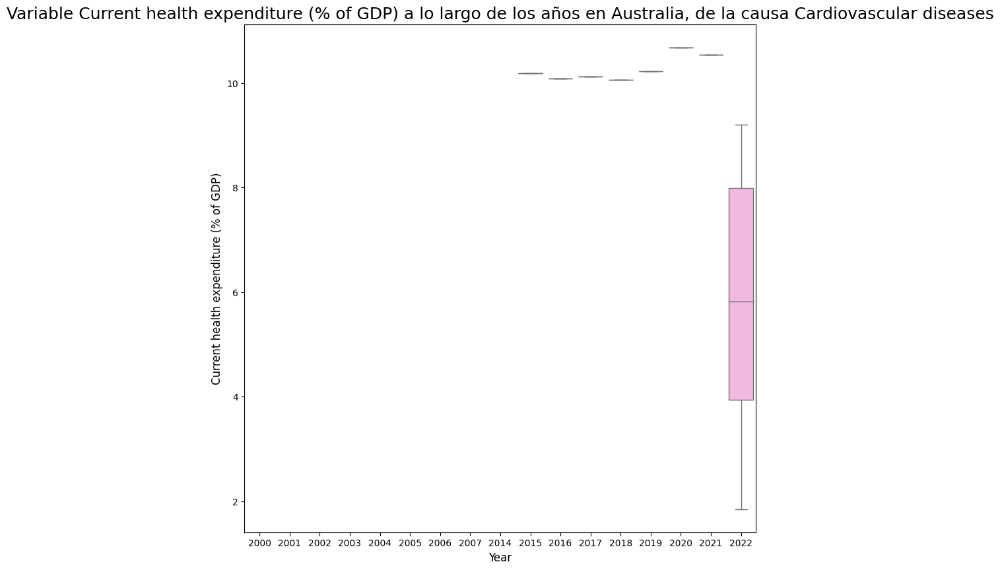

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


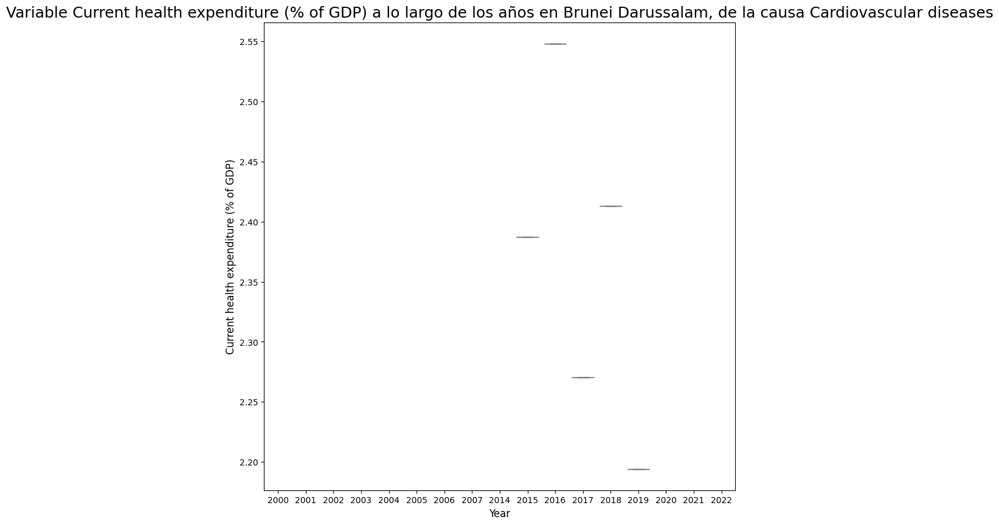

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


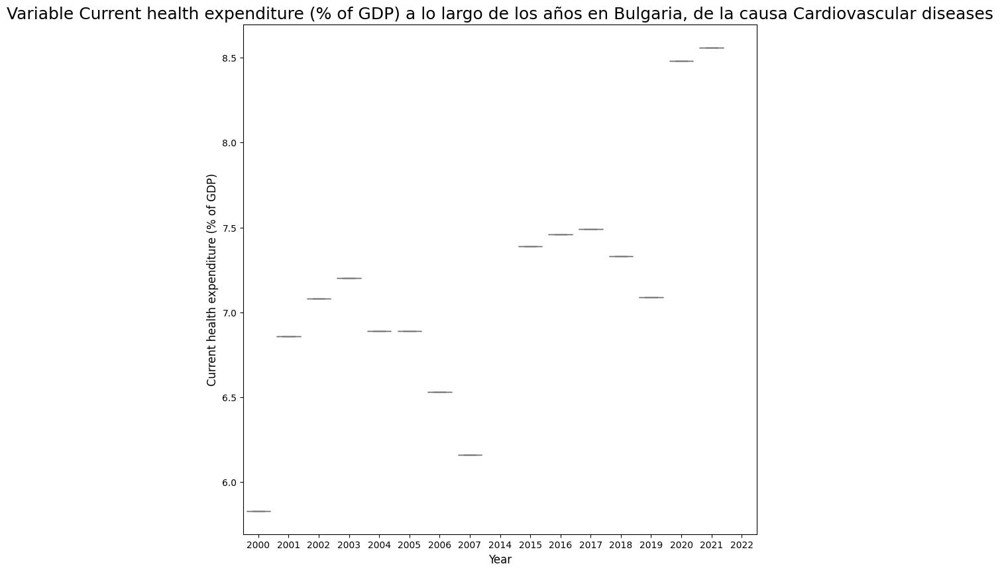

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


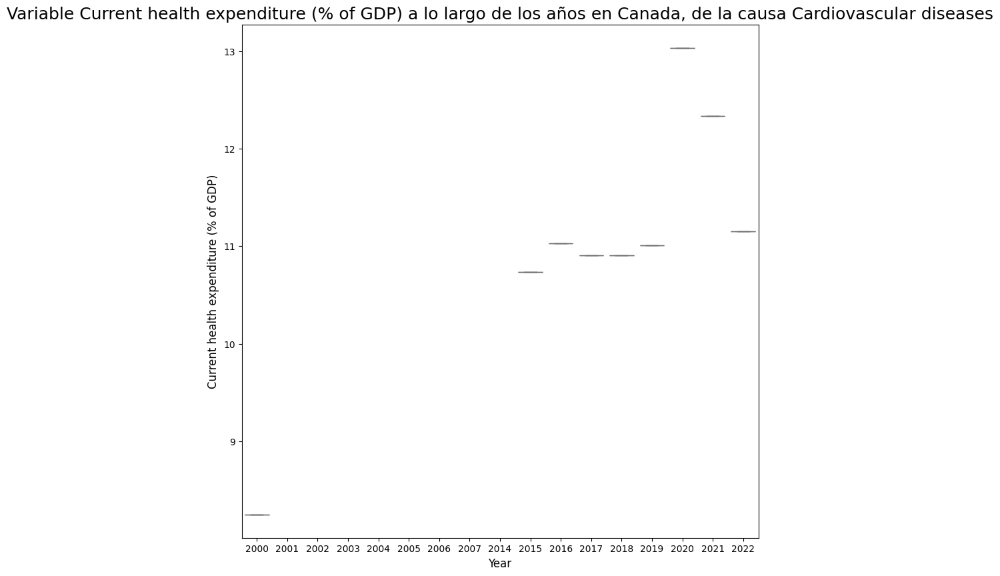

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


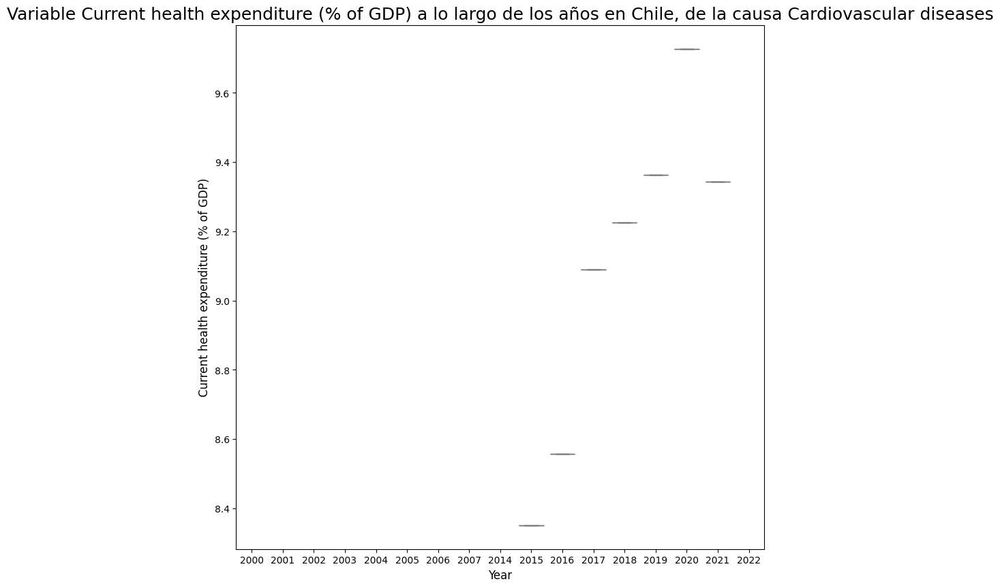

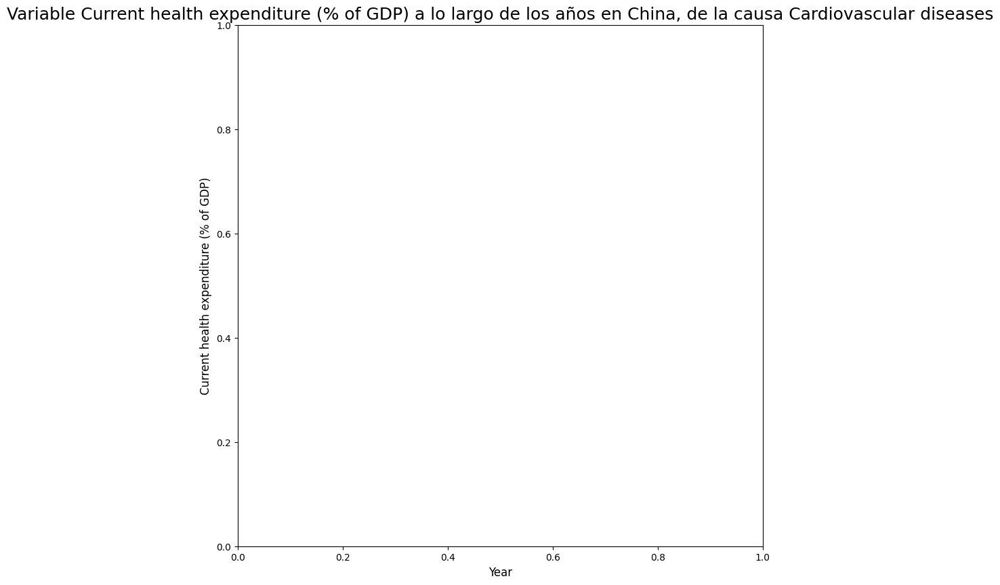

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


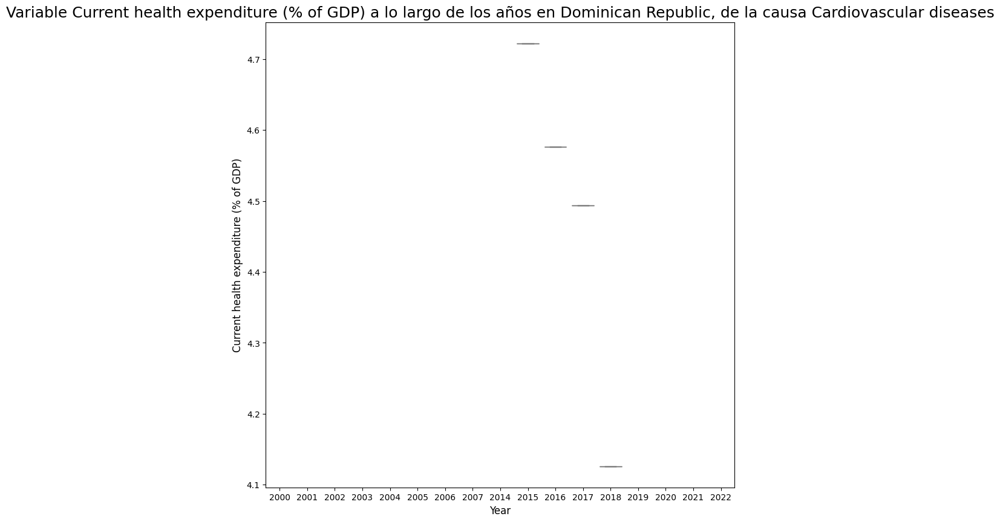

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


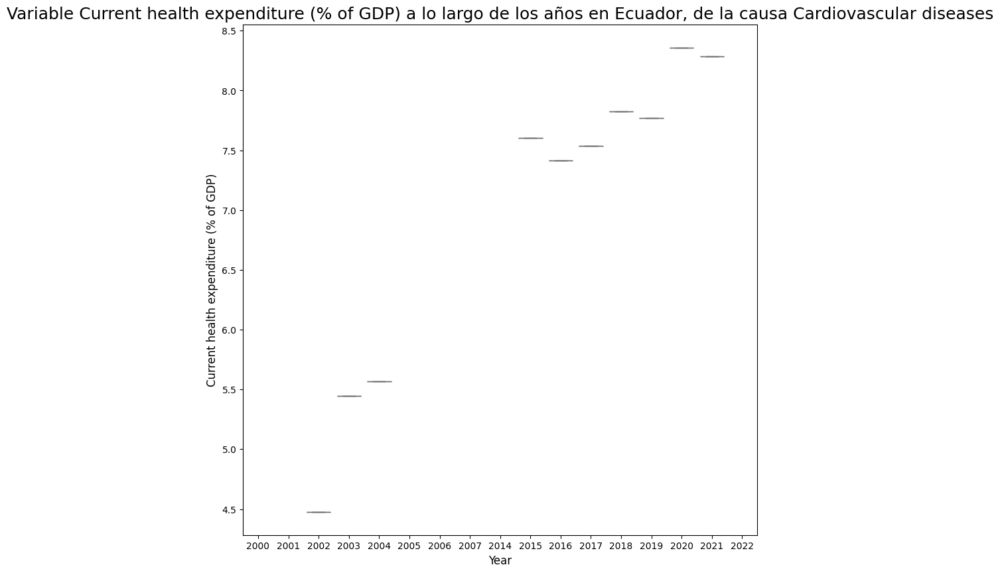

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


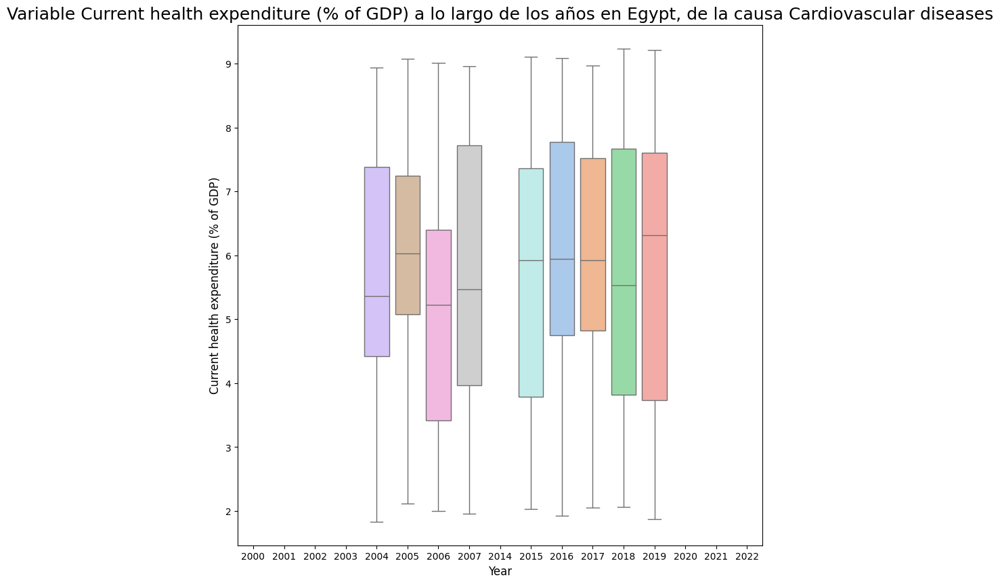

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


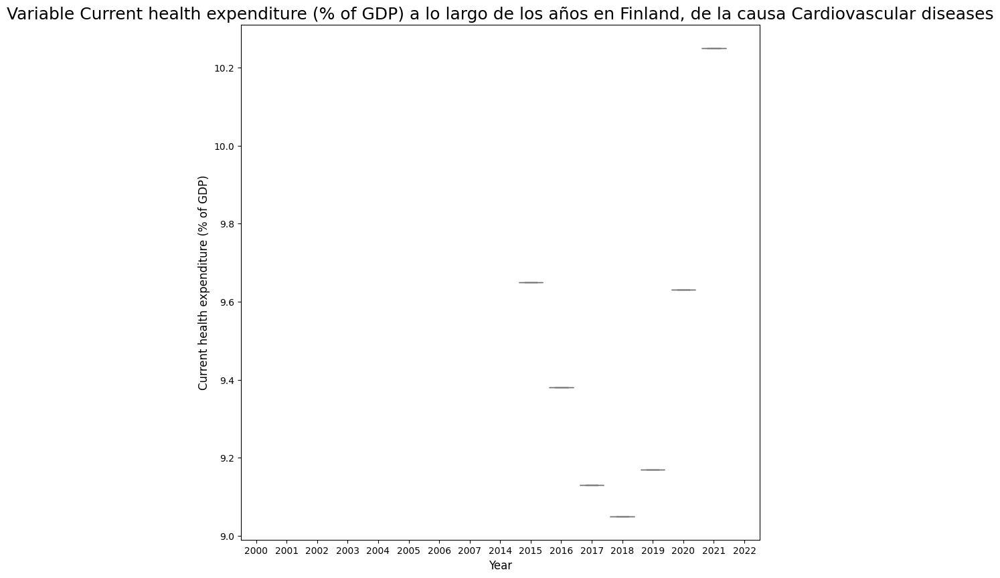

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


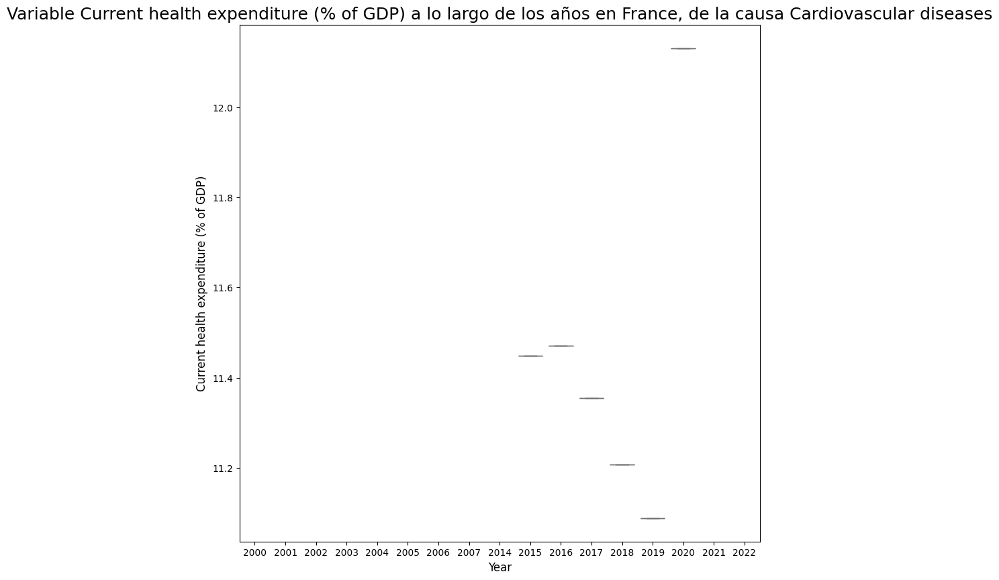

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


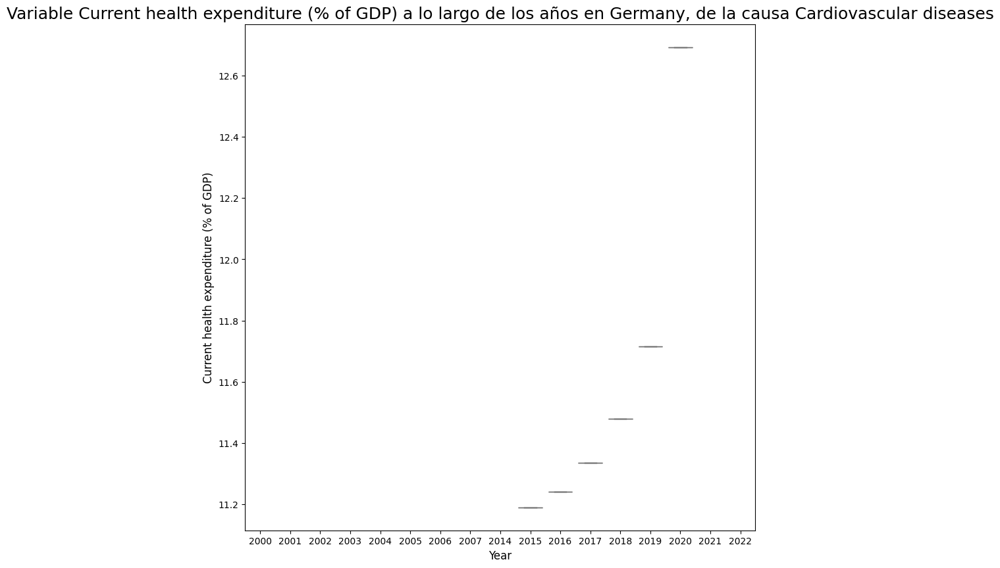

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


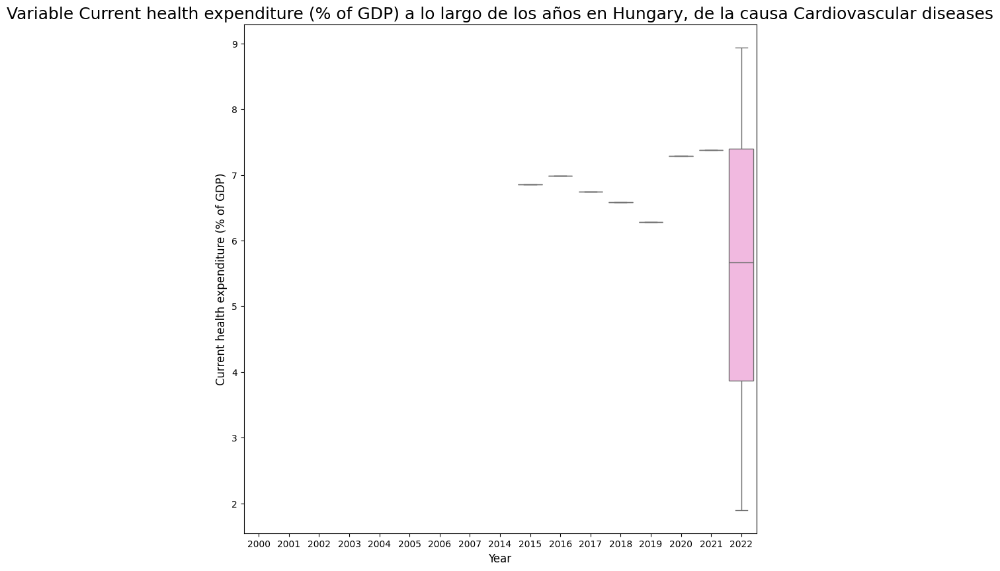

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


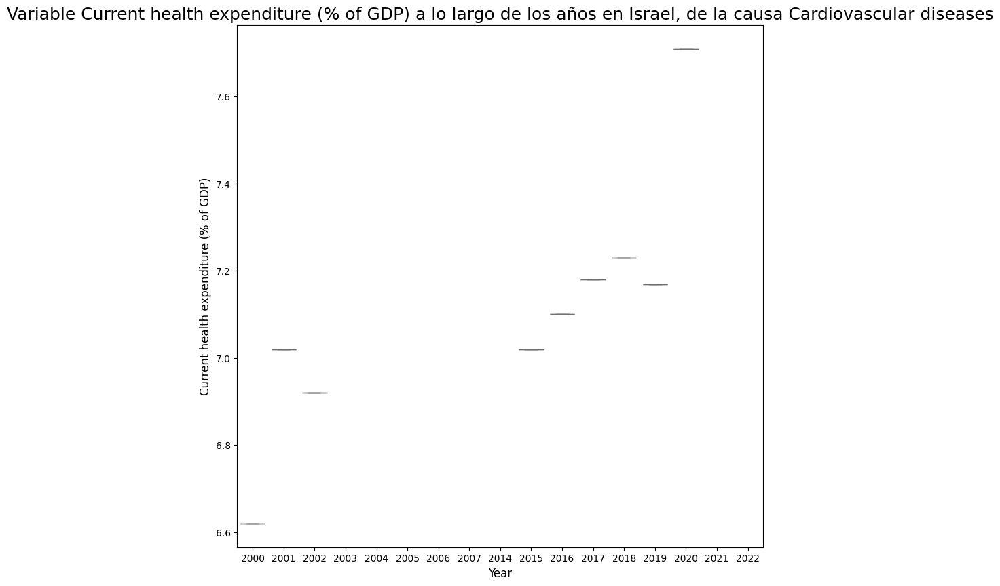

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


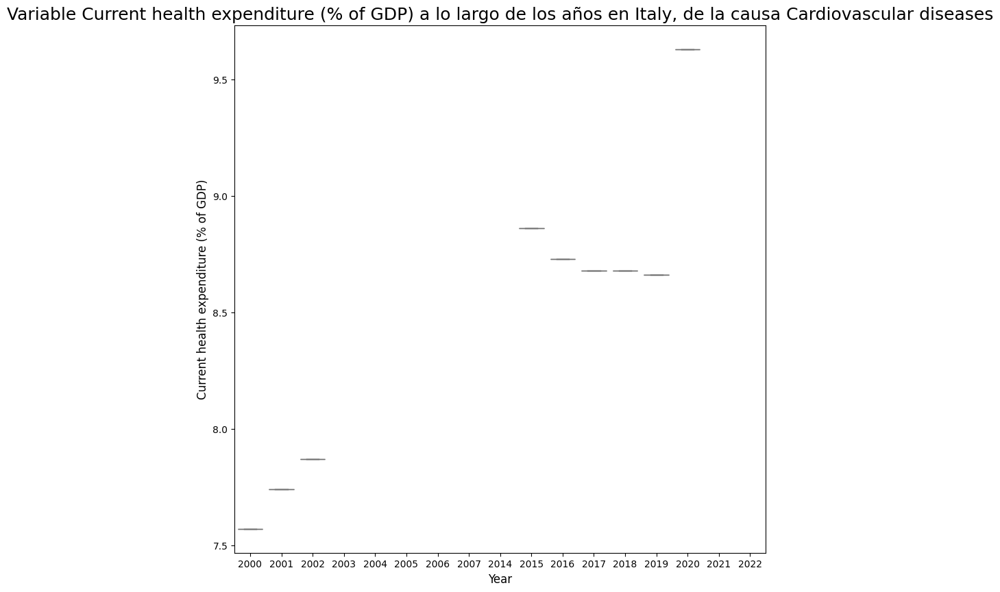

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


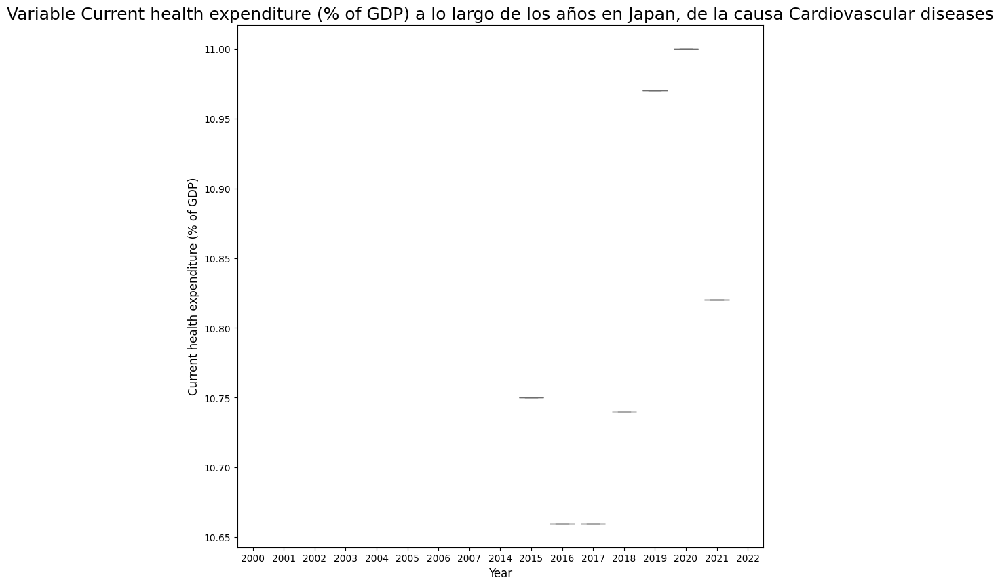

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


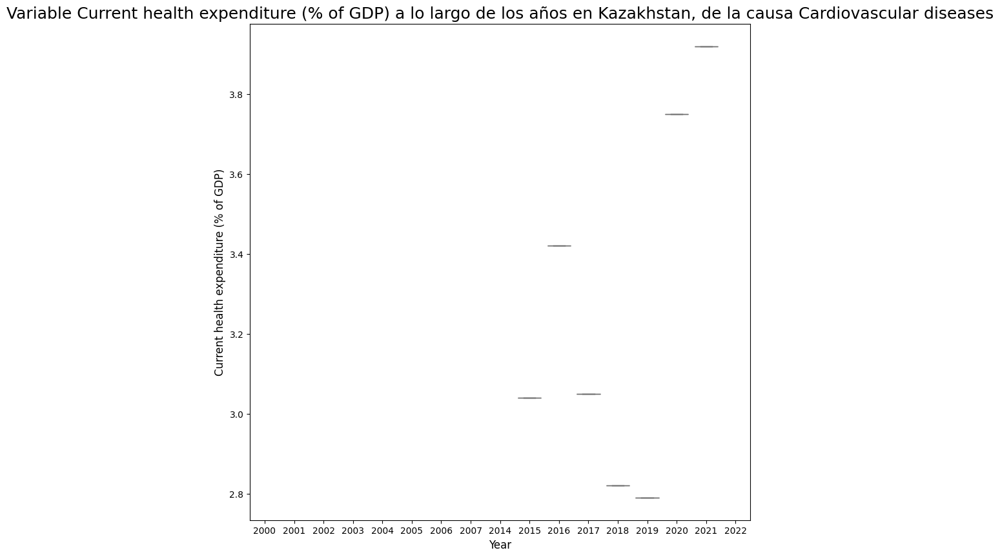

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


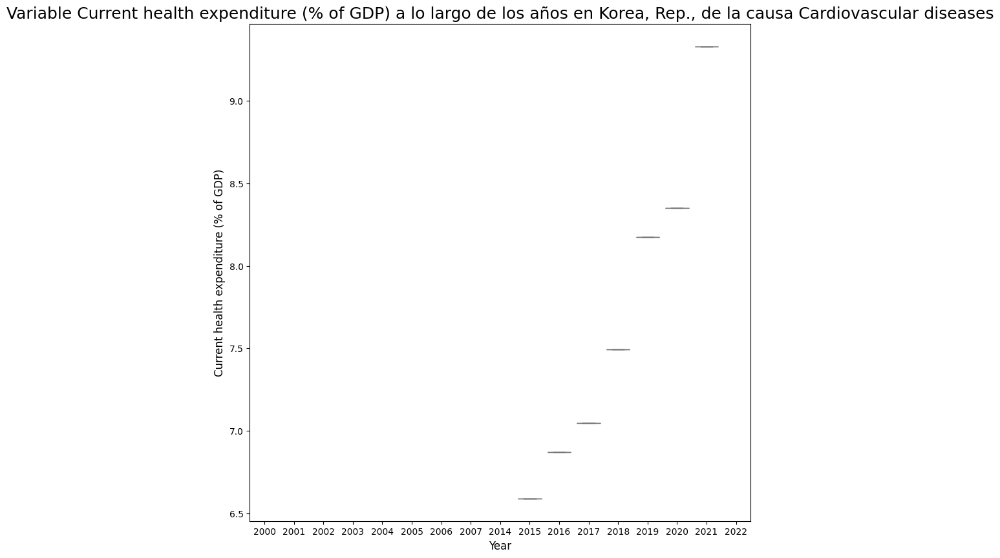

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


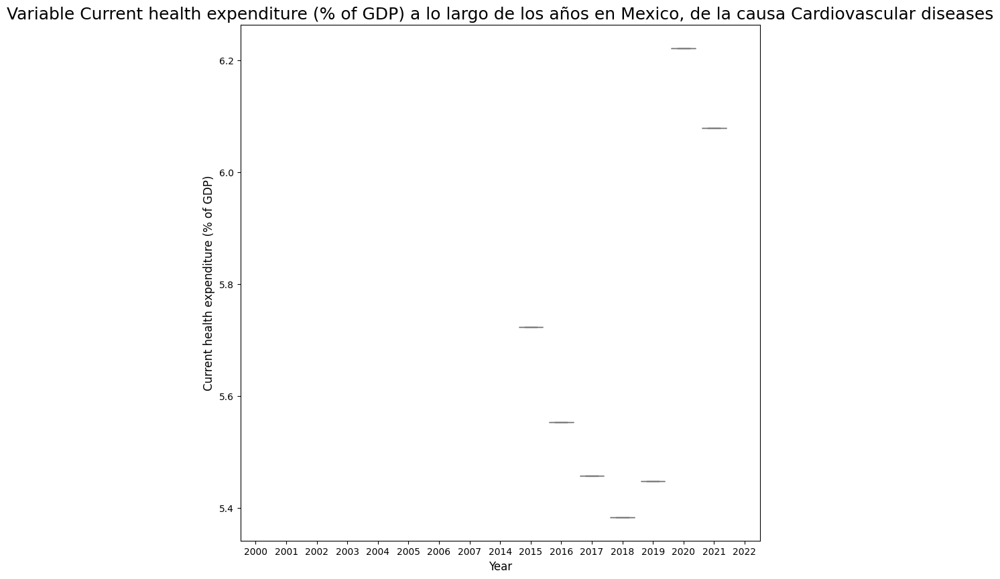

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


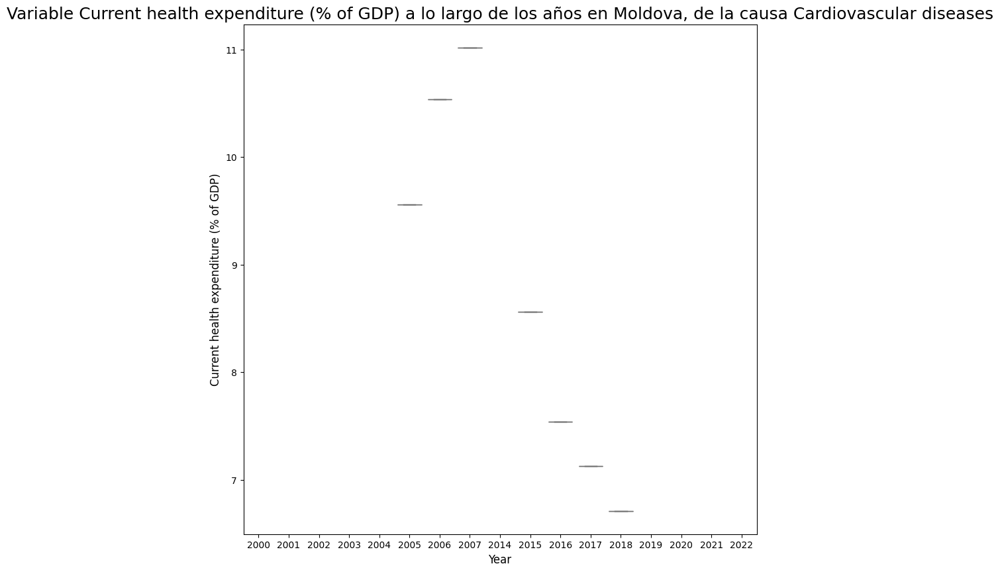

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


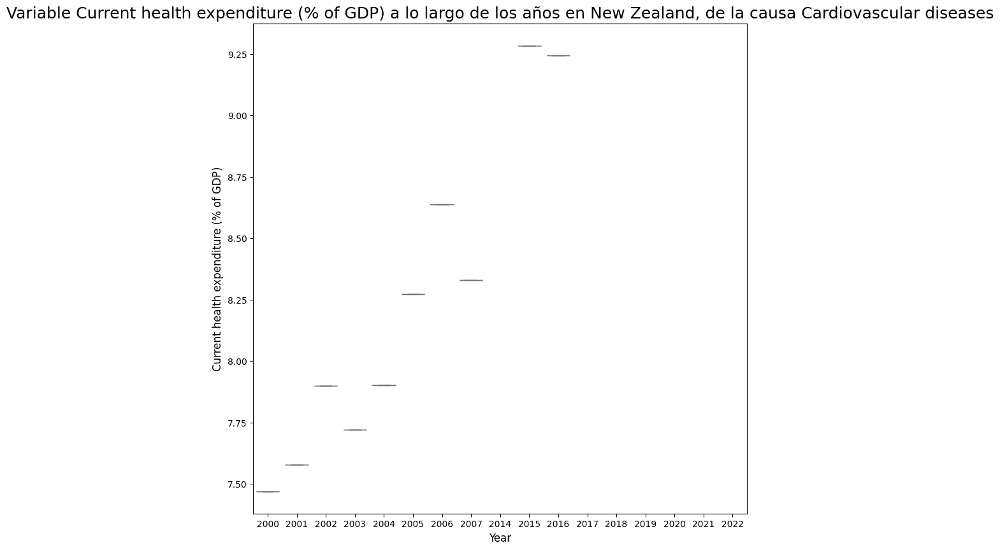

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


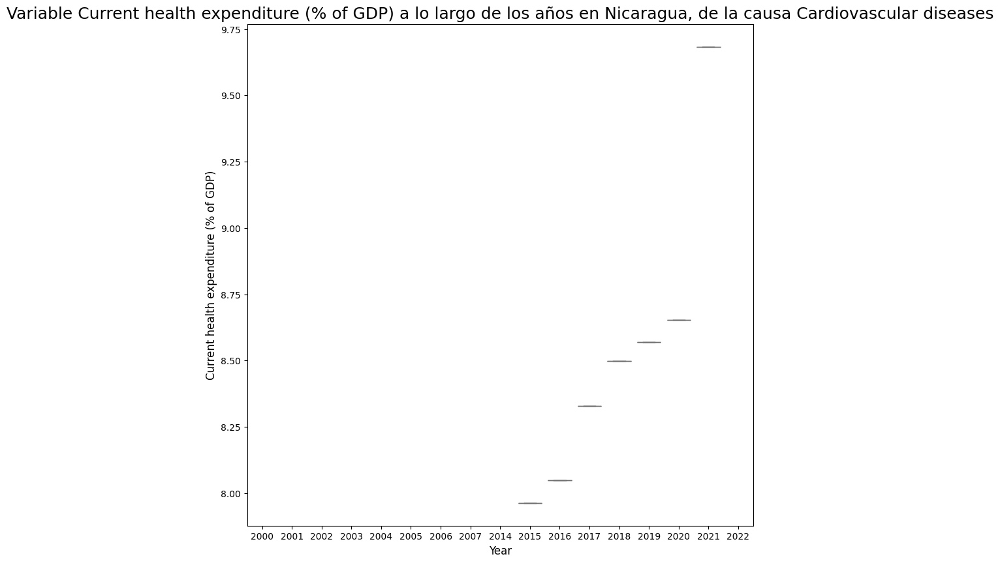

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


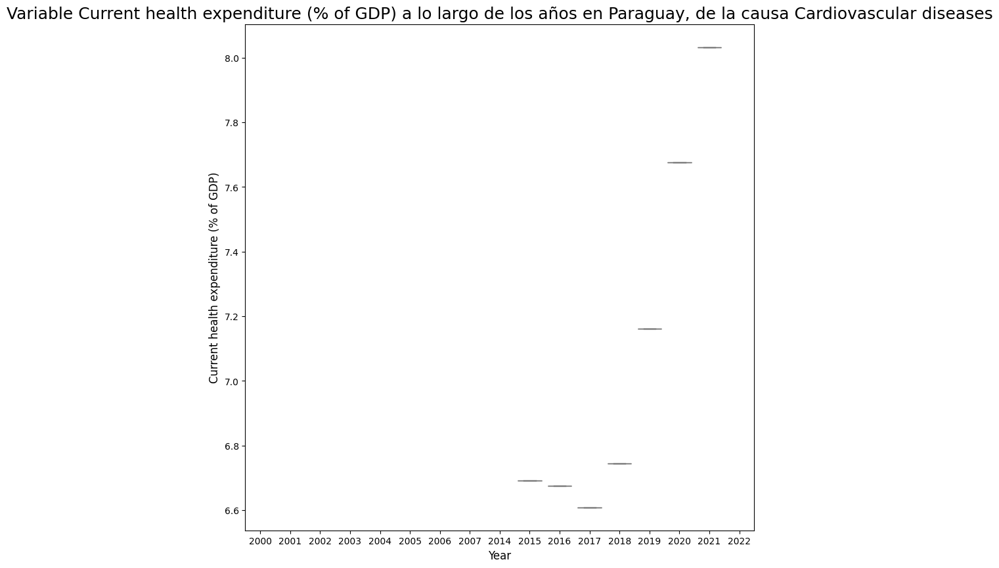

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


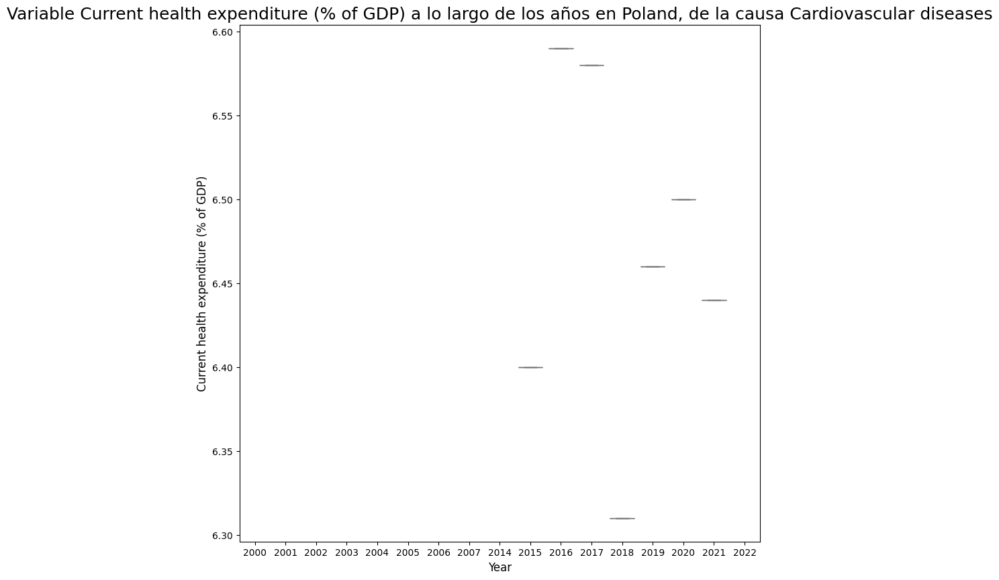

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


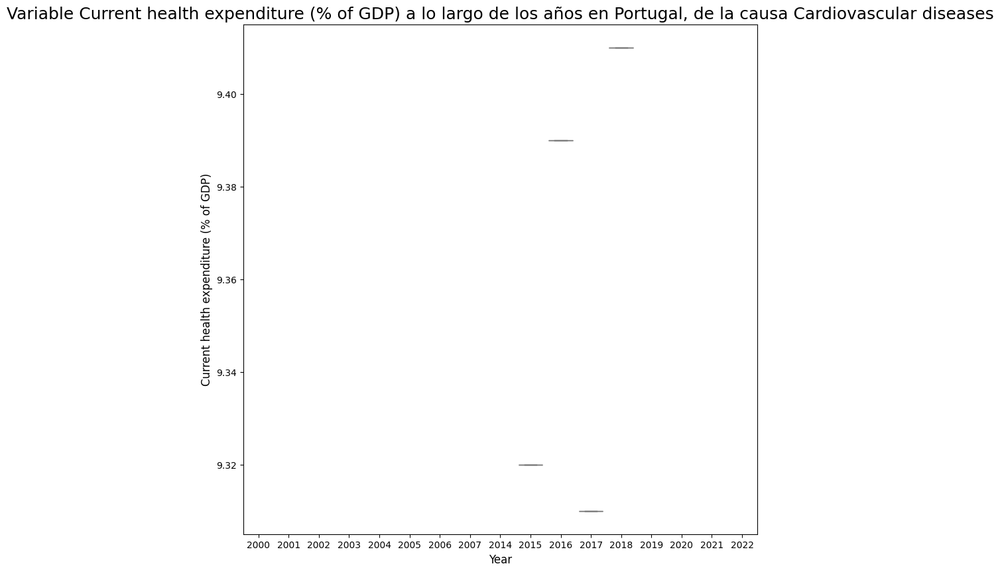

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


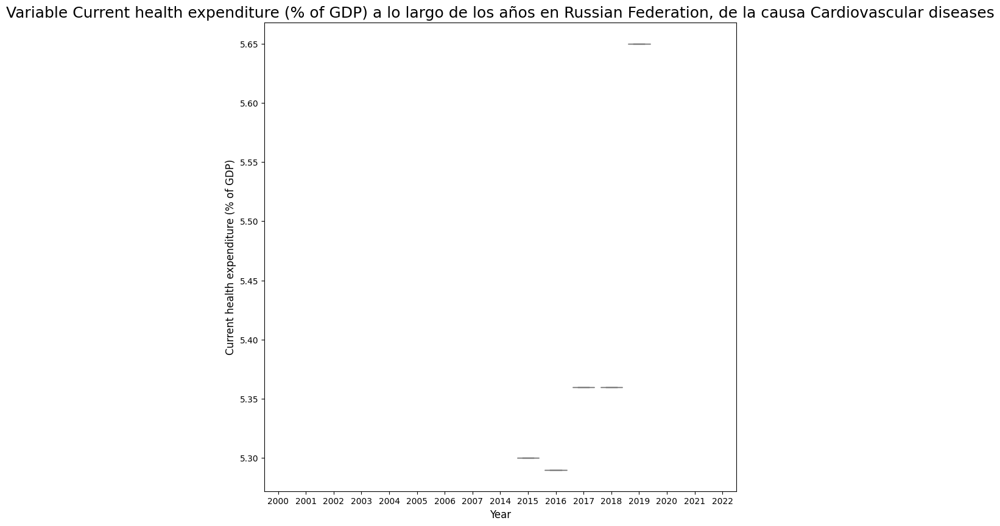

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


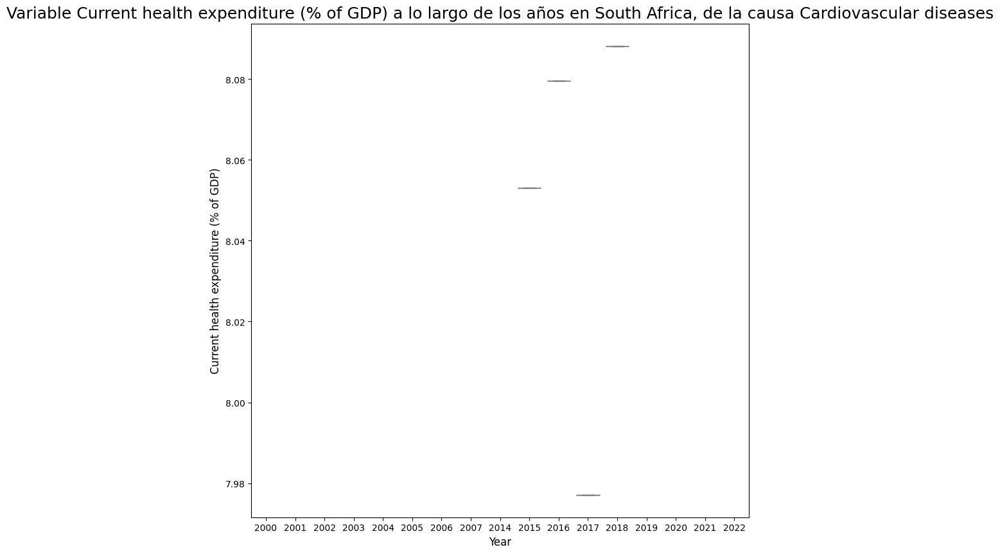

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


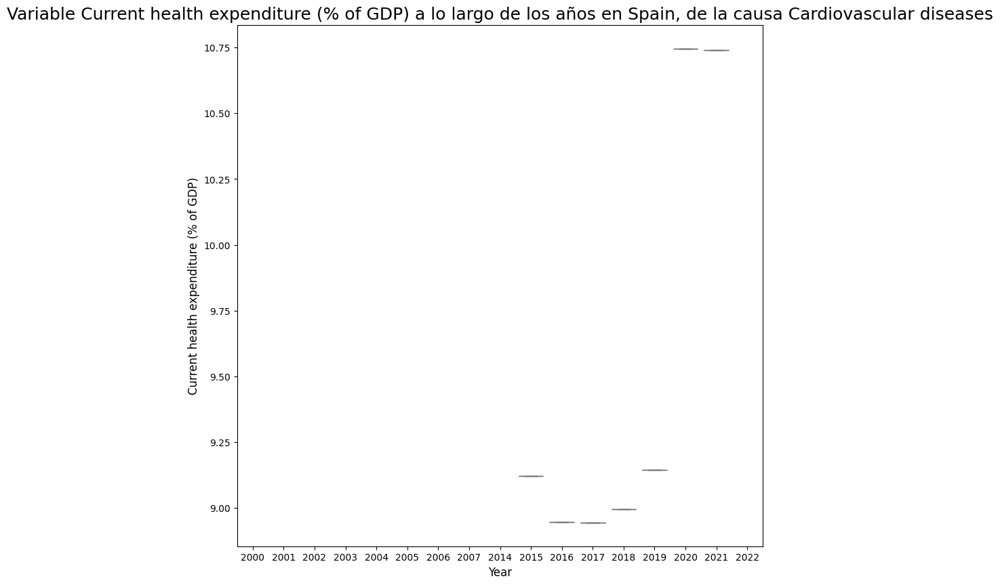

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


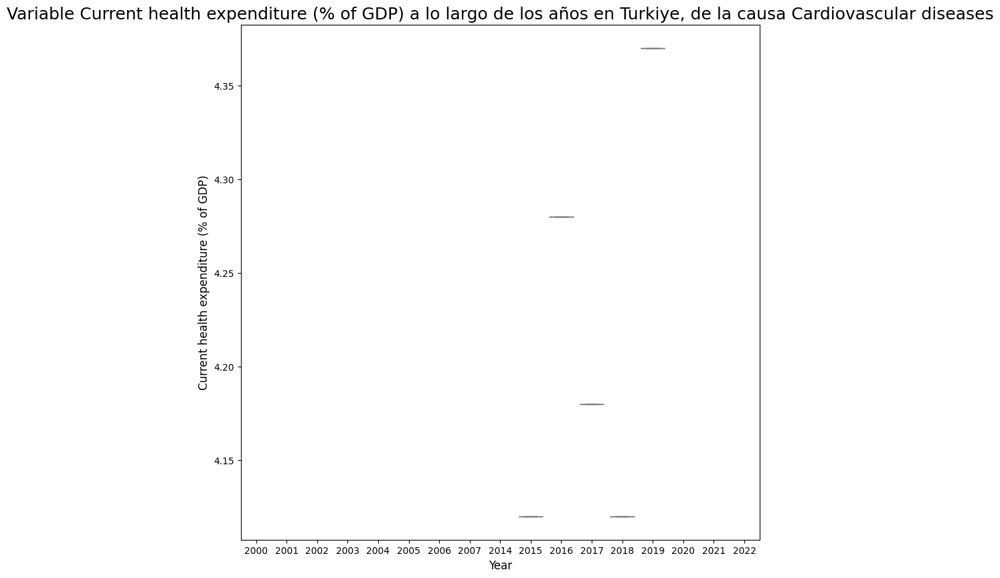

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


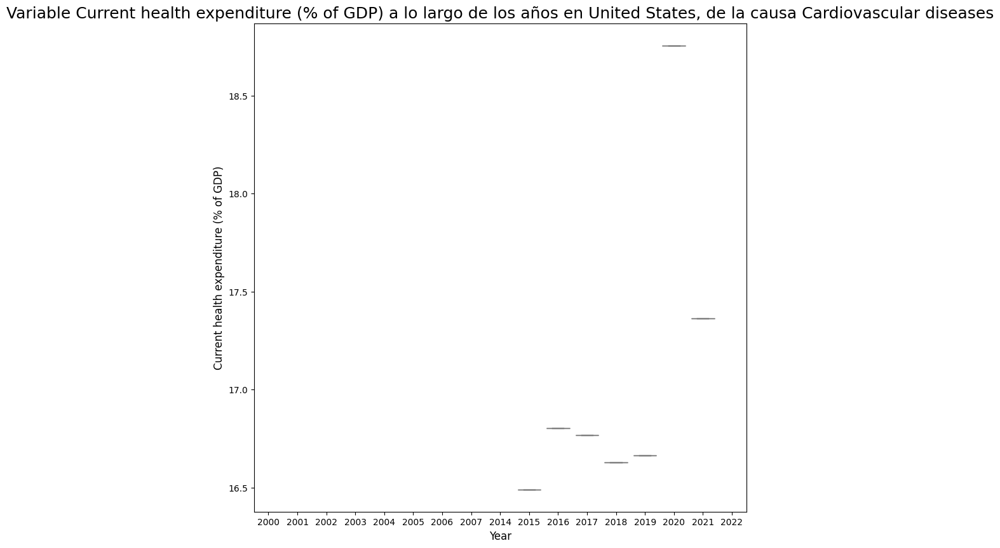

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


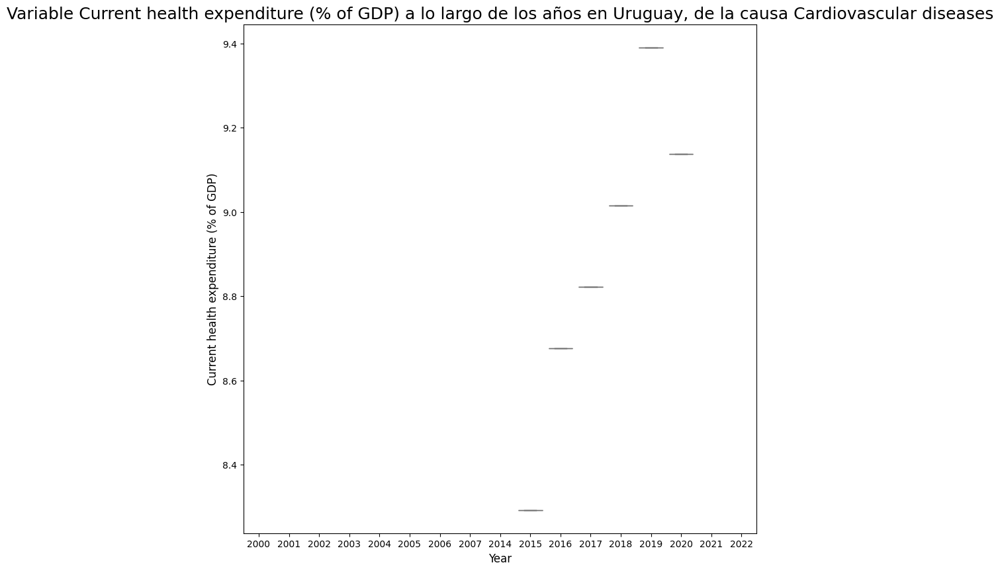

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


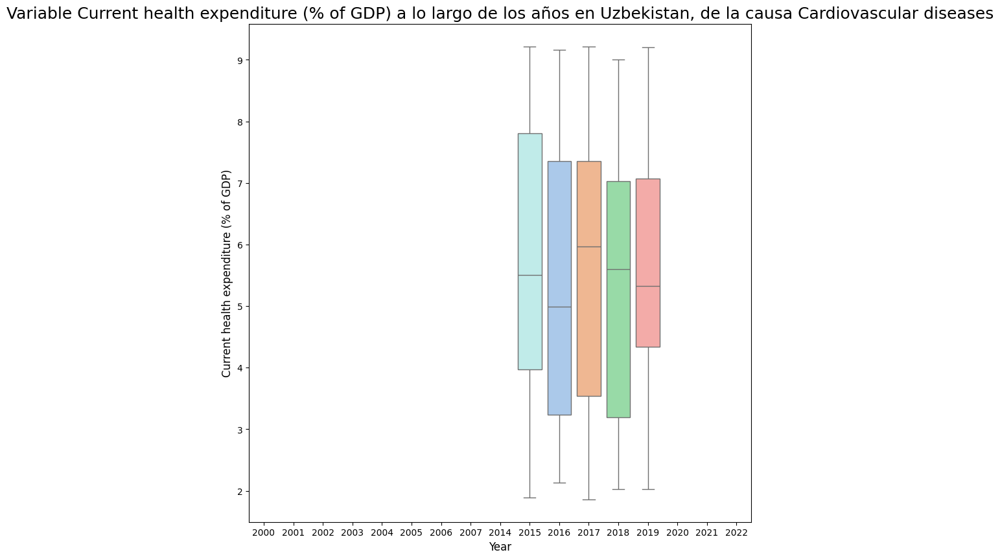

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


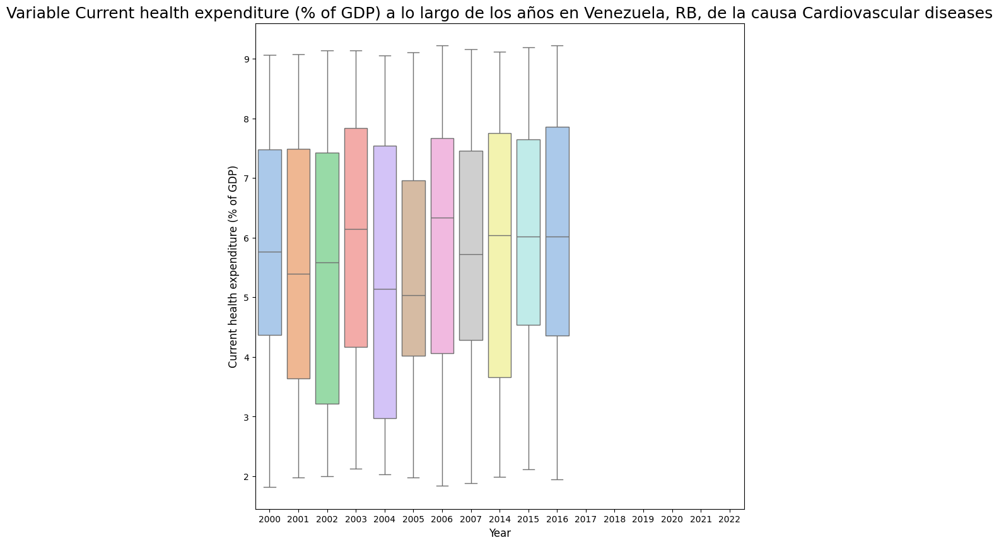

In [ ]:
boxplot_continuous_variables_with_economic_information(df_cardiovascular_diseases, "Current health expenditure (% of GDP)", "Cardiovascular diseases")

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


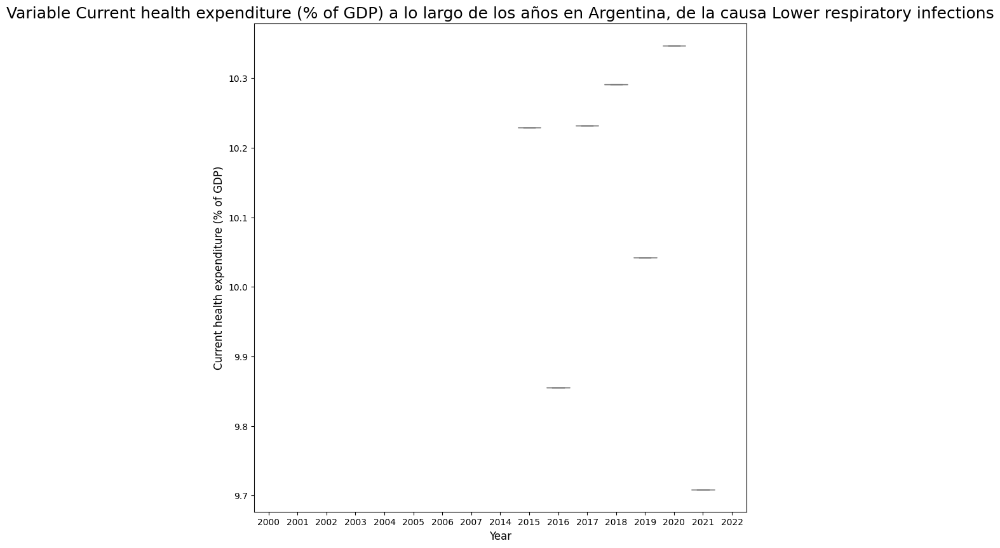

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


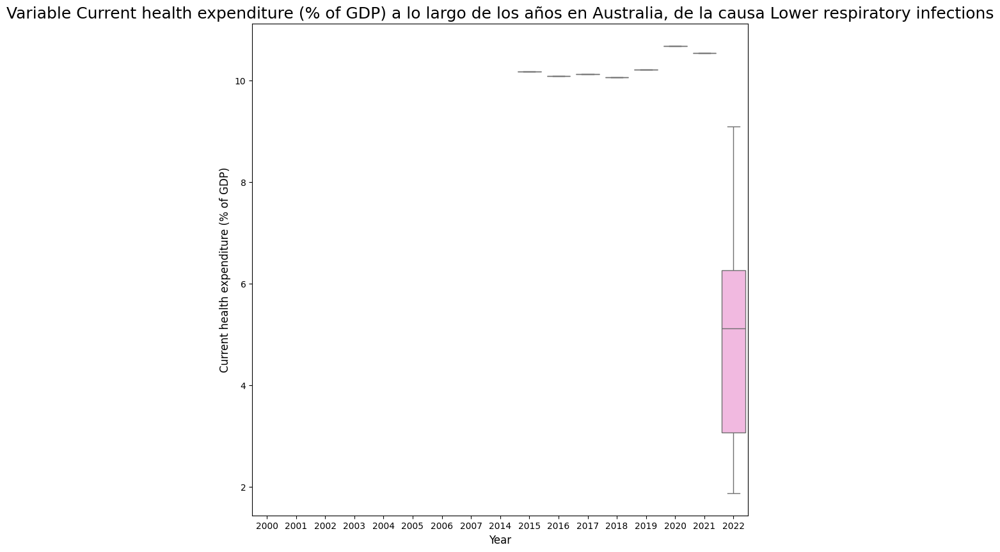

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


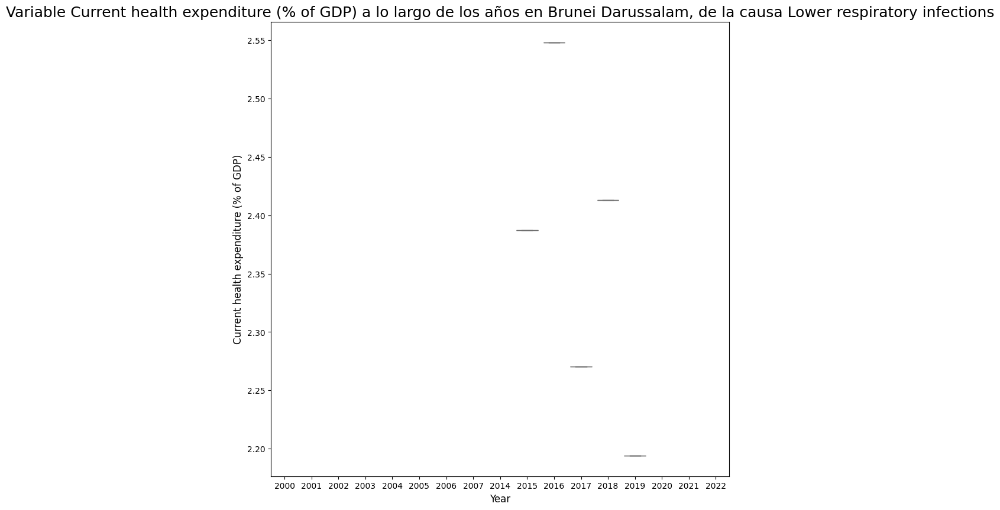

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


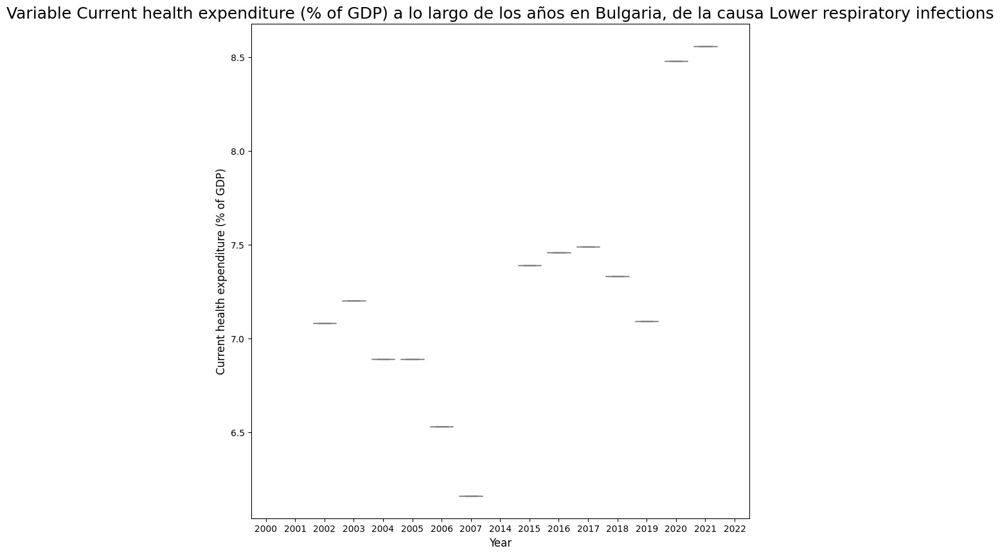

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


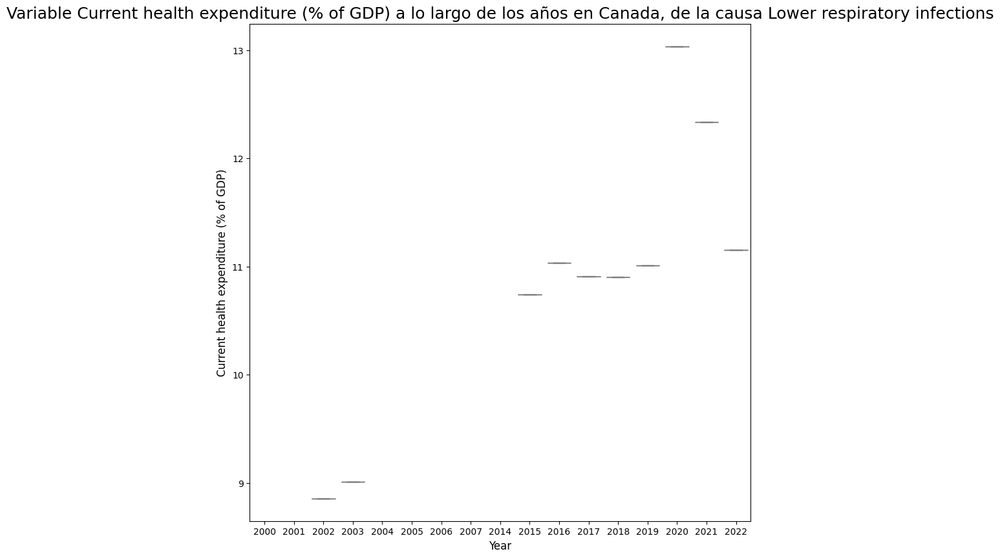

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


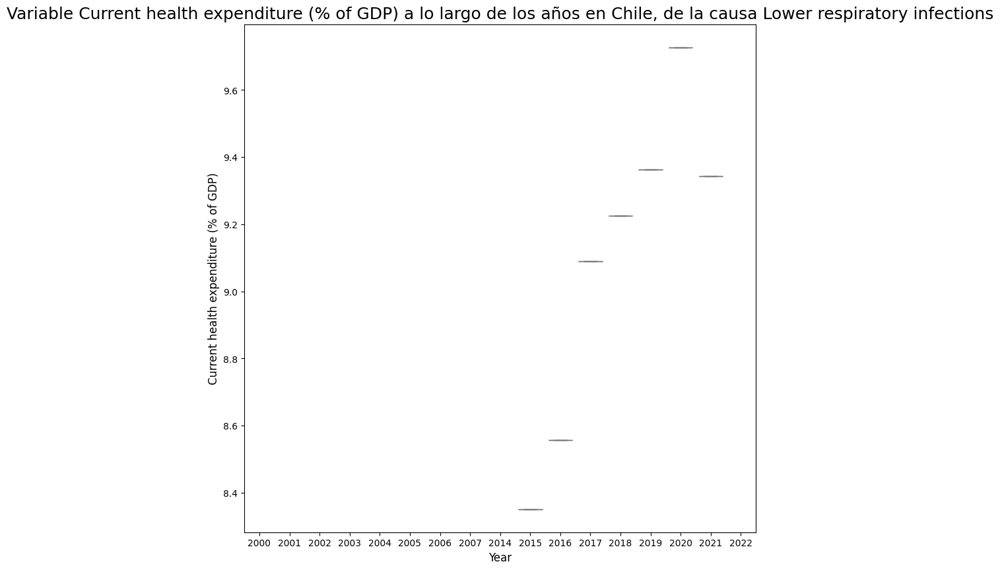

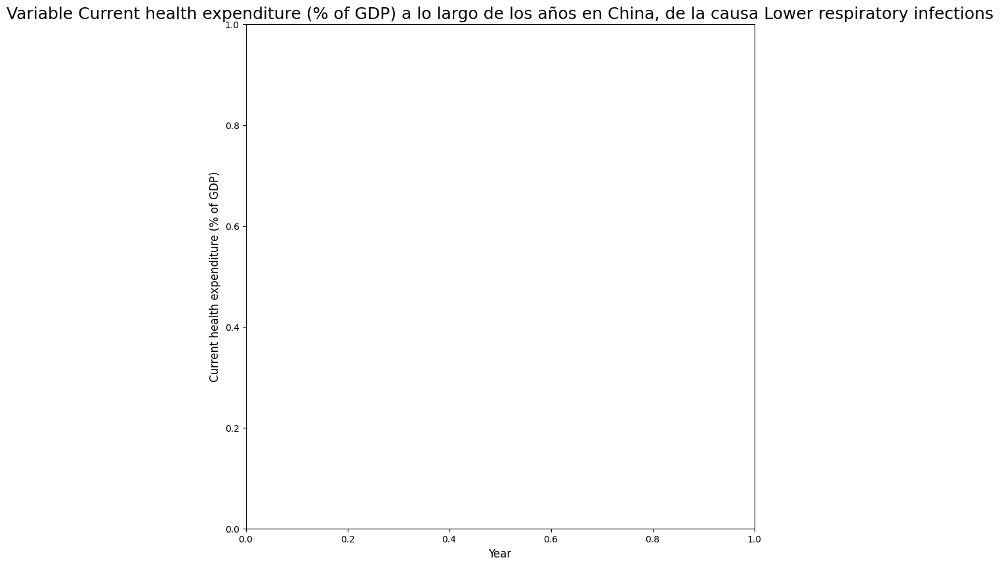

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


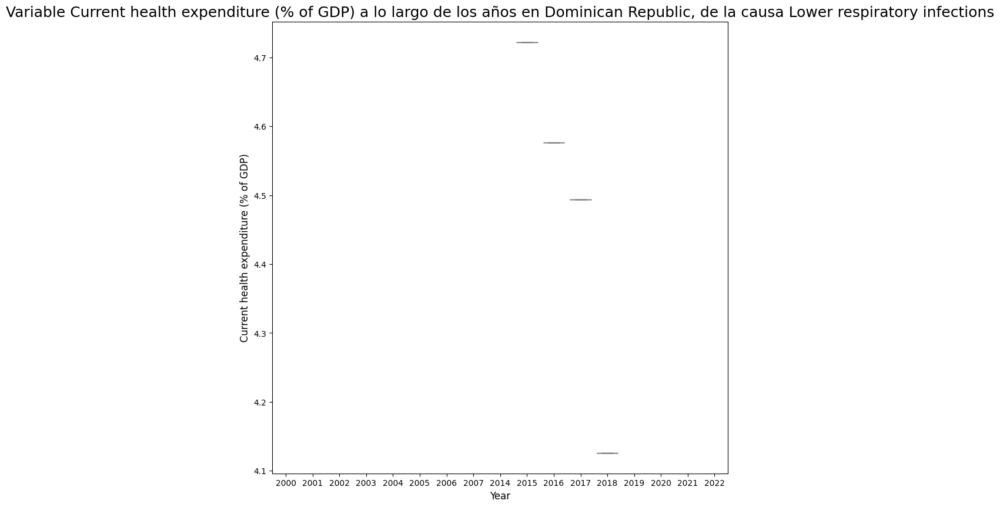

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


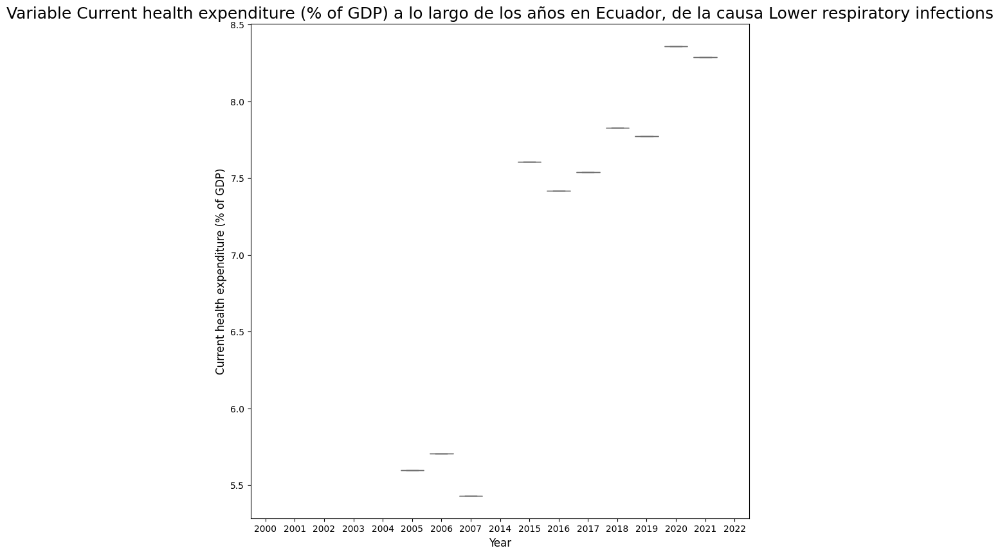

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


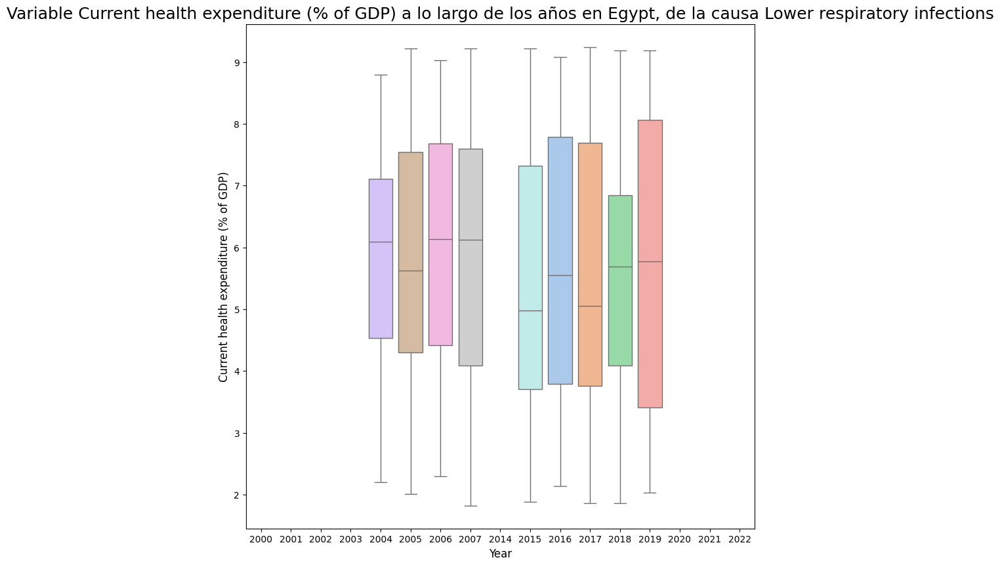

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


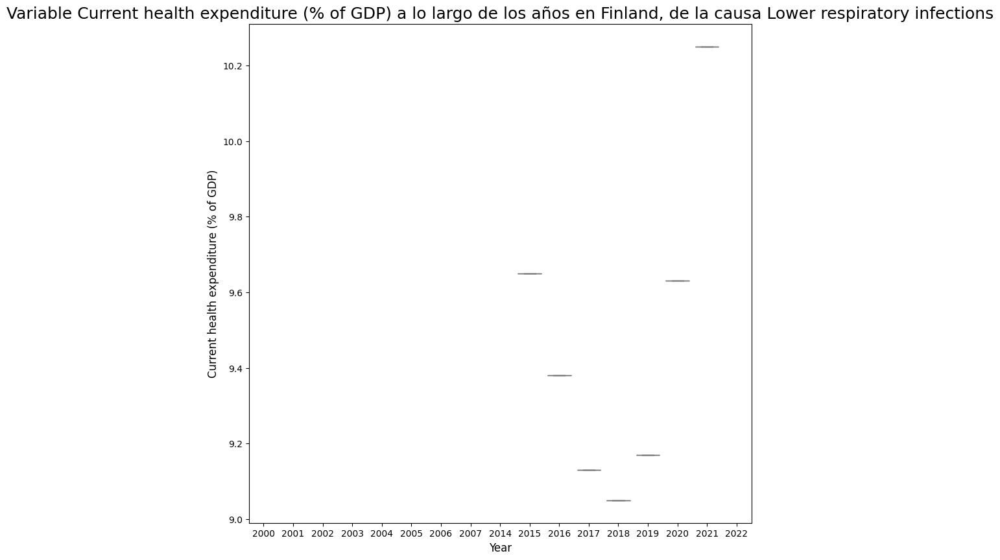

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


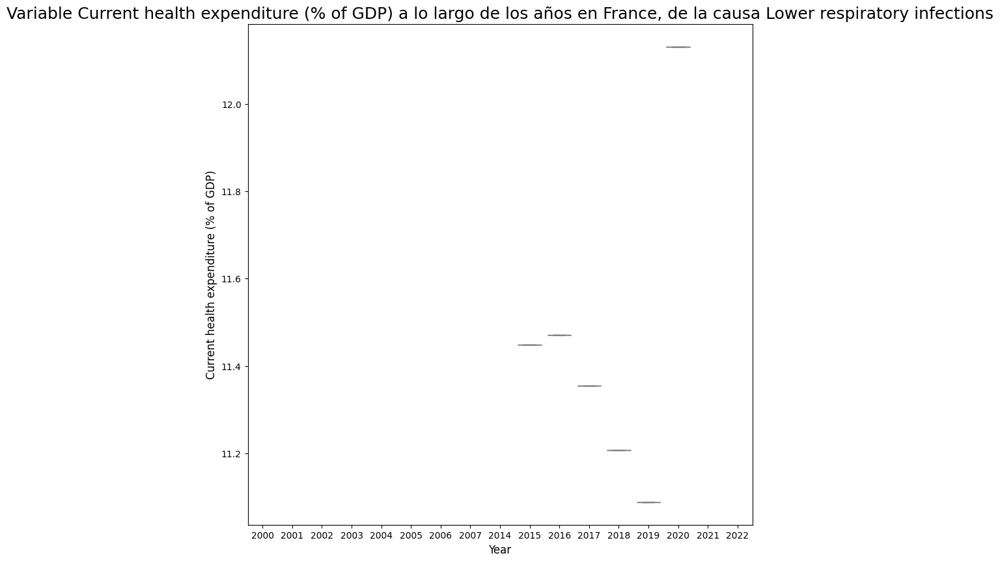

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


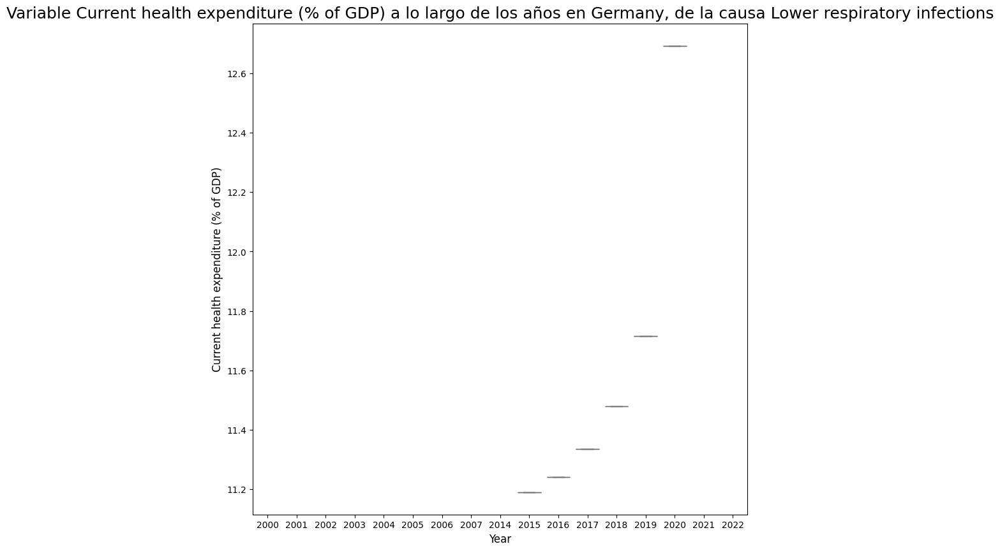

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


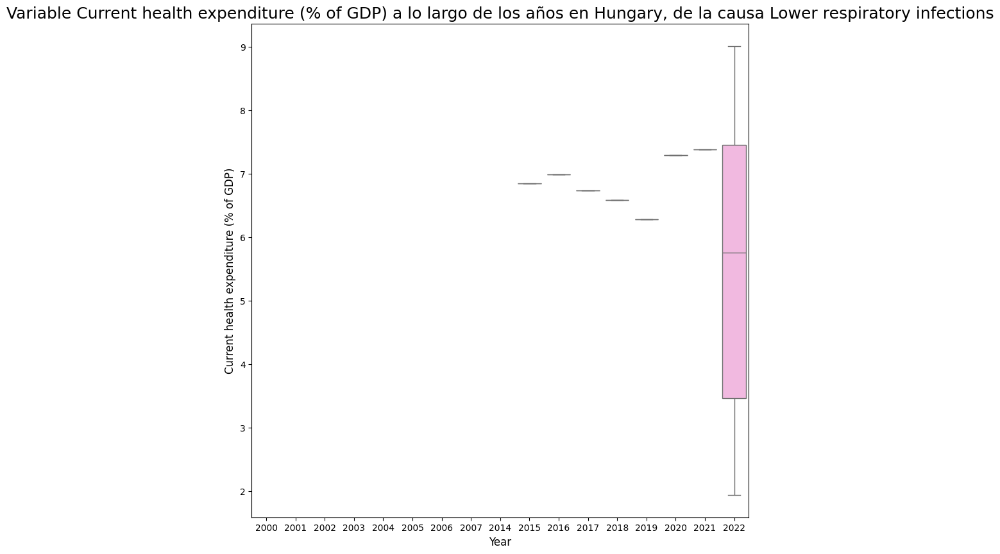

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


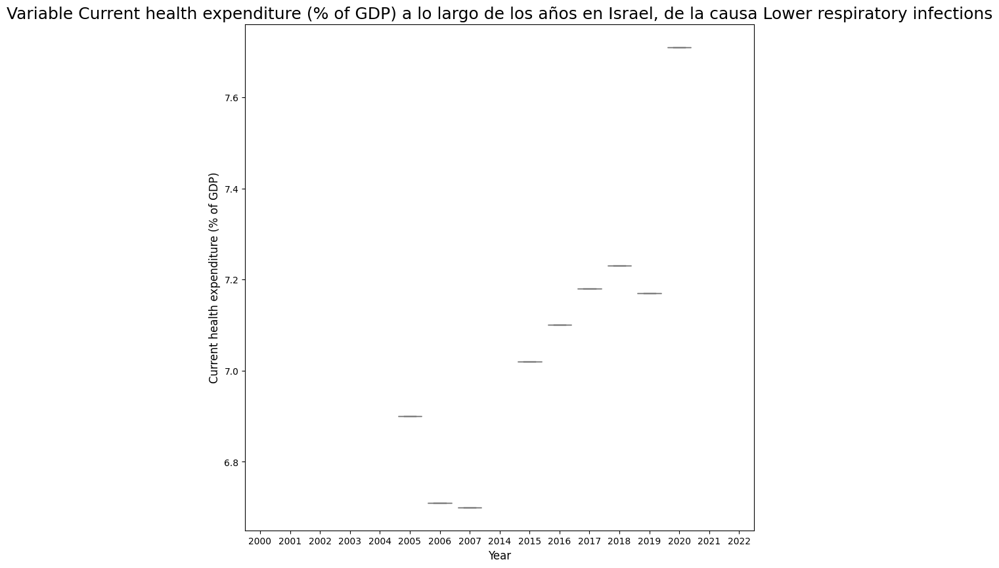

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


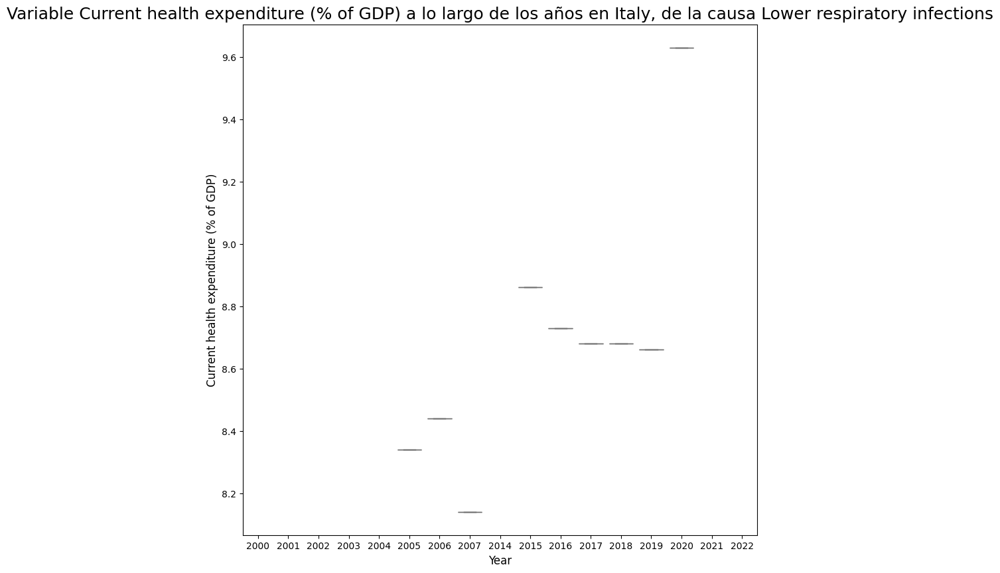

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


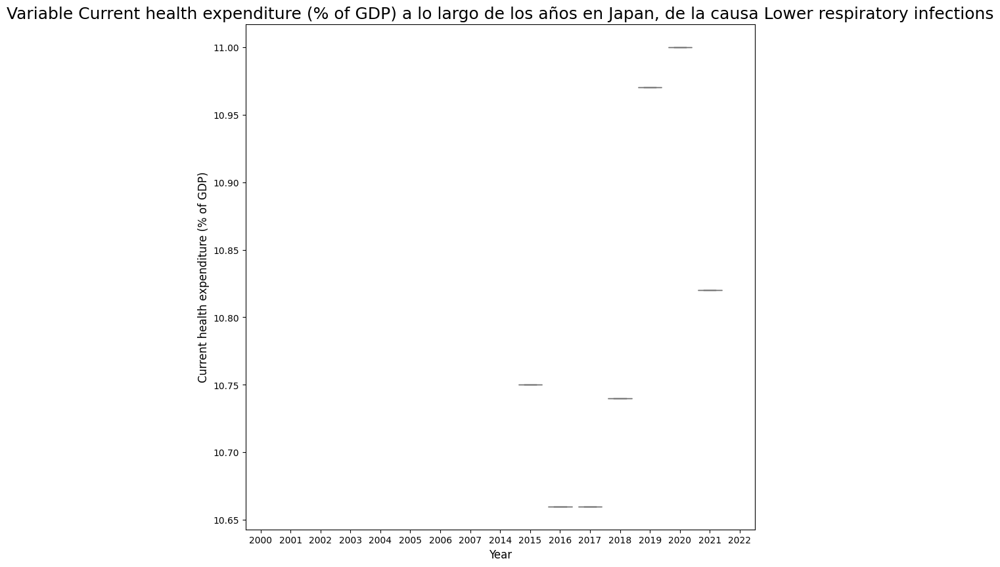

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


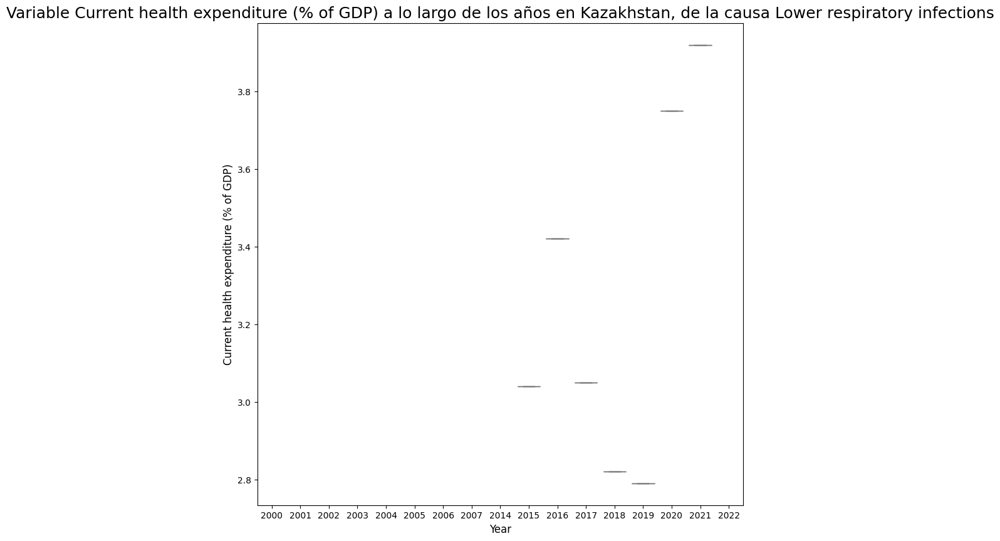

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


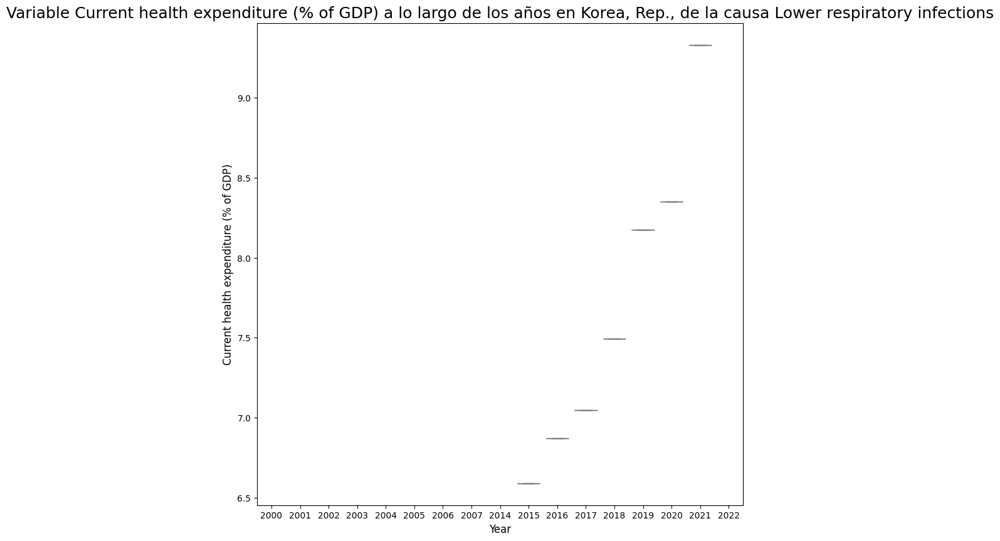

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


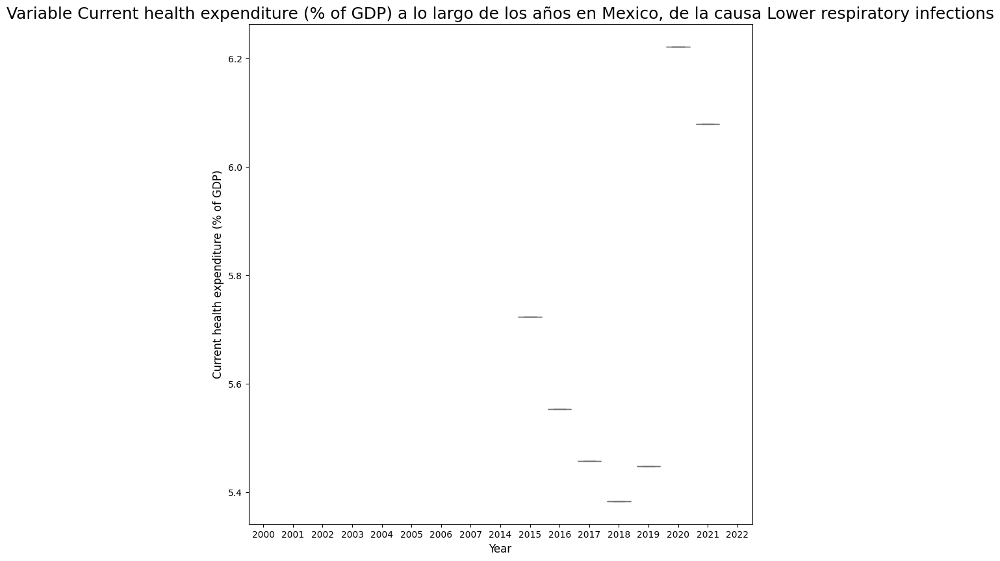

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


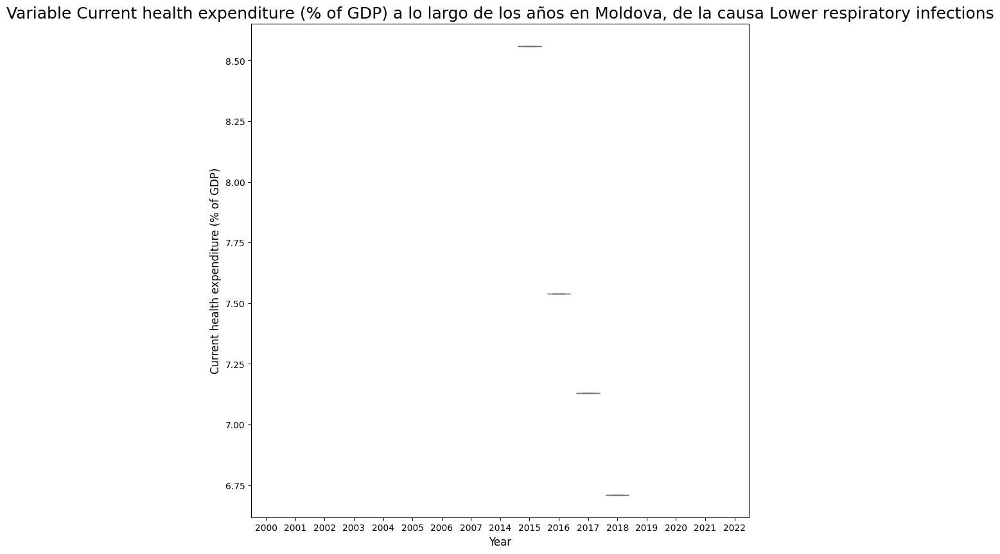

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


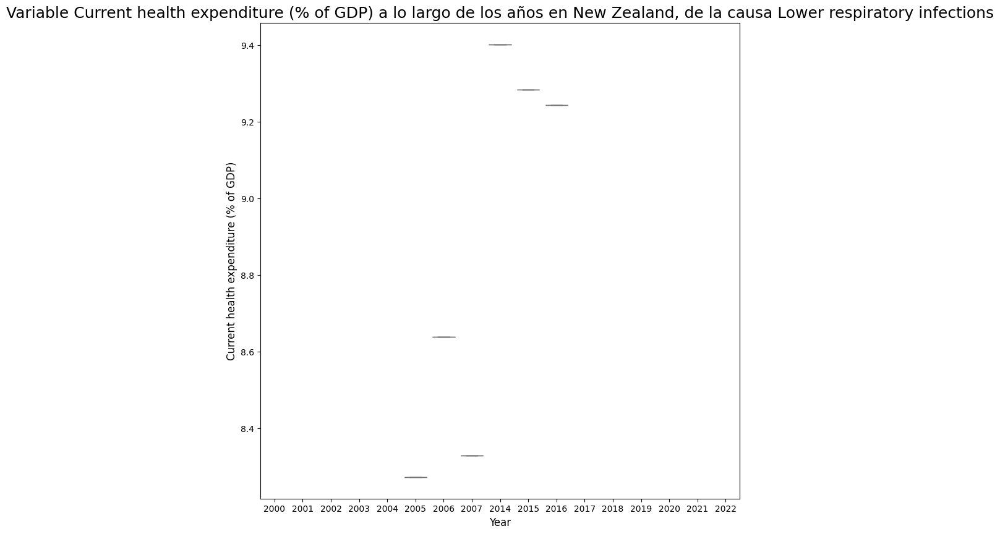

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


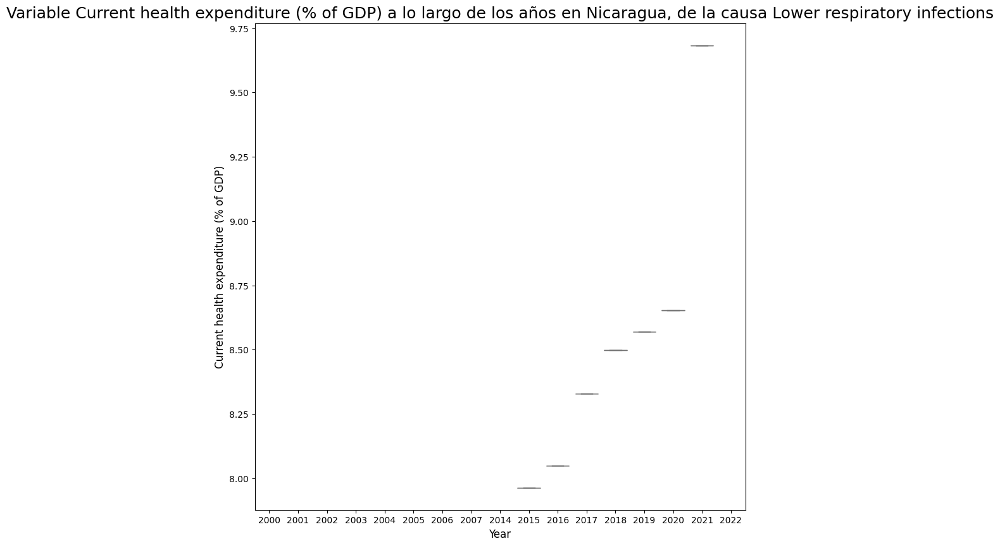

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


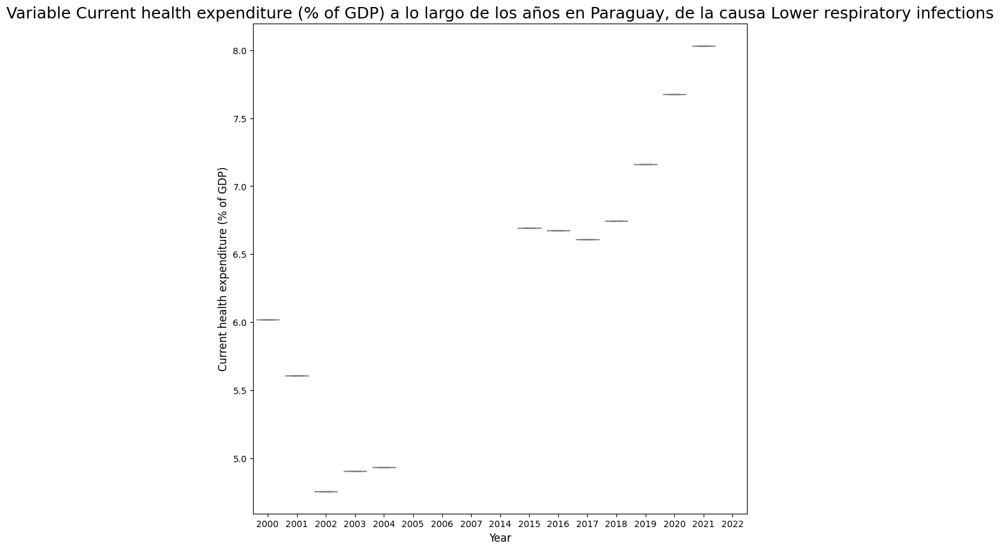

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


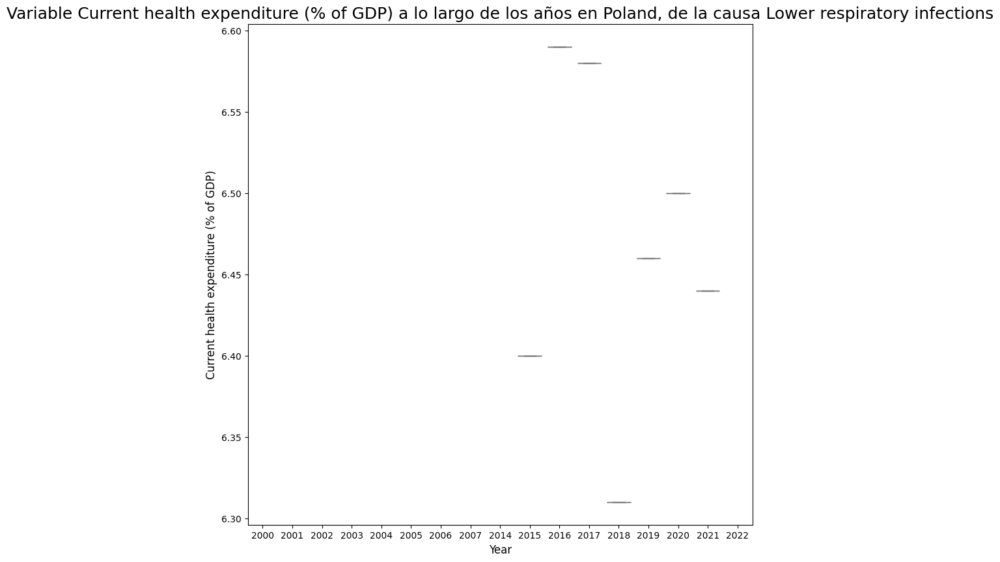

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


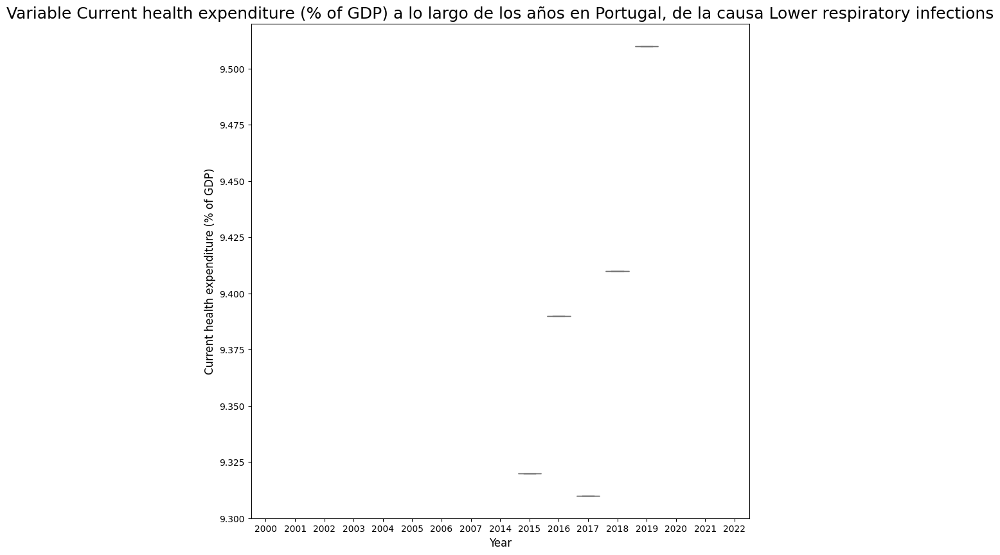

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


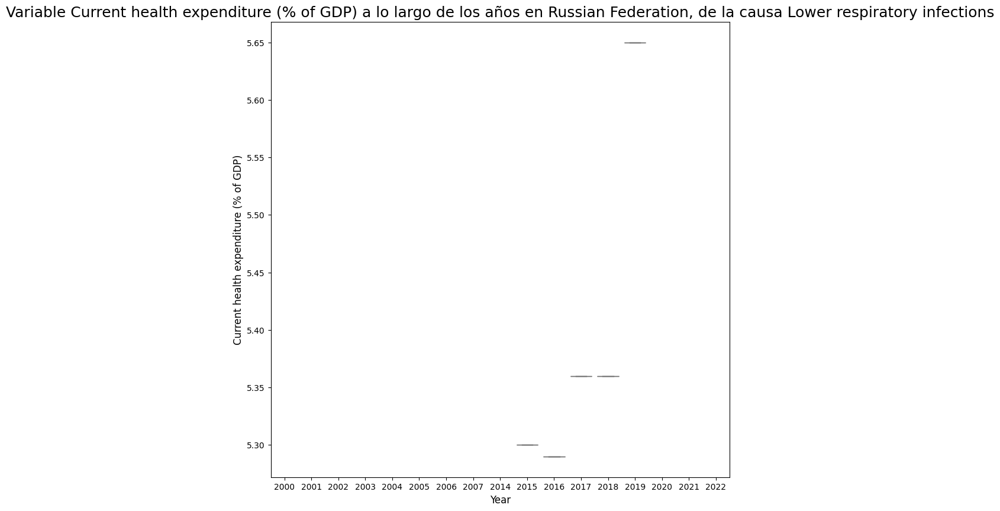

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


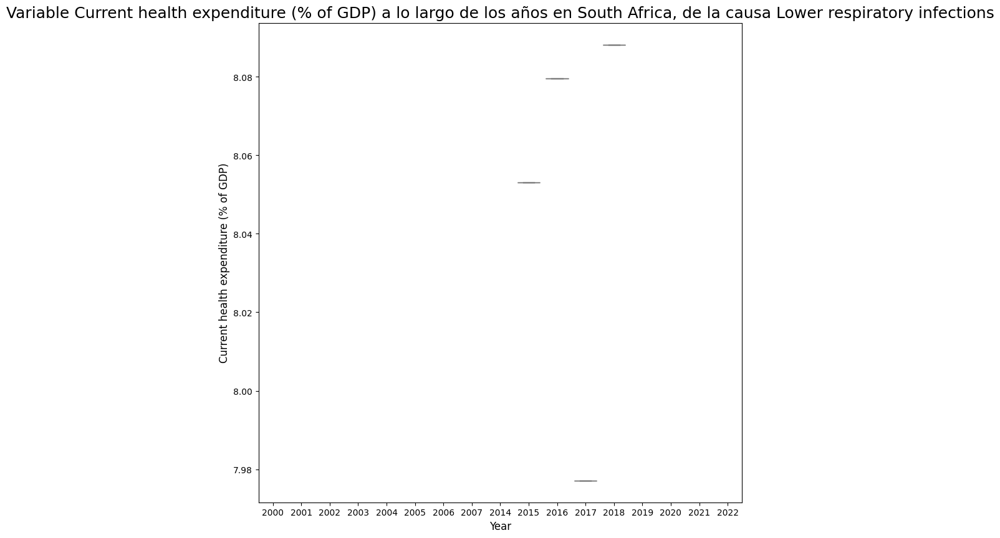

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


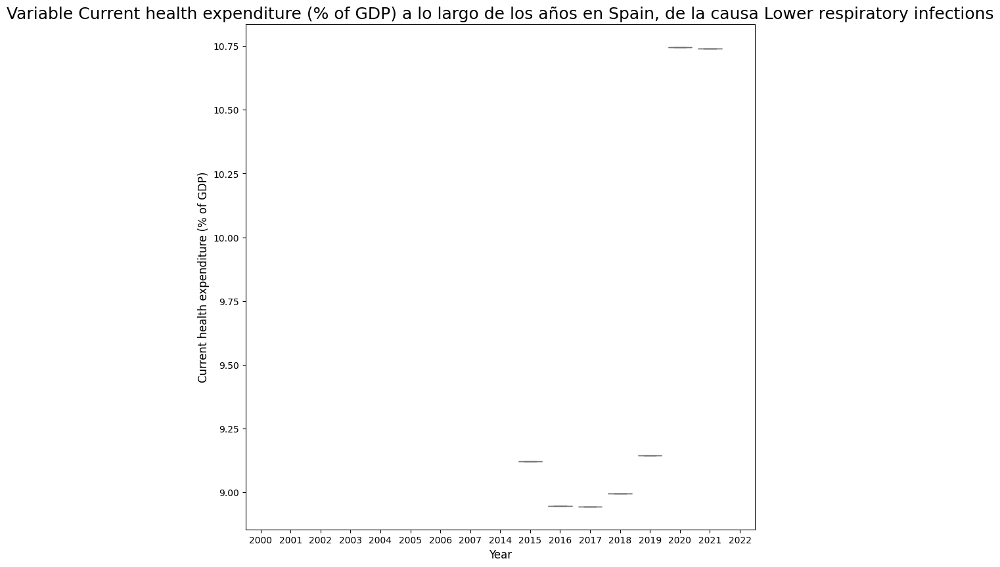

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


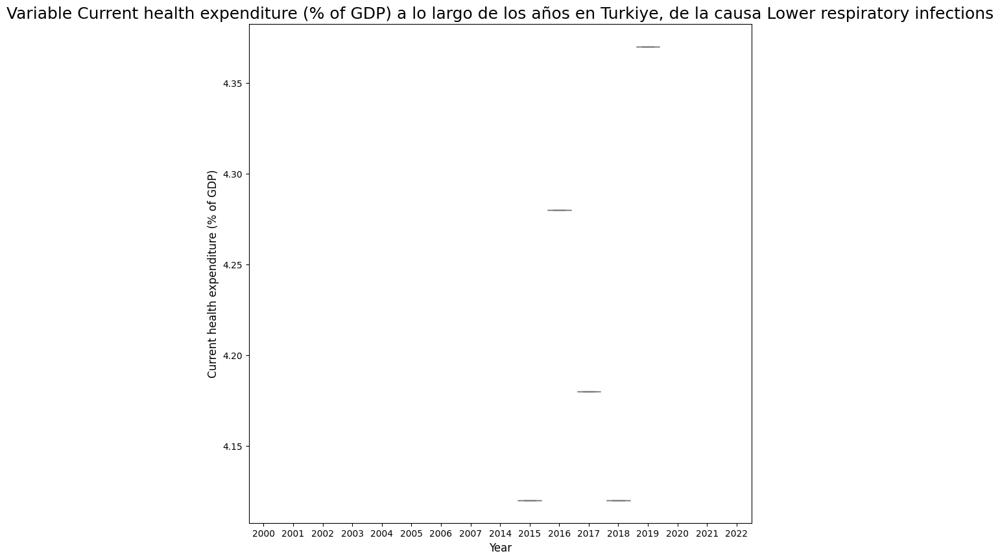

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


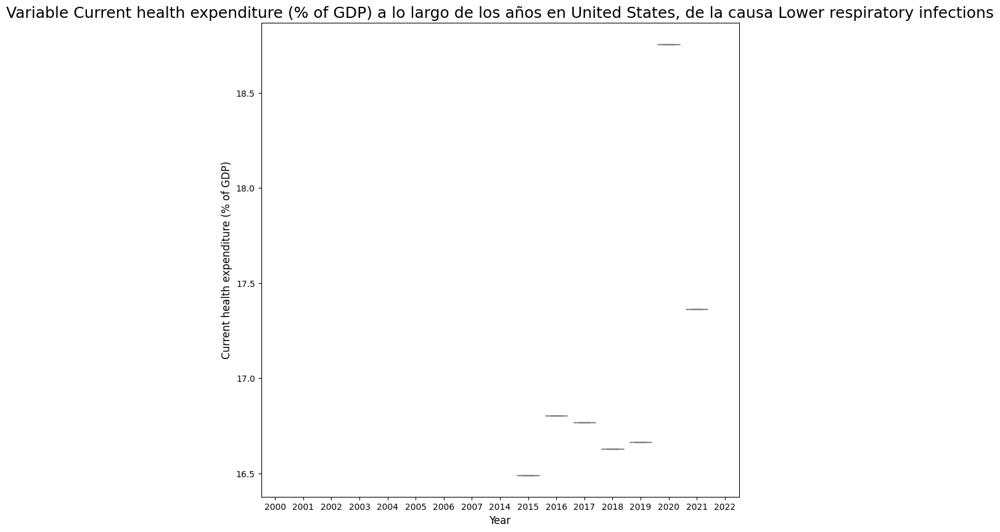

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


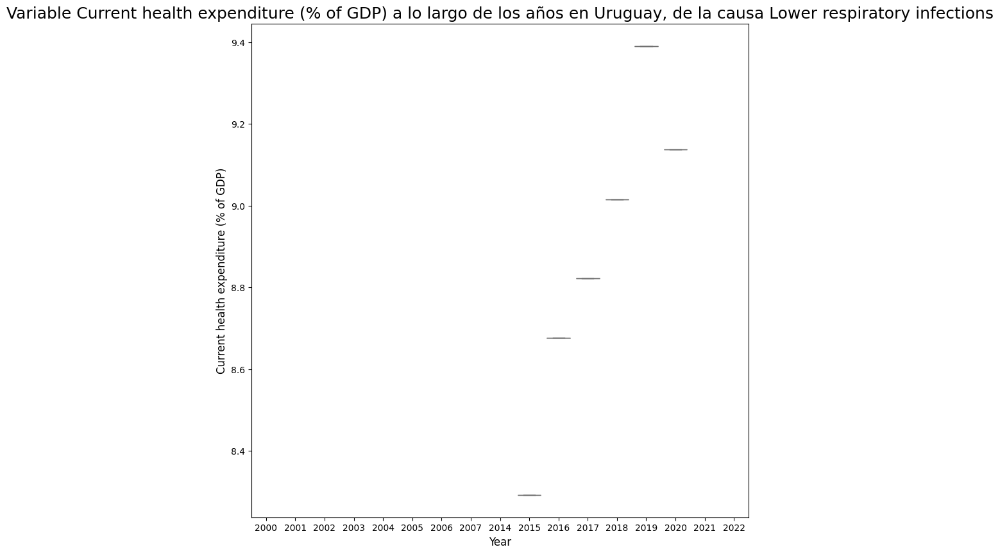

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


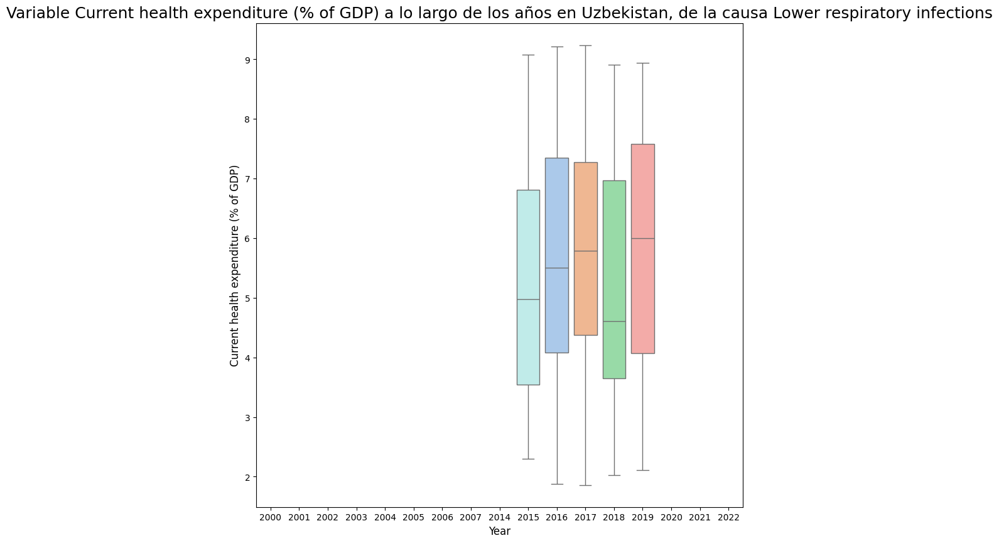

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


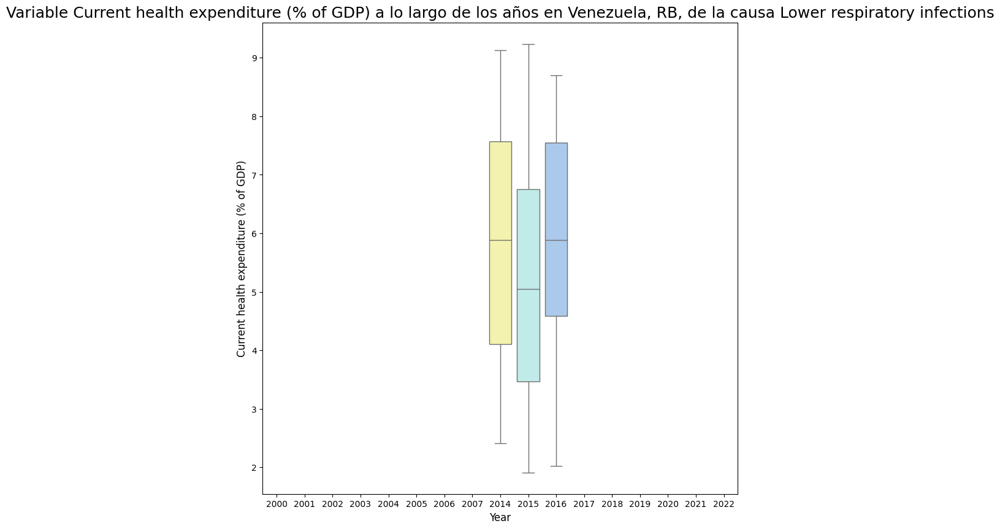

In [ ]:
boxplot_continuous_variables_with_economic_information(df_lower_respiratory_infections, "Current health expenditure (% of GDP)", "Lower respiratory infections")

**OUTLIERS:**<br>
Granulando más los datos, se pueden notar que los outliers desaparecen.<br>
Por lo que no creo que se deban eliminar, pero sí tratar, más adelante voy a ver las asimetrías y realizar las transformaciones pertinentes

###**(3) Outliers:**

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


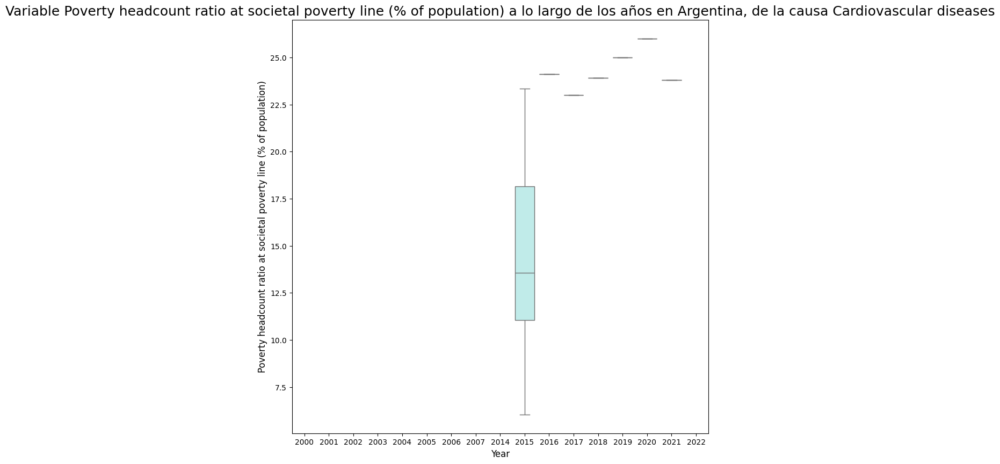

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


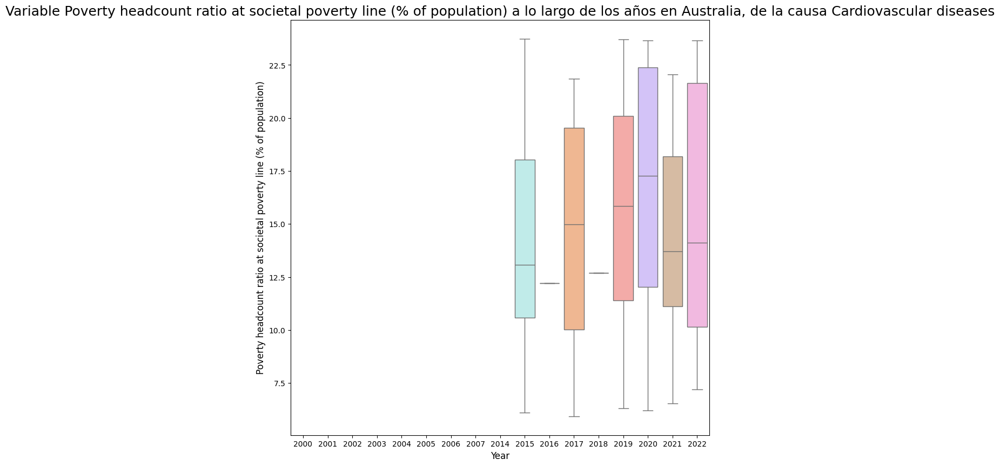

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


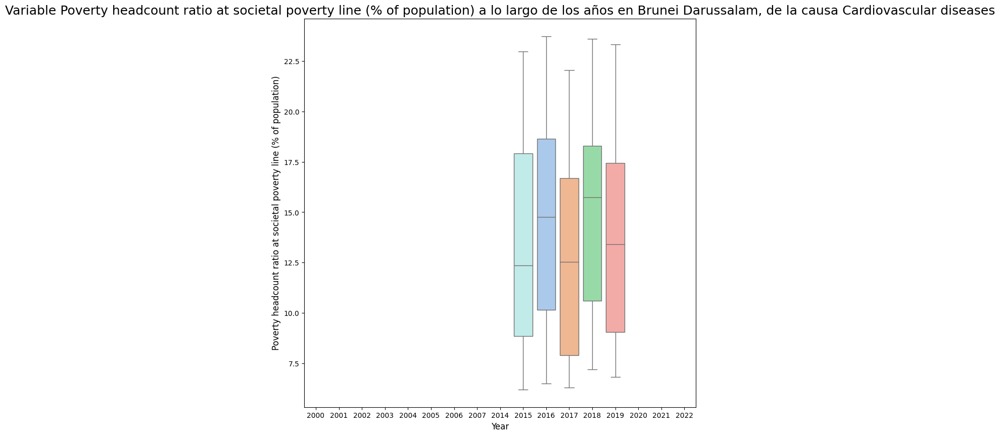

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


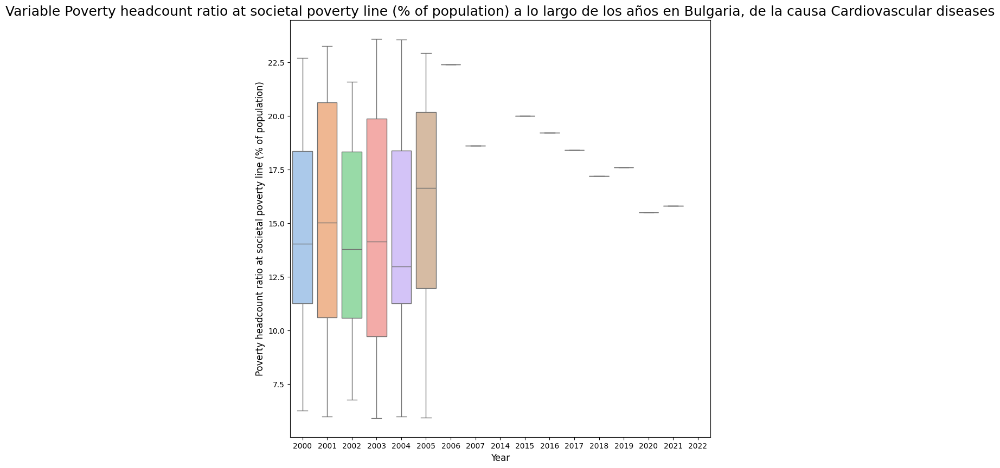

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


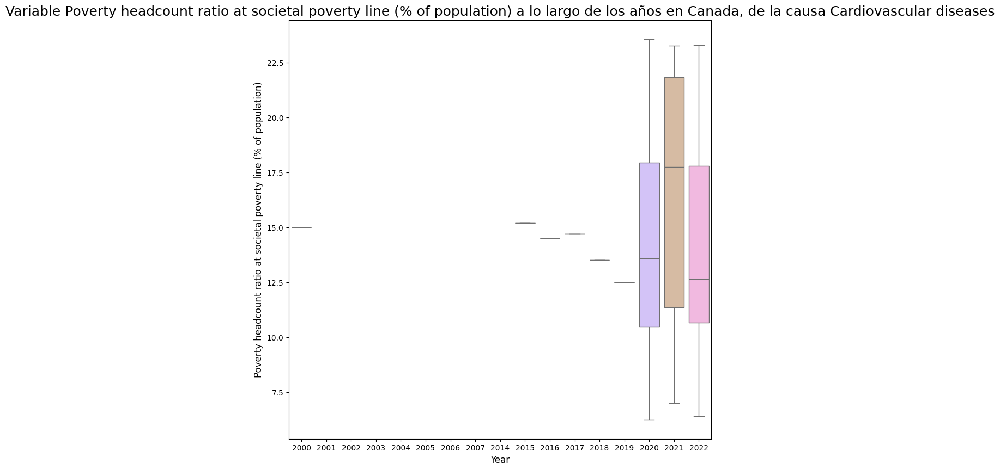

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


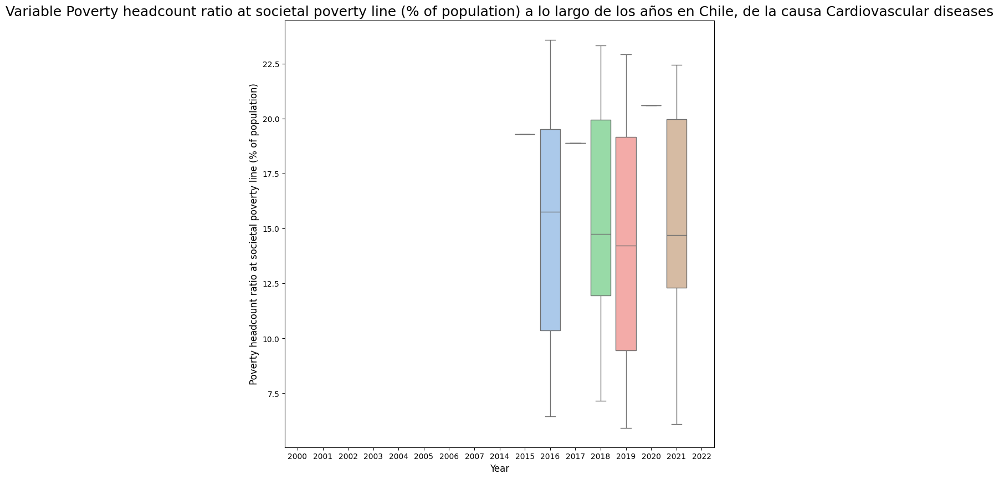

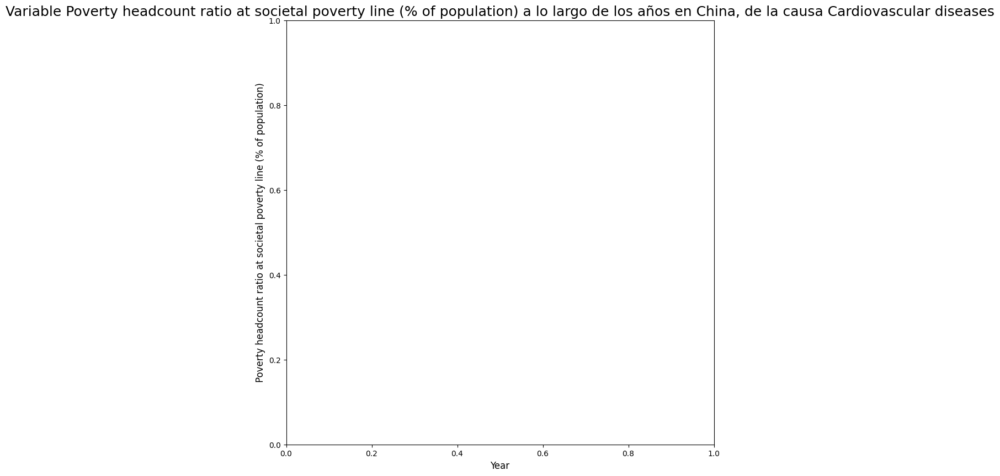

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


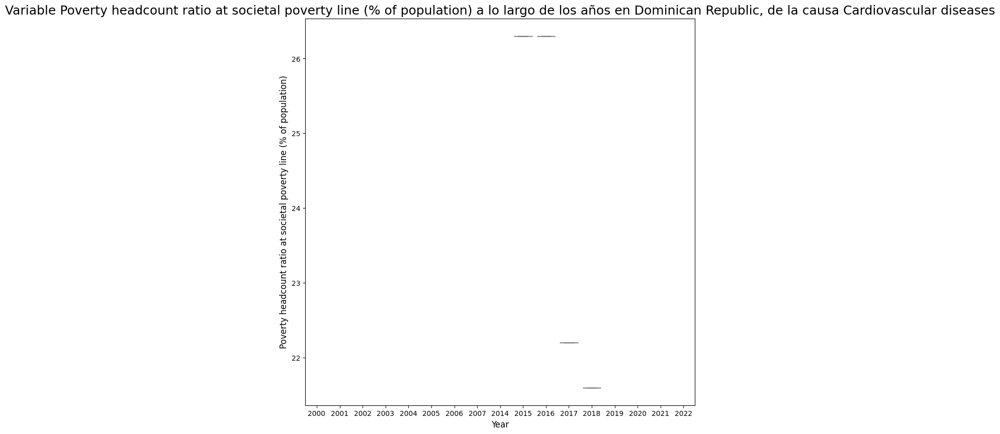

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


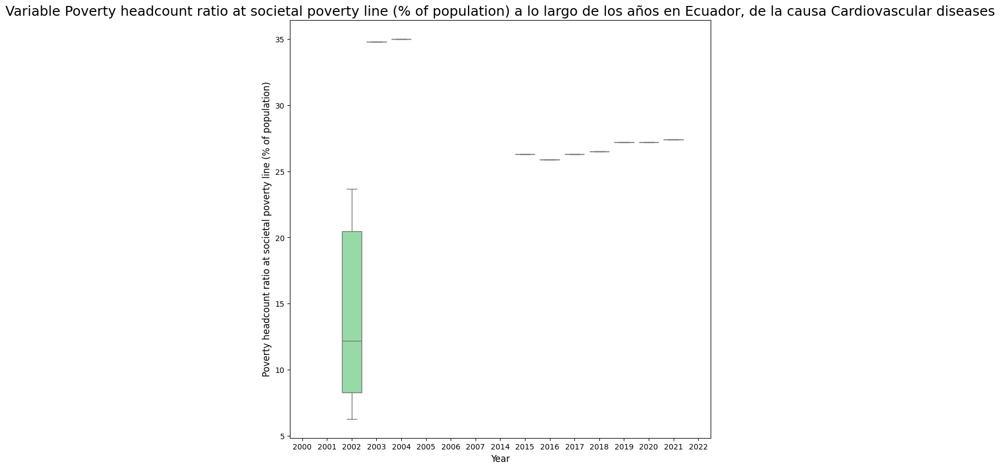

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


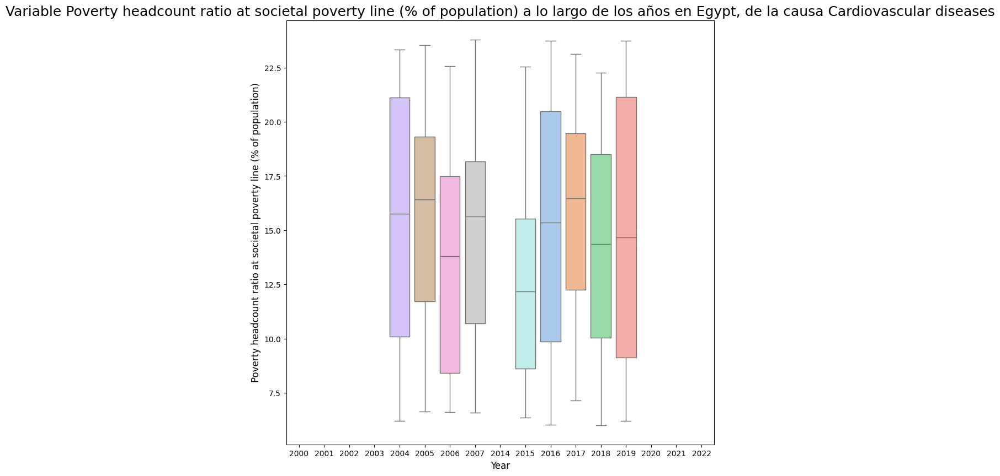

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


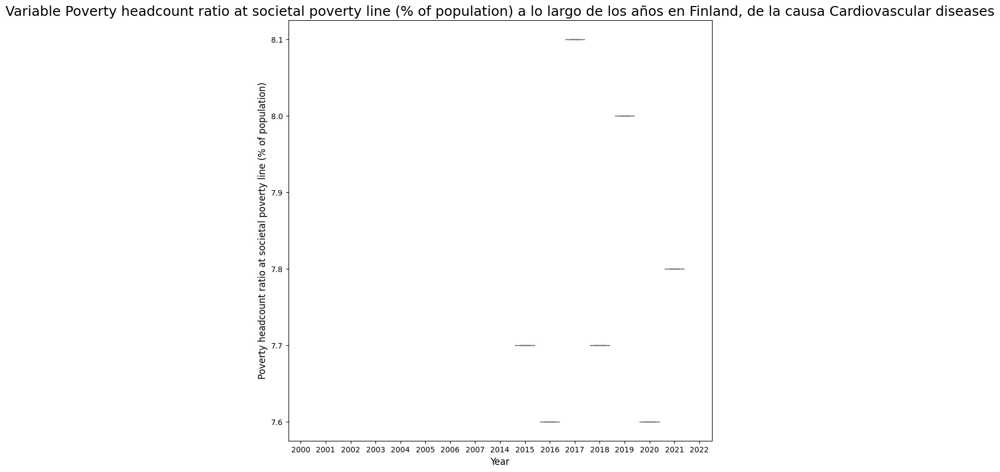

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


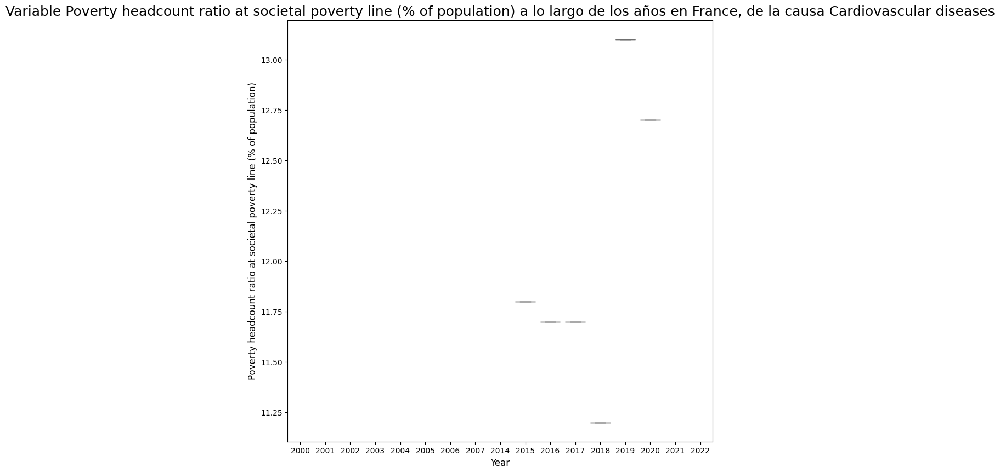

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


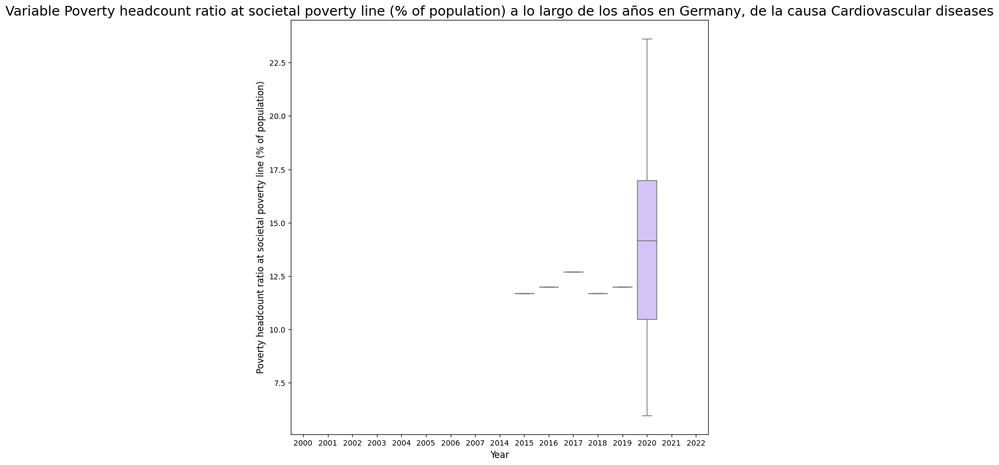

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


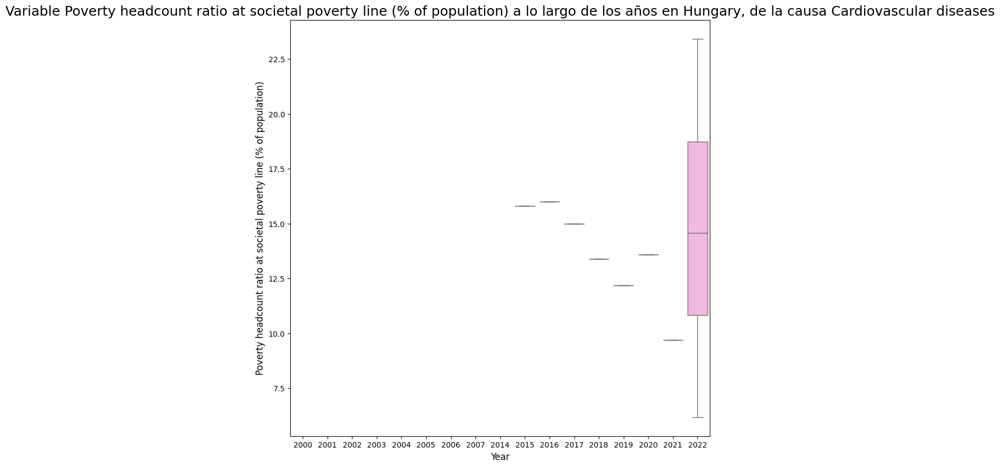

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


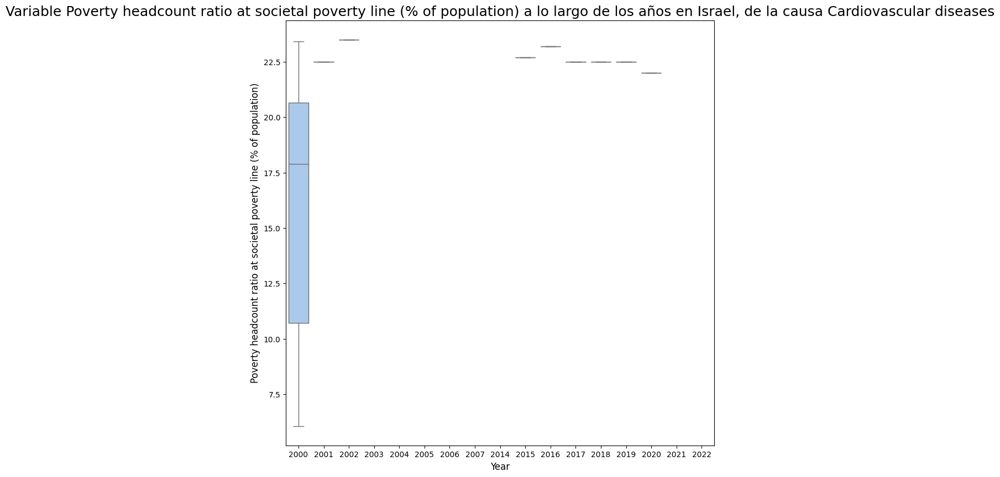

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


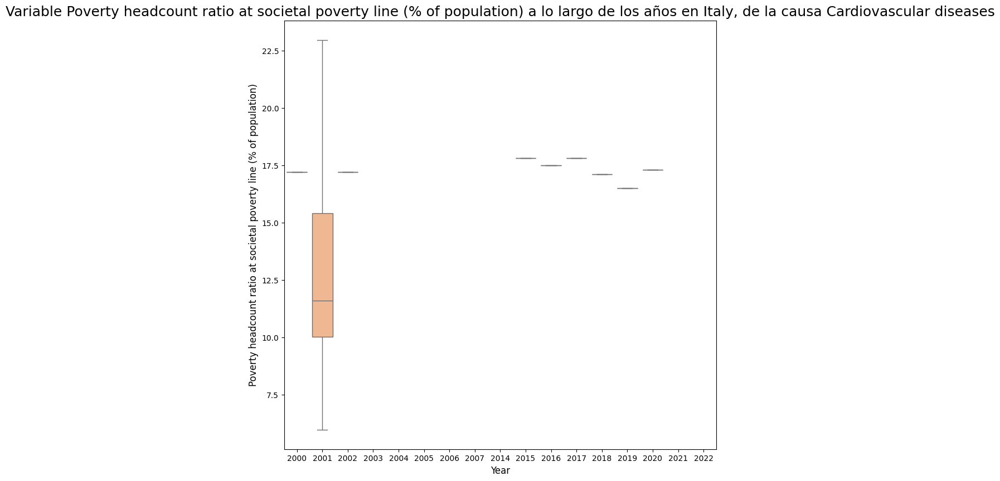

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


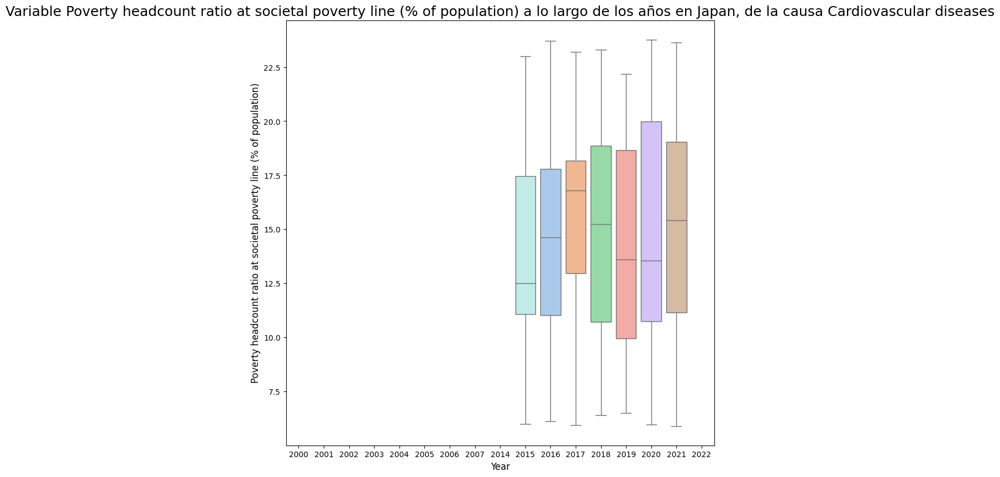

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


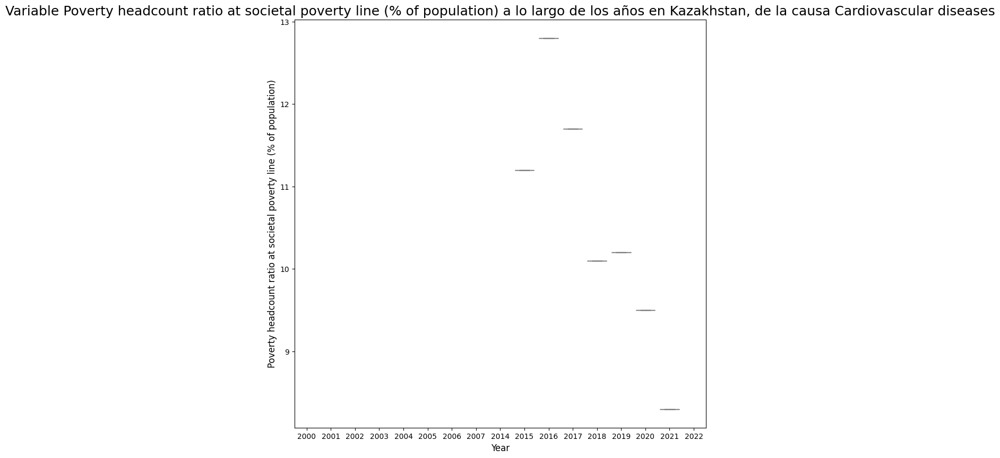

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


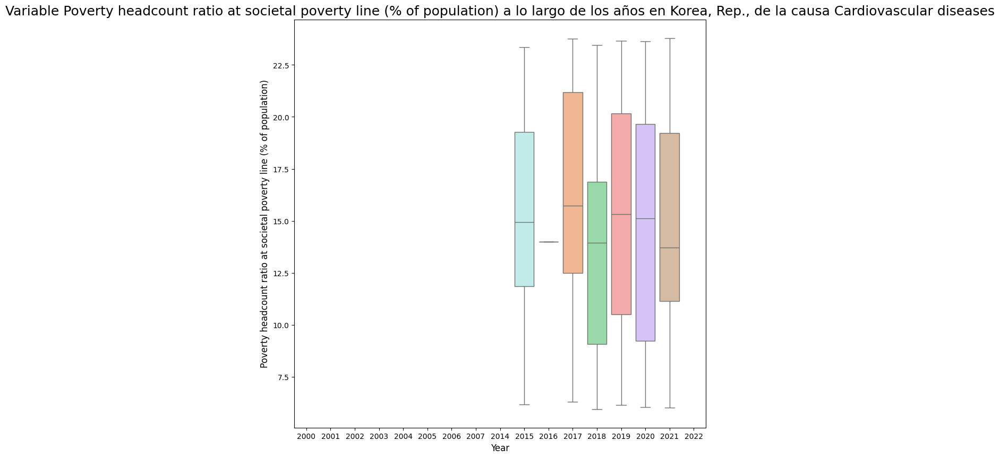

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


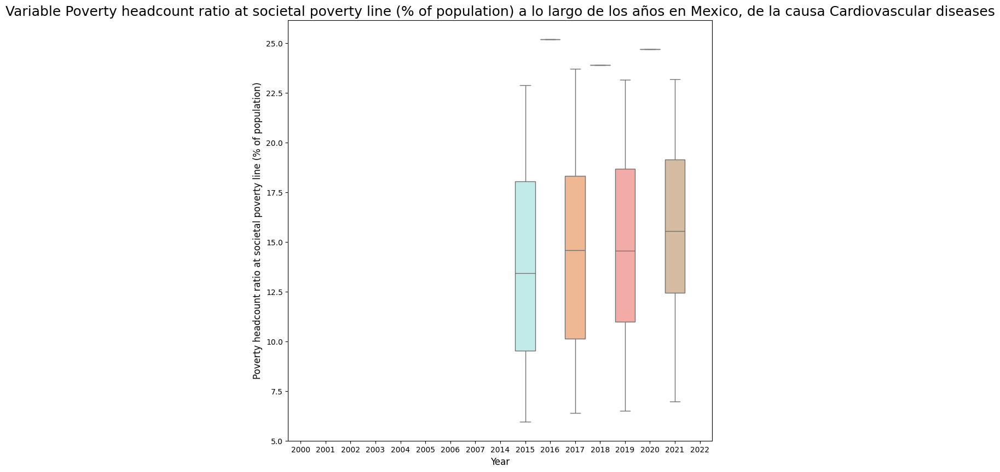

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


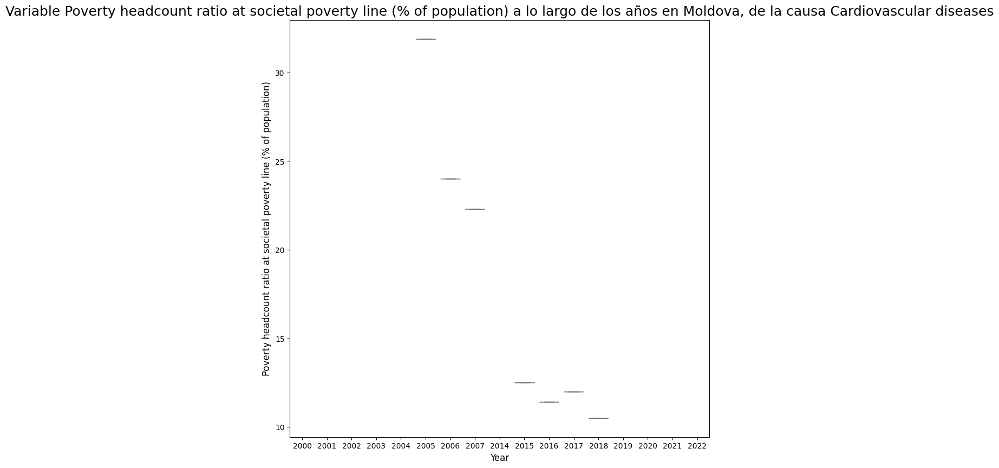

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


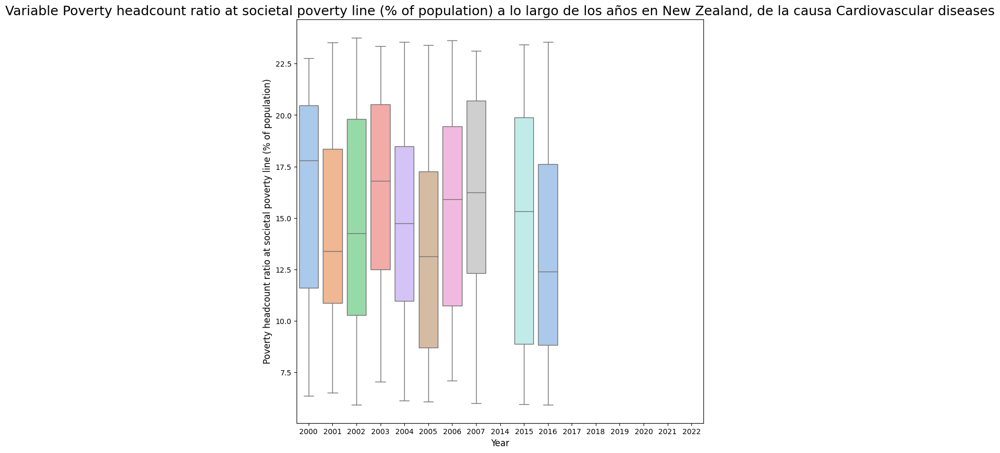

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


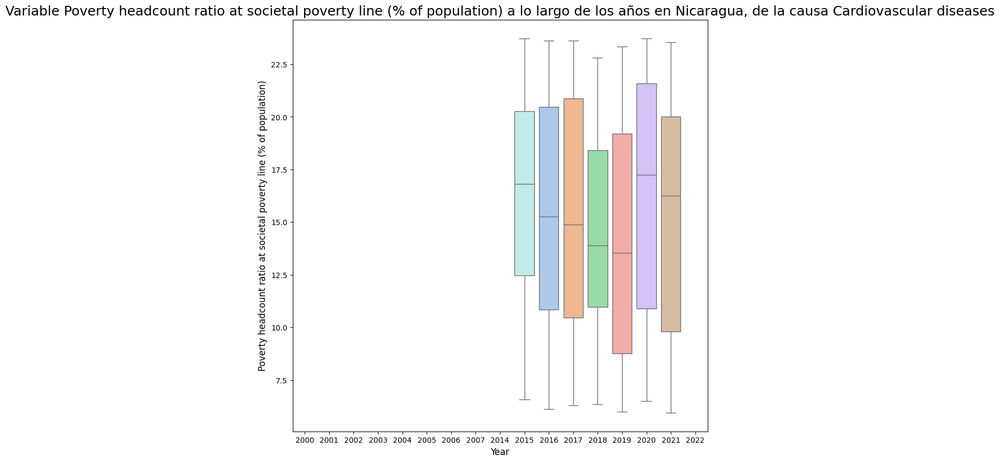

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


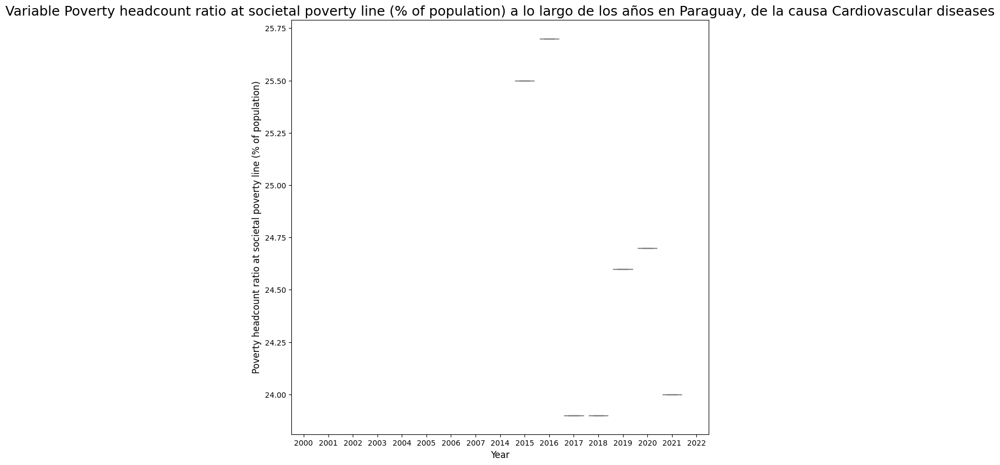

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


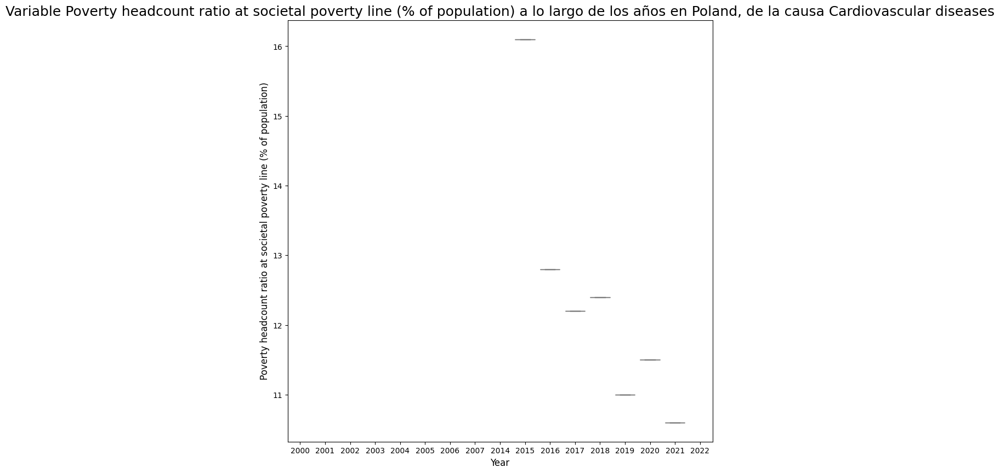

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


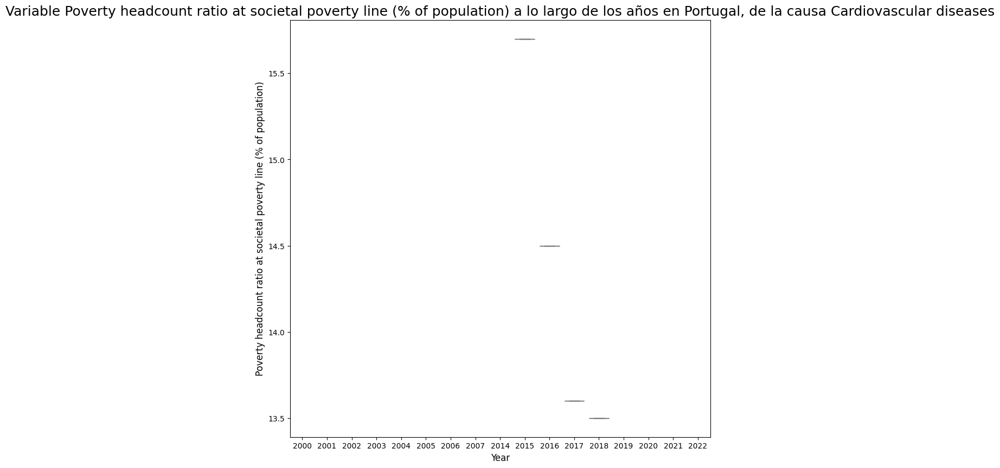

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


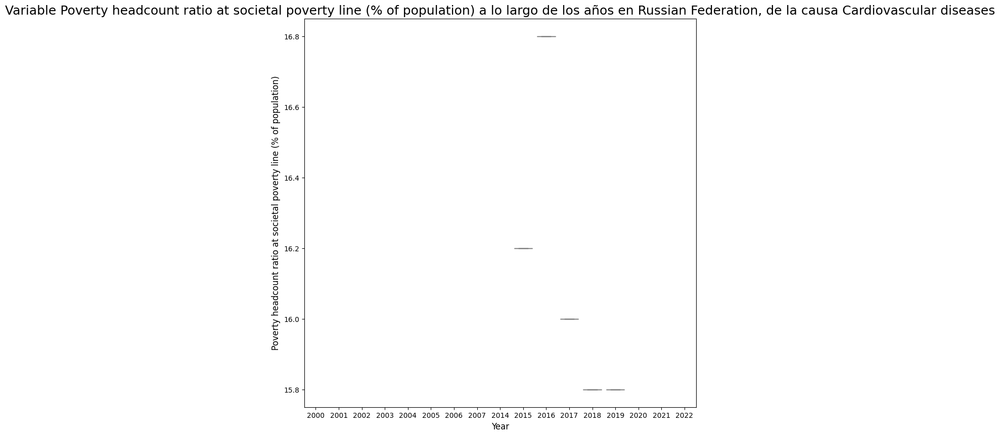

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


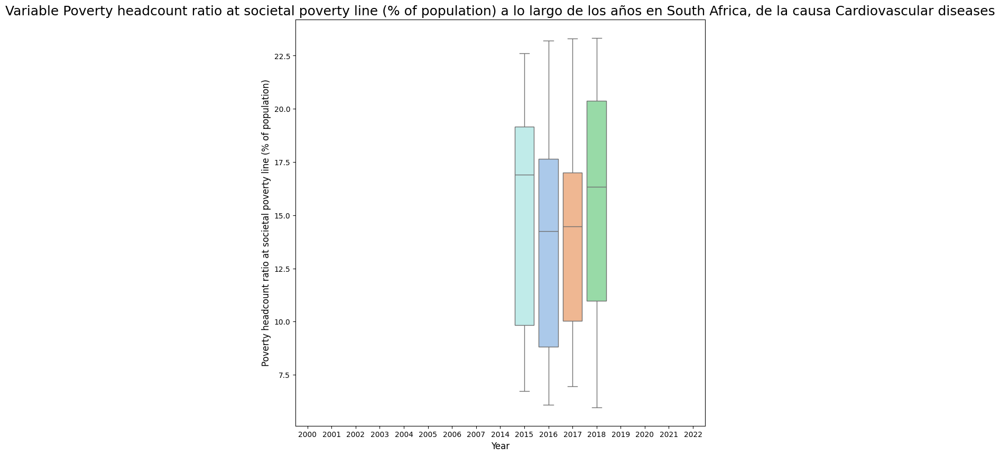

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


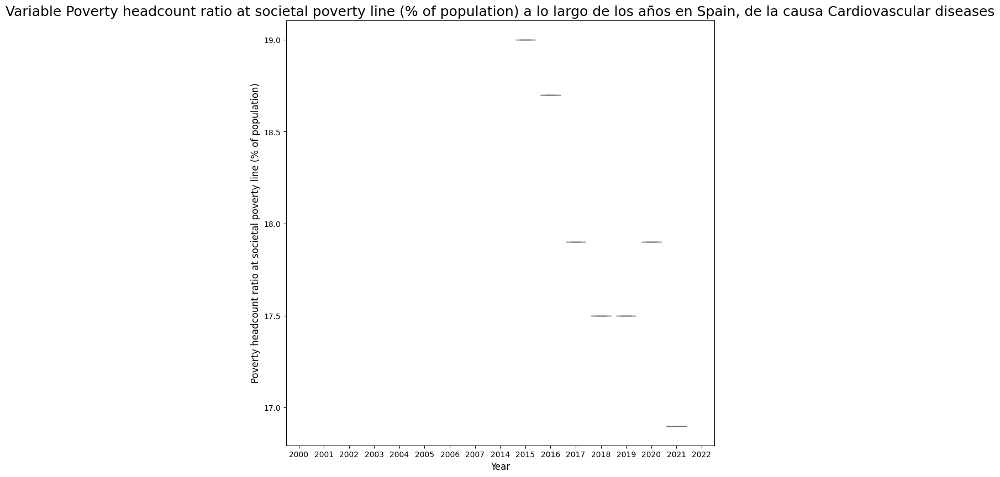

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


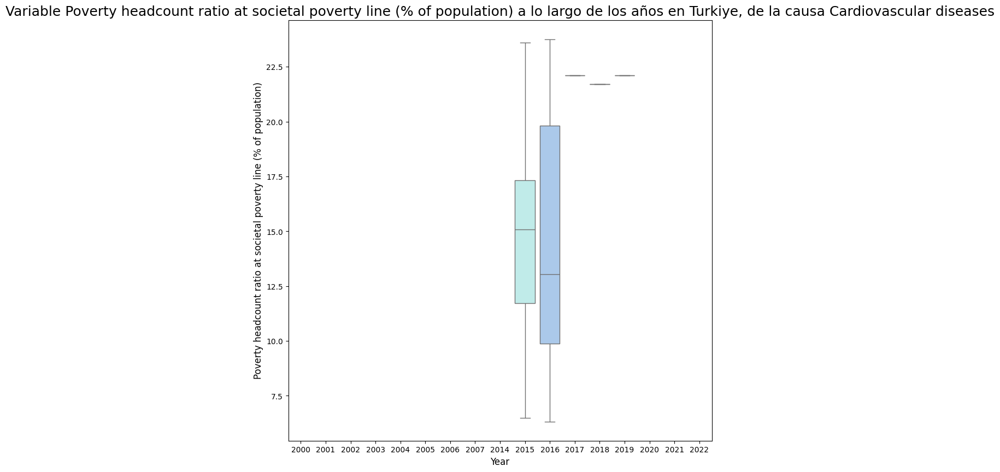

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


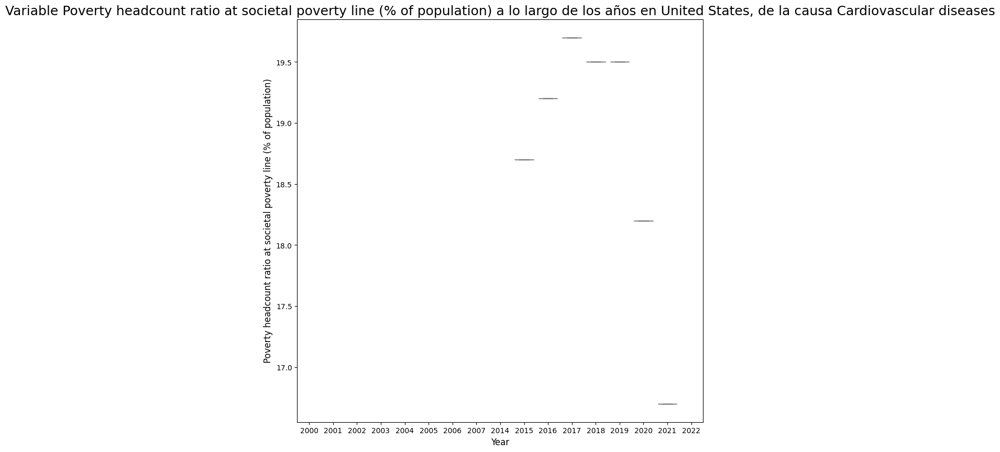

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


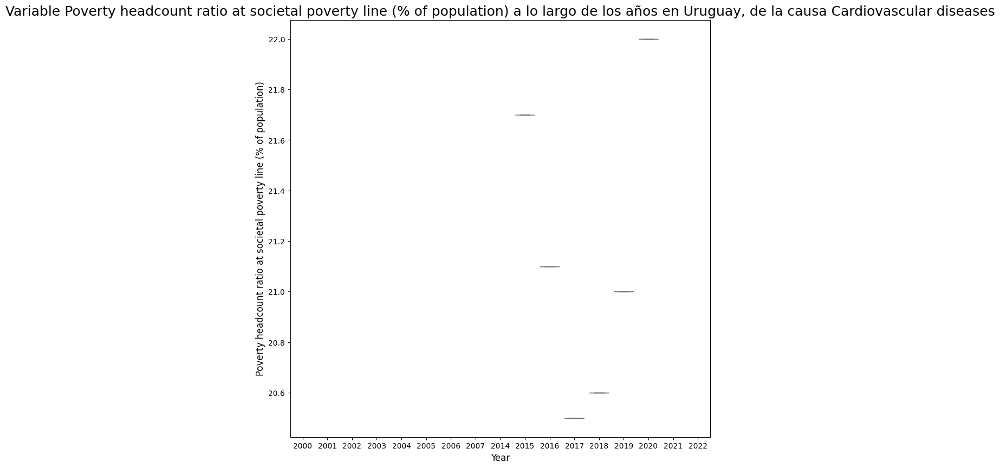

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


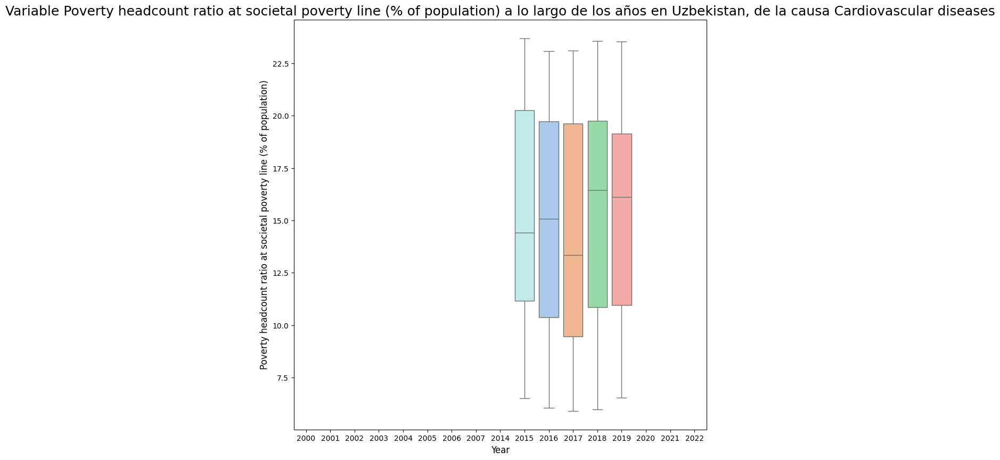

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


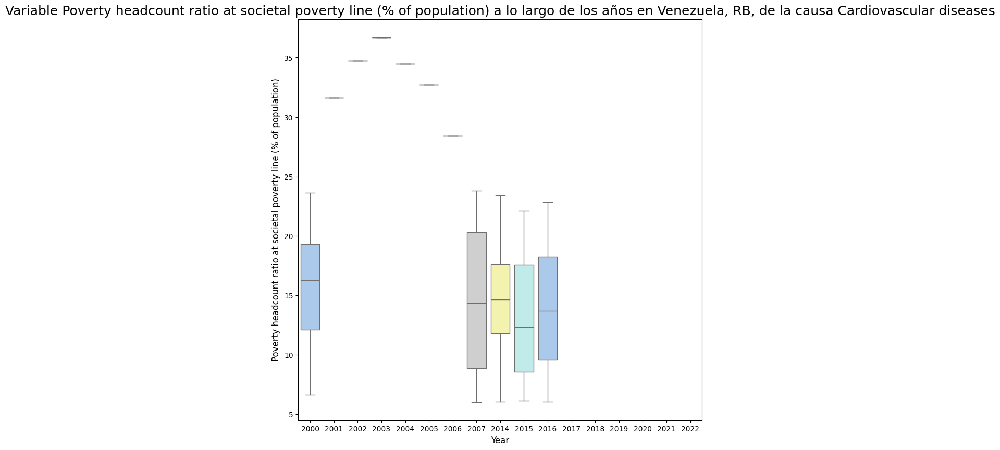

In [ ]:
boxplot_continuous_variables_with_economic_information(df_cardiovascular_diseases, "Poverty headcount ratio at societal poverty line (% of population)", "Cardiovascular diseases")

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


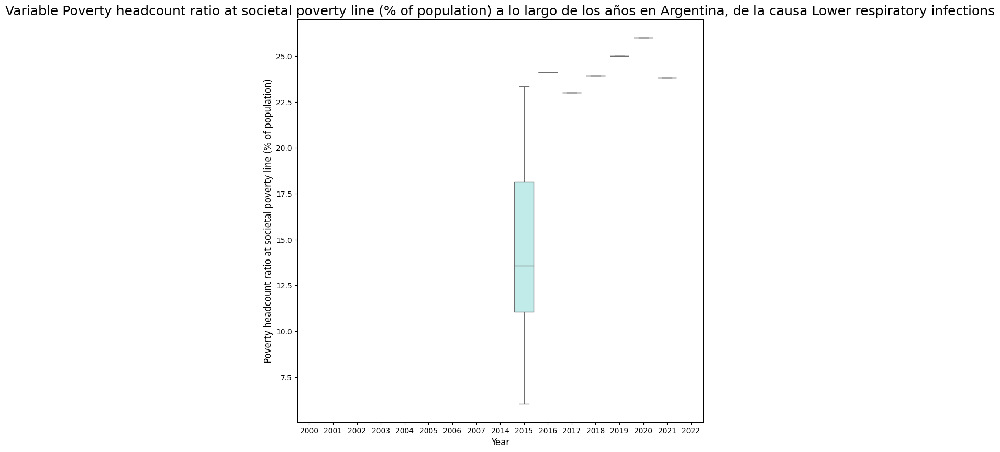

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


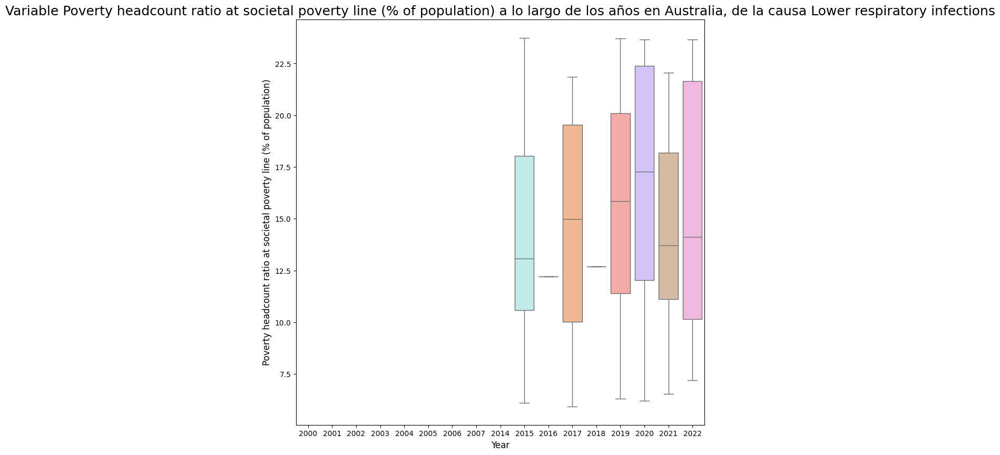

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


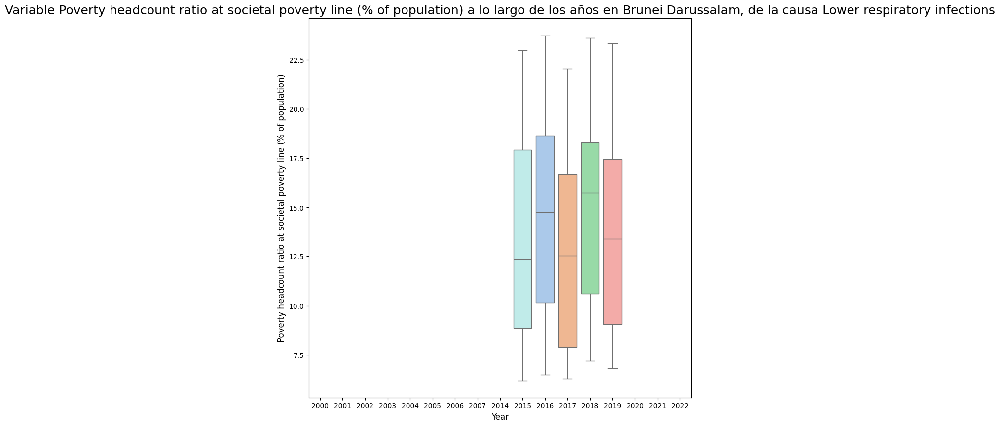

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


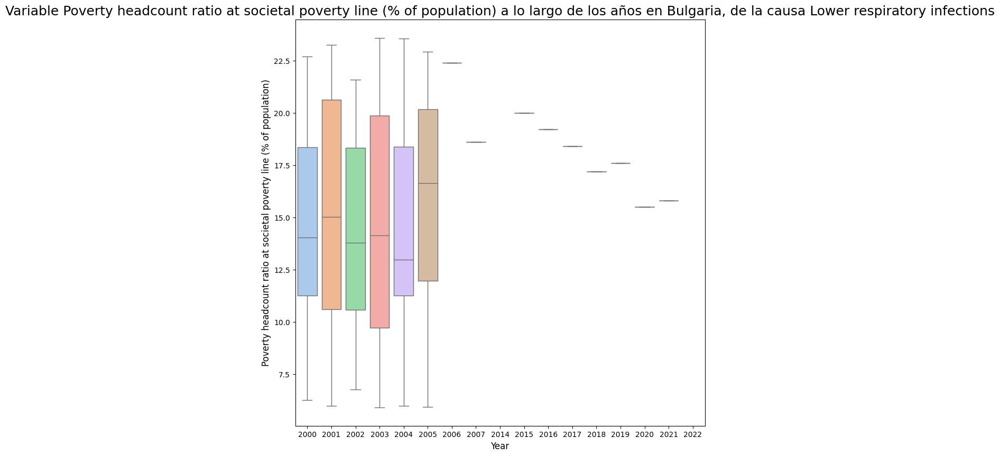

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


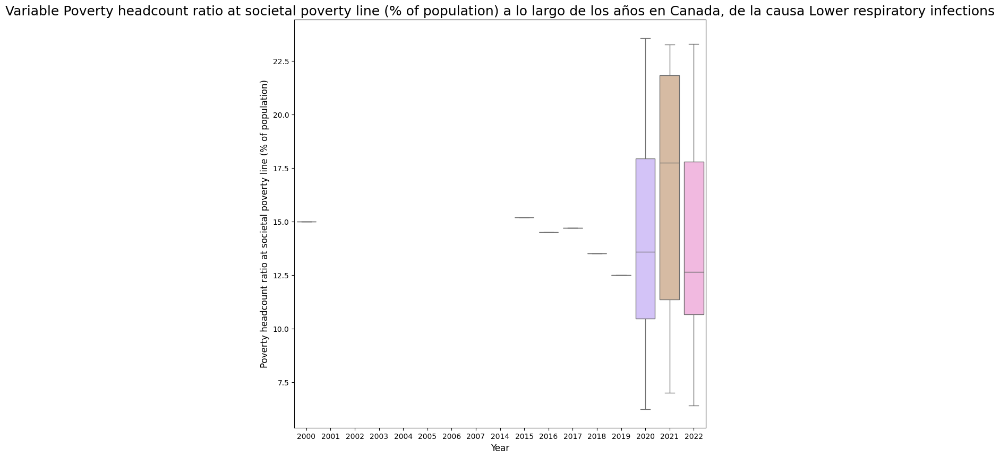

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


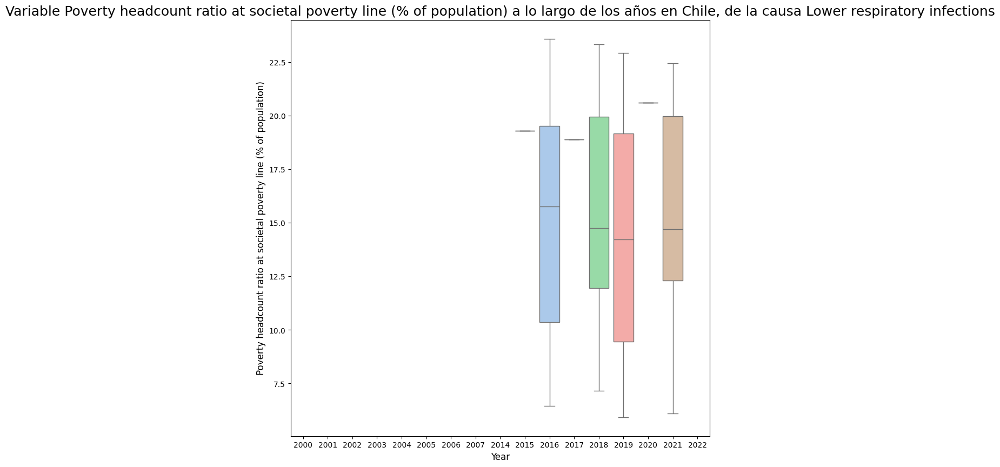

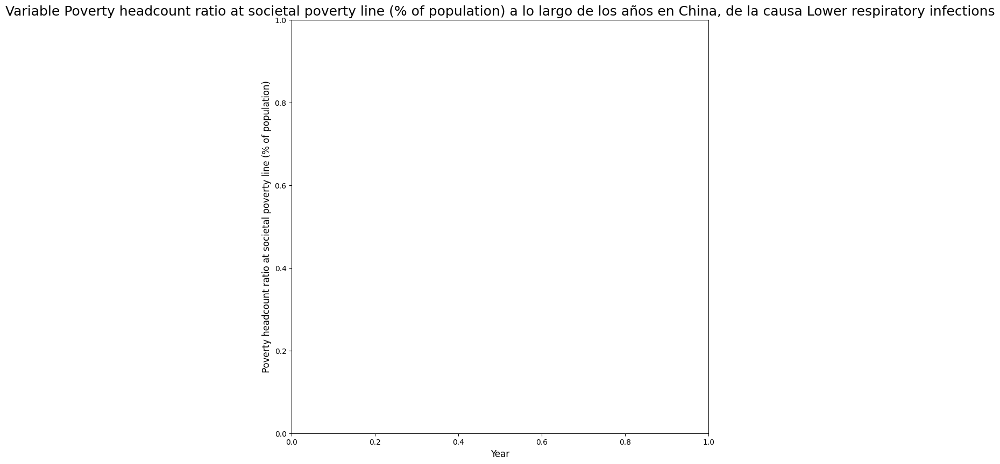

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


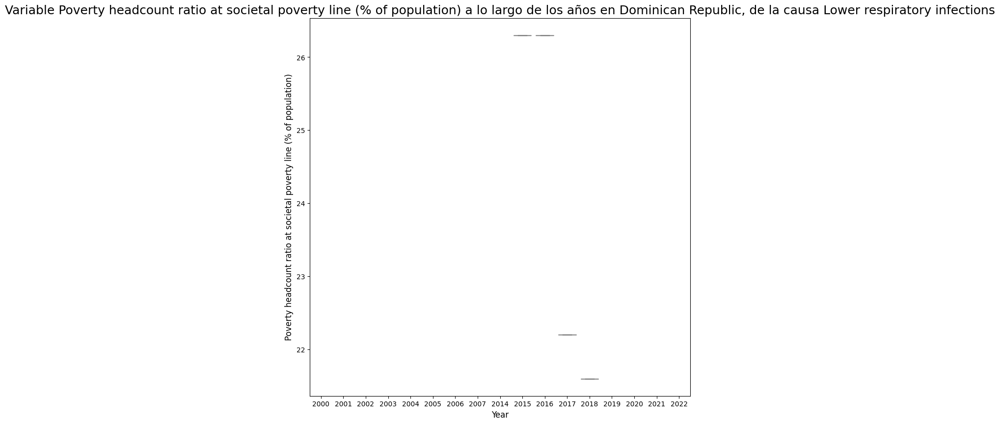

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


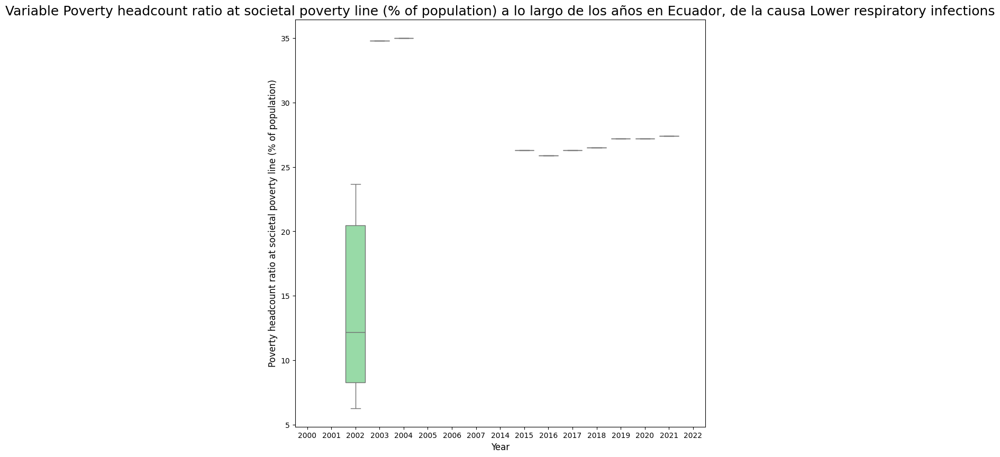

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


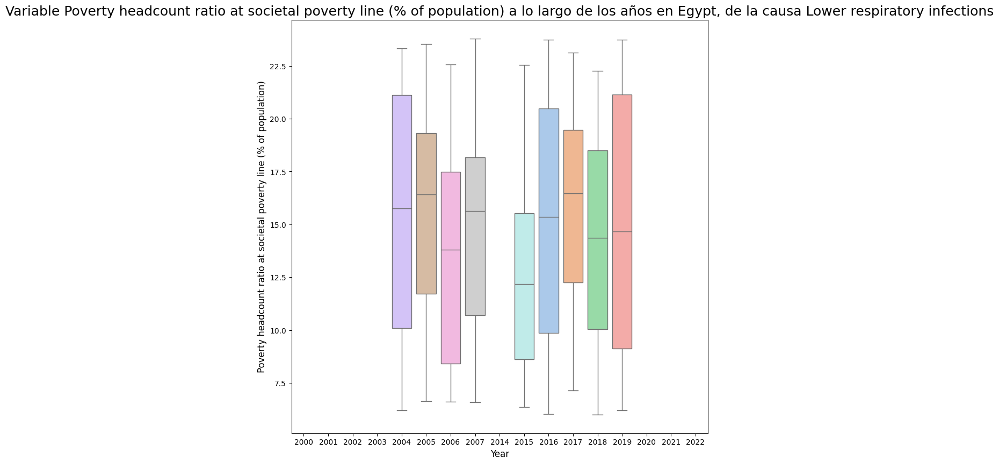

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


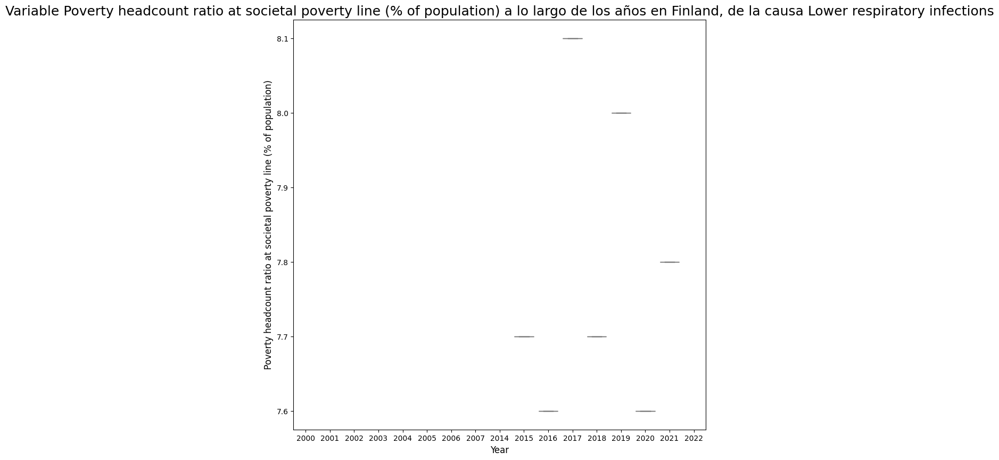

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


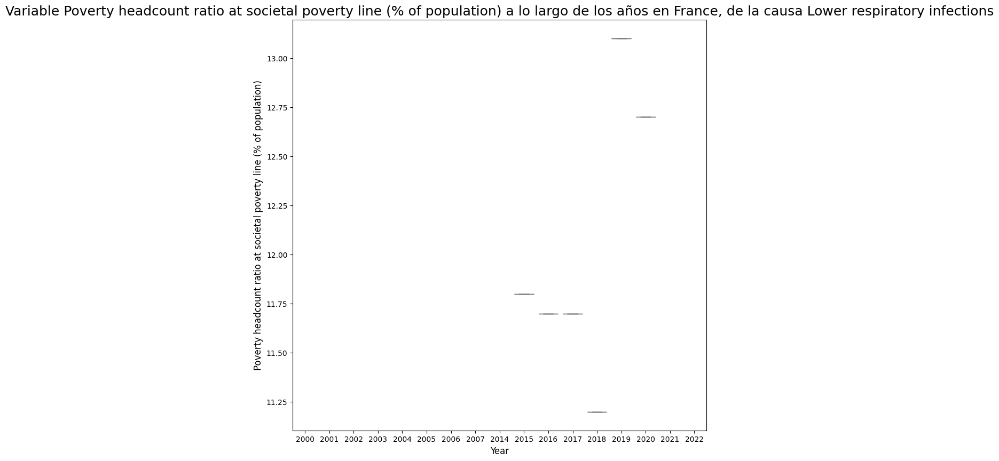

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


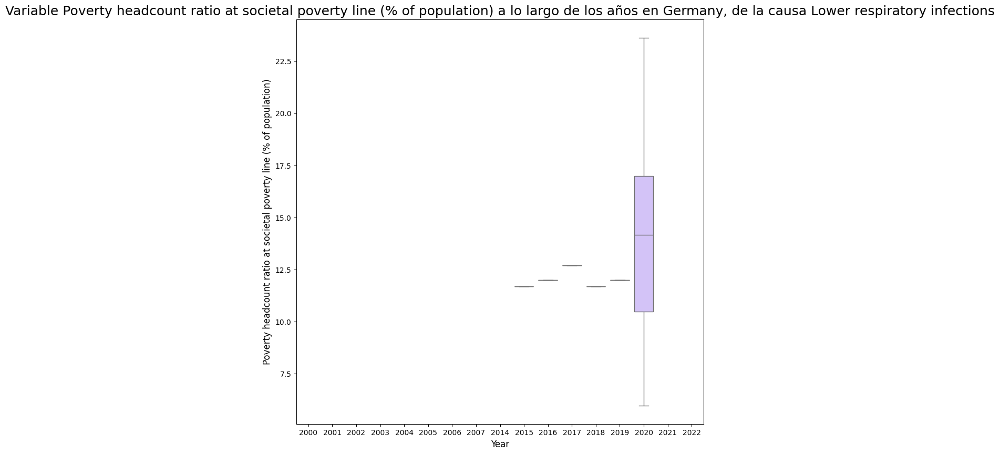

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


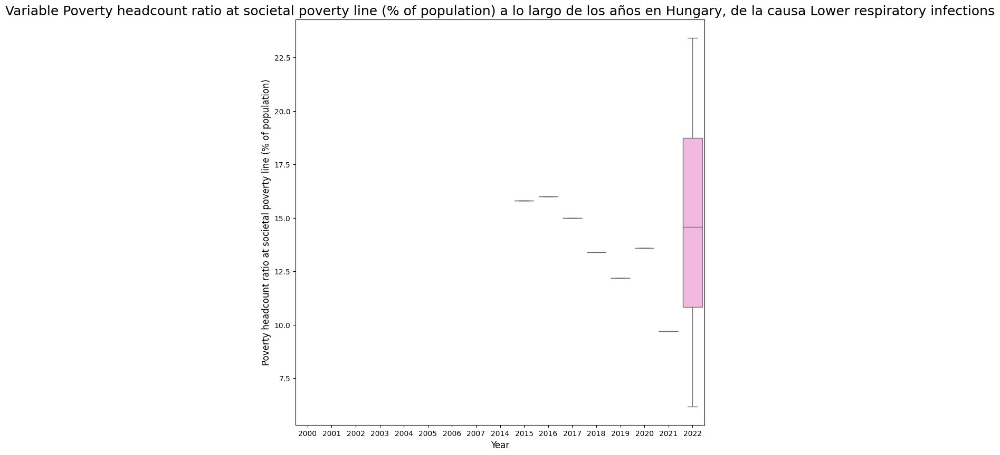

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


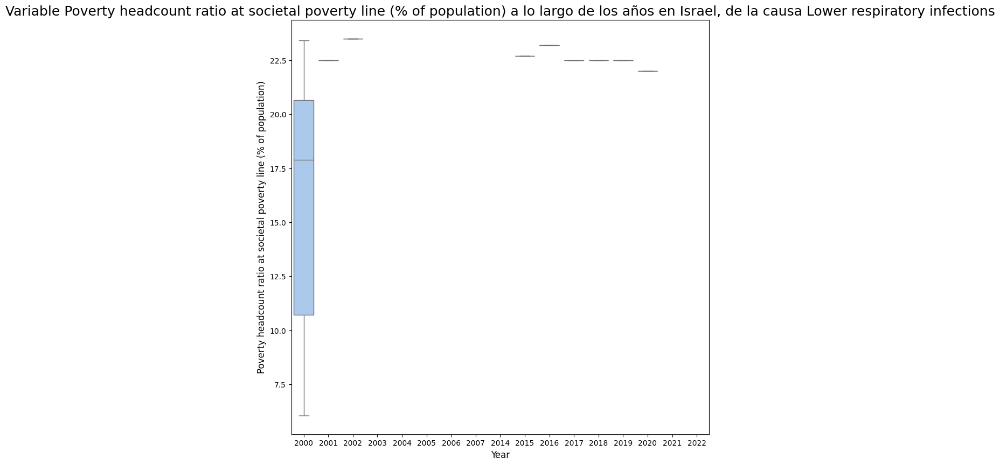

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


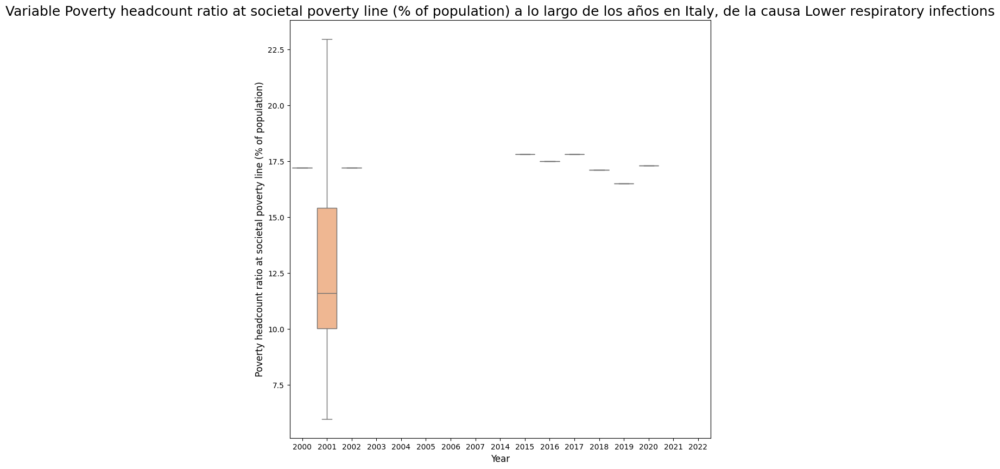

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


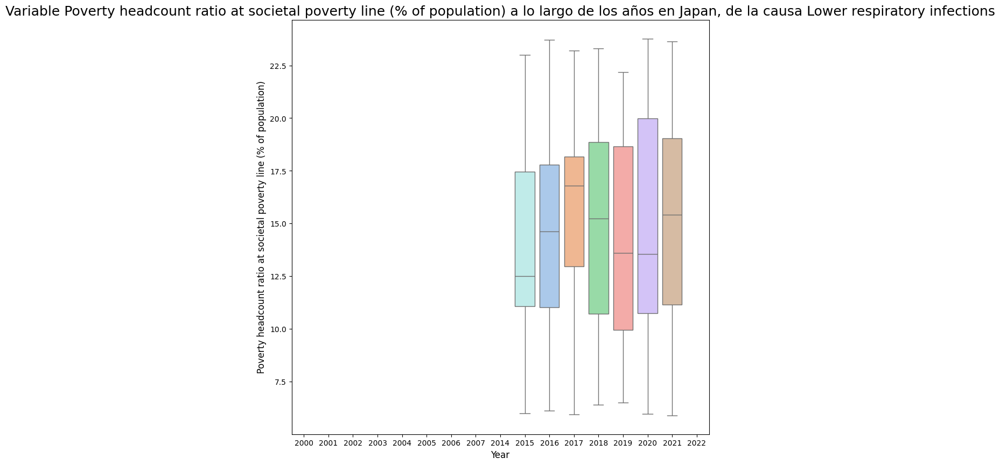

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


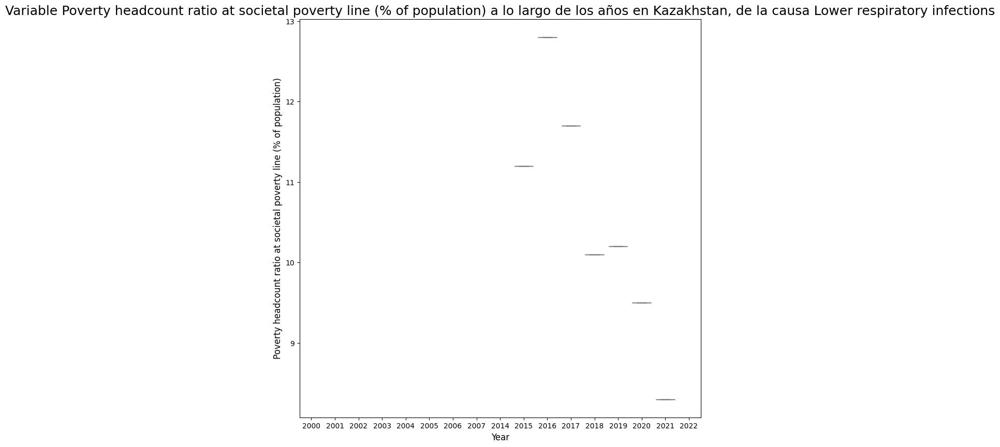

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


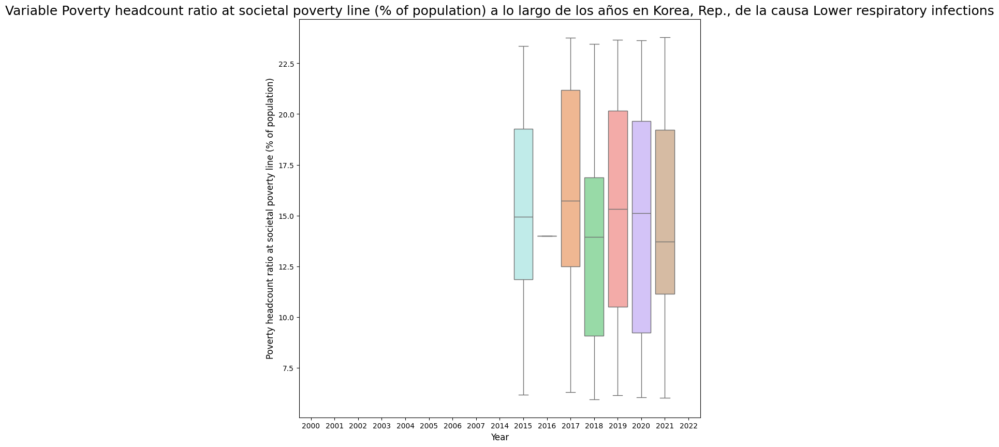

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


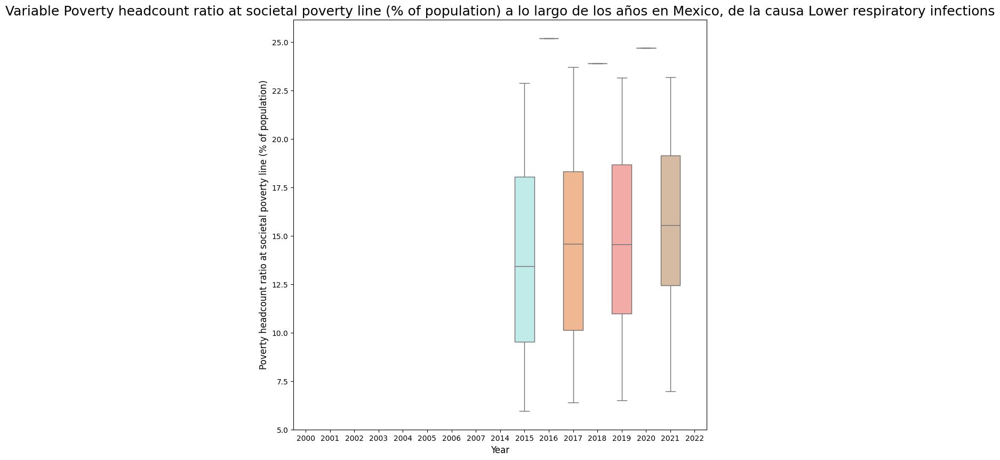

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


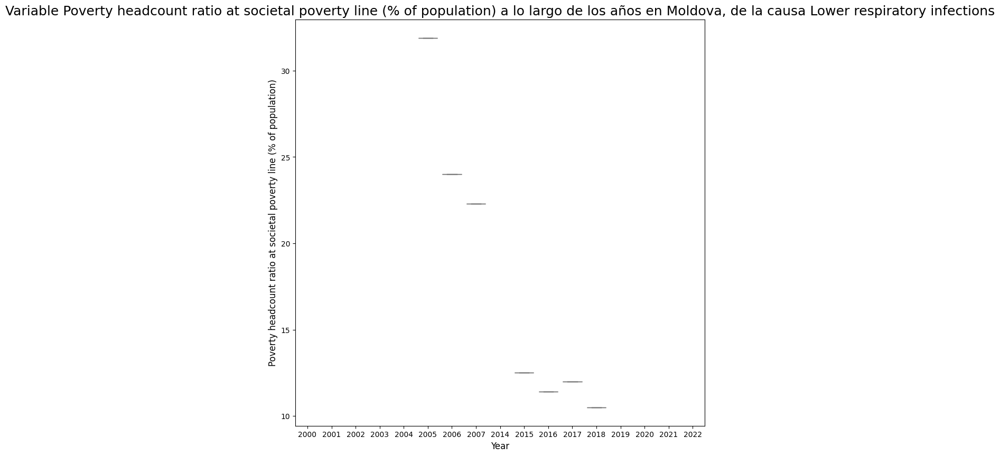

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


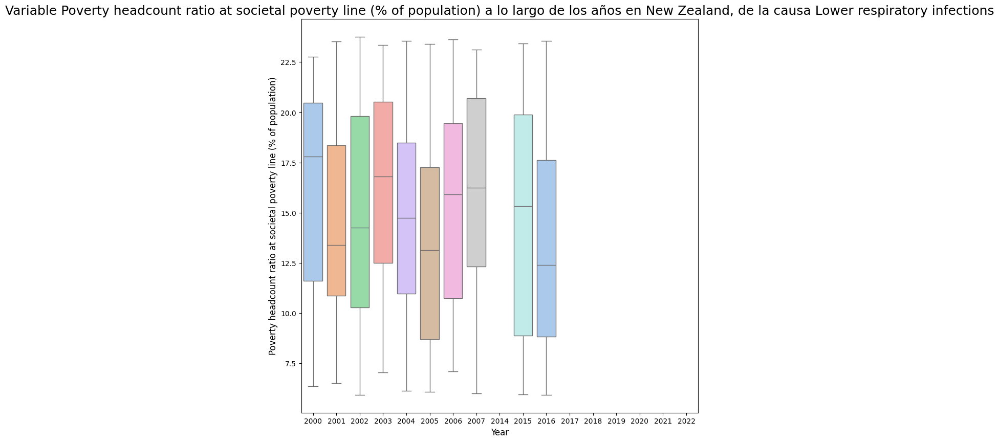

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


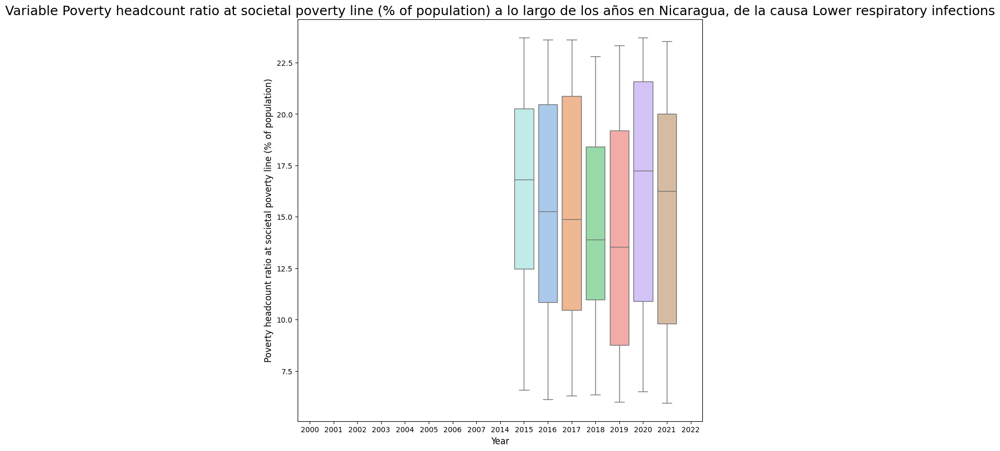

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


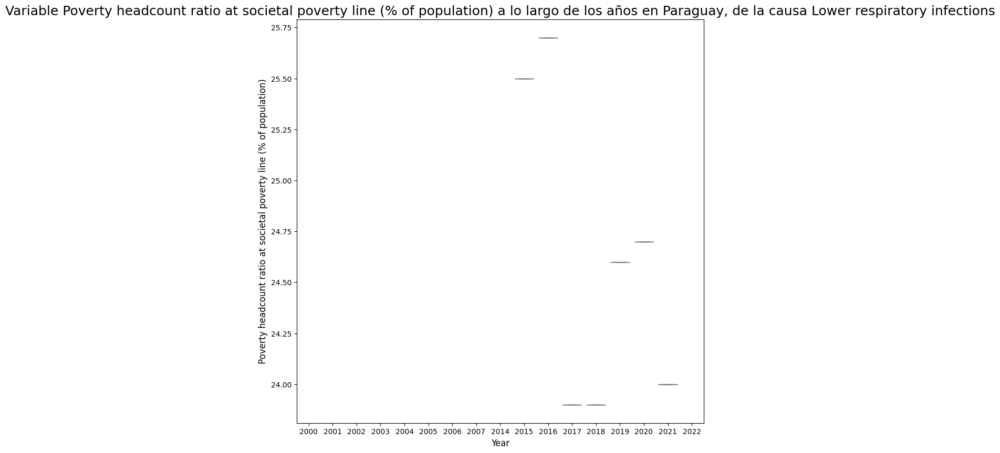

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


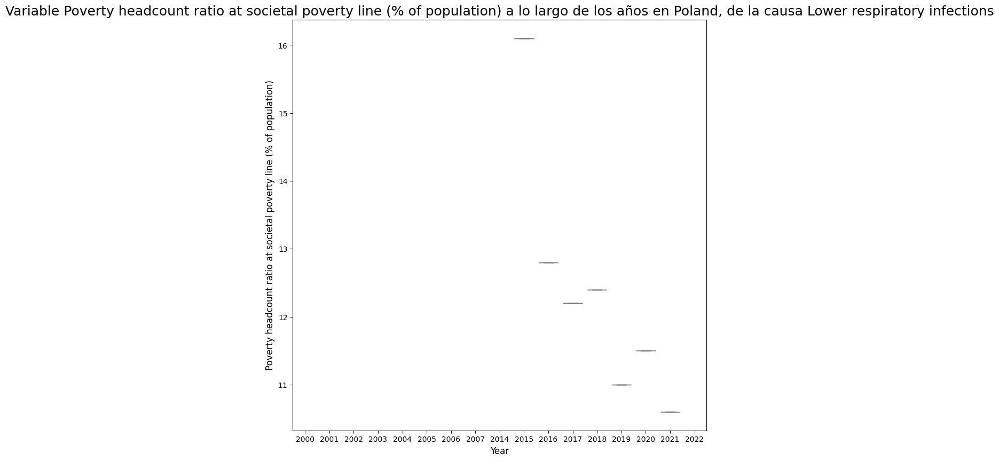

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


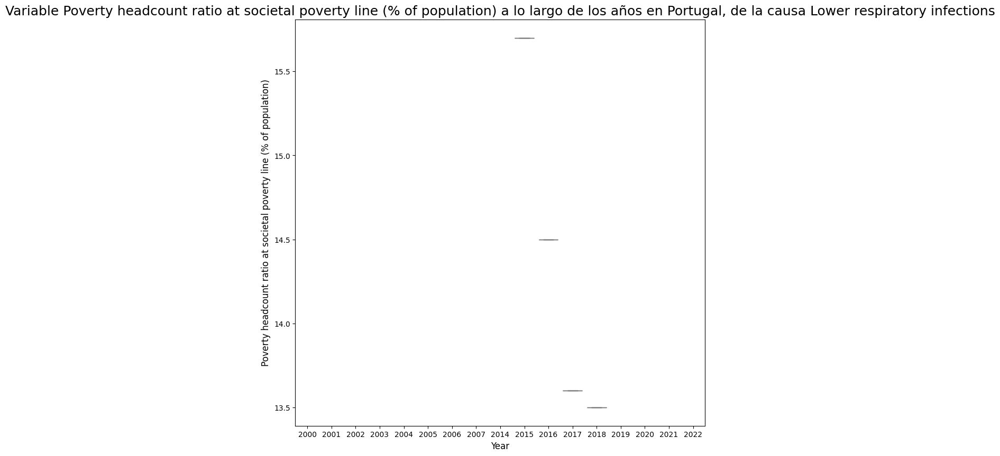

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


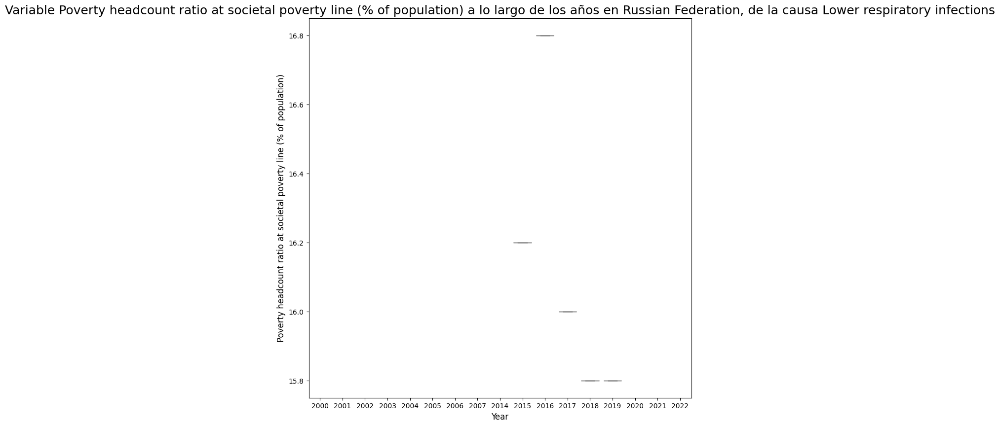

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


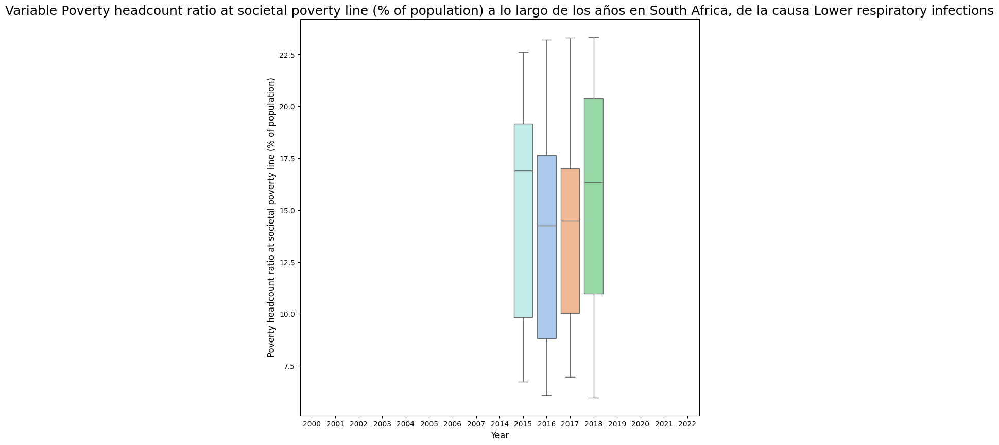

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


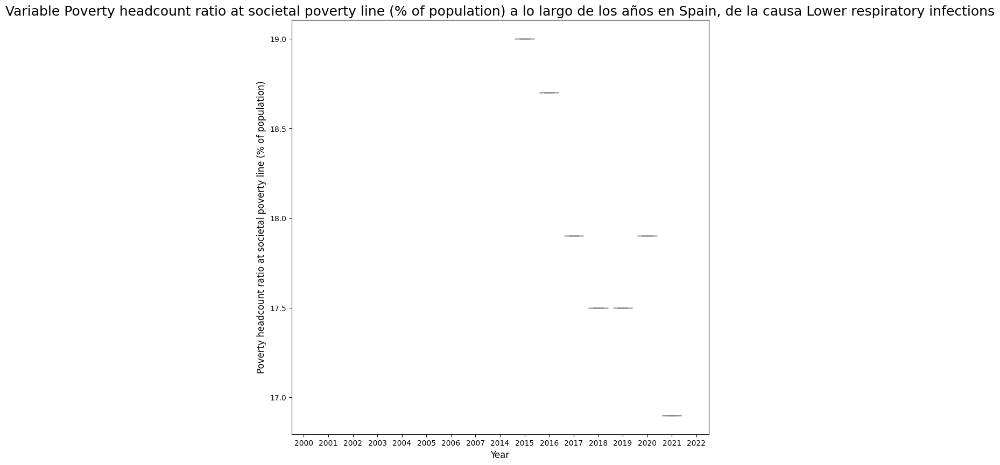

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


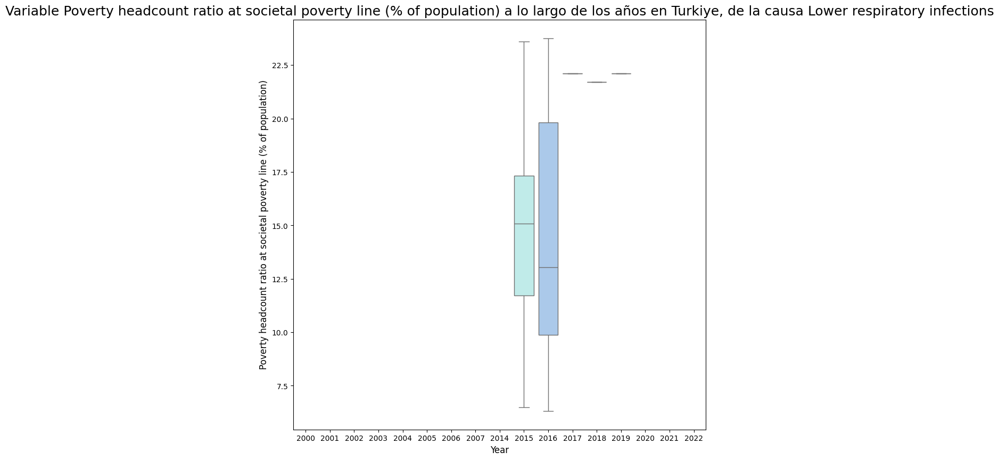

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


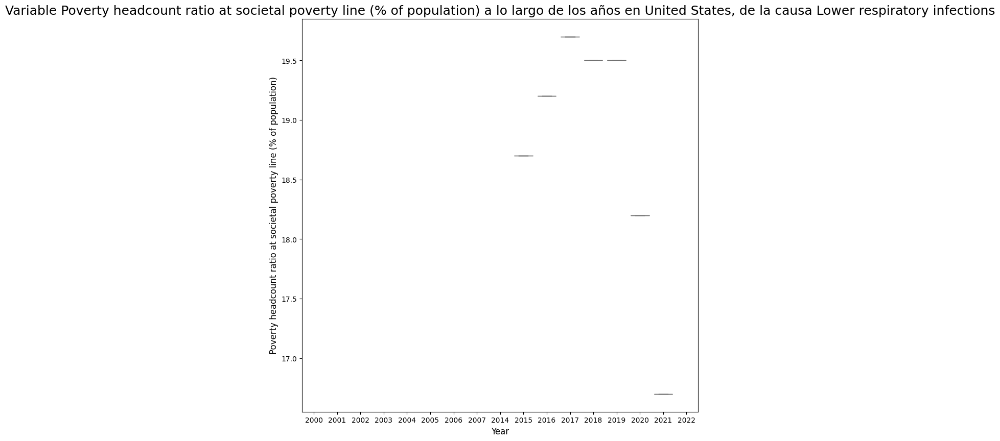

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


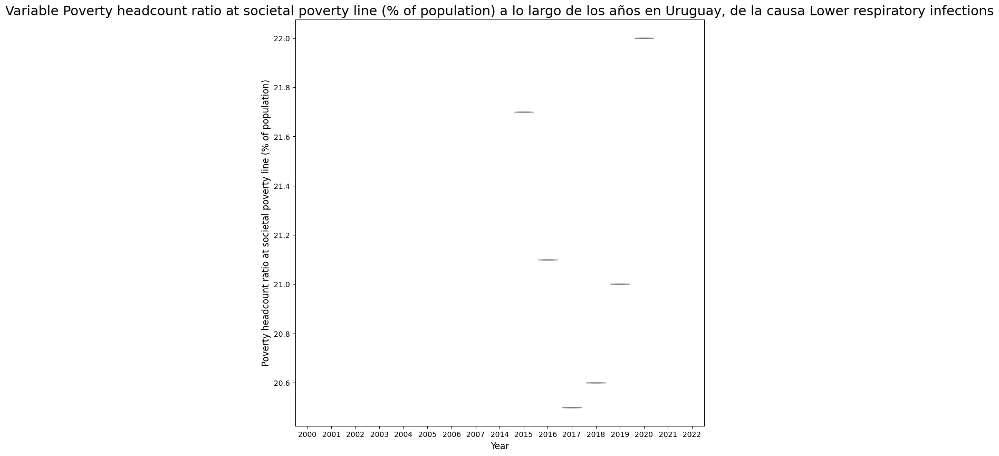

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


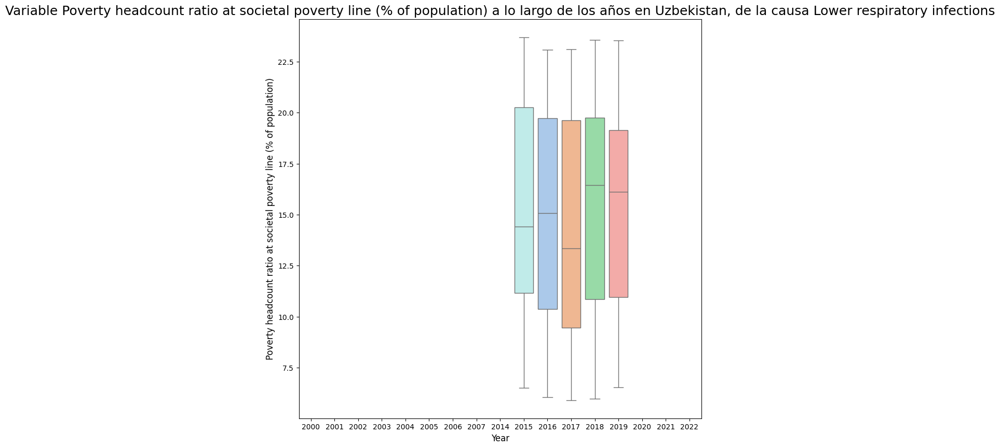

<ipython-input-90-65b9a55128be>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Year", y=variable, data=df_country, order=year_in_order, palette="pastel")


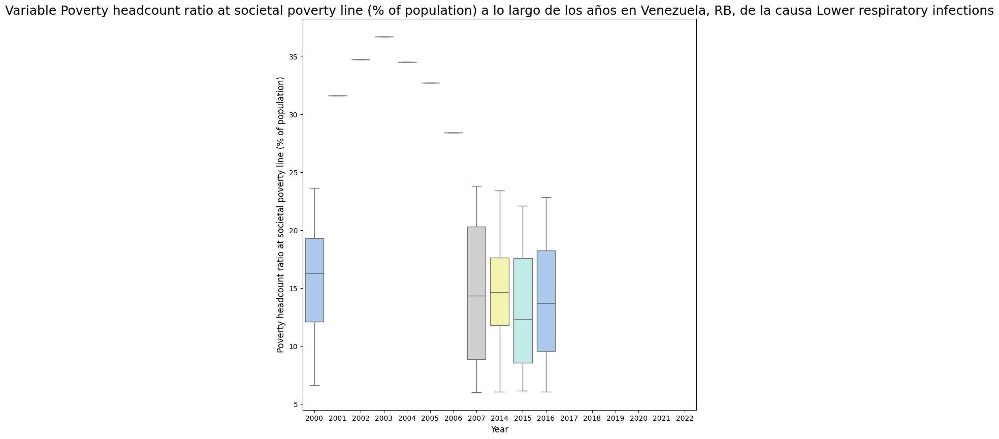

In [ ]:
boxplot_continuous_variables_with_economic_information(df_cardiovascular_diseases, "Poverty headcount ratio at societal poverty line (% of population)", "Lower respiratory infections")

**OUTLIERS:**<br>
Granulando más los datos, se pueden notar que los outliers desaparecen.<br>
Por lo que no creo que se deban eliminar, pero sí tratar, más adelante voy a ver las asimetrías y realizar las transformaciones pertinentes

###Elimino a China

**OBS:** Veo que no encuentro datos en China, asique voy a ver ese país en particular, de todas las causas de muerte y rangos etarios.

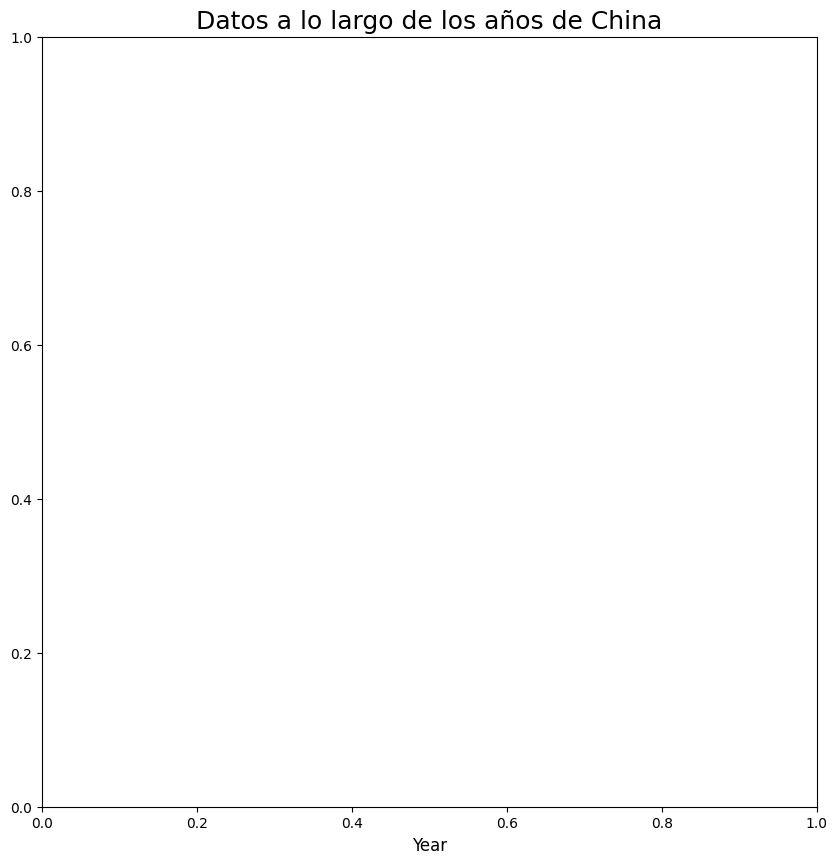

In [51]:
plt.figure(figsize=(10, 10))
df_country = df[df['Country Name'] == "China"]
sns.boxplot(x="Year", data=df_country, order=year_in_order, palette="pastel")
plt.title(f"Datos a lo largo de los años de China", fontsize=18)
plt.xlabel("Year", fontsize=12)
plt.show()

Como no hay ningún dato, voy a borrar a China del dataframe df. Ya que no le sirve al modelo para aprender sobre las causas de muerte de los chinos.

In [52]:
indices_to_delete = df[df['Country Name'] == 'China'].index
df = df.drop(indices_to_delete)
df = df.reset_index(drop=True)

###Viendo simetría o asimetría de los datos contínuos

**Number**

Se logró normalizar mejor

<ipython-input-53-2e505158fe10>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y="Number", data=df, palette="pastel")


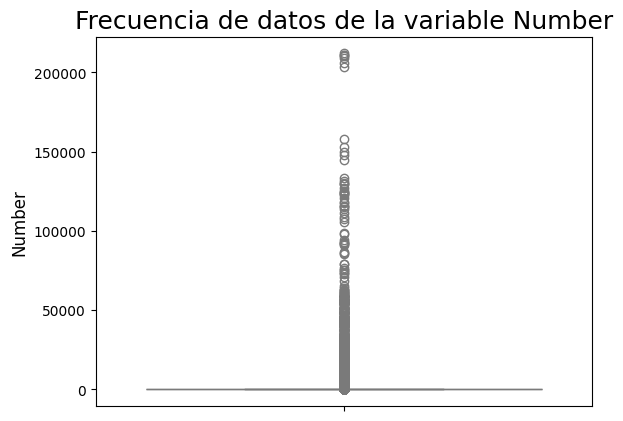

In [53]:
sns.boxplot(y="Number", data=df, palette="pastel")
plt.title("Frecuencia de datos de la variable Number", fontsize=18)
plt.ylabel("Number", fontsize=12)

plt.show()

Se puede observar una gran asimetría a derecha, por lo que voy a proceder a transformar esos datos:

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
<ipython-input-54-b2365e9129e6>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y="Number", data=df_normalizado, palette="pastel")


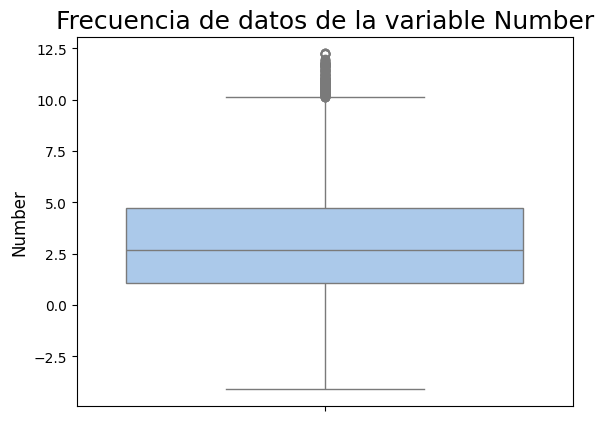

In [54]:
df_normalizado = df.copy()
df_normalizado['Number'] = np.log(df_normalizado['Number'])

sns.boxplot(y="Number", data=df_normalizado, palette="pastel")
plt.title("Frecuencia de datos de la variable Number", fontsize=18)
plt.ylabel("Number", fontsize=12)

plt.show()

Ya habiéndo transformado un dataset de prueba hay una asimetría a derecha menor, por lo que procedo a realizar la transformación en el dataframe df:

In [55]:
df['Number'] = np.log(df['Number'])

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


**Percentage of cause-specific deaths out of total deaths**

Se logró normalizar mejor

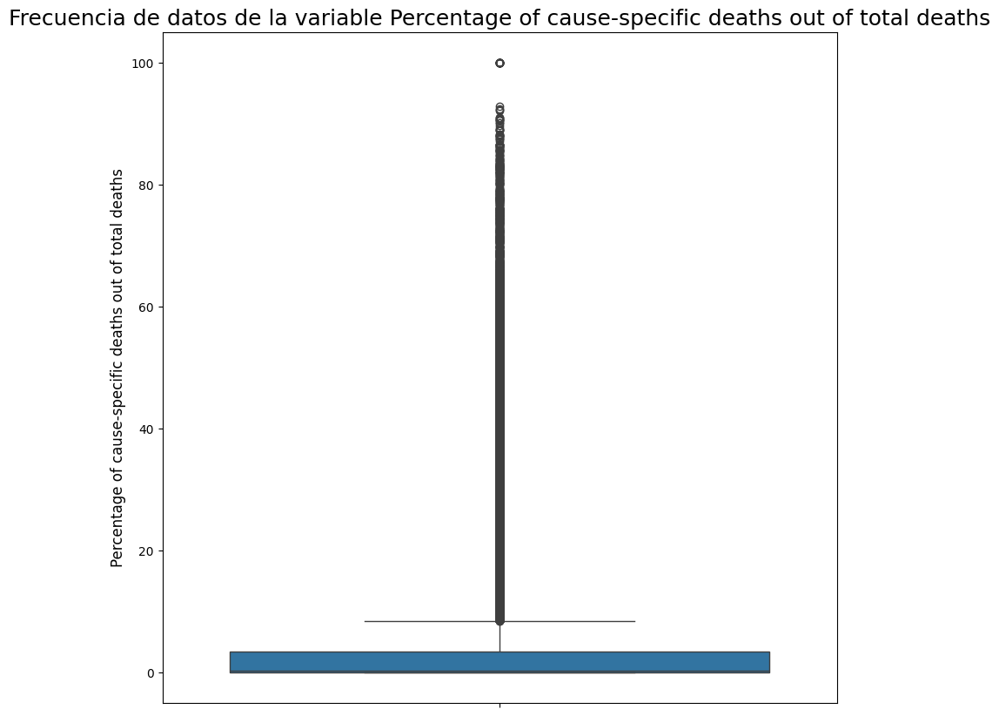

In [56]:
plt.figure(figsize=(10, 10))

sns.boxplot(y="Percentage of cause-specific deaths out of total deaths", data=df)

plt.title("Frecuencia de datos de la variable Percentage of cause-specific deaths out of total deaths", fontsize=18)
plt.ylabel("Percentage of cause-specific deaths out of total deaths", fontsize=12)

plt.show()

Se puede observar una gran asimetría a derecha, por lo que voy a proceder a transformar esos datos:

<ipython-input-57-2306b1186900>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y="Percentage of cause-specific deaths out of total deaths", data=df_normalizado, palette="pastel")


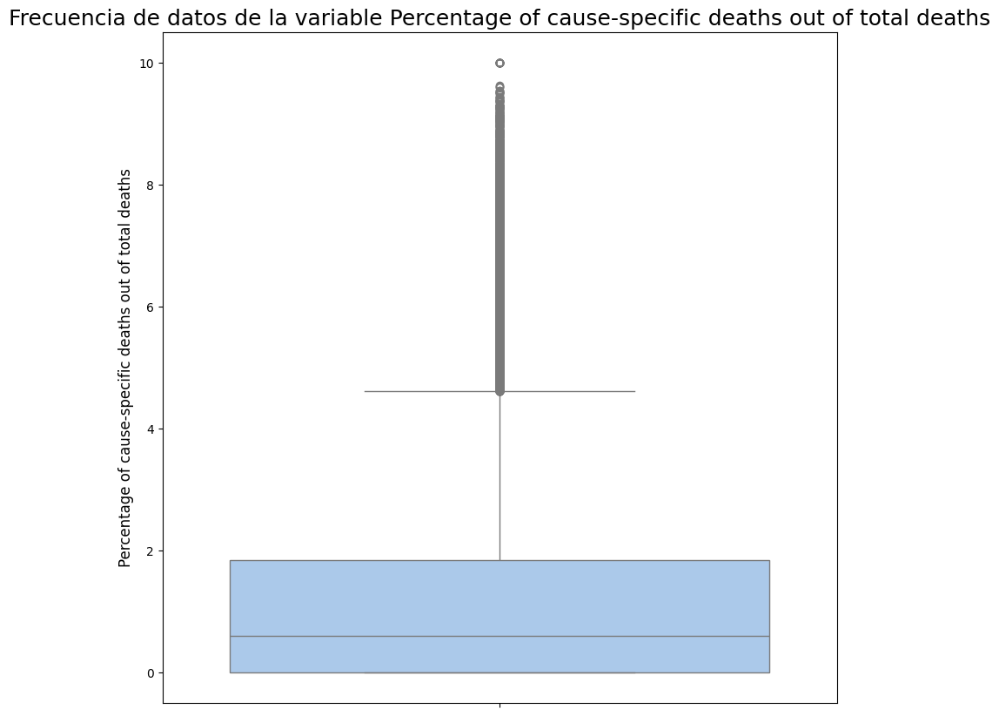

In [57]:
df_normalizado['Percentage of cause-specific deaths out of total deaths'] = np.sqrt(df_normalizado['Percentage of cause-specific deaths out of total deaths'])

plt.figure(figsize=(10, 10))
sns.boxplot(y="Percentage of cause-specific deaths out of total deaths", data=df_normalizado, palette="pastel")
plt.title("Frecuencia de datos de la variable Percentage of cause-specific deaths out of total deaths", fontsize=18)
plt.ylabel("Percentage of cause-specific deaths out of total deaths", fontsize=12)

plt.show()

Ya habiéndo transformado un dataset de prueba hay una asimetría a izquierda, pero que es menor que la anterior, por lo que procedo a realizar la transformación en el dataframe df:

In [58]:
df['Percentage of cause-specific deaths out of total deaths'] = np.sqrt(df['Percentage of cause-specific deaths out of total deaths'])

**Death rate per 100 000 population**

Se logró normalizar mejor

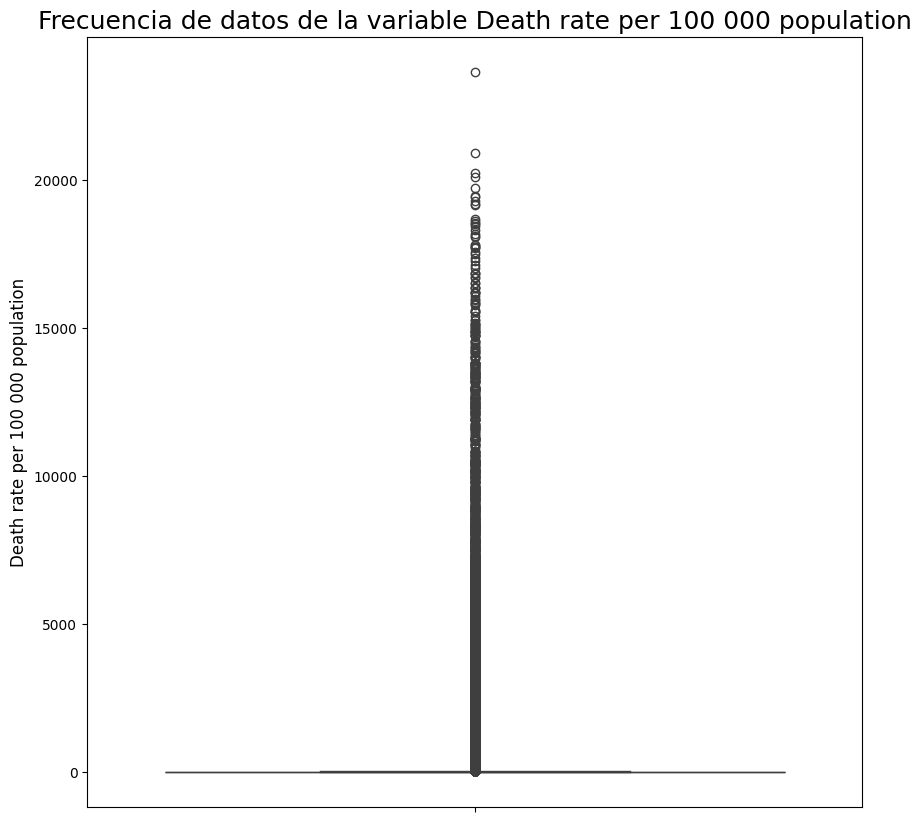

In [59]:
plt.figure(figsize=(10, 10))

sns.boxplot(y="Death rate per 100 000 population", data=df)

plt.title("Frecuencia de datos de la variable Death rate per 100 000 population", fontsize=18)
plt.ylabel("Death rate per 100 000 population", fontsize=12)

plt.show()

Se puede observar una gran asimetría a derecha, por lo que voy a proceder a transformar esos datos:

Esta sesgado a derecha

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
<ipython-input-60-086703d6a074>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y="Death rate per 100 000 population", data=df_normalizado, palette="pastel")


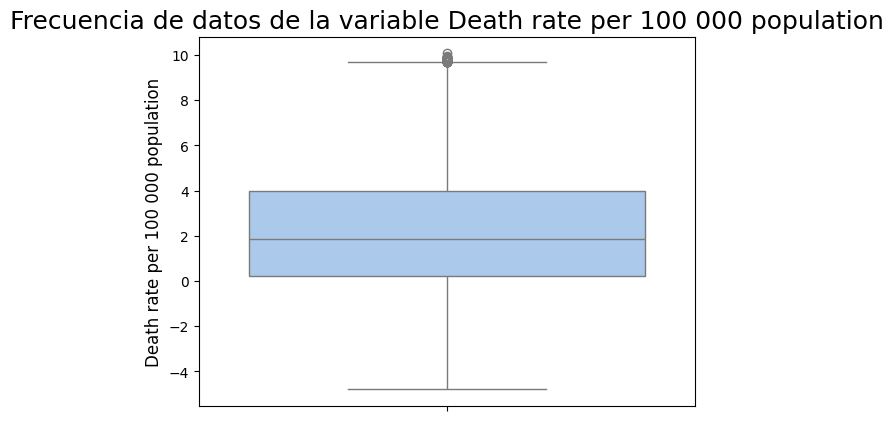

In [60]:
df_normalizado['Death rate per 100 000 population'] = np.log(df_normalizado['Death rate per 100 000 population'])

sns.boxplot(y="Death rate per 100 000 population", data=df_normalizado, palette="pastel")
plt.title("Frecuencia de datos de la variable Death rate per 100 000 population", fontsize=18)
plt.ylabel("Death rate per 100 000 population", fontsize=12)

plt.show()

Ya habiéndo transformado un dataset de prueba hay una asimetría, pero que es menor que la anterior, por lo que procedo a realizar la transformación en el dataframe df:

In [61]:
df['Death rate per 100 000 population'] = np.log(df['Death rate per 100 000 population'])

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


**Current health expenditure (% of GDP)**

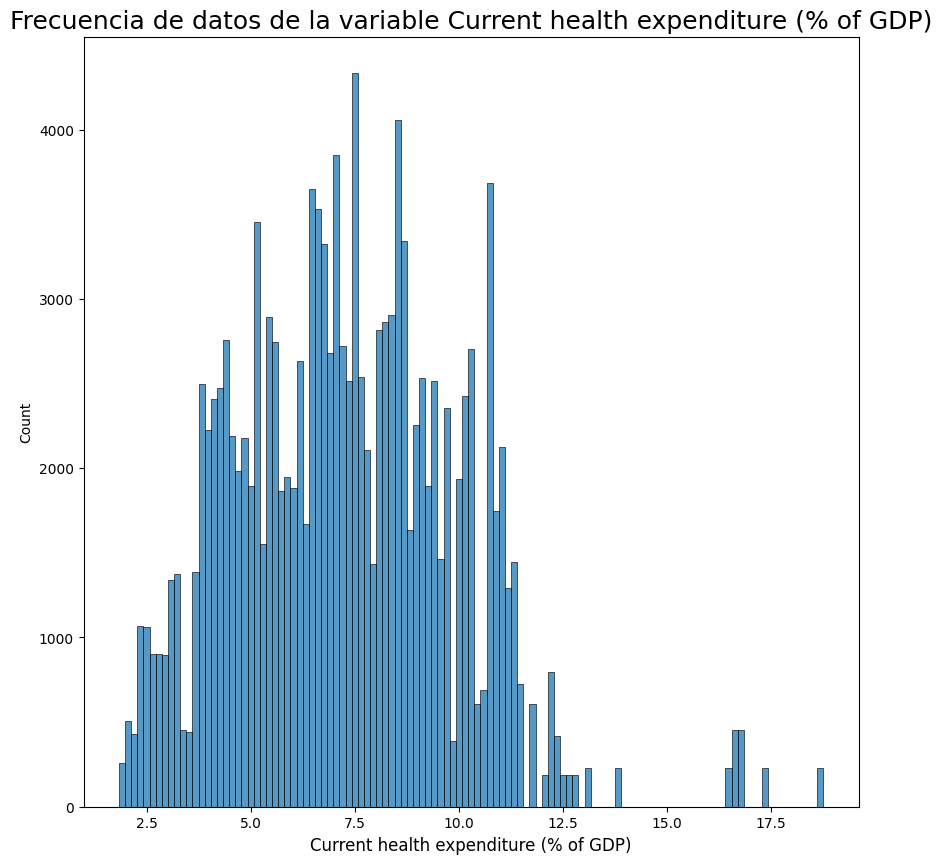

In [62]:
plt.figure(figsize=(10, 10))

sns.histplot(x="Current health expenditure (% of GDP)", data=df)

plt.title("Frecuencia de datos de la variable Current health expenditure (% of GDP)", fontsize=18)
plt.xlabel("Current health expenditure (% of GDP)", fontsize=12)

plt.show()

Esta levemente sesgado a derecha, pero la normalización que intenté, usando log o sqrt, lo que hizo fue sesgarlo a izquierda.

Asi que, lo dejé como viene.

**Poverty headcount ratio at societal poverty line (% of population)**

Se logró normalizar mejor

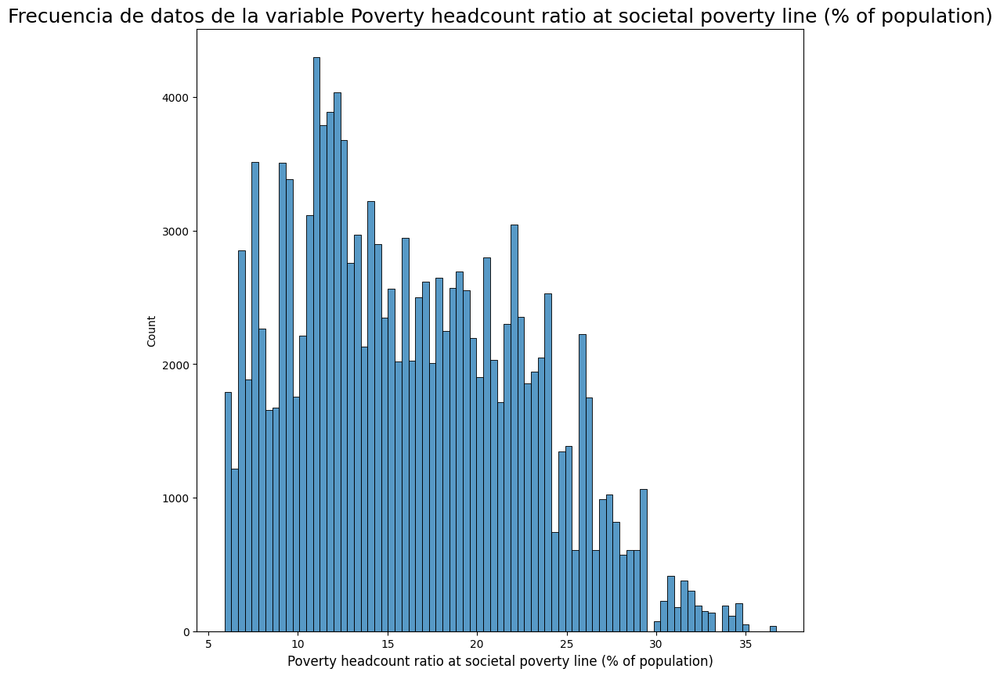

In [63]:
plt.figure(figsize=(10, 10))

sns.histplot(x="Poverty headcount ratio at societal poverty line (% of population)", data=df)

plt.title("Frecuencia de datos de la variable Poverty headcount ratio at societal poverty line (% of population)", fontsize=18)
plt.xlabel("Poverty headcount ratio at societal poverty line (% of population)", fontsize=12)

plt.show()

Se puede observar una asimetría a derecha, por lo que voy a proceder a transformar esos datos:

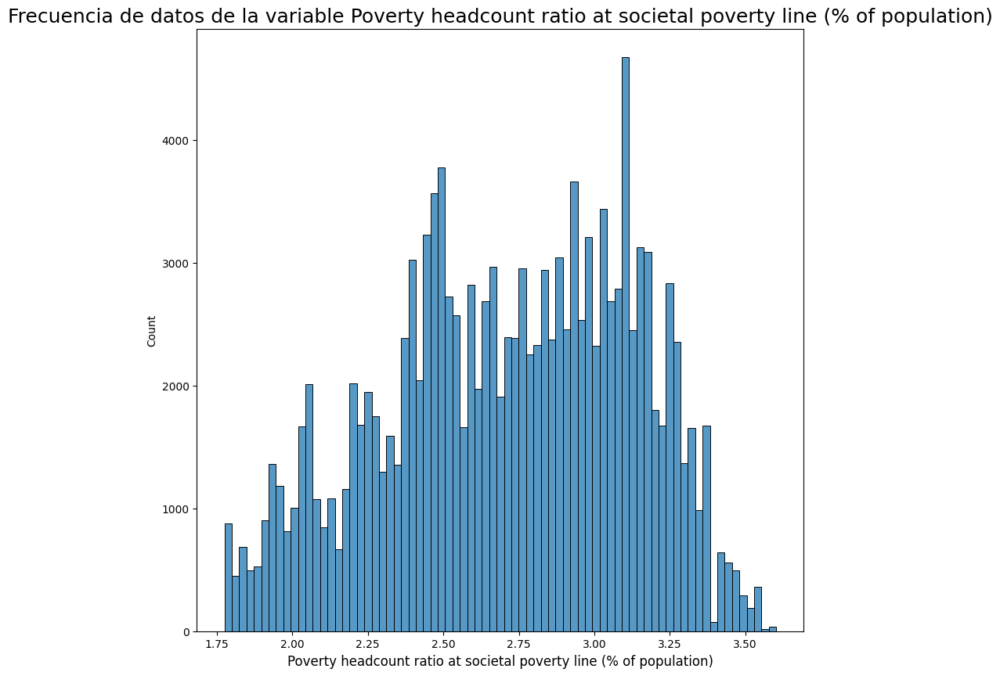

In [64]:
df_normalizado['Poverty headcount ratio at societal poverty line (% of population)'] = np.log(df_normalizado['Poverty headcount ratio at societal poverty line (% of population)'])

plt.figure(figsize=(10, 10))

sns.histplot(x="Poverty headcount ratio at societal poverty line (% of population)", data=df_normalizado)

plt.title("Frecuencia de datos de la variable Poverty headcount ratio at societal poverty line (% of population)", fontsize=18)
plt.xlabel("Poverty headcount ratio at societal poverty line (% of population)", fontsize=12)

plt.show()

Ya habiéndo transformado un dataset, noto que se ve con una distribución más normal, por lo que procedo a realizar la transformación en el dataframe df:

In [65]:
df['Poverty headcount ratio at societal poverty line (% of population)'] = np.log(df['Poverty headcount ratio at societal poverty line (% of population)'])

###Viendo si los datos de los rangos etarios y sexo estan balanceados




<ipython-input-259-8136885bfa21>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="Age Group", data=df, palette="pastel")


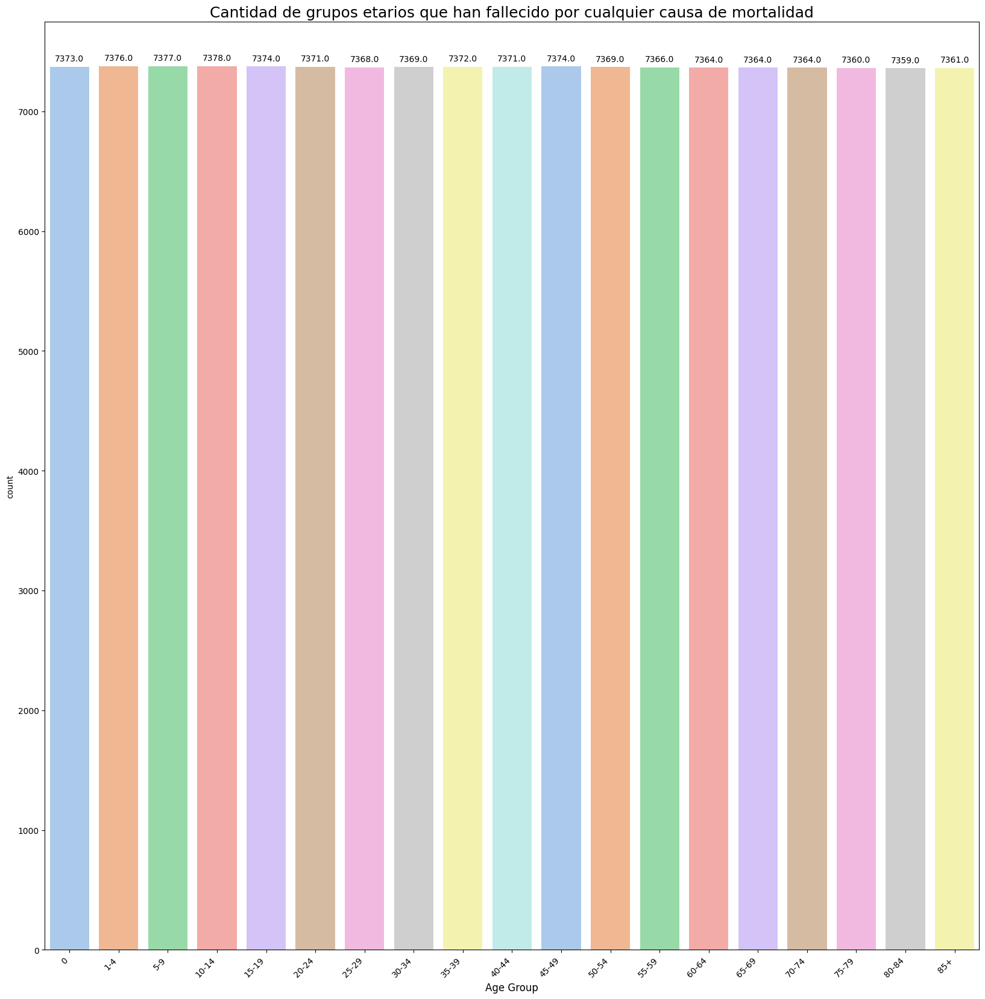

In [ ]:
plt.figure(figsize=(20, 20))

sns.countplot(x="Age Group", data=df, palette="pastel")

plt.title("Cantidad de grupos etarios que han fallecido por cualquier causa de mortalidad", fontsize=18)
plt.xlabel("Age Group", fontsize=12)
plt.xticks(rotation=45, ha='right')

for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                       ha='center', va='center', xytext=(0, 10), textcoords='offset points', fontsize=10)

plt.show()

La cantidad de grupos etarios en este dataset son casi uniformes.

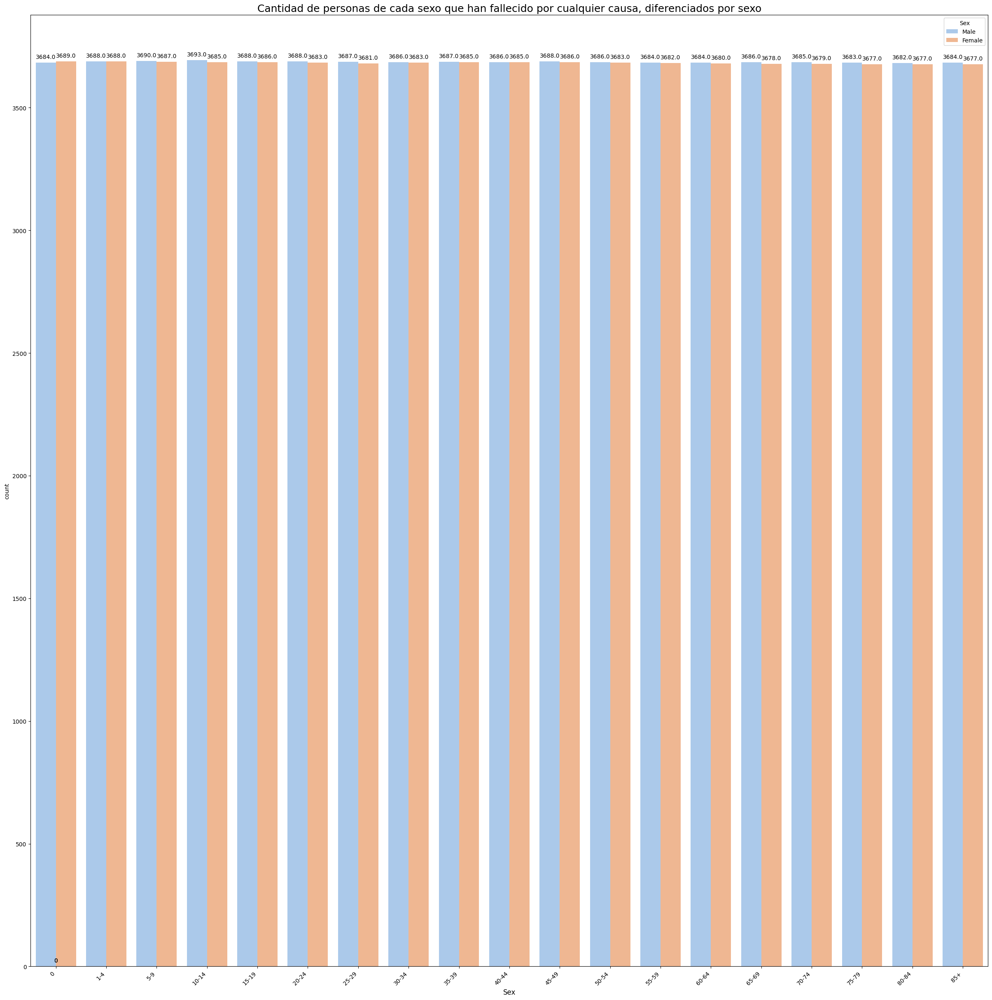

In [ ]:
plt.figure(figsize=(30, 30))

sns.countplot(data=df, x="Age Group", hue="Sex", palette="pastel")

plt.title("Cantidad de personas de cada sexo que han fallecido por cualquier causa, diferenciados por sexo", fontsize=18)
plt.xlabel("Sex", fontsize=12)
plt.xticks(rotation=45, ha='right')

for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                       ha='center', va='center', xytext=(0, 10), textcoords='offset points', fontsize=10)

plt.show()

La cantidad de personas en cada sexo es casi uniforme.

#Respondiendo las preguntas

##1) Las causas de muerte están relacionadas con el sexo y/o rango etario de las personas


###1)a) Las causas de muerte están relacionadas con el sexo de las personas

<ipython-input-73-5af36b8e6bd3>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_cv, palette='pastel')


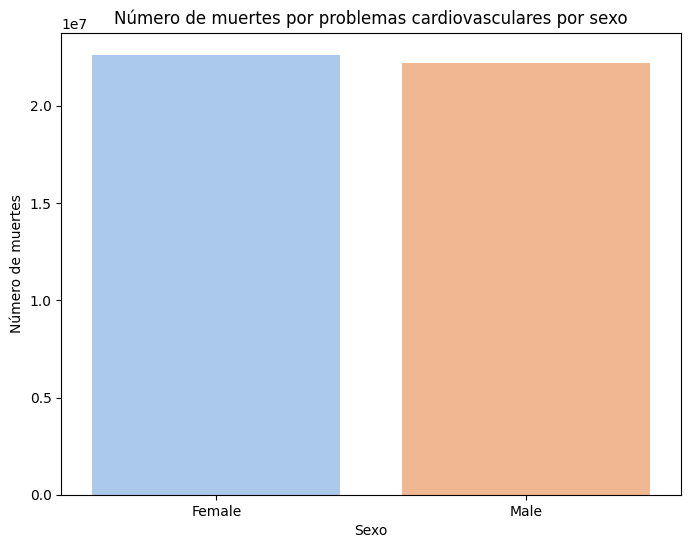

In [73]:
# PROBLEMAS CARDIOVASCULARES

df_grouped_for_sex_cv = df_cardiovascular_diseases.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_cv, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por problemas cardiovasculares por sexo')
plt.show()

En el caso de problemas cardiovasculares, no veo que haya diferencia entre hombres ni mujeres en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

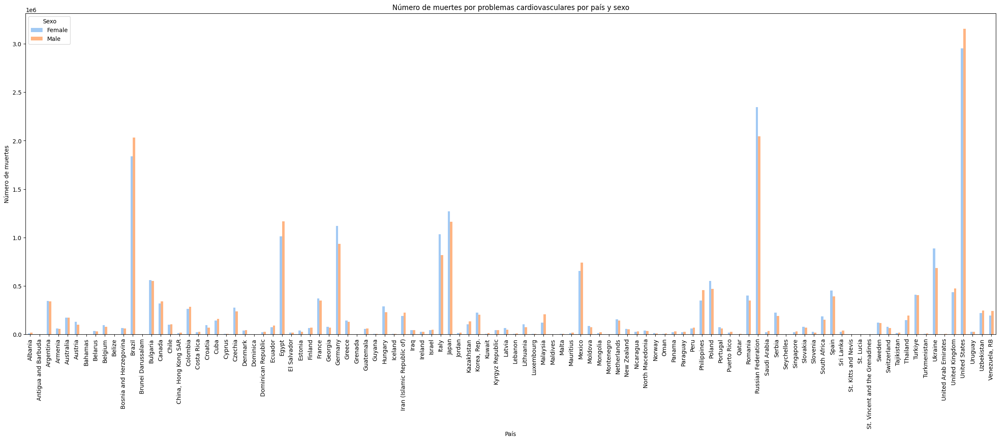

In [74]:
# PROBLEMAS CARDIOVASCULARES ZOOM PAISES

df_grouped_for_sex_and_countries_cv = df_cardiovascular_diseases.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_cv.columns.size)

df_grouped_for_sex_and_countries_cv.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por problemas cardiovasculares por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por problemas cardiovasculares hacia hombres o mujeres:

* Brazil, Egypt, Malaysia, Mexico, Philipines, United States: se ve que hay más hombres que mujeres afectados
* Germany, Italy, Japan, Poland, Russian Federation, Ukraine: se ve que hay más mujeres que hombres afectadas

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-75-21ac873b1f85>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_ir, palette='pastel')


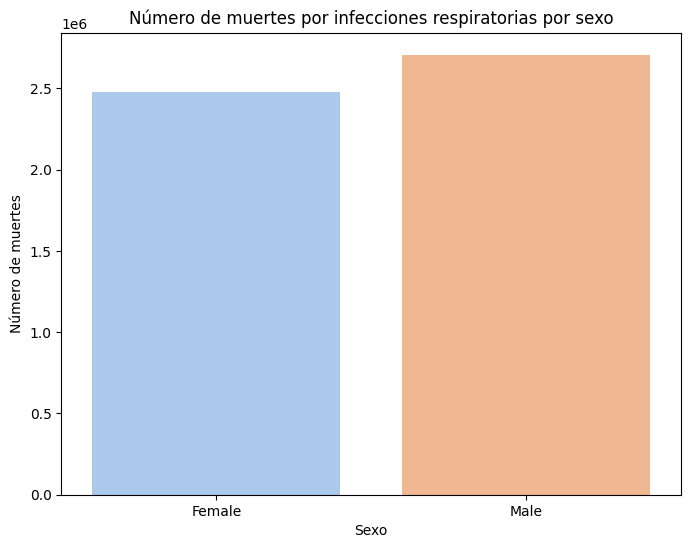

In [75]:
# INFECCIONES RESPIRATORIAS

df_grouped_for_sex_ir = df_lower_respiratory_infections.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_ir, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por infecciones respiratorias por sexo')
plt.show()

En el caso de infecciones respiratorias, hay una leve diferencia entre hombres y mujeres, sesgado más hacia los hombres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

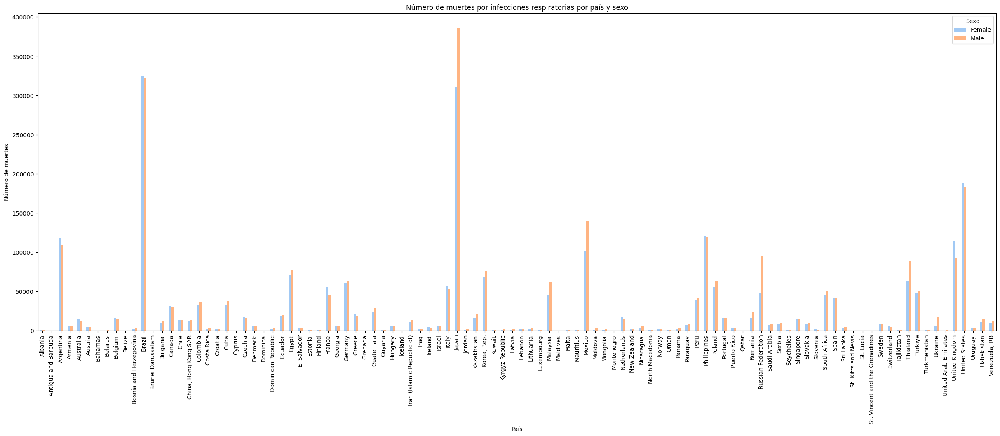

In [76]:
# INFECCIONES RESPIRATORIAS ZOOM PAISES

df_grouped_for_sex_and_countries_ir = df_lower_respiratory_infections.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_ir.columns.size)

df_grouped_for_sex_and_countries_ir.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por infecciones respiratorias por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por infecciones respiratorias hacia hombres o mujeres:

* Japan, Malaysia, Mexico, Russian Federation, Thailand, Ukraine: se ve que hay más hombres que mujeres afectados
* Argentina, France, United Kingdom: se ve que hay más mujeres que hombres afectadas

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-77-fba734946fda>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_dm, palette='pastel')


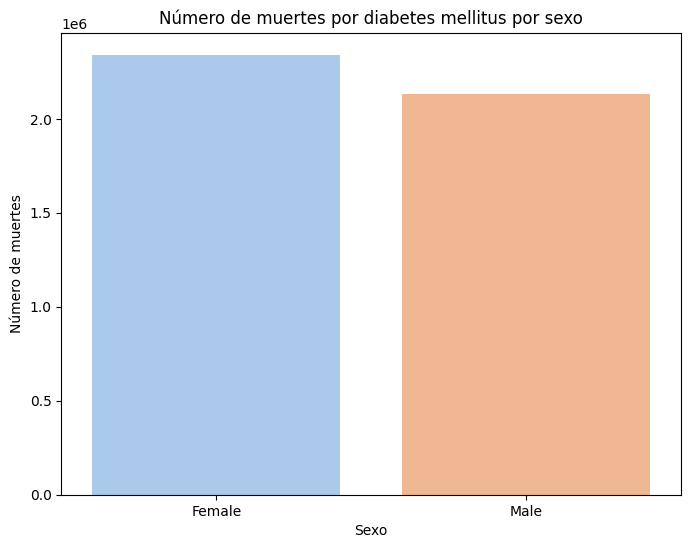

In [77]:
# DIABETES MELLITUS

df_grouped_for_sex_dm = df_diabetes_mellitus.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_dm, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por diabetes mellitus por sexo')
plt.show()

En el caso de diabetes mellitus, hay una leve diferencia entre hombres y mujeres, sesgado más hacia las mujeres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

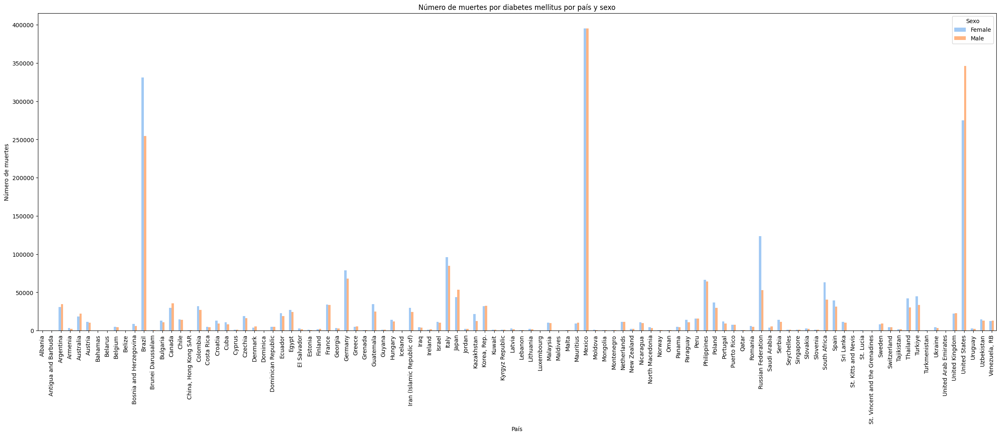

In [78]:
# DIABETES MELLITUS ZOOM PAISES

df_grouped_for_sex_and_countries_dm = df_diabetes_mellitus.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_dm.columns.size)

df_grouped_for_sex_and_countries_dm.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por diabetes mellitus por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por diabetes mellitus hacia hombres o mujeres:

* Japan, United States: se ve que hay más hombres que mujeres afectados
* Brazil, Germany, Italy, Russian Federation, South Africa, Thailand, Turkiye: se ve que hay más mujeres que hombres afectadas

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-79-1994429b0f9a>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_t, palette='pastel')


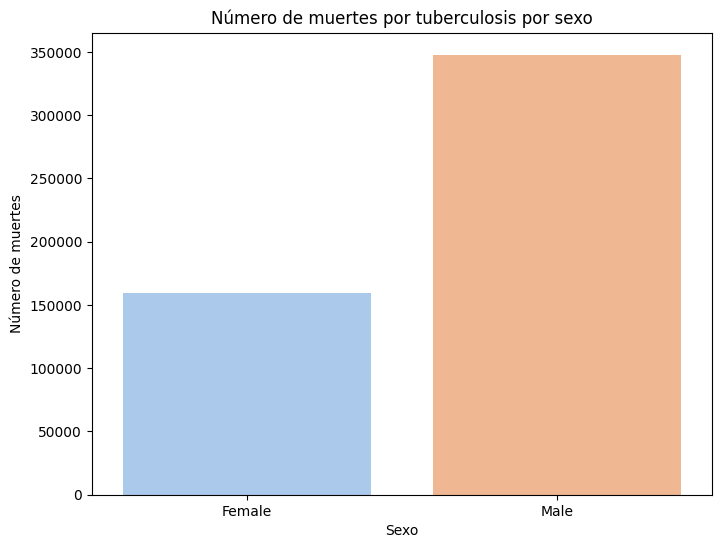

In [79]:
# TUBERCULOSIS

df_grouped_for_sex_t = df_tuberculosis.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_t, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por tuberculosis por sexo')
plt.show()

En el caso de tuberculosis, hay una diferencia notable entre hombres y mujeres, hay mucho sesgo hacia los hombres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

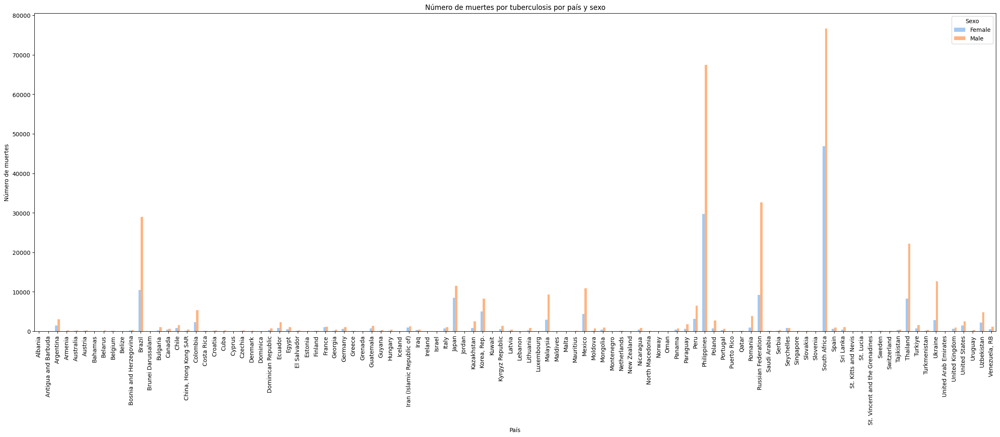

In [80]:
# TUBERCULOSIS ZOOM PAISES

df_grouped_for_sex_and_countries_t = df_tuberculosis.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_t.columns.size)

df_grouped_for_sex_and_countries_t.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por tuberculosis por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por tuberculosis hacia hombres o mujeres:

* Brazil, Colombia, Japan, Korea, Malaysia, Mexico, Peru, Philipines, Poland, Romania, Russian Federation, South Africa, Thailand, Ukraine, Uzbekistan: se ve que hay más hombres que mujeres afectados

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-81-7bcd2bea8d43>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_ed, palette='pastel')


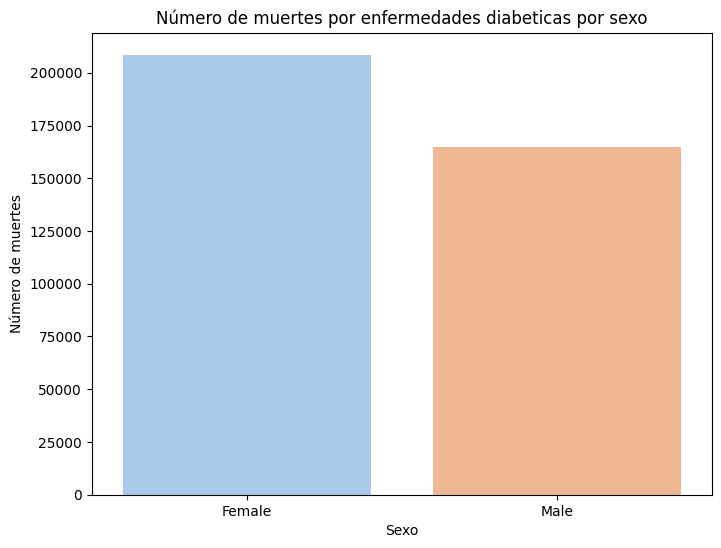

In [81]:
# ENFERMEDADES DIARREICAS

df_grouped_for_sex_ed = df_diarrhoeal_diseases.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_ed, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por enfermedades diabeticas por sexo')
plt.show()

En el caso de las enfermedades diarréicas, hay una diferencia notable entre hombres y mujeres, hay sesgo hacia las mujeres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

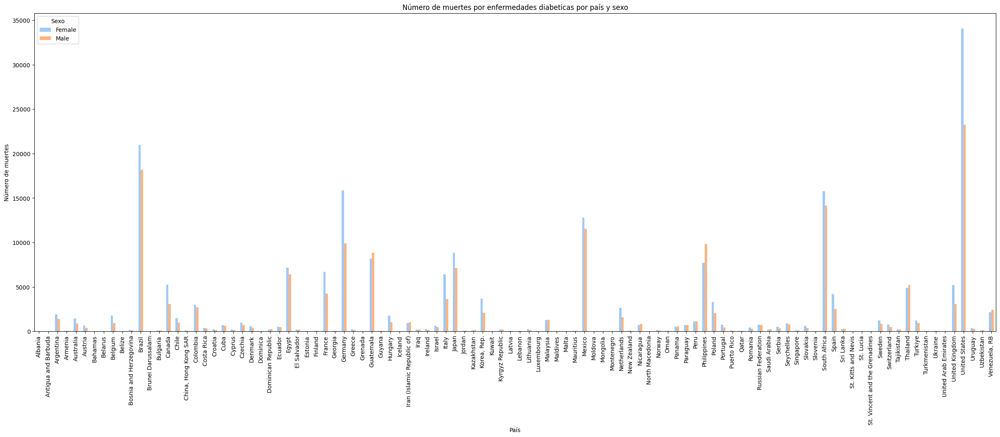

In [82]:
# ENFERMEDADES DIARREICAS ZOOM PAISES

df_grouped_for_sex_and_countries_ed = df_diarrhoeal_diseases.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_ed.columns.size)

df_grouped_for_sex_and_countries_ed.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por enfermedades diabeticas por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por enfermedades diarréicas hacia hombres o mujeres:

* Philipines: se ve que hay más hombres que mujeres afectados
* Belgium, Brazil, Canada, France, Germany, Italy, Japan, Korea, Mexico, Netherlands, South Africa, Spain, United Kingdom, United States: se ve que hay más mujeres que hombres afectados

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-83-486f91335c75>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_hb, palette='pastel')


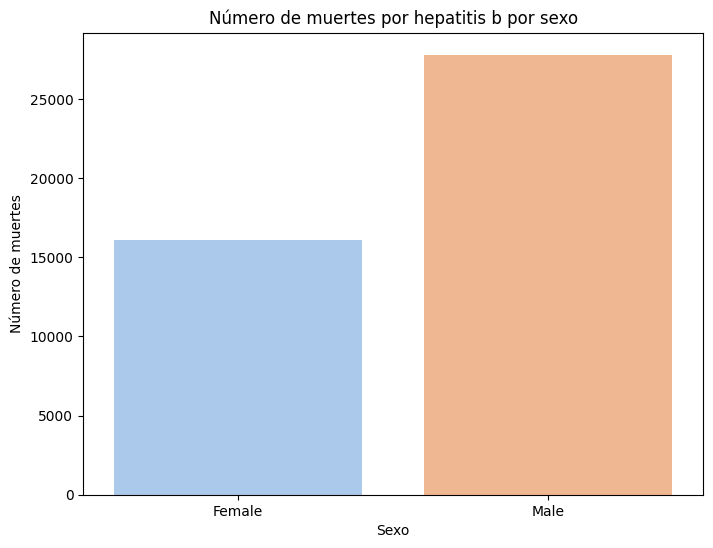

In [83]:
# HEPATITIS B

df_grouped_for_sex_hb = df_hepatitis_B.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_hb, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis b por sexo')
plt.show()

En el caso de hepatitis B, hay una diferencia notable entre hombres y mujeres, hay mucho sesgo hacia los hombres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

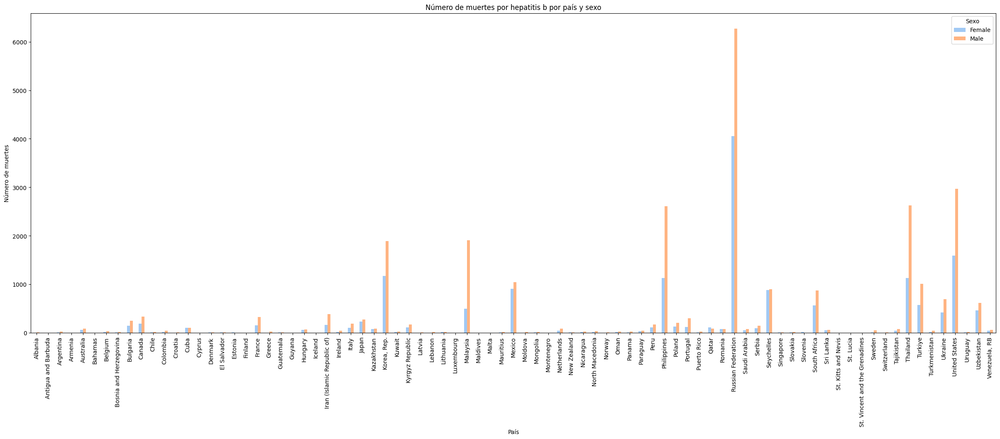

In [84]:
# HEPATITIS B ZOOM PAISES

df_grouped_for_sex_and_countries_hb = df_hepatitis_B.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_hb.columns.size)

df_grouped_for_sex_and_countries_hb.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis b por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por hepatitis B hacia hombres o mujeres:

* France, Iran, Kores, Malaysia, Philipines, Portugal, Russian Federation, South Africa, Thailand, Turkiye, Ukraine, United Staters, Uzbekistan: se ve que hay más hombres que mujeres afectados

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-85-c1e5fd02e952>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_bw, palette='pastel')


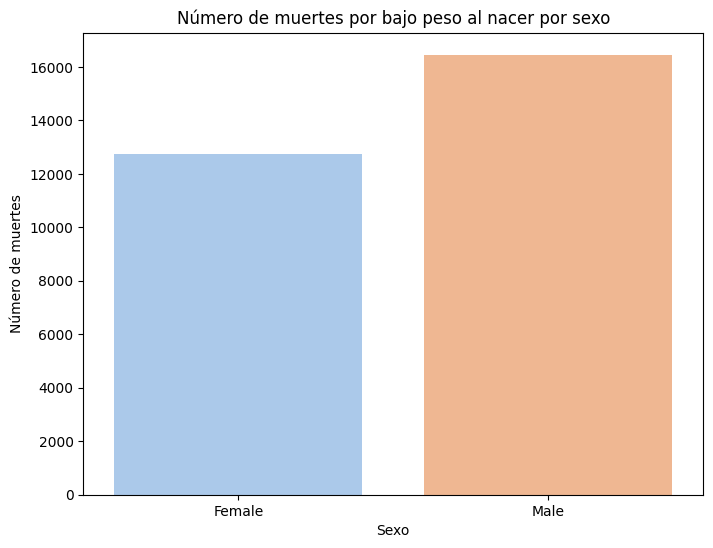

In [85]:
# BAJO PESO AL NACER

df_grouped_for_sex_bw = df_low_birth_weight.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_bw, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por bajo peso al nacer por sexo')
plt.show()

En el caso de bajo peso al nacer, hay una diferencia notable entre hombres y mujeres, hay sesgo hacia los hombres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

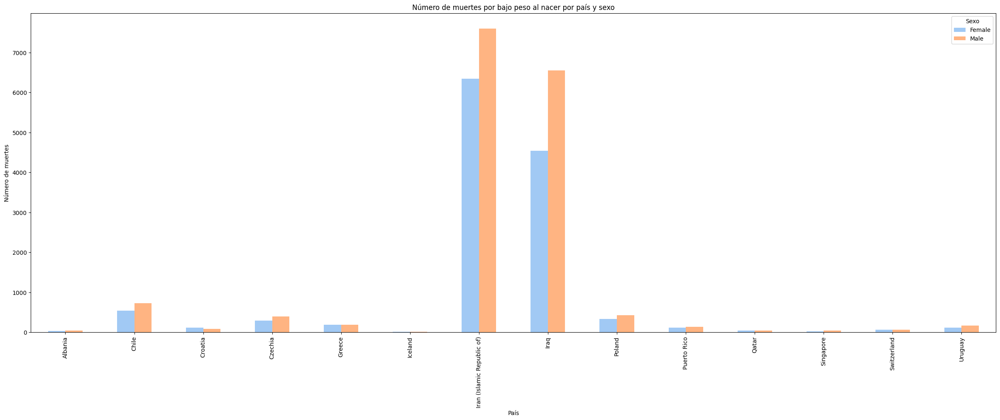

In [86]:
# BAJO PESO AL NACER ZOOM PAISES

df_grouped_for_sex_and_countries_bw = df_low_birth_weight.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_bw.columns.size)

df_grouped_for_sex_and_countries_bw.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por bajo peso al nacer por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por hepatitis B hacia hombres o mujeres:

* Iran, Iraq: se ve que hay más hombres que mujeres afectados

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-87-de797ee80778>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_hiv, palette='pastel')


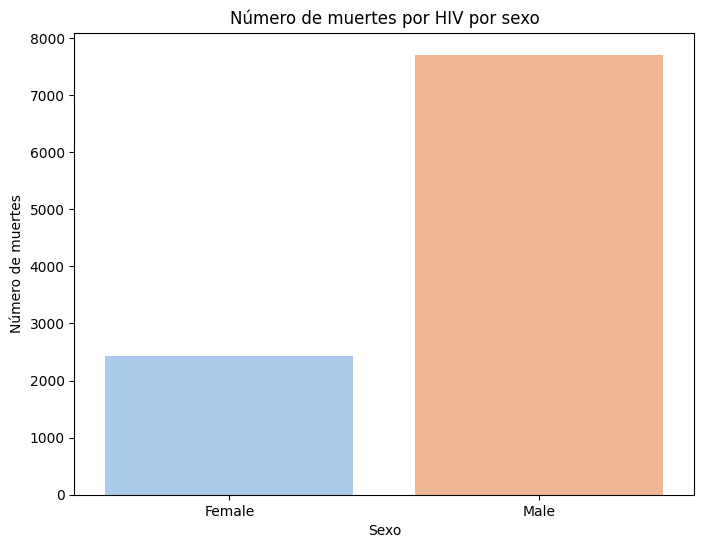

In [87]:
# HIV

df_grouped_for_sex_hiv = df_HIV.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_hiv, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por HIV por sexo')
plt.show()

En el caso de HIV, hay una diferencia notable entre hombres y mujeres, hay mucho sesgo hacia los hombres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

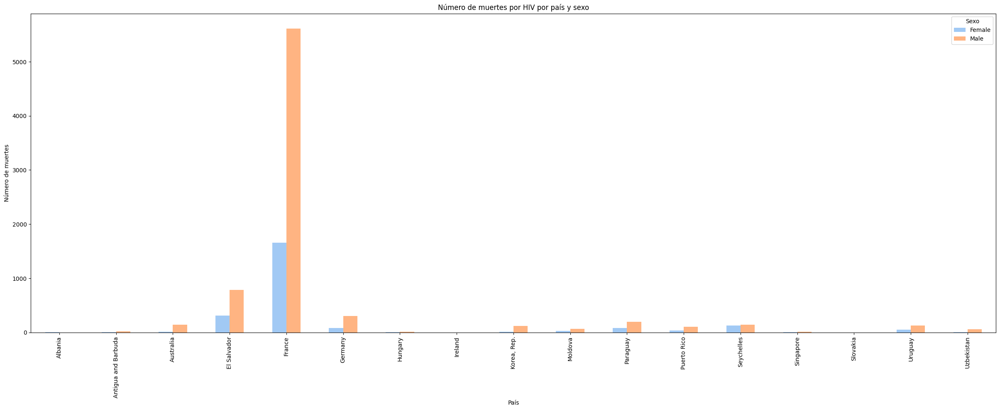

In [88]:
# HIV ZOOM PAISES

df_grouped_for_sex_and_countries_hiv = df_HIV.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_hiv.columns.size)

df_grouped_for_sex_and_countries_hiv.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por HIV por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por HIV hacia hombres o mujeres:

* El Salvador, France, Germany: se ve que hay más hombres que mujeres afectados

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-89-8314ec67c17b>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_covid, palette='pastel')


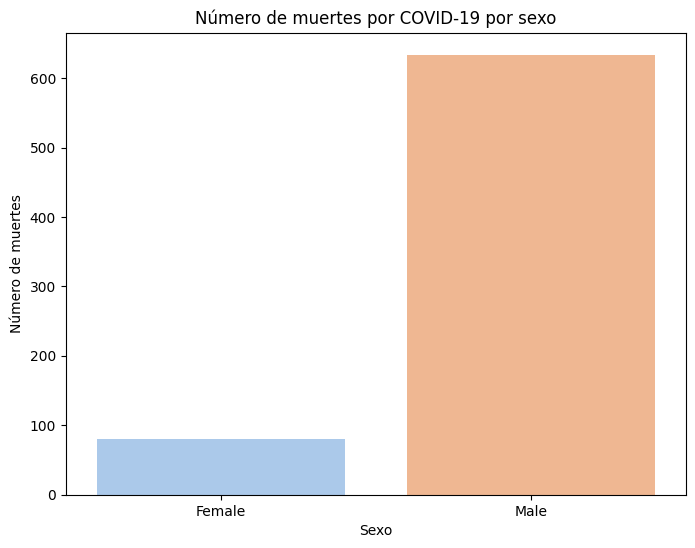

In [89]:
# COVID-19

df_grouped_for_sex_covid = df_COVID19.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_covid, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por COVID-19 por sexo')
plt.show()

En el caso de COVID-19, hay una diferencia notable entre hombres y mujeres, hay mucho sesgo hacia los hombres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

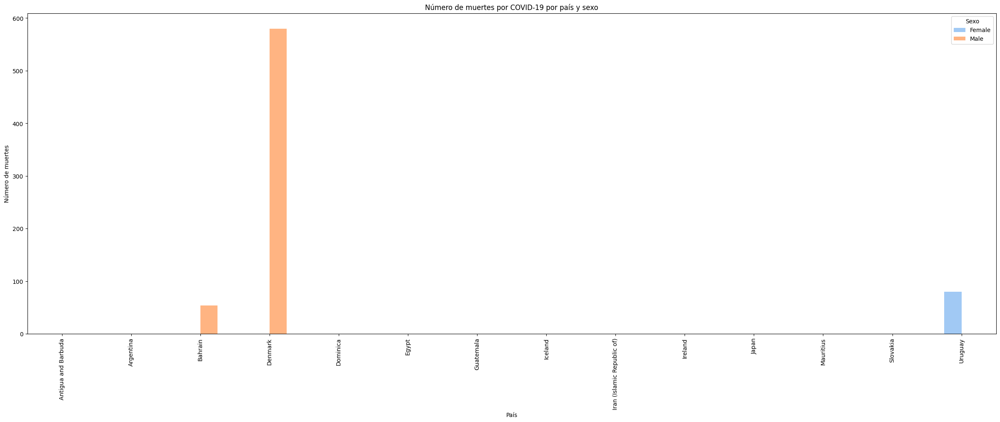

In [90]:
# COVID-19 ZOOM PAISES

df_grouped_for_sex_and_countries_covid = df_COVID19.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_covid.columns.size)

df_grouped_for_sex_and_countries_covid.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por COVID-19 por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por COVID-19 hacia hombres o mujeres:

* Bahrain, Denmark: se ve que hay más hombres que mujeres afectados
* Uruguay: se ve que hay más mujeres que hombres afectadas

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

<ipython-input-91-9a8e43bd28f2>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_hc, palette='pastel')


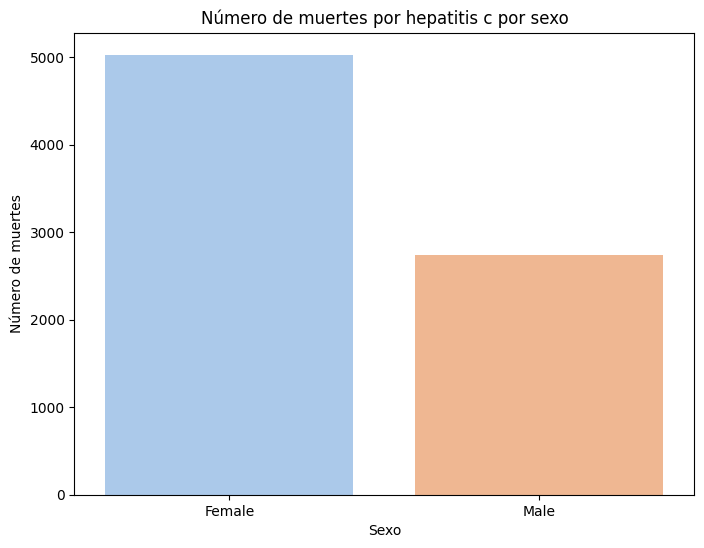

In [91]:
# HEPATITIS C

df_grouped_for_sex_hc = df_hepatitis_C.groupby('Sex')['Number'].sum().reset_index()

plt.figure(figsize=(8, 6))
sns.barplot(x='Sex', y='Number', data=df_grouped_for_sex_hc, palette='pastel')

plt.xlabel('Sexo')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis c por sexo')
plt.show()

En el caso de hepatitis C, hay una diferencia notable entre hombres y mujeres, hay mucho sesgo hacia las mujeres, en cuanto a la cantidad de muertes a lo largo de los años y en los el total de países. Por lo que voy a hacer un zoom en cada país.

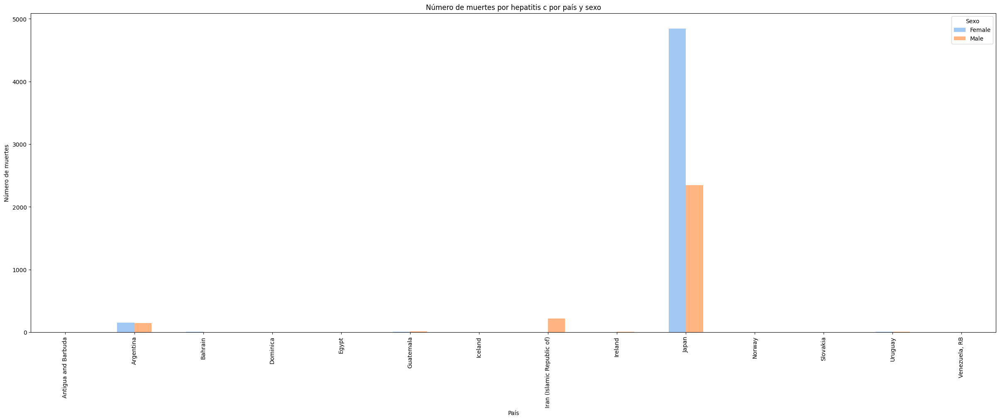

In [92]:
# HEPATITIS C ZOOM PAISES

df_grouped_for_sex_and_countries_hc = df_hepatitis_C.groupby(['Country Name', 'Sex'])['Number'].sum().unstack()

palette = sns.color_palette("pastel", df_grouped_for_sex_and_countries_hc.columns.size)

df_grouped_for_sex_and_countries_hc.plot(kind='bar', figsize=(30, 10), color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis c por país y sexo')
plt.xticks(rotation=90)
plt.legend(title='Sexo')
plt.show()

Los países en los que se ven un sesgo más marcados de muerte por COVID-19 hacia hombres o mujeres:

* Japan: se ve que hay más mujeres que hombres afectadas

Con esta información se puede, en estos países, estudiar por qué existe este sesgo, para enfocar los recursos.

###1)b) Las causas de muerte están relacionadas con el rango etario de las personas

In [143]:
order = ['0', '1-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '80-84', '+85']
num_colors = len(order)+1
palette = sns.color_palette("husl", num_colors)

<ipython-input-167-2077250b381d>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_cv, palette=palette)
<ipython-input-167-2077250b381d>:6: UserWarning: The palette list has more values (20) than needed (19), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_cv, palette=palette)


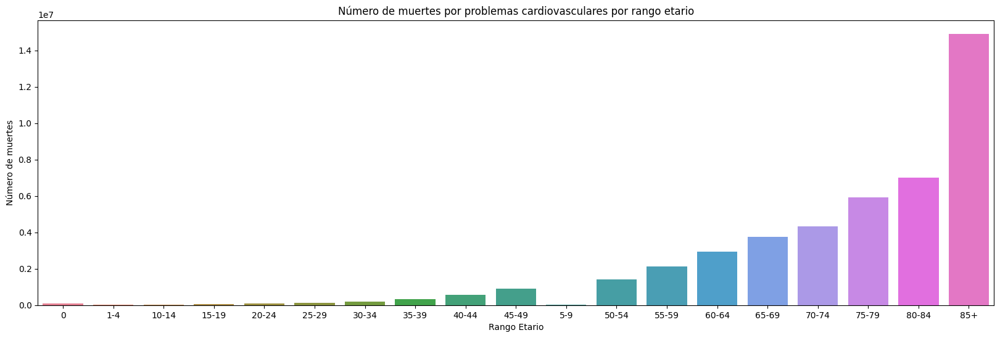

In [167]:
# PROBLEMAS CARDIOVASCULARES

df_grouped_for_age_group_cv = df_cardiovascular_diseases.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_cv, palette=palette)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por problemas cardiovasculares por rango etario')
plt.show()

Se ve que cuanto mayor es el rango etario, más muertes por problemas cardiovasculares hay.

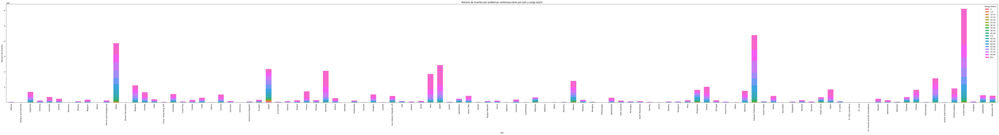

In [145]:
# PROBLEMAS CARDIOVASCULARES ZOOM PAISES

df_grouped_for_age_group_and_countries_cv = df_cardiovascular_diseases.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_cv.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por problemas cardiovasculares por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

Haciendo un zoom en cada país, se ve que la tendencia que se vió en el gráfico anterior, está en cada país. Excepto por los paises Albania, Antigua y Barbuda, Armenia (es bastante bajo), Bahamas, Belarus, Belgium, Belize, Bosnia and Herzegovina, Brunei Darussalam, Chile, China, Costa Rica, Croatia, Cyprus.

<ipython-input-168-e93bceb566ed>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_ir, palette=palette)
<ipython-input-168-e93bceb566ed>:8: UserWarning: The palette list has more values (20) than needed (19), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_ir, palette=palette)


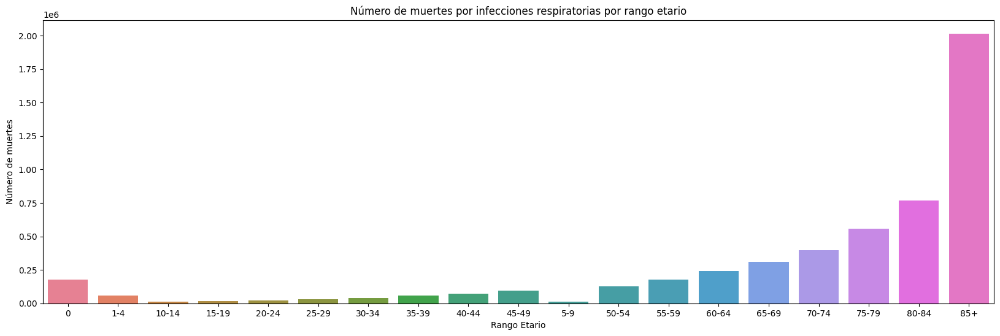

In [168]:
# INFECCIONES RESPIRATORIAS

df_grouped_for_age_group_ir = df_lower_respiratory_infections.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_ir, palette=palette)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por infecciones respiratorias por rango etario')
plt.show()

En este caso, se ve que los rango etarios más afectados también van aumentando con la edad, pero además los bebés de menos de 1 año (esto se puede deber a que son más vulnerables por ser tan pequeños)

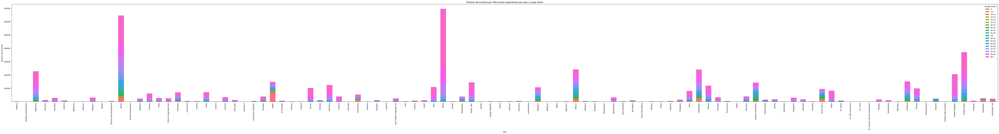

In [147]:
# INFECCIONES RESPIRATORIAS ZOOM PAISES

df_grouped_for_age_group_and_countries_ir = df_lower_respiratory_infections.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_ir.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por infecciones respiratorias por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

La tendencia de mayor afectación sólo cuando la edad va en incremento, se ve en casi todos los países, excepto por algunos como Brazil, Egypt, Mexico, Philipines, Uzbekistan, Guatemala en los que hay muchos menos a 1 año afectados.

<ipython-input-169-11c0cac5567f>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_dm, palette=palette)
<ipython-input-169-11c0cac5567f>:6: UserWarning: The palette list has more values (20) than needed (19), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_dm, palette=palette)


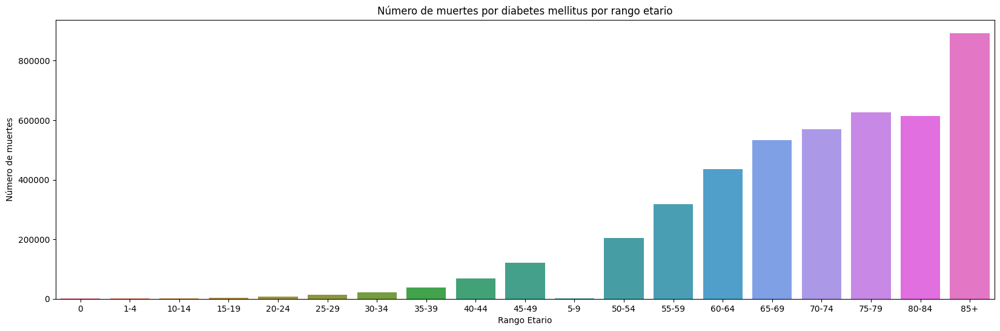

In [169]:
# DIABETES MELLITUS

df_grouped_for_age_group_dm = df_diabetes_mellitus.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_dm, palette=palette)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por diabetes mellitus por rango etario')
plt.show()

Es sabido que es una enfermedad que afecta más a las pesonas de mediana edad y personas mayores, y eso se refleja en el gráfico. Hay muy pocos casos a nivel mundia hasta el rango aprox de 50-54 años y de ahí va casi siempre en ascenso.

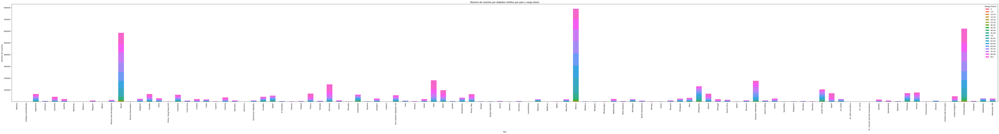

In [149]:
# DIABETES MELLITUS ZOOM PAISES

df_grouped_for_age_group_and_countries_dm = df_diabetes_mellitus.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_dm.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por diabetes mellitus por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

<ipython-input-150-36f81ec9d69e>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_t, palette=palette, order=order)
<ipython-input-150-36f81ec9d69e>:8: UserWarning: The palette list has more values (20) than needed (18), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_t, palette=palette, order=order)


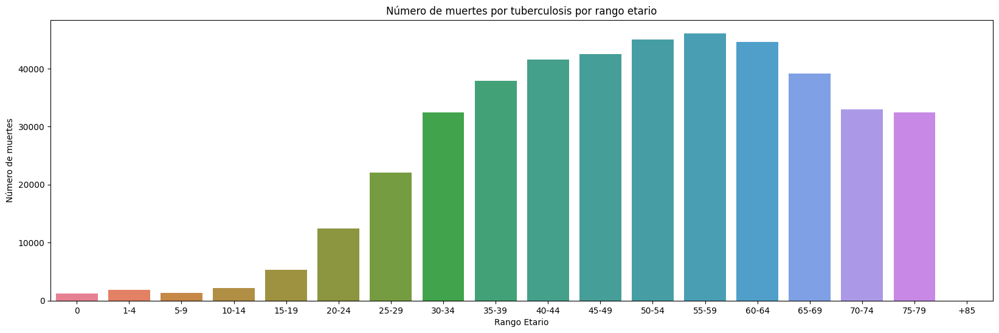

In [150]:
# TUBERCULOSIS

order = ['0', '1-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '+85']

df_grouped_for_age_group_t = df_tuberculosis.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_t, palette=palette, order=order)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por tuberculosis por rango etario')
plt.show()

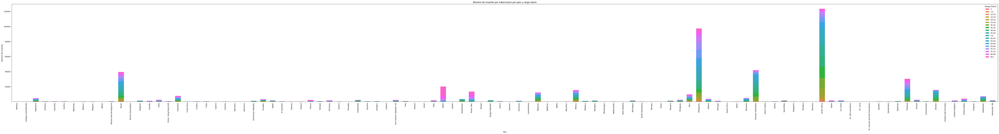

In [151]:
# TUBERCULOSIS ZOOM PAISES

df_grouped_for_age_group_and_countries_t = df_tuberculosis.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_t.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por tuberculosis por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

<ipython-input-152-99d5717b7995>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_ed, palette=palette, order=order)
<ipython-input-152-99d5717b7995>:8: UserWarning: The palette list has more values (20) than needed (18), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_ed, palette=palette, order=order)


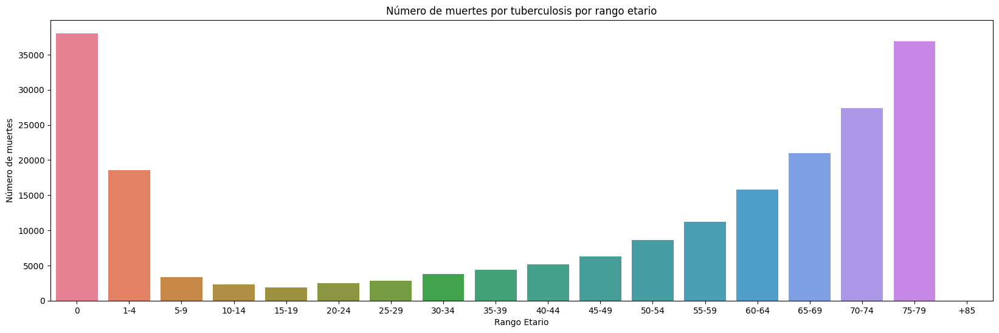

In [152]:
# ENFERMEDADES DIARREICAS

order = ['0', '1-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '+85']

df_grouped_for_age_group_ed = df_diarrhoeal_diseases.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_ed, palette=palette, order=order)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por tuberculosis por rango etario')
plt.show()

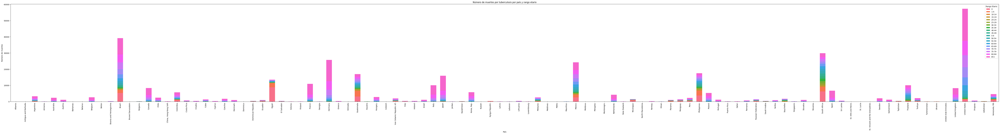

In [153]:
# ENFERMEDADES DIARREICAS ZOOM PAISES

df_grouped_for_age_group_and_countries_ed = df_diarrhoeal_diseases.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_ed.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por tuberculosis por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

<ipython-input-154-bd5f762c9d0b>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hb, palette=palette, order=order)
<ipython-input-154-bd5f762c9d0b>:8: UserWarning: The palette list has more values (20) than needed (18), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hb, palette=palette, order=order)


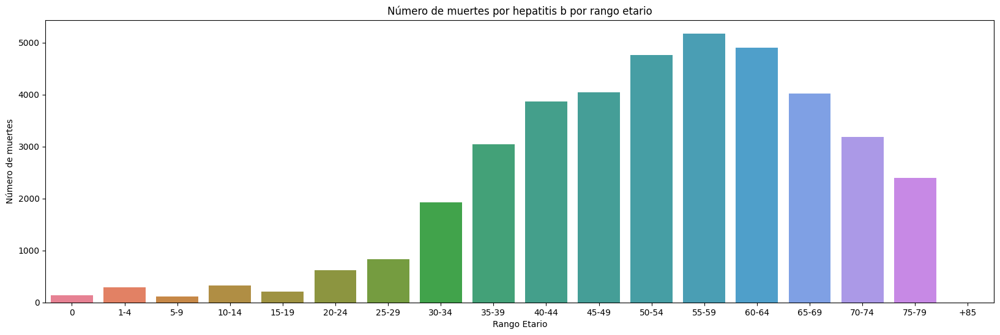

In [154]:
# HEPATITIS B

order = ['0', '1-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '+85']

df_grouped_for_age_group_hb = df_hepatitis_B.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hb, palette=palette, order=order)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis b por rango etario')
plt.show()

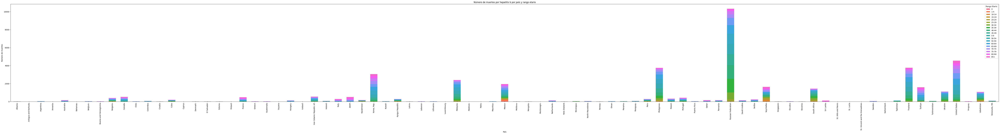

In [155]:
# HEPATITIS B ZOOM PAISES

df_grouped_for_age_group_and_countries_hb = df_hepatitis_B.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_hb.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis b por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

<ipython-input-156-36128dfd79e2>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_bw, palette=palette, order=order)
<ipython-input-156-36128dfd79e2>:8: UserWarning: The palette list has more values (20) than needed (18), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_bw, palette=palette, order=order)


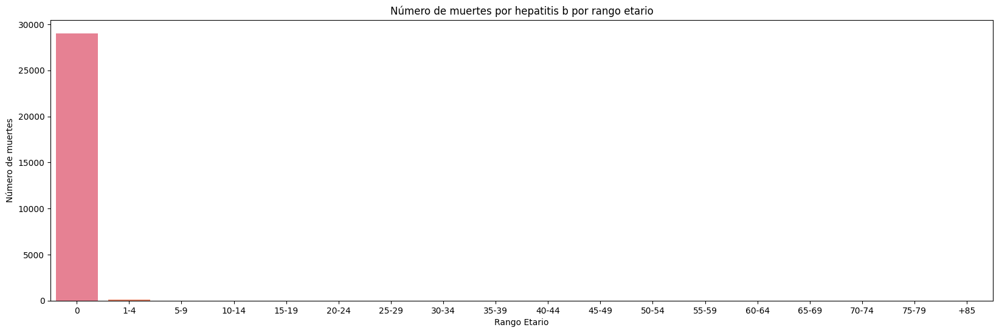

In [156]:
# BAJO PESO AL NACER

order = ['0', '1-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '+85']

df_grouped_for_age_group_bw = df_low_birth_weight.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_bw, palette=palette, order=order)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis b por rango etario')
plt.show()

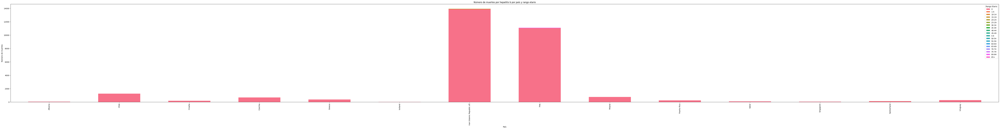

In [157]:
# BAJO PESO AL NACER ZOOM PAISES

df_grouped_for_age_group_and_countries_bw = df_low_birth_weight.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_bw.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis b por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

<ipython-input-158-80969477e7bd>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hiv, palette=palette, order=order)
<ipython-input-158-80969477e7bd>:8: UserWarning: The palette list has more values (20) than needed (18), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hiv, palette=palette, order=order)


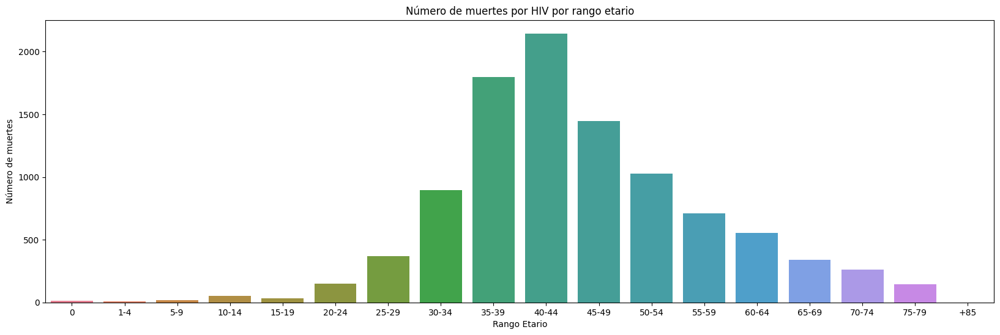

In [158]:
# HIV

order = ['0', '1-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '+85']

df_grouped_for_age_group_hiv = df_HIV.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hiv, palette=palette, order=order)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por HIV por rango etario')
plt.show()

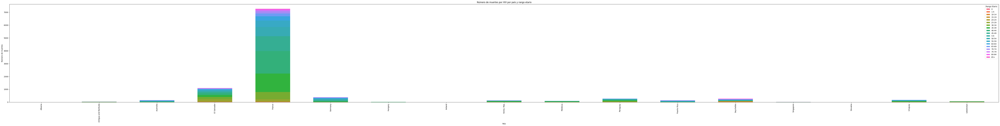

In [159]:
# HIV ZOOM PAISES

df_grouped_for_age_group_and_countries_hiv = df_HIV.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_hiv.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por HIV por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

<ipython-input-160-a8f94948f7bb>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_covid, palette=palette, order=order)
<ipython-input-160-a8f94948f7bb>:8: UserWarning: The palette list has more values (20) than needed (18), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_covid, palette=palette, order=order)


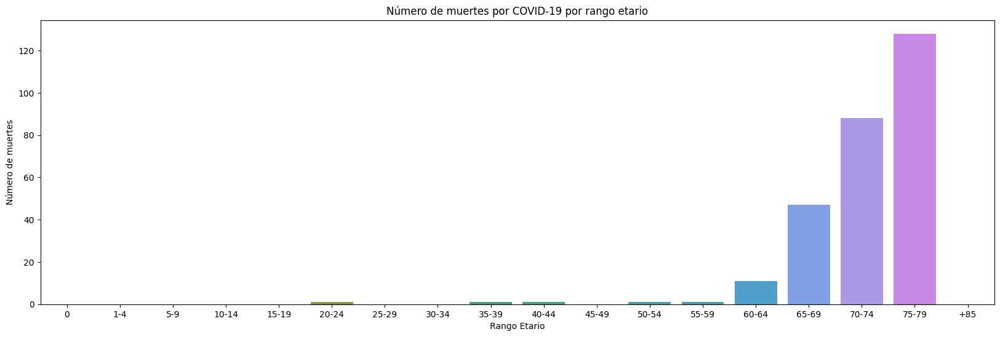

In [160]:
# COVID-19

order = ['0', '1-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '+85']

df_grouped_for_age_group_covid = df_COVID19.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_covid, palette=palette, order=order)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por COVID-19 por rango etario')
plt.show()

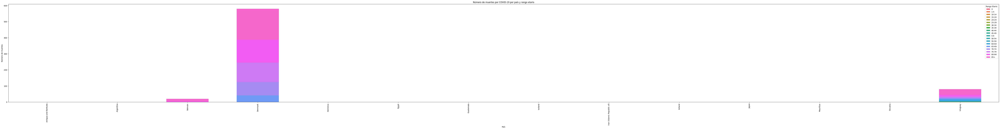

In [161]:
# COVID-19

df_grouped_for_age_group_and_countries_covid = df_COVID19.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_covid.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por COVID-19 por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

<ipython-input-162-c894b52fb008>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hc, palette=palette, order=order)
<ipython-input-162-c894b52fb008>:8: UserWarning: The palette list has more values (20) than needed (18), which may not be intended.
  sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hc, palette=palette, order=order)


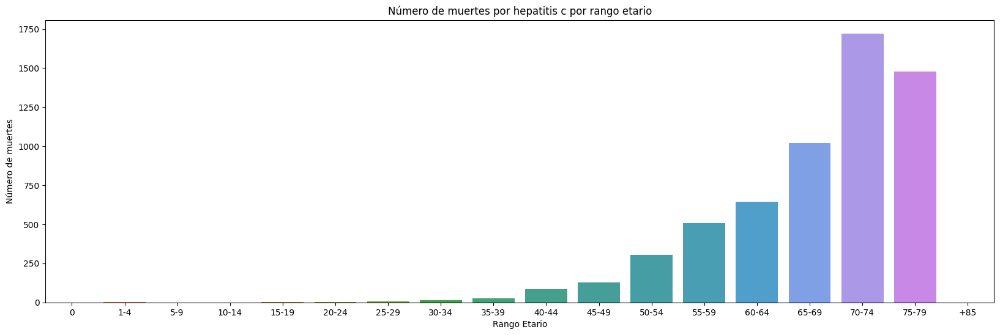

In [162]:
# HEPATITIS C

order = ['0', '1-4', '5-9', '10-14', '15-19', '20-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54', '55-59', '60-64', '65-69', '70-74', '75-79', '+85']

df_grouped_for_age_group_hc = df_hepatitis_C.groupby('Age Group')['Number'].sum().reset_index()

plt.figure(figsize=(20, 6))
sns.barplot(x='Age Group', y='Number', data=df_grouped_for_age_group_hc, palette=palette, order=order)

plt.xlabel('Rango Etario')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis c por rango etario')
plt.show()

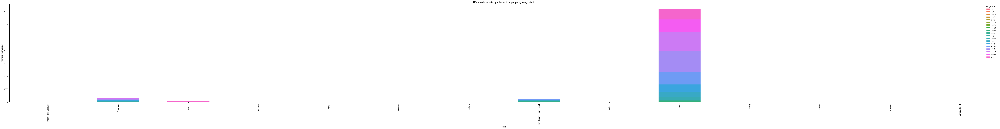

In [163]:
# HEPATITIS C

df_grouped_for_age_group_and_countries_hc = df_hepatitis_C.groupby(['Country Name', 'Age Group'])['Number'].sum().unstack()

df_grouped_for_age_group_and_countries_hc.plot(kind='bar', stacked=True, figsize=(100, 10), width=0.6, color=palette)

plt.xlabel('País')
plt.ylabel('Número de muertes')
plt.title('Número de muertes por hepatitis c por país y rango etario')
plt.xticks(rotation=90)
plt.legend(title='Rango Etario')
plt.show()

#Resumen

Es un dataset que muestra información sobre causas de muerte segun sexo, rango etario y país. Con información complementaria, que podría relacionarse con la mortalidad, como es la inversión en el sistema de salud y el porcentaje de pobreza de cada país.<br>
Quedó un dataset más simétrico en cuanto a sus variables contínuas.<br>
Hay un mapeo para usar más adelante de las variables categóricas a números, que dejé en espera de la siguiente etapa ya que me venía bien tener los nombres exactos de las categorías a la hora de hacer los gráficos.<br>
Los outliers se dejaron ya que pude observar que no eran datos equívocos, sino que venían de la variedad de países, años y causas de mortalidad.<br>
Y, por último, también se puede ver que la cantidad de información de los distintos rangos etarios y sexo, son casi uniformes.

In [ ]:
df.describe()

,Number,Percentage of cause-specific deaths out of total deaths,Death rate per 100 000 population,Current health expenditure (% of GDP),Poverty headcount ratio at societal poverty line (% of population)
count,8.934700e+04,140010.000000,70932.000000,140010.000000,140010.000000
mean,-inf,0.829604,0.753949,7.266092,0.985787
std,NaN,0.787223,1.072729,2.667679,0.156901
min,-inf,0.000000,-9.674632,1.821310,0.573774
25%,9.404783e-02,0.000000,0.259870,5.226783,0.882078
50%,9.962289e-01,0.775140,0.968018,7.150000,1.009154
75%,1.551491e+00,1.358561,1.532952,9.040000,1.114903
max,2.506665e+00,3.162278,2.309713,18.756220,1.281705
